# Colima Inversion Examples

In [3]:
%matplotlib inline
from utils import *
import io_utils as io
import vis_utils as vis
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
import pandas as pd
from scipy.stats import beta, expon, truncnorm, norm, uniform
from scipy.sparse.linalg import lsqr
from scipy.optimize import minimize
from time import process_time
from functools import reduce
from pandas import ExcelWriter
from pandas import ExcelFile
import xlrd
import re
import copy
from matplotlib import cm

pd.options.display.float_format = '{:,g}'.format
plt.style.use(['ggplot'])

In [4]:
filename = "./data/colima/colima_real_data.csv"

raw_df, grid = io.import_colima(filename)

grid.to_csv("data/colima/colima_grid.csv", sep=" ", header=False, index=False)

display(raw_df)

,Sample no.,Easting,Northing,MassArea,Thickness,"[-5,-4)","[-4,-3)","[-3,-2)","[-2,-1)","[-1,0)","[0,1)","[1,2)","[2,3)","[3,4)",radius
16,VF0004a,1499,1506,625.8,60,19.2,31,18,11,6,2,1,0.6,0.9,"2,124.86"
18,VF0006a3,1957,1997,417.2,40,6.7,30,25,17,11,5,1,0.8,0.8,"2,796.04"
17,VF0005a3,1787,2173,500.64,48,10.1,30,24,16,9,3,1,0.7,1,"2,813.41"
37,VF0603509,-770,3082,594.51,57,11.3,25,25,19,11,4,1,0.6,0.5,"3,176.73"
31,VF0508a3,-1673,3152,125.16,12,10,22,24,16,10,4,2,0.8,0.8,"3,568.48"
36,VF0518a3,-637,4876,166.88,16,3.1,21,25,22,16,7,2,0.9,0.8,"4,917.43"
35,VF0517a,-1268,5048,125.16,12,9.8,14,17,20,17,10,4,2.1,1.8,"5,204.82"
34,VF0516a3,-2101,5517,93.87,9,4.1,15,19,19,19,12,4,2.6,2.8,"5,903.52"
33,VF0514a3,-2250,5771,62.58,6,0.1,9,13,19,21,14,7,4.6,5.6,"6,194.11"
32,VF0513a,-2272,5925,62.58,6,4.2,9,17,19,17,11,8,5.5,4.2,"6,345.68"


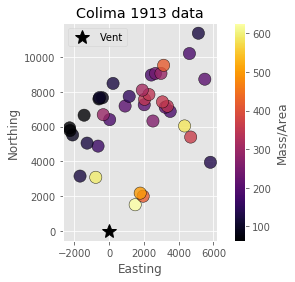

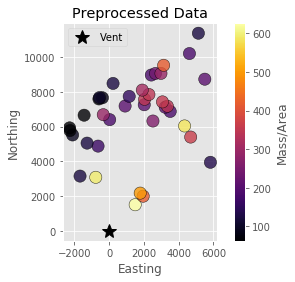

In [5]:
vis.plot_sample(raw_df, vent=(0,0), log=False, title="Colima 1913 data", cbar_label="Mass/Area")
plt.show()
# plt.savefig("colima/all_points.png", dpi=200, format='png')

obs_df = raw_df.copy()

# obs_df = obs_df.drop([16, 18, 17, 37, 31])
#This is going to be 100 across. Just needs to be the same as the other dfs. 
obs_df["Residual"] = obs_df["MassArea"]/obs_df["MassArea"]*100

vis.plot_sample(obs_df, vent=(0,0), log=False, title="Preprocessed Data", cbar_label="Mass/Area")
# plt.savefig("colima/All_trans.png", dpi=200, format='png')
plt.show()

In [6]:
# grid.to_csv("data/colima/colima_grid.csv", sep=" ", header=False, index=False)

# t2_df, _, _, _ = io.read_tephra2("data/colima/colima_tephra2_sim_data.txt")

# t2_df["Residual"] = t2_df["MassArea"].values/obs_df["MassArea"].values

# display(t2_df.head())

In [7]:
t2_const_df, _, _, _ = io.read_tephra2("data/colima/colima_tephra2_const_wind_sim_data.txt")

t2_const_df["Residual"] = t2_const_df["MassArea"]/obs_df["MassArea"]

display(t2_const_df.head())

,Easting,Northing,Elevation,MassArea,"[-5,-4)","[-4,-3)","[-3,-2)","[-2,-1)","[-1,0)","[0,1)","[1,2)","[2,3)","[3,4)",radius,Residual
16,1499,1506,2500,"1,394.46",17.2005,24.2121,24.7779,18.9162,10.8457,3.58293,0.449327,0.015328,2.84769e-05,"2,124.86",2.22828
18,1957,1997,2500,"1,216.15",14.016,22.3619,24.864,20.2838,12.7356,4.93885,0.76913,0.0307052,6.30498e-05,"2,796.04",2.91503
17,1787,2173,2500,"1,251",13.877,22.2837,24.8861,20.3522,12.8046,4.98427,0.780754,0.0313104,6.44789e-05,"2,813.41",2.4988
37,-770,3082,2500,359.399,14.8025,22.8299,24.5313,19.4545,12.2828,5.13528,0.922533,0.0410962,9.09858e-05,"3,176.73",0.60453
31,-1673,3152,2500,134.301,15.3664,23.3283,24.4813,18.8191,11.7036,5.16746,1.07907,0.054478,0.000131905,"3,568.48",1.07303


In [8]:
config = io.read_tephra2_config("data/colima/colima_config.txt")

globs = {
    "LITHIC_DIAMETER_THRESHOLD": 7.,
    "PUMICE_DIAMETER_THRESHOLD": -1.,
    "AIR_VISCOSITY": 0.000018325,
    "AIR_DENSITY":  1.293,
    "GRAVITY": 9.81,
}






# Update parameters
# COL STEPS need to be small enough so the 
# layer height can be kept for an inversion with a high H
config["COL_STEPS"] = 20
theoretical_max = 45000 #The H value will be as close as possible to this
layer_thickness = ((config["PLUME_HEIGHT"]-config["VENT_ELEVATION"])/config["COL_STEPS"])

inversion_steps = np.round((config["COL_STEPS"]*(theoretical_max - config["VENT_ELEVATION"]))/\
                  (config["PLUME_HEIGHT"]-config["VENT_ELEVATION"]))
closest_H = ((inversion_steps*(config["PLUME_HEIGHT"] - config["VENT_ELEVATION"]))/\
             config["COL_STEPS"]) + config["VENT_ELEVATION"]
print("This number needs to be low enough to invert efficiently:")
print(inversion_steps)
print("If not, decrease COL_STEPS or theoretical max")
print("Closest Possible Theoretical Max Column Height:")
print(closest_H)

config["INV_STEPS"] = int(inversion_steps)
config["THEO_MAX_COL"] = closest_H
config["PART_STEPS"] = 9

config["MAX_GRAINSIZE"] = -5
config["MIN_GRAINSIZE"] = 4

# Additional parameter: Constant wind speed
config["WIND_SPEED"] = 10

# To ensure monotonicity:
# config["DIFFUSION_COEFFICIENT"] = 1.7*config["FALL_TIME_THRESHOLD"]

print("INPUT PARAMETERS:")
display(config)
display(globs)

This number needs to be low enough to invert efficiently:
40.0
If not, decrease COL_STEPS or theoretical max
Closest Possible Theoretical Max Column Height:
44915.0
INPUT PARAMETERS:


{'VENT_EASTING': 0.0,
 'VENT_NORTHING': 0.0,
 'VENT_ELEVATION': 3085.0,
 'PLUME_HEIGHT': 24000.0,
 'ALPHA': 1.02,
 'BETA': 1.56,
 'ERUPTION_MASS': 55000000000.0,
 'MAX_GRAINSIZE': -5,
 'MIN_GRAINSIZE': 4,
 'MEDIAN_GRAINSIZE': -1.8,
 'STD_GRAINSIZE': 2.4,
 'EDDY_CONST': 0.04,
 'DIFFUSION_COEFFICIENT': 4016.0,
 'FALL_TIME_THRESHOLD': 6458.0,
 'LITHIC_DENSITY': 2700.0,
 'PUMICE_DENSITY': 1024.0,
 'COL_STEPS': 20,
 'PART_STEPS': 9,
 'PLUME_MODEL': 2.0,
 'INV_STEPS': 40,
 'THEO_MAX_COL': 44915.0,
 'WIND_SPEED': 10}

{'LITHIC_DIAMETER_THRESHOLD': 7.0,
 'PUMICE_DIAMETER_THRESHOLD': -1.0,
 'AIR_VISCOSITY': 1.8325e-05,
 'AIR_DENSITY': 1.293,
 'GRAVITY': 9.81}

,centroid,density,interval,lower,probability,upper
0,-4.5,"1,024","[-5,-4)",-5,0.0683375,-4
1,-3.5,"1,024","[-4,-3)",-4,0.109203,-3
2,-2.5,"1,024","[-3,-2)",-3,0.146694,-2
3,-1.5,"1,024","[-2,-1)",-2,0.16565,-1
4,-0.5,"1,024","[-1,0)",-1,0.157243,0
5,0.5,"1,233.5","[0,1)",0,0.125474,1
6,1.5,"1,443","[1,2)",1,0.0841661,2
7,2.5,"1,652.5","[2,3)",2,0.0474595,3
8,3.5,"1,862","[3,4)",3,0.0224962,4


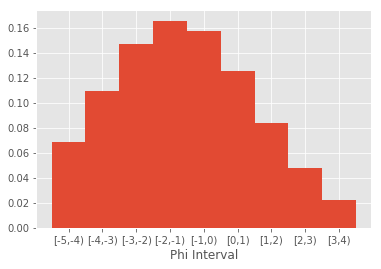

In [9]:
theo_phi_steps = get_phi_steps(config["MIN_GRAINSIZE"], config["MAX_GRAINSIZE"], 
                          config["PART_STEPS"], 
                          config["MEDIAN_GRAINSIZE"], config["STD_GRAINSIZE"],
                          globs["LITHIC_DIAMETER_THRESHOLD"], 
                          globs["PUMICE_DIAMETER_THRESHOLD"], 
                          config["LITHIC_DENSITY"], config["PUMICE_DENSITY"])
step_width = (config["MAX_GRAINSIZE"] - config["MIN_GRAINSIZE"])/config["PART_STEPS"]

display(pd.DataFrame(theo_phi_steps))



probs = [phi["probability"].copy() for phi in theo_phi_steps]
x = [phi["centroid"] for phi in theo_phi_steps]
labels = [phi["interval"] for phi in theo_phi_steps]
fig, ax = plt.subplots(facecolor='w', edgecolor='k')
ax.bar(x, probs, width=1, align="center")
ax.set_xticks(x)
ax.set_xticklabels(labels)
plt.xlabel("Phi Interval")
plt.show()

[0.05231643 0.16945065 0.20390996 0.20809308 0.19893822 0.12429353
 0.02893896 0.00704844 0.00701073]
[-4.5, -3.5, -2.5, -1.5, -0.5, 0.5, 1.5, 2.5, 3.5]


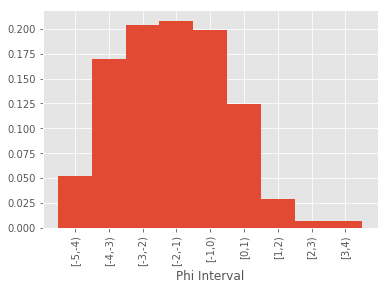

[{'lower': -5, 'upper': -4.0, 'interval': '[-5,-4)', 'centroid': -4.5, 'density': 1024.0, 'probability': 0.052316431318540024}, {'lower': -4.0, 'upper': -3.0, 'interval': '[-4,-3)', 'centroid': -3.5, 'density': 1024.0, 'probability': 0.1694506511837887}, {'lower': -3.0, 'upper': -2.0, 'interval': '[-3,-2)', 'centroid': -2.5, 'density': 1024.0, 'probability': 0.20390996005463202}, {'lower': -2.0, 'upper': -1.0, 'interval': '[-2,-1)', 'centroid': -1.5, 'density': 1024.0, 'probability': 0.2080930801364657}, {'lower': -1.0, 'upper': 0.0, 'interval': '[-1,0)', 'centroid': -0.5, 'density': 1024.0, 'probability': 0.19893821897376404}, {'lower': 0.0, 'upper': 1.0, 'interval': '[0,1)', 'centroid': 0.5, 'density': 1233.5, 'probability': 0.12429352702169855}, {'lower': 1.0, 'upper': 2.0, 'interval': '[1,2)', 'centroid': 1.5, 'density': 1443.0, 'probability': 0.028938961877603735}, {'lower': 2.0, 'upper': 3.0, 'interval': '[2,3)', 'centroid': 2.5, 'density': 1652.5, 'probability': 0.00704844304499

In [10]:
naive_tgsd = get_tgsd(obs_df, theo_phi_steps)
print(naive_tgsd)
print(x)
fig, ax = plt.subplots(facecolor='w', edgecolor='k')
ax.bar(x, naive_tgsd, width=1, align="center")
ax.set_xticks(x)
ax.set_xticklabels(labels, rotation=90)
plt.xlabel("Phi Interval")
plt.show()

naive_phi_steps = theo_phi_steps.copy()
for i, phi in enumerate(naive_phi_steps):
    phi["probability"] = naive_tgsd[i]
print(naive_phi_steps)

In [11]:

grid = obs_df[["Easting", "Northing"]]
wind_angle = np.radians(55)

u = config["WIND_SPEED"]*np.cos(wind_angle)
v = config["WIND_SPEED"]*np.sin(wind_angle)

forward_df = gaussian_stack_forward(
    grid, int(config["COL_STEPS"]), config["VENT_ELEVATION"], 
    config["PLUME_HEIGHT"], 2500, naive_phi_steps, (config["ALPHA"], config["BETA"]), 
    config["ERUPTION_MASS"], 
    (u,v), config["DIFFUSION_COEFFICIENT"], config["EDDY_CONST"],
    config["FALL_TIME_THRESHOLD"]
)

forward_df["radius"] = np.sqrt(forward_df["Easting"]**2 + forward_df["Northing"]**2)
forward_df = forward_df.sort_values(by=['radius'])
forward_df["Residual"] = forward_df["MassArea"].values/obs_df["MassArea"].values
display(forward_df.head())

print(u, v)

,Northing,Easting,"[-5,-4)","[-4,-3)","[-3,-2)","[-2,-1)","[-1,0)","[0,1)","[1,2)","[2,3)","[3,4)",MassArea,radius,Residual
0,1506,1499,10.2913,29.5685,27.288,18.924,10.9616,2.84099,0.123803,0.001825,7.10812e-06,"1,678.84","2,124.86",2.68271
1,1997,1957,8.3142,27.1464,27.2807,20.2572,12.8676,3.91805,0.212099,0.00365928,1.57598e-05,"1,462.8","2,796.04",3.50624
2,2173,1787,8.22952,27.0446,27.2982,20.3207,12.9346,3.95335,0.215267,0.00373077,1.61147e-05,"1,504.98","2,813.41",3.00611
3,3082,-770,8.7488,27.7372,27.0418,19.5747,12.5223,4.11323,0.256923,0.00494637,2.29538e-05,428.027,"3,176.73",0.719966
4,3152,-1673,9.0285,28.313,27.0764,19.0615,12.0333,4.17711,0.303382,0.0066199,3.35645e-05,158.425,"3,568.48",1.26578


5.7357643635104605 8.191520442889917


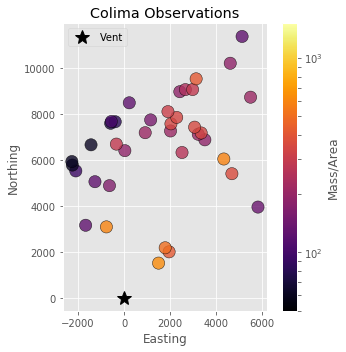

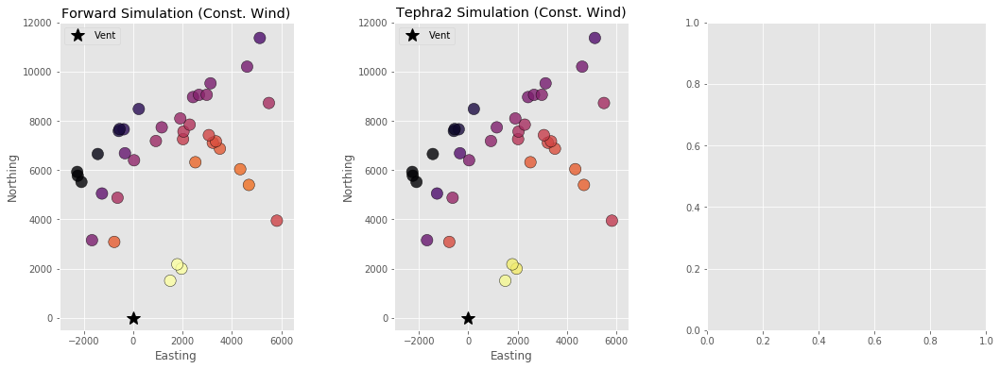

In [12]:

fig, ax = plt.subplots(1, 1, figsize=(5,5))

vis.plot_sample(obs_df, vent=(0,0), log=True, bounds=(50, 1500),
            title="Colima Observations", cbar_label="Mass/Area", ax = ax)
plt.tight_layout()
plt.show()


fig, axs = plt.subplots(1, 3, figsize=(
        18,6), facecolor='w', edgecolor='k')
axs = axs.ravel()

vis.plot_sample(forward_df, vent=(0,0), log=True, bounds=(50, 1500), show_cbar=False,
            title="Forward Simulation (Const. Wind)", cbar_label="Mass/Area", ax=axs[0])
vis.plot_sample(t2_const_df, vent=(0,0), log=True, bounds=(50, 1500), show_cbar=False,
            title="Tephra2 Simulation (Const. Wind)", cbar_label="Mass/Area", ax=axs[1])
# vis.plot_sample(t2_df, vent=(0,0), log=True, bounds=(50, 1500),
#             title="Tephra2 Simulation (NOAA Wind)", cbar_label="Mass/Area", ax=axs[2])
axs[0].set_xlim([-3000, 6500])
axs[0].set_ylim([-500, 12000])
axs[1].set_xlim([-3000, 6500])
axs[1].set_ylim([-500, 12000])
plt.show()




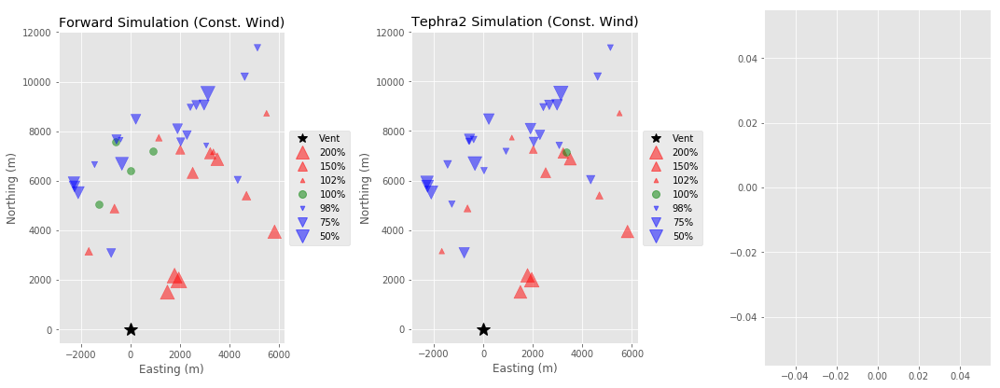

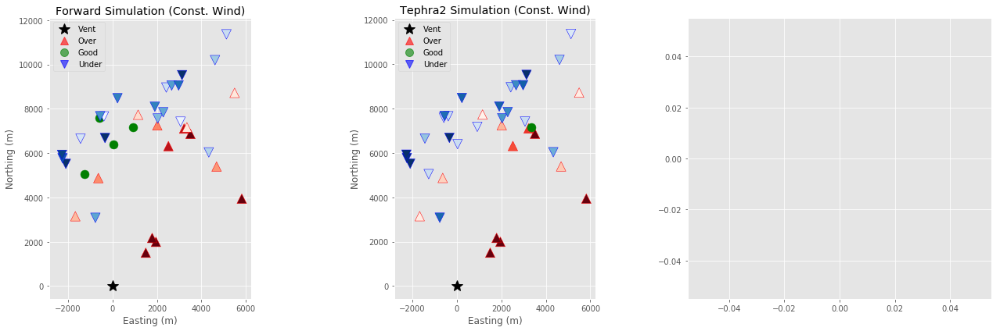

In [13]:
fig, axs = plt.subplots(1, 3, figsize=(
        15,6), facecolor='w', edgecolor='k')
axs = axs.ravel()


vis.plot_residuals(forward_df, vent=(0,0), values="Residual",
            title="Forward Simulation (Const. Wind)", 
            plot_type = "size", ax=axs[0])
vis.plot_residuals(t2_const_df, vent=(0,0), values="Residual",
            title="Tephra2 Simulation (Const. Wind)", 
             plot_type = "size", ax=axs[1])
# vis.plot_residuals(t2_df, vent=(0,0), values="Residual",
#             title="Tephra2 Simulation (NOAA Wind)", 
#              plot_type = "size", ax=axs[2])


plt.tight_layout()
plt.show()

fig, axs = plt.subplots(1, 3, figsize=(
        18,6), facecolor='w', edgecolor='k')
axs = axs.ravel()


vis.plot_residuals(forward_df, vent=(0,0), values="Residual",
            title="Forward Simulation (Const. Wind)", 
            plot_type = "cmap", ax=axs[0], show_cbar = False)
vis.plot_residuals(t2_const_df, vent=(0,0), values="Residual",
            title="Tephra2 Simulation (Const. Wind)", 
             plot_type = "cmap", ax=axs[1], show_cbar = False)
# vis.plot_residuals(t2_df, vent=(0,0), values="Residual",
#             title="Tephra2 Simulation (NOAA Wind)", 
#              plot_type = "cmap", ax=axs[2], show_cbar = True)


# plt.tight_layout()
plt.show()

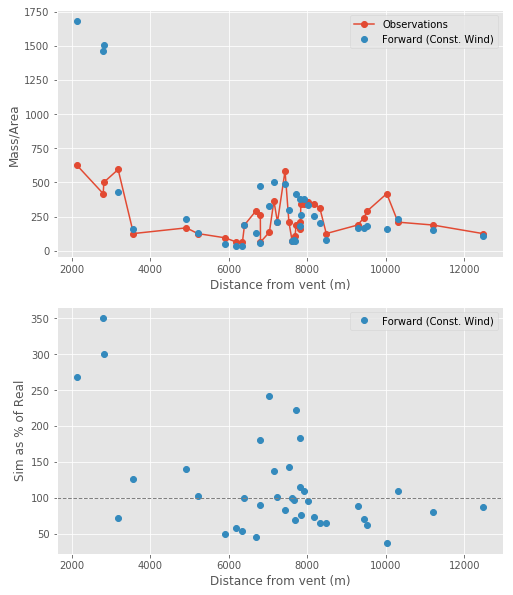

In [14]:
fig, axs = plt.subplots(2,1, figsize=(
        8,10), facecolor='w', edgecolor='k')
axs = axs.ravel()

axs[0].plot(obs_df["radius"].values, obs_df["MassArea"].values, 'C0o-', label="Observations")
# plt.plot(rotdf["radius"].values, rotdf["MassArea"].values, 'C1o-')
axs[0].plot(forward_df["radius"].values, forward_df["MassArea"].values, 'C1o', label="Forward (Const. Wind)")
# axs[0].plot(t2_const_df["radius"].values, t2_const_df["MassArea"].values, 'C2o', label="Tephra2 (Const. Wind)")
# axs[0].plot(t2_df["radius"].values, t2_df["MassArea"].values, 'C3o', label="Tephra2 (NOAA Wind)")
axs[0].legend()
axs[0].set_xlabel("Distance from vent (m)")
axs[0].set_ylabel("Mass/Area")

axs[1].plot(forward_df["radius"].values, forward_df["Residual"].values*100, 'C1o', label="Forward (Const. Wind)")
# axs[1].plot(t2_const_df["radius"].values, t2_const_df["Residual"].values*100, 'C2o', label="Tephra2 (Const. Wind)")
# axs[1].plot(t2_df["radius"].values, t2_df["Residual"].values*100, 'C3o', label="Tephra2 (NOAA Wind)")
axs[1].axhline(100, linestyle="--", lw=1, c="gray")
axs[1].legend()
axs[1].set_xlabel("Distance from vent (m)")
axs[1].set_ylabel("Sim as % of Real")
plt.show()

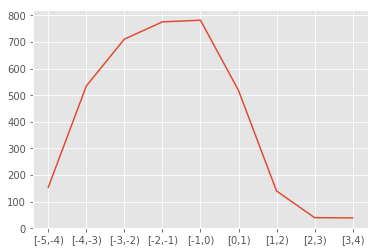

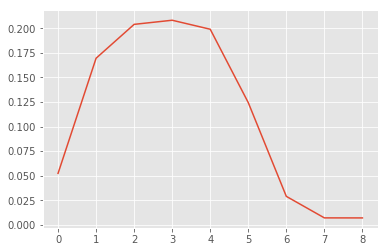

In [15]:
plt.plot(obs_df[labels].sum())
plt.show()
plt.plot([phi["probability"] for phi in naive_phi_steps])
plt.show()

========Forward Sim========
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.26e+02 	5.26e+02 	1.0000 		0.0429
1 	9.32e+09 	1.99e+03 	1.99e+03 	1.0000 		0.1621
2 	1.12e+10 	2.84e+03 	2.84e+03 	1.0000 		0.2315
3 	1.14e+10 	3.20e+03 	3.20e+03 	1.0000 		0.2611
4 	1.09e+10 	2.63e+03 	2.63e+03 	1.0000 		0.2145
5 	6.84e+09 	9.57e+02 	9.57e+02 	1.0000 		0.0781
6 	1.59e+09 	1.07e+02 	1.07e+02 	1.0000 		0.0088
7 	3.88e+08 	1.05e+01 	1.05e+01 	1.0000 		0.0009
8 	3.86e+08 	4.60e-01 	4.60e-01 	1.0000 		0.0000


C:\Users\nmostert\Documents\repos\inversion_project\utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


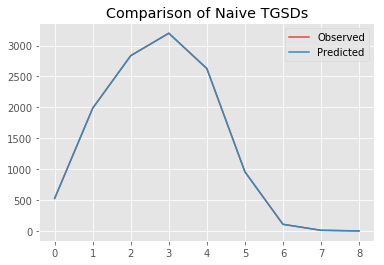

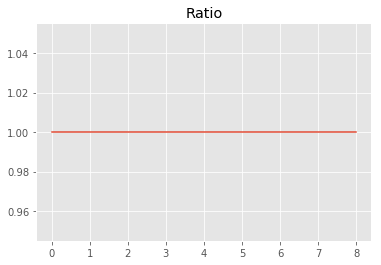

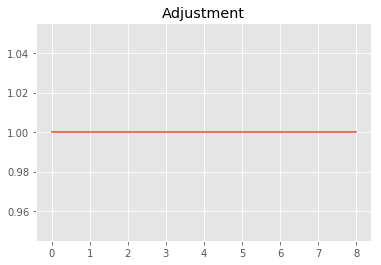

54999999999.99999
1.0


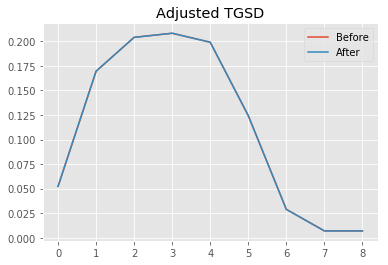

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.02 	1.56 	24000 	5.73576 	8.19152 	4016 	6458 	1e-05 	0
New Total Mass: 5.5e+10
After: 		|1.02 	1.56 	24000 	5.73576 	8.19152 	4016 	6458 	5.62341e-06 	0
Old Misfit: 5.07721e-28
New Misfit: 6.40582e-28
Convergence:
0.2616804709394603

____________________
a = 1.02000	b = 1.56000	            h1 = 24000.00000	u = 5.73576	v = 8.19152	            D = 4016.00000	ftt = 6458.00000	TM = 0.00001	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 6.405819867590223e-28


,Height,Suspended Mass
0,"4,130.75",4.35961e+09
1,"5,176.5",4.27051e+09
2,"6,222.25",4.16026e+09
3,"7,268",4.03746e+09
4,"8,313.75",3.90513e+09
5,"9,359.5",3.76451e+09
6,"10,405.2",3.61603e+09
7,"11,451",3.45969e+09
8,"12,496.8",3.29513e+09
9,"13,542.5",3.12171e+09


[[1.02000000e+00 1.56000000e+00 2.40000000e+04 5.73576436e+00
  8.19152044e+00 4.01600000e+03 6.45800000e+03 1.00000000e-05
  0.00000000e+00 5.50000000e+10]
 [1.02000000e+00 1.56000000e+00 2.40000000e+04 5.73576436e+00
  8.19152044e+00 4.01600000e+03 6.45800000e+03 1.00000000e-05
  0.00000000e+00 5.50000000e+10]
 [1.01644680e+00 1.56000000e+00 2.40000000e+04 5.73576436e+00
  8.19152044e+00 4.01600000e+03 6.45800000e+03 1.00000000e-05
  0.00000000e+00 5.50000000e+10]
 [1.02000000e+00 1.54399816e+00 2.40000000e+04 5.73576436e+00
  8.19152044e+00 4.01600000e+03 6.45800000e+03 1.00000000e-05
  0.00000000e+00 5.50000000e+10]
 [1.02000000e+00 1.56000000e+00 2.43498596e+04 5.73576436e+00
  8.19152044e+00 4.01600000e+03 6.45800000e+03 1.00000000e-05
  0.00000000e+00 5.50000000e+10]
 [1.02000000e+00 1.56000000e+00 2.40000000e+04 6.02255258e+00
  8.19152044e+00 4.01600000e+03 6.45800000e+03 1.00000000e-05
  0.00000000e+00 5.50000000e+10]
 [1.02000000e+00 1.56000000e+00 2.40000000e+04 5.73576436e

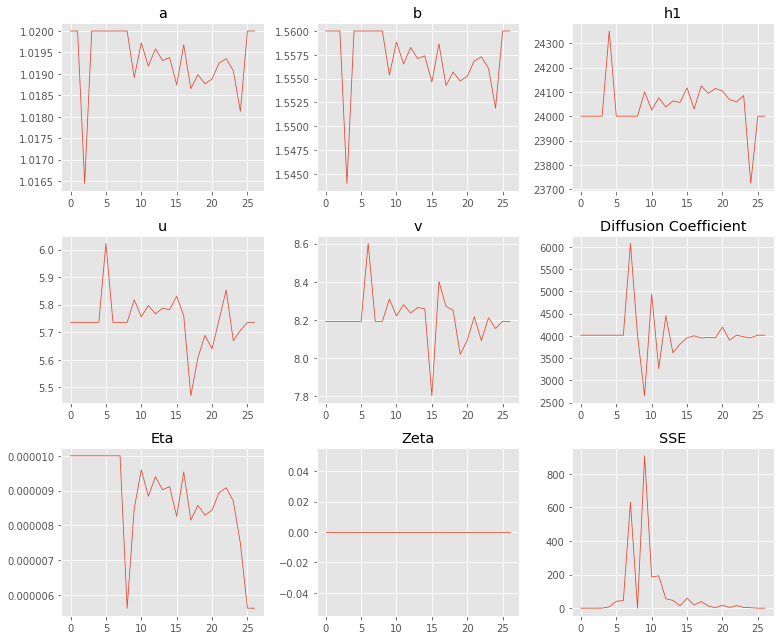

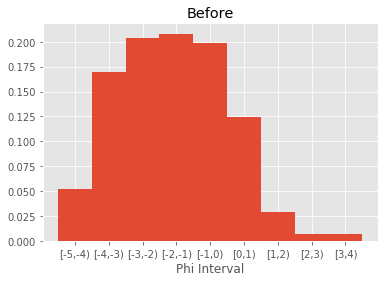

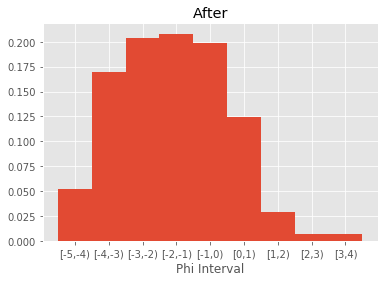

Forward Sim Run Time: 0.10443 minutes


========Observation Data========
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.26e+02 	4.77e+02 	0.9072 		0.0523
1 	9.32e+09 	1.99e+03 	1.55e+03 	0.7784 		0.1695
2 	1.12e+10 	2.84e+03 	1.86e+03 	0.6560 		0.2039
3 	1.14e+10 	3.20e+03 	1.90e+03 	0.5936 		0.2081
4 	1.09e+10 	2.63e+03 	1.82e+03 	0.6908 		0.1989
5 	6.84e+09 	9.57e+02 	1.13e+03 	1.1847 		0.1243
6 	1.59e+09 	1.07e+02 	2.64e+02 	2.4573 		0.0289
7 	3.88e+08 	1.05e+01 	6.43e+01 	6.1071 		0.0070
8 	3.86e+08 	4.60e-01 	6.40e+01 	138.9683 		0.0070


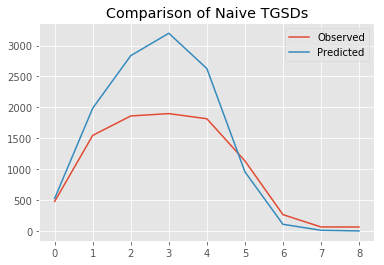

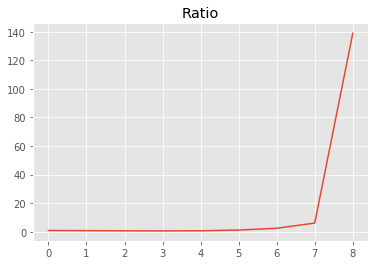

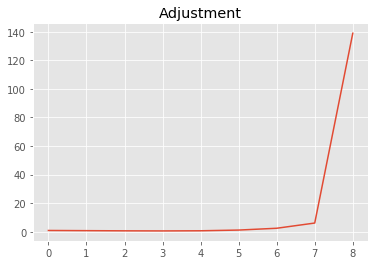

52819345243.2808
0.9999999999999998


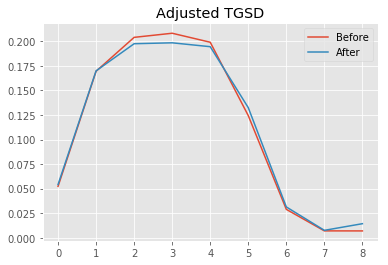

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.02 	1.56 	24000 	5.73576 	8.19152 	4016 	6458 	1e-05 	0
New Total Mass: 5.5e+10
After: 		|1.01605 	1.56967 	23490.7 	5.90485 	7.7442 	10797.6 	6458 	9.60252e-06 	0
Old Misfit: 745368
New Misfit: 12450.7
Convergence:
0.9832959094688901

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.98e+09 	4.65e+02 	4.77e+02 	1.0258 		0.0523
1 	9.34e+09 	1.71e+03 	1.55e+03 	0.9033 		0.1695
2 	1.09e+10 	2.23e+03 	1.86e+03 	0.8328 		0.2039
3 	1.09e+10 	2.27e+03 	1.90e+03 	0.8376 		0.2081
4 	1.07e+10 	1.92e+03 	1.82e+03 	0.9478 		0.1989
5 	7.28e+09 	8.40e+02 	1.13e+03 	1.3499 		0.1243
6 	1.73e+09 	1.00e+02 	2.64e+02 	2.6384 		0.0289
7 	4.18e+08 	9.05e+00 	6.43e+01 	7.1085 		0.0070
8 	7.90e+08 	2.44e+00 	6.40e+01 	26.1721 		0.0070


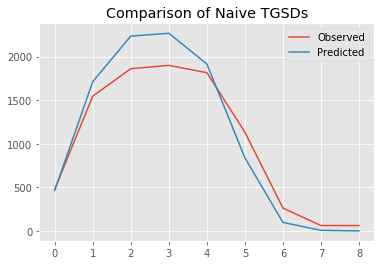

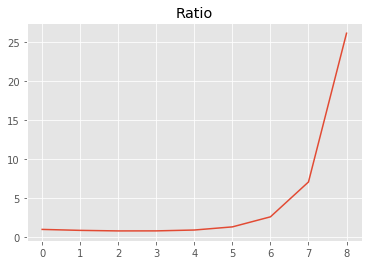

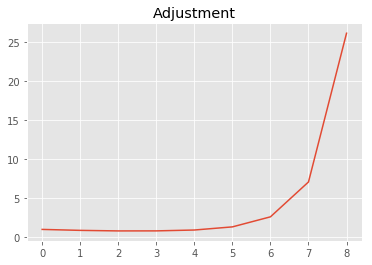

54557136274.779854
1.0000000000000002


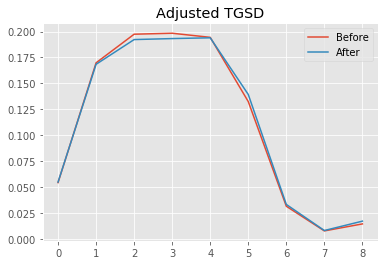

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.01605 	1.56967 	23490.7 	5.90485 	7.7442 	10797.6 	6458 	9.60252e-06 	0
New Total Mass: 5.5e+10
After: 		|1.0126 	1.56661 	23461.6 	5.77252 	7.3915 	18599.5 	6458 	1.98544e-05 	0
Old Misfit: 12450.7
New Misfit: 8046.71
Convergence:
0.35371405167547104

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.01e+09 	4.43e+02 	4.77e+02 	1.0770 		0.0523
1 	9.26e+09 	1.52e+03 	1.55e+03 	1.0155 		0.1695
2 	1.06e+10 	1.82e+03 	1.86e+03 	1.0222 		0.2039
3 	1.06e+10 	1.75e+03 	1.90e+03 	1.0845 		0.2081
4 	1.07e+10 	1.50e+03 	1.82e+03 	1.2082 		0.1989
5 	7.66e+09 	7.27e+02 	1.13e+03 	1.5607 		0.1243
6 	1.82e+09 	8.85e+01 	2.64e+02 	2.9833 		0.0289
7 	4.40e+08 	8.23e+00 	6.43e+01 	7.8119 		0.0070
8 	9.37e+08 	3.62e+00 	6.40e+01 	17.6952 		0.0070


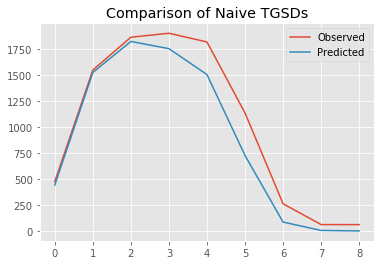

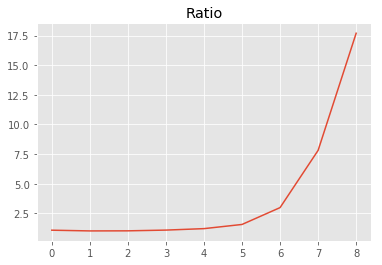

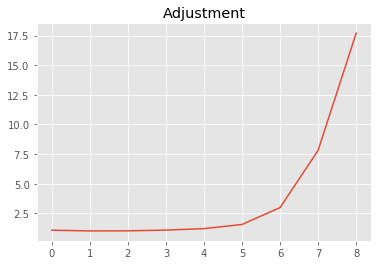

56482166568.820915
1.0


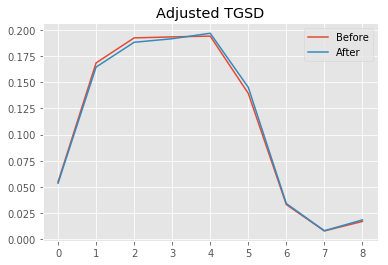

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.0126 	1.56661 	23461.6 	5.77252 	7.3915 	18599.5 	6458 	1.98544e-05 	0
New Total Mass: 5.5e+10
After: 		|1.00785 	1.55225 	23640.1 	4.9069 	7.20174 	18442.4 	6458 	1.04603e-05 	0
Old Misfit: 8046.71
New Misfit: 6940.92
Convergence:
0.1374212055417088

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.94e+09 	4.30e+02 	4.77e+02 	1.1105 		0.0523
1 	9.04e+09 	1.48e+03 	1.55e+03 	1.0426 		0.1695
2 	1.03e+10 	1.79e+03 	1.86e+03 	1.0380 		0.2039
3 	1.05e+10 	1.77e+03 	1.90e+03 	1.0727 		0.2081
4 	1.08e+10 	1.58e+03 	1.82e+03 	1.1474 		0.1989
5 	7.98e+09 	8.07e+02 	1.13e+03 	1.4055 		0.1243
6 	1.88e+09 	1.00e+02 	2.64e+02 	2.6397 		0.0289
7 	4.49e+08 	9.59e+00 	6.43e+01 	6.7081 		0.0070
8 	1.02e+09 	4.91e+00 	6.40e+01 	13.0362 		0.0070


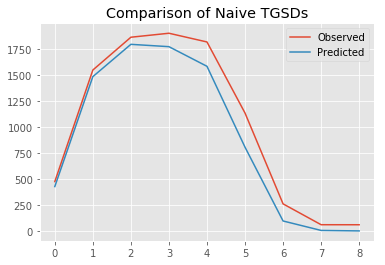

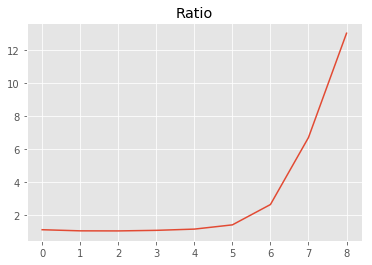

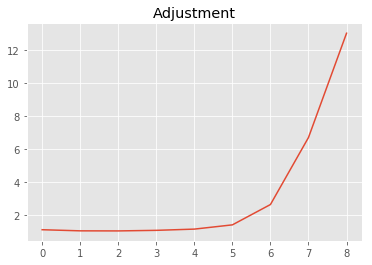

56234109854.88354
1.0000000000000002


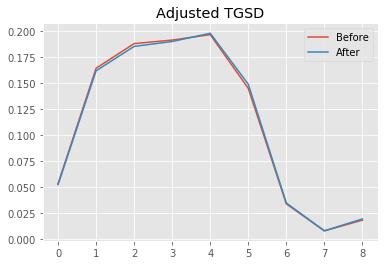

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00785 	1.55225 	23640.1 	4.9069 	7.20174 	18442.4 	6458 	1.04603e-05 	0
New Total Mass: 5.5e+10
After: 		|1.00645 	1.54071 	23745.7 	4.3362 	7.13132 	13766.9 	6458 	5.83046e-06 	0
Old Misfit: 6940.92
New Misfit: 6414.94
Convergence:
0.07577949247849175

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.89e+09 	4.28e+02 	4.77e+02 	1.1146 		0.0523
1 	8.91e+09 	1.54e+03 	1.55e+03 	1.0065 		0.1695
2 	1.02e+10 	1.95e+03 	1.86e+03 	0.9533 		0.2039
3 	1.05e+10 	2.03e+03 	1.90e+03 	0.9338 		0.2081
4 	1.09e+10 	1.90e+03 	1.82e+03 	0.9558 		0.1989
5 	8.20e+09 	1.00e+03 	1.13e+03 	1.1342 		0.1243
6 	1.92e+09 	1.25e+02 	2.64e+02 	2.1150 		0.0289
7 	4.57e+08 	1.21e+01 	6.43e+01 	5.3221 		0.0070
8 	1.08e+09 	6.17e+00 	6.40e+01 	10.3670 		0.0070


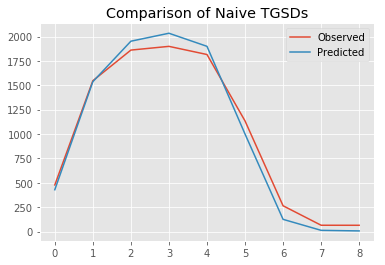

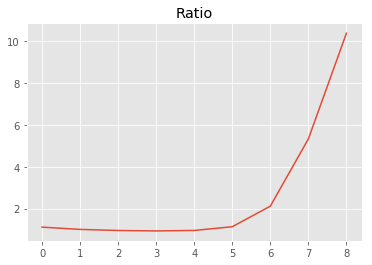

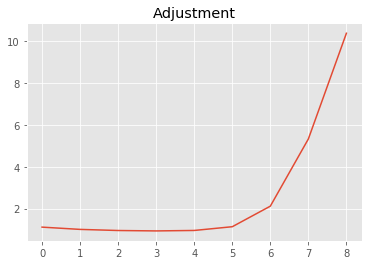

54974080345.85768
1.0


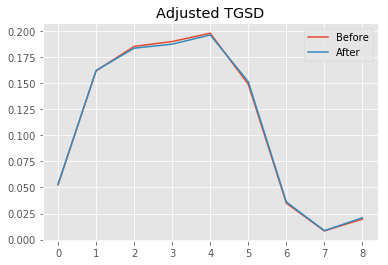

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00645 	1.54071 	23745.7 	4.3362 	7.13132 	13766.9 	6458 	5.83046e-06 	0
New Total Mass: 5.5e+10
After: 		|1.00574 	1.53313 	23901.9 	3.90922 	7.29505 	15246.9 	6458 	4.42107e-06 	0
Old Misfit: 6414.94
New Misfit: 6082.25
Convergence:
0.051862221847011836

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.91e+09 	4.34e+02 	4.77e+02 	1.0992 		0.0523
1 	8.92e+09 	1.54e+03 	1.55e+03 	1.0049 		0.1695
2 	1.01e+10 	1.91e+03 	1.86e+03 	0.9747 		0.2039
3 	1.03e+10 	1.96e+03 	1.90e+03 	0.9710 		0.2081
4 	1.08e+10 	1.82e+03 	1.82e+03 	0.9951 		0.1989
5 	8.34e+09 	9.88e+02 	1.13e+03 	1.1477 		0.1243
6 	1.99e+09 	1.26e+02 	2.64e+02 	2.1005 		0.0289
7 	4.71e+08 	1.22e+01 	6.43e+01 	5.2795 		0.0070
8 	1.15e+09 	6.72e+00 	6.40e+01 	9.5242 		0.0070


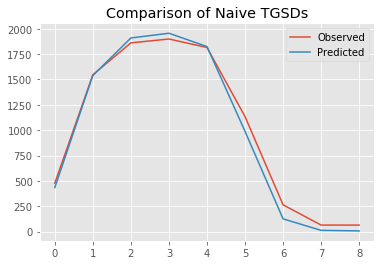

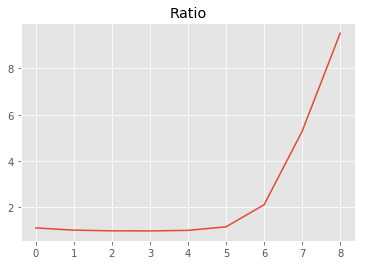

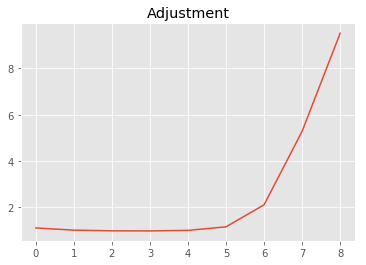

55197097490.0772
1.0000000000000002


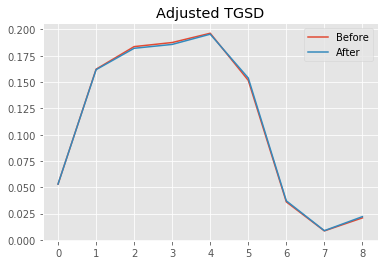

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00574 	1.53313 	23901.9 	3.90922 	7.29505 	15246.9 	6458 	4.42107e-06 	0
New Total Mass: 5.5e+10
After: 		|1.00487 	1.52252 	24123.5 	3.55954 	7.17103 	14749.4 	6458 	2.98056e-06 	0
Old Misfit: 6082.25
New Misfit: 5887.4
Convergence:
0.03203602590306495

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.92e+09 	4.34e+02 	4.77e+02 	1.0990 		0.0523
1 	8.90e+09 	1.54e+03 	1.55e+03 	1.0056 		0.1695
2 	1.00e+10 	1.91e+03 	1.86e+03 	0.9764 		0.2039
3 	1.02e+10 	1.96e+03 	1.90e+03 	0.9680 		0.2081
4 	1.08e+10 	1.85e+03 	1.82e+03 	0.9821 		0.1989
5 	8.46e+09 	1.03e+03 	1.13e+03 	1.1049 		0.1243
6 	2.04e+09 	1.33e+02 	2.64e+02 	1.9808 		0.0289
7 	4.83e+08 	1.31e+01 	6.43e+01 	4.9186 		0.0070
8 	1.22e+09 	7.64e+00 	6.40e+01 	8.3790 		0.0070


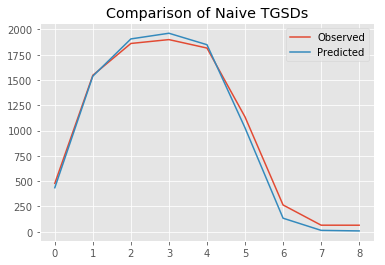

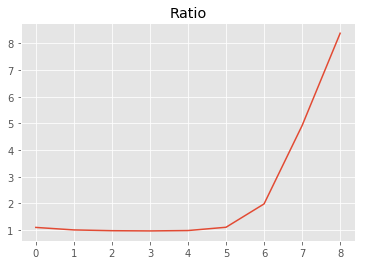

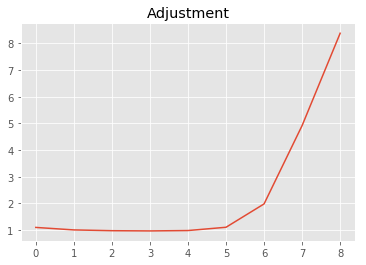

55113669715.09541
0.9999999999999998


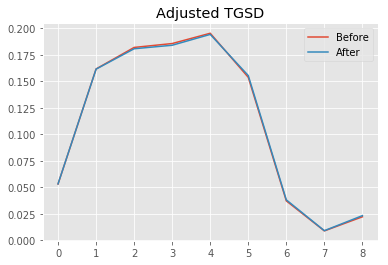

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00487 	1.52252 	24123.5 	3.55954 	7.17103 	14749.4 	6458 	2.98056e-06 	0
New Total Mass: 5.5e+10
After: 		|1.00391 	1.50874 	24415.8 	3.47919 	7.08819 	14722.1 	6458 	8.27745e-06 	0
Old Misfit: 5887.4
New Misfit: 5778.41
Convergence:
0.01851235647102828

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.93e+09 	4.35e+02 	4.77e+02 	1.0974 		0.0523
1 	8.89e+09 	1.53e+03 	1.55e+03 	1.0091 		0.1695
2 	9.95e+09 	1.89e+03 	1.86e+03 	0.9862 		0.2039
3 	1.01e+10 	1.94e+03 	1.90e+03 	0.9800 		0.2081
4 	1.07e+10 	1.83e+03 	1.82e+03 	0.9917 		0.1989
5 	8.55e+09 	1.03e+03 	1.13e+03 	1.0976 		0.1243
6 	2.10e+09 	1.36e+02 	2.64e+02 	1.9369 		0.0289
7 	4.95e+08 	1.34e+01 	6.43e+01 	4.7931 		0.0070
8 	1.28e+09 	8.14e+00 	6.40e+01 	7.8629 		0.0070


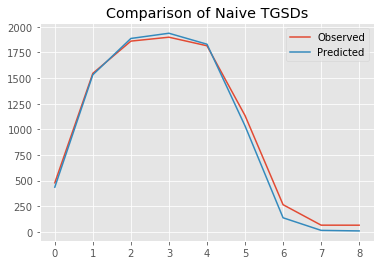

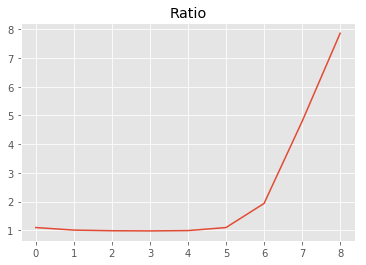

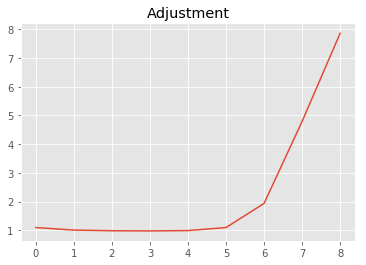

55176308184.57512
1.0


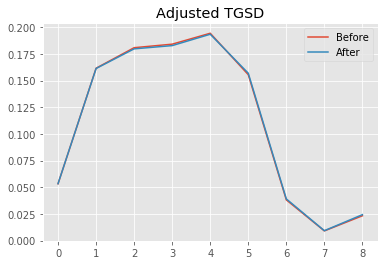

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00391 	1.50874 	24415.8 	3.47919 	7.08819 	14722.1 	6458 	8.27745e-06 	0
New Total Mass: 5.5e+10
After: 		|1.00315 	1.49546 	24703.1 	3.39366 	7.10886 	14357.4 	6458 	2.16814e-05 	0
Old Misfit: 5778.41
New Misfit: 5686.31
Convergence:
0.015938181179972047

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.93e+09 	4.39e+02 	4.77e+02 	1.0885 		0.0523
1 	8.87e+09 	1.54e+03 	1.55e+03 	1.0015 		0.1695
2 	9.89e+09 	1.90e+03 	1.86e+03 	0.9801 		0.2039
3 	1.01e+10 	1.95e+03 	1.90e+03 	0.9735 		0.2081
4 	1.06e+10 	1.85e+03 	1.82e+03 	0.9835 		0.1989
5 	8.63e+09 	1.05e+03 	1.13e+03 	1.0785 		0.1243
6 	2.15e+09 	1.40e+02 	2.64e+02 	1.8837 		0.0289
7 	5.07e+08 	1.38e+01 	6.43e+01 	4.6682 		0.0070
8 	1.33e+09 	8.49e+00 	6.40e+01 	7.5388 		0.0070


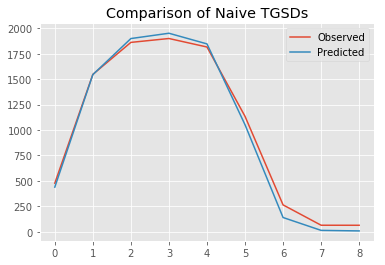

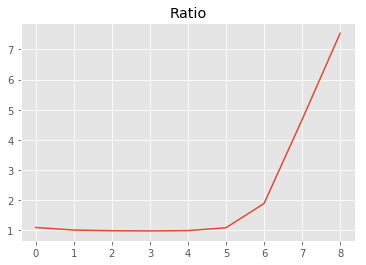

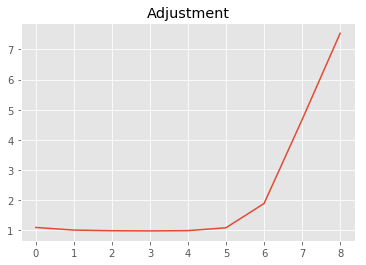

55098649324.360054
0.9999999999999999


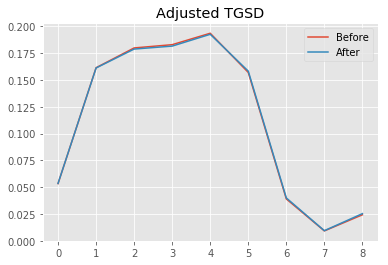

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00315 	1.49546 	24703.1 	3.39366 	7.10886 	14357.4 	6458 	2.16814e-05 	0
New Total Mass: 5.5e+10
After: 		|1.00315 	1.49546 	25080.9 	3.39366 	7.10886 	14357.4 	6458 	2.16814e-05 	0
Old Misfit: 5686.31
New Misfit: 5585.25
Convergence:
0.017772334862147944

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.94e+09 	4.43e+02 	4.77e+02 	1.0783 		0.0523
1 	8.86e+09 	1.55e+03 	1.55e+03 	0.9982 		0.1695
2 	9.83e+09 	1.89e+03 	1.86e+03 	0.9845 		0.2039
3 	9.98e+09 	1.93e+03 	1.90e+03 	0.9837 		0.2081
4 	1.06e+10 	1.82e+03 	1.82e+03 	0.9978 		0.1989
5 	8.70e+09 	1.04e+03 	1.13e+03 	1.0884 		0.1243
6 	2.20e+09 	1.40e+02 	2.64e+02 	1.8811 		0.0289
7 	5.19e+08 	1.38e+01 	6.43e+01 	4.6682 		0.0070
8 	1.39e+09 	8.65e+00 	6.40e+01 	7.3982 		0.0070


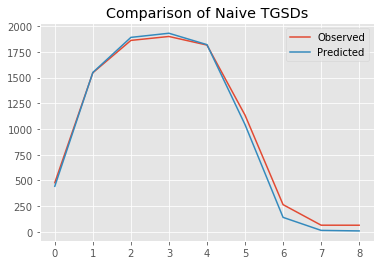

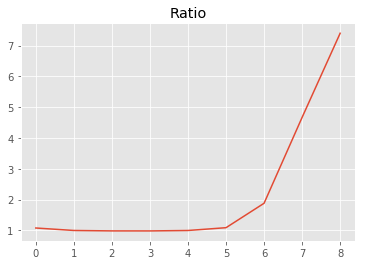

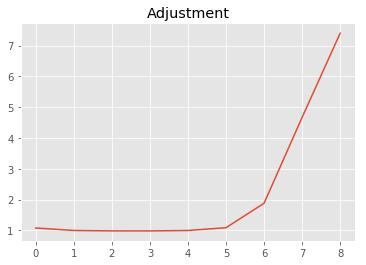

55167294517.73196
0.9999999999999999


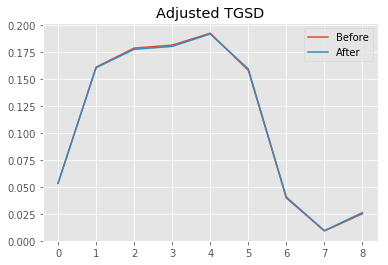

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00315 	1.49546 	25080.9 	3.39366 	7.10886 	14357.4 	6458 	2.16814e-05 	0
New Total Mass: 5.5e+10
After: 		|1.00417 	1.47078 	25650.5 	3.33527 	6.94646 	13189.8 	6458 	2.73725e-05 	0
Old Misfit: 5585.25
New Misfit: 5490.92
Convergence:
0.016889686267280758

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.94e+09 	4.43e+02 	4.77e+02 	1.0766 		0.0523
1 	8.83e+09 	1.56e+03 	1.55e+03 	0.9931 		0.1695
2 	9.77e+09 	1.92e+03 	1.86e+03 	0.9712 		0.2039
3 	9.92e+09 	1.98e+03 	1.90e+03 	0.9606 		0.2081
4 	1.05e+10 	1.88e+03 	1.82e+03 	0.9669 		0.1989
5 	8.77e+09 	1.08e+03 	1.13e+03 	1.0465 		0.1243
6 	2.25e+09 	1.48e+02 	2.64e+02 	1.7903 		0.0289
7 	5.31e+08 	1.46e+01 	6.43e+01 	4.4144 		0.0070
8 	1.45e+09 	9.33e+00 	6.40e+01 	6.8591 		0.0070


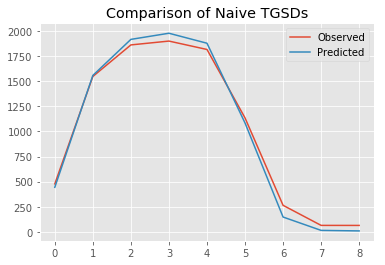

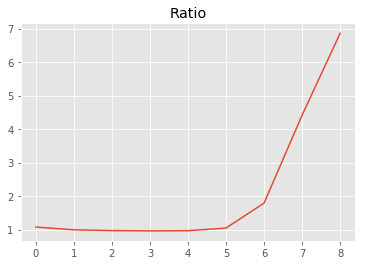

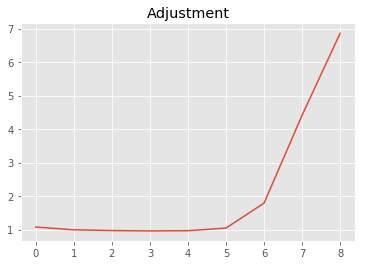

54967955132.24645
0.9999999999999999


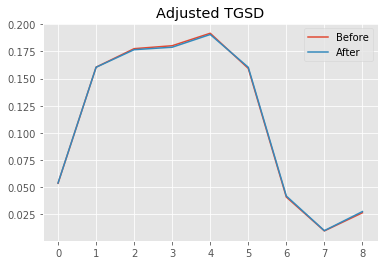

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00417 	1.47078 	25650.5 	3.33527 	6.94646 	13189.8 	6458 	2.73725e-05 	0
New Total Mass: 5.5e+10
After: 		|1.00417 	1.47078 	26064.1 	3.33527 	6.94646 	13189.8 	6458 	2.73725e-05 	0
Old Misfit: 5490.92
New Misfit: 5409.83
Convergence:
0.014767656563390026

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.96e+09 	4.47e+02 	4.77e+02 	1.0684 		0.0523
1 	8.82e+09 	1.56e+03 	1.55e+03 	0.9912 		0.1695
2 	9.72e+09 	1.91e+03 	1.86e+03 	0.9752 		0.2039
3 	9.84e+09 	1.96e+03 	1.90e+03 	0.9687 		0.2081
4 	1.05e+10 	1.86e+03 	1.82e+03 	0.9763 		0.1989
5 	8.82e+09 	1.08e+03 	1.13e+03 	1.0481 		0.1243
6 	2.30e+09 	1.49e+02 	2.64e+02 	1.7689 		0.0289
7 	5.44e+08 	1.47e+01 	6.43e+01 	4.3623 		0.0070
8 	1.51e+09 	9.59e+00 	6.40e+01 	6.6703 		0.0070


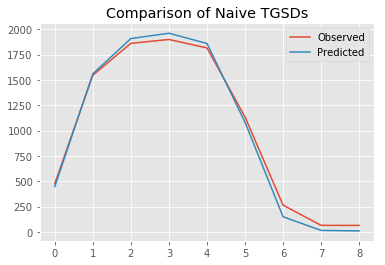

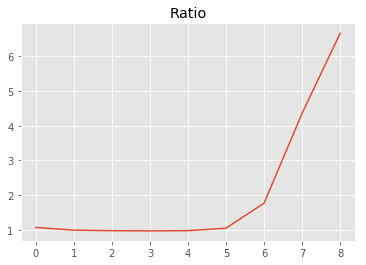

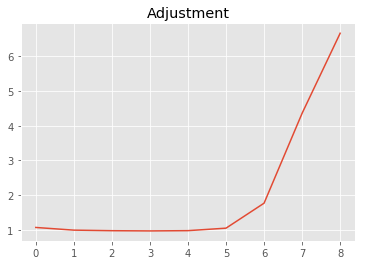

55011686268.05996
0.9999999999999997


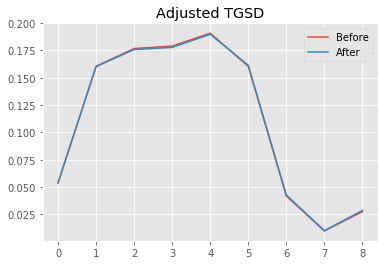

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00417 	1.47078 	26064.1 	3.33527 	6.94646 	13189.8 	6458 	2.73725e-05 	0
New Total Mass: 5.5e+10
After: 		|1.00417 	1.47078 	26492.6 	3.33527 	6.94646 	13189.8 	6458 	2.73725e-05 	0
Old Misfit: 5409.83
New Misfit: 5311.42
Convergence:
0.018190589974847116

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.97e+09 	4.52e+02 	4.77e+02 	1.0569 		0.0523
1 	8.81e+09 	1.57e+03 	1.55e+03 	0.9875 		0.1695
2 	9.66e+09 	1.90e+03 	1.86e+03 	0.9787 		0.2039
3 	9.77e+09 	1.94e+03 	1.90e+03 	0.9787 		0.2081
4 	1.04e+10 	1.83e+03 	1.82e+03 	0.9919 		0.1989
5 	8.87e+09 	1.07e+03 	1.13e+03 	1.0629 		0.1243
6 	2.35e+09 	1.49e+02 	2.64e+02 	1.7751 		0.0289
7 	5.57e+08 	1.47e+01 	6.43e+01 	4.3784 		0.0070
8 	1.57e+09 	9.70e+00 	6.40e+01 	6.5944 		0.0070


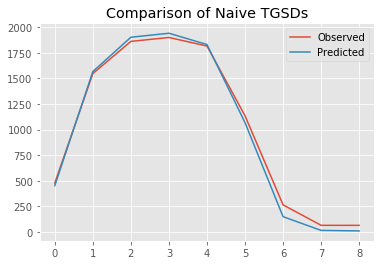

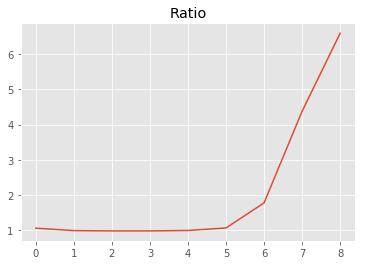

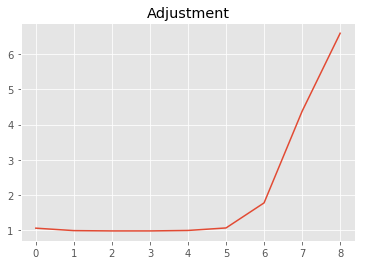

55085148278.637
0.9999999999999999


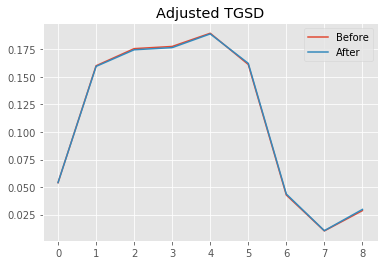

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00417 	1.47078 	26492.6 	3.33527 	6.94646 	13189.8 	6458 	2.73725e-05 	0
New Total Mass: 5.5e+10
After: 		|1.00324 	1.45479 	26899.8 	3.2633 	7.06774 	12585.6 	6458 	2.82744e-05 	0
Old Misfit: 5311.42
New Misfit: 5244.08
Convergence:
0.012679211724514592

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.97e+09 	4.60e+02 	4.77e+02 	1.0383 		0.0523
1 	8.78e+09 	1.60e+03 	1.55e+03 	0.9693 		0.1695
2 	9.61e+09 	1.94e+03 	1.86e+03 	0.9574 		0.2039
3 	9.72e+09 	1.99e+03 	1.90e+03 	0.9551 		0.2081
4 	1.04e+10 	1.87e+03 	1.82e+03 	0.9693 		0.1989
5 	8.93e+09 	1.09e+03 	1.13e+03 	1.0425 		0.1243
6 	2.40e+09 	1.52e+02 	2.64e+02 	1.7349 		0.0289
7 	5.69e+08 	1.50e+01 	6.43e+01 	4.2970 		0.0070
8 	1.63e+09 	9.78e+00 	6.40e+01 	6.5420 		0.0070


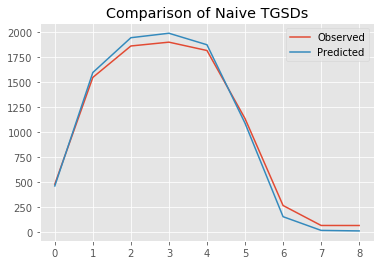

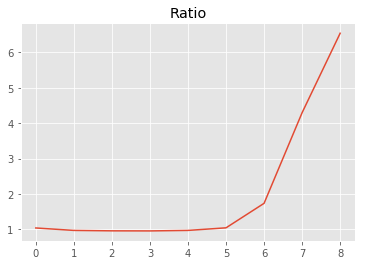

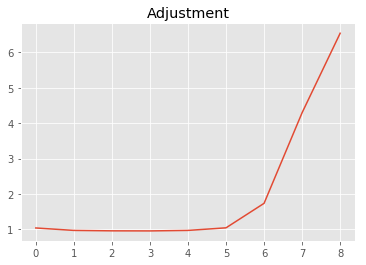

54897430779.39861
1.0


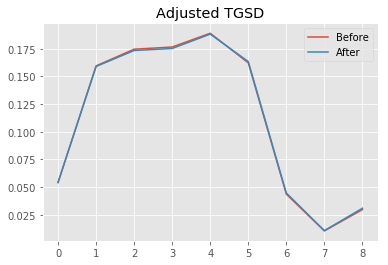

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00324 	1.45479 	26899.8 	3.2633 	7.06774 	12585.6 	6458 	2.82744e-05 	0
New Total Mass: 5.5e+10
After: 		|1.00257 	1.44052 	27270.1 	3.39534 	6.9177 	12452.4 	6458 	3.09131e-05 	0
Old Misfit: 5244.08
New Misfit: 5144.52
Convergence:
0.01898401468689499

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.98e+09 	4.60e+02 	4.77e+02 	1.0368 		0.0523
1 	8.75e+09 	1.58e+03 	1.55e+03 	0.9775 		0.1695
2 	9.54e+09 	1.92e+03 	1.86e+03 	0.9715 		0.2039
3 	9.64e+09 	1.95e+03 	1.90e+03 	0.9726 		0.2081
4 	1.04e+10 	1.84e+03 	1.82e+03 	0.9884 		0.1989
5 	8.99e+09 	1.07e+03 	1.13e+03 	1.0572 		0.1243
6 	2.45e+09 	1.52e+02 	2.64e+02 	1.7379 		0.0289
7 	5.84e+08 	1.50e+01 	6.43e+01 	4.2848 		0.0070
8 	1.70e+09 	1.01e+01 	6.40e+01 	6.3644 		0.0070


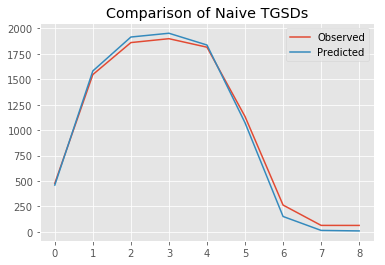

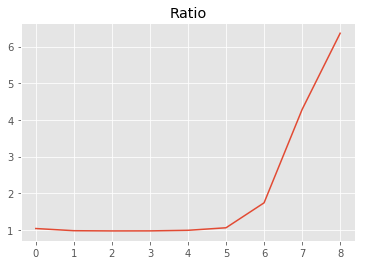

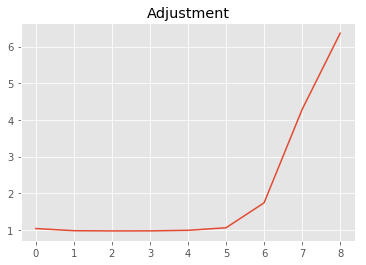

55031669590.51298
1.0000000000000002


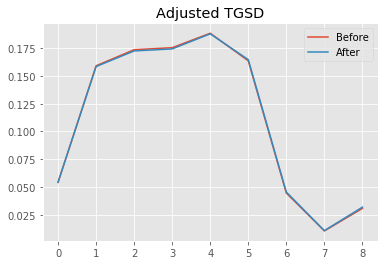

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00257 	1.44052 	27270.1 	3.39534 	6.9177 	12452.4 	6458 	3.09131e-05 	0
New Total Mass: 5.5e+10
After: 		|1.00203 	1.42643 	27642.5 	3.35174 	6.84184 	12110.8 	6458 	7.22787e-05 	0
Old Misfit: 5144.52
New Misfit: 5074.94
Convergence:
0.013526420992125003

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.99e+09 	4.61e+02 	4.77e+02 	1.0353 		0.0523
1 	8.71e+09 	1.58e+03 	1.55e+03 	0.9797 		0.1695
2 	9.48e+09 	1.91e+03 	1.86e+03 	0.9725 		0.2039
3 	9.58e+09 	1.96e+03 	1.90e+03 	0.9705 		0.2081
4 	1.03e+10 	1.85e+03 	1.82e+03 	0.9822 		0.1989
5 	9.05e+09 	1.09e+03 	1.13e+03 	1.0433 		0.1243
6 	2.51e+09 	1.56e+02 	2.64e+02 	1.6947 		0.0289
7 	5.97e+08 	1.55e+01 	6.43e+01 	4.1561 		0.0070
8 	1.76e+09 	1.06e+01 	6.40e+01 	6.0503 		0.0070


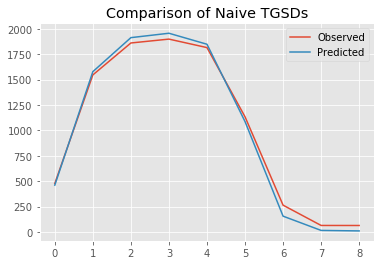

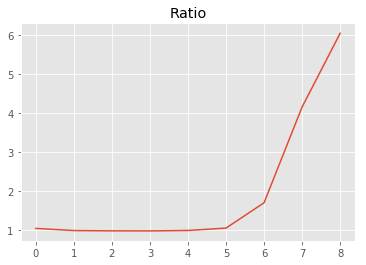

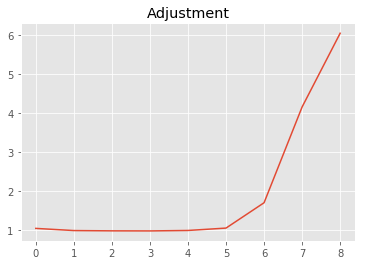

55001651409.82355
1.0


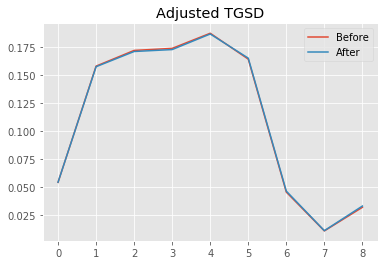

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00203 	1.42643 	27642.5 	3.35174 	6.84184 	12110.8 	6458 	7.22787e-05 	0
New Total Mass: 5.5e+10
After: 		|1.00203 	1.42643 	28122.8 	3.35174 	6.84184 	12110.8 	6458 	7.22787e-05 	0
Old Misfit: 5074.94
New Misfit: 5014.59
Convergence:
0.011891250101855527

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.99e+09 	4.63e+02 	4.77e+02 	1.0302 		0.0523
1 	8.68e+09 	1.58e+03 	1.55e+03 	0.9806 		0.1695
2 	9.43e+09 	1.90e+03 	1.86e+03 	0.9769 		0.2039
3 	9.52e+09 	1.94e+03 	1.90e+03 	0.9775 		0.2081
4 	1.03e+10 	1.83e+03 	1.82e+03 	0.9899 		0.1989
5 	9.10e+09 	1.08e+03 	1.13e+03 	1.0469 		0.1243
6 	2.56e+09 	1.57e+02 	2.64e+02 	1.6814 		0.0289
7 	6.10e+08 	1.56e+01 	6.43e+01 	4.1195 		0.0070
8 	1.82e+09 	1.08e+01 	6.40e+01 	5.9230 		0.0070


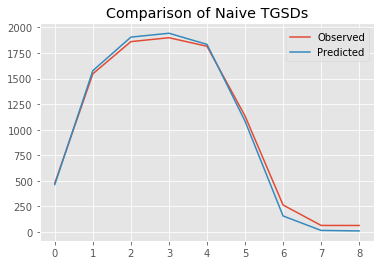

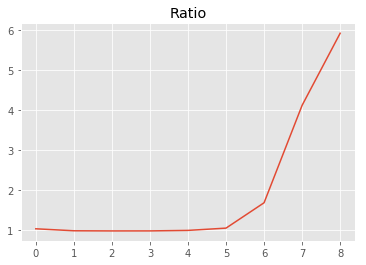

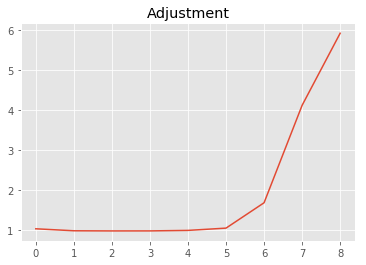

55046234022.19134
1.0


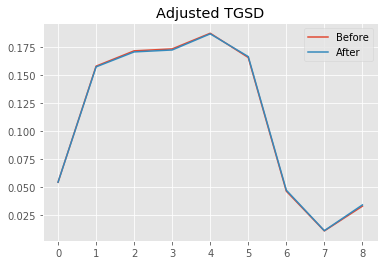

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00203 	1.42643 	28122.8 	3.35174 	6.84184 	12110.8 	6458 	7.22787e-05 	0
New Total Mass: 5.5e+10
After: 		|1.0022 	1.40818 	28630.4 	3.32276 	6.62776 	11360.9 	6458 	8.07662e-05 	0
Old Misfit: 5014.59
New Misfit: 4936.84
Convergence:
0.015505736095229539

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.00e+09 	4.62e+02 	4.77e+02 	1.0338 		0.0523
1 	8.64e+09 	1.57e+03 	1.55e+03 	0.9854 		0.1695
2 	9.38e+09 	1.91e+03 	1.86e+03 	0.9766 		0.2039
3 	9.47e+09 	1.96e+03 	1.90e+03 	0.9699 		0.2081
4 	1.03e+10 	1.86e+03 	1.82e+03 	0.9768 		0.1989
5 	9.15e+09 	1.10e+03 	1.13e+03 	1.0277 		0.1243
6 	2.60e+09 	1.62e+02 	2.64e+02 	1.6315 		0.0289
7 	6.23e+08 	1.63e+01 	6.43e+01 	3.9476 		0.0070
8 	1.88e+09 	1.16e+01 	6.40e+01 	5.5144 		0.0070


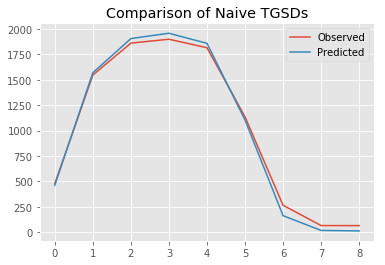

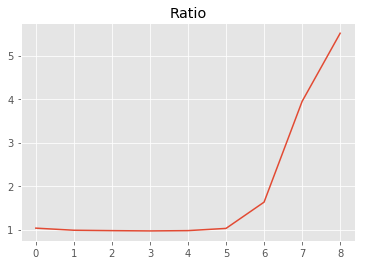

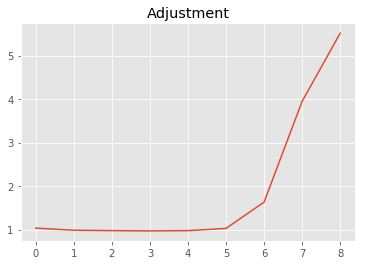

54984077665.19498
1.0


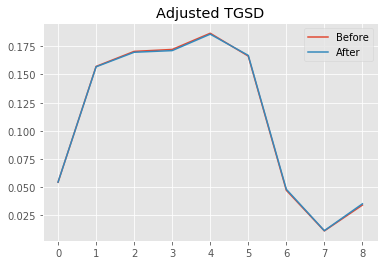

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.0022 	1.40818 	28630.4 	3.32276 	6.62776 	11360.9 	6458 	8.07662e-05 	0
New Total Mass: 5.5e+10
After: 		|1.00183 	1.39744 	28934.4 	3.26662 	6.82496 	11536.2 	6458 	9.68097e-05 	0
Old Misfit: 4936.84
New Misfit: 4879.87
Convergence:
0.011538357088735086

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.00e+09 	4.71e+02 	4.77e+02 	1.0132 		0.0523
1 	8.62e+09 	1.59e+03 	1.55e+03 	0.9702 		0.1695
2 	9.33e+09 	1.92e+03 	1.86e+03 	0.9676 		0.2039
3 	9.41e+09 	1.96e+03 	1.90e+03 	0.9697 		0.2081
4 	1.02e+10 	1.84e+03 	1.82e+03 	0.9857 		0.1989
5 	9.18e+09 	1.09e+03 	1.13e+03 	1.0433 		0.1243
6 	2.65e+09 	1.60e+02 	2.64e+02 	1.6484 		0.0289
7 	6.36e+08 	1.60e+01 	6.43e+01 	4.0186 		0.0070
8 	1.94e+09 	1.13e+01 	6.40e+01 	5.6786 		0.0070


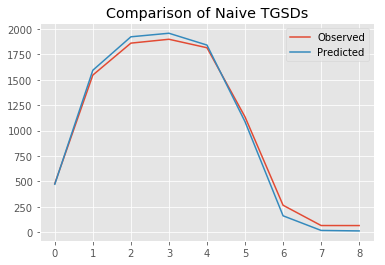

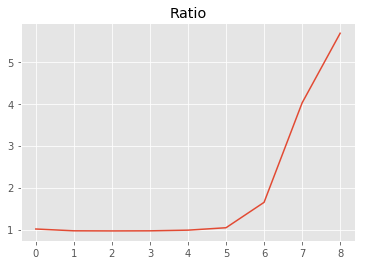

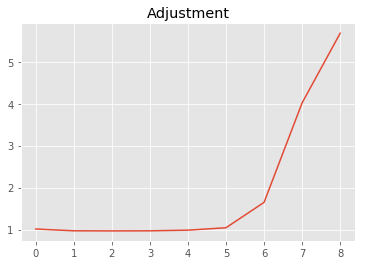

54984943941.356804
1.0000000000000002


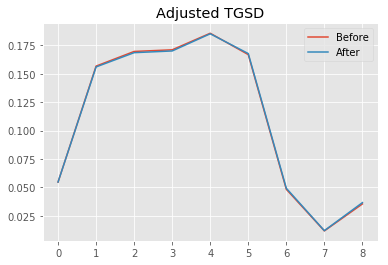

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00183 	1.39744 	28934.4 	3.26662 	6.82496 	11536.2 	6458 	9.68097e-05 	0
New Total Mass: 5.5e+10
After: 		|1.00281 	1.37818 	29490.1 	3.37634 	6.71657 	11168.7 	6458 	0.000105349 	0
Old Misfit: 4879.87
New Misfit: 4805.06
Convergence:
0.015329840227224865

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.00e+09 	4.73e+02 	4.77e+02 	1.0090 		0.0523
1 	8.58e+09 	1.59e+03 	1.55e+03 	0.9721 		0.1695
2 	9.27e+09 	1.92e+03 	1.86e+03 	0.9712 		0.2039
3 	9.36e+09 	1.95e+03 	1.90e+03 	0.9744 		0.2081
4 	1.02e+10 	1.83e+03 	1.82e+03 	0.9937 		0.1989
5 	9.23e+09 	1.07e+03 	1.13e+03 	1.0562 		0.1243
6 	2.70e+09 	1.59e+02 	2.64e+02 	1.6608 		0.0289
7 	6.50e+08 	1.59e+01 	6.43e+01 	4.0350 		0.0070
8 	2.01e+09 	1.13e+01 	6.40e+01 	5.6424 		0.0070


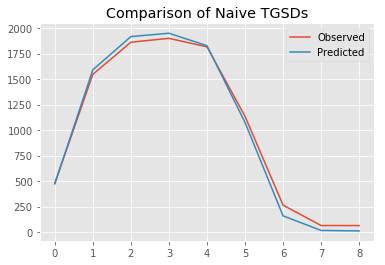

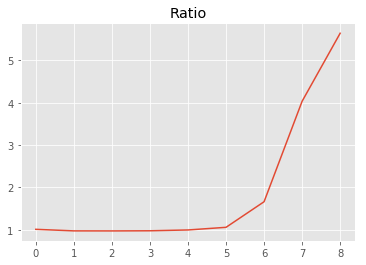

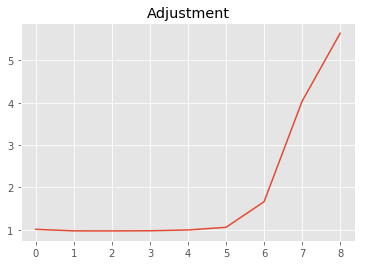

55039250437.07251
1.0000000000000002


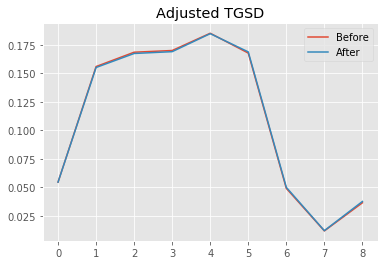

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00281 	1.37818 	29490.1 	3.37634 	6.71657 	11168.7 	6458 	0.000105349 	0
New Total Mass: 5.5e+10
After: 		|1.00222 	1.36369 	29917.4 	3.33481 	6.62529 	10802.6 	6458 	0.000221714 	0
Old Misfit: 4805.06
New Misfit: 4747.95
Convergence:
0.011886514879611695

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.00e+09 	4.72e+02 	4.77e+02 	1.0107 		0.0523
1 	8.54e+09 	1.58e+03 	1.55e+03 	0.9764 		0.1695
2 	9.21e+09 	1.91e+03 	1.86e+03 	0.9724 		0.2039
3 	9.30e+09 	1.96e+03 	1.90e+03 	0.9707 		0.2081
4 	1.02e+10 	1.85e+03 	1.82e+03 	0.9839 		0.1989
5 	9.29e+09 	1.09e+03 	1.13e+03 	1.0392 		0.1243
6 	2.75e+09 	1.63e+02 	2.64e+02 	1.6183 		0.0289
7 	6.63e+08 	1.65e+01 	6.43e+01 	3.9036 		0.0070
8 	2.07e+09 	1.19e+01 	6.40e+01 	5.3549 		0.0070


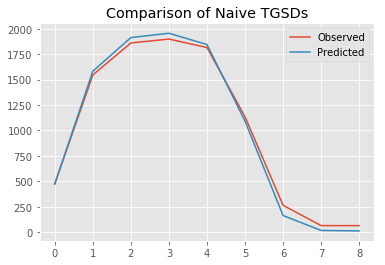

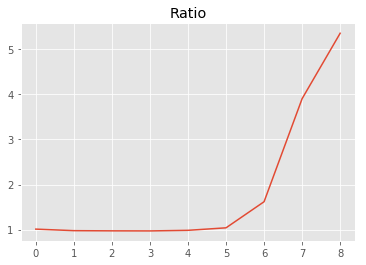

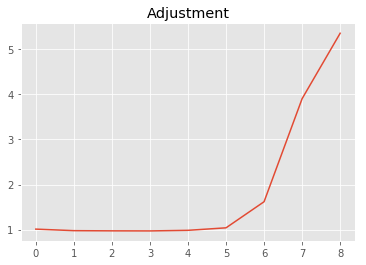

54997990829.61782
0.9999999999999999


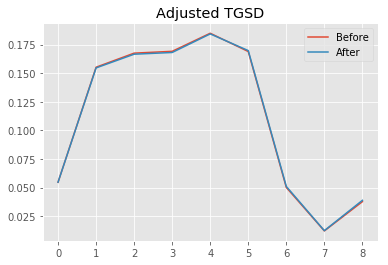

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00222 	1.36369 	29917.4 	3.33481 	6.62529 	10802.6 	6458 	0.000221714 	0
New Total Mass: 5.5e+10
After: 		|1.00163 	1.34564 	30460.9 	3.22941 	6.65013 	10470.6 	6458 	0.000219218 	0
Old Misfit: 4747.95
New Misfit: 4678.65
Convergence:
0.014594831715678774

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.01e+09 	4.79e+02 	4.77e+02 	0.9977 		0.0523
1 	8.50e+09 	1.60e+03 	1.55e+03 	0.9661 		0.1695
2 	9.16e+09 	1.93e+03 	1.86e+03 	0.9622 		0.2039
3 	9.24e+09 	1.97e+03 	1.90e+03 	0.9617 		0.2081
4 	1.01e+10 	1.85e+03 	1.82e+03 	0.9787 		0.1989
5 	9.34e+09 	1.09e+03 	1.13e+03 	1.0387 		0.1243
6 	2.80e+09 	1.64e+02 	2.64e+02 	1.6097 		0.0289
7 	6.77e+08 	1.66e+01 	6.43e+01 	3.8708 		0.0070
8 	2.13e+09 	1.21e+01 	6.40e+01 	5.2799 		0.0070


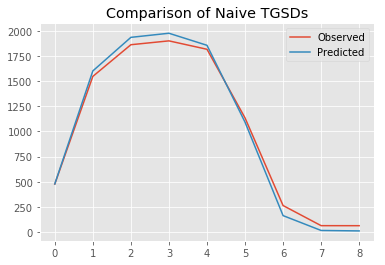

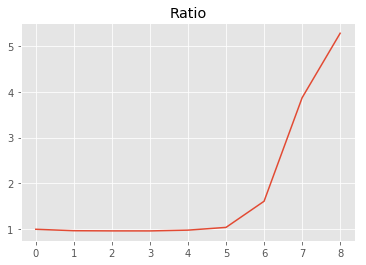

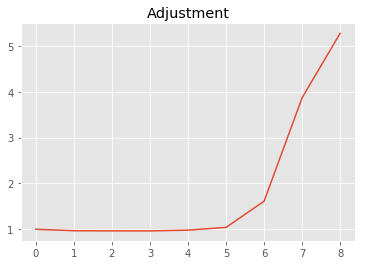

54935620251.01843
1.0000000000000002


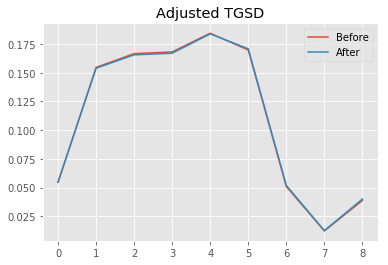

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00163 	1.34564 	30460.9 	3.22941 	6.65013 	10470.6 	6458 	0.000219218 	0
New Total Mass: 5.5e+10
After: 		|1.00224 	1.32027 	31247.3 	3.17066 	6.50931 	10032.7 	6458 	0.000265401 	0
Old Misfit: 4678.65
New Misfit: 4620.76
Convergence:
0.012373287933492582

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.01e+09 	4.78e+02 	4.77e+02 	0.9989 		0.0523
1 	8.46e+09 	1.59e+03 	1.55e+03 	0.9703 		0.1695
2 	9.10e+09 	1.93e+03 	1.86e+03 	0.9635 		0.2039
3 	9.18e+09 	1.98e+03 	1.90e+03 	0.9578 		0.2081
4 	1.01e+10 	1.87e+03 	1.82e+03 	0.9693 		0.1989
5 	9.39e+09 	1.11e+03 	1.13e+03 	1.0237 		0.1243
6 	2.85e+09 	1.68e+02 	2.64e+02 	1.5749 		0.0289
7 	6.91e+08 	1.71e+01 	6.43e+01 	3.7538 		0.0070
8 	2.20e+09 	1.28e+01 	6.40e+01 	4.9944 		0.0070


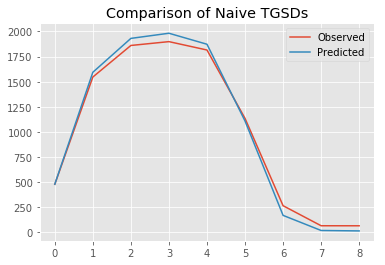

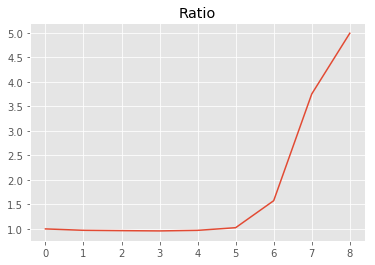

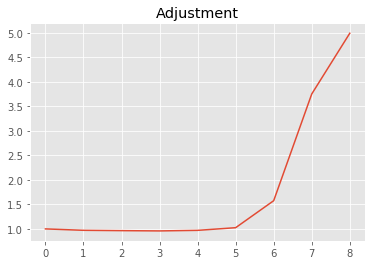

54897432969.103195
1.0


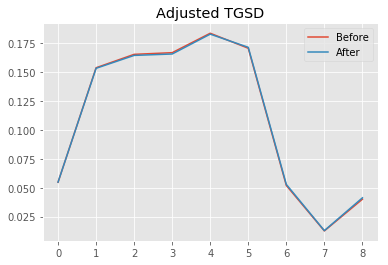

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00224 	1.32027 	31247.3 	3.17066 	6.50931 	10032.7 	6458 	0.000265401 	0
New Total Mass: 5.5e+10
After: 		|1.00224 	1.32027 	31812.7 	3.17066 	6.50931 	10032.7 	6458 	0.000265401 	0
Old Misfit: 4620.76
New Misfit: 4557.55
Convergence:
0.013680608247534864

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.01e+09 	4.82e+02 	4.77e+02 	0.9903 		0.0523
1 	8.44e+09 	1.60e+03 	1.55e+03 	0.9687 		0.1695
2 	9.05e+09 	1.92e+03 	1.86e+03 	0.9678 		0.2039
3 	9.12e+09 	1.96e+03 	1.90e+03 	0.9685 		0.2081
4 	1.01e+10 	1.84e+03 	1.82e+03 	0.9857 		0.1989
5 	9.44e+09 	1.09e+03 	1.13e+03 	1.0415 		0.1243
6 	2.91e+09 	1.66e+02 	2.64e+02 	1.5883 		0.0289
7 	7.06e+08 	1.70e+01 	6.43e+01 	3.7785 		0.0070
8 	2.27e+09 	1.28e+01 	6.40e+01 	4.9865 		0.0070


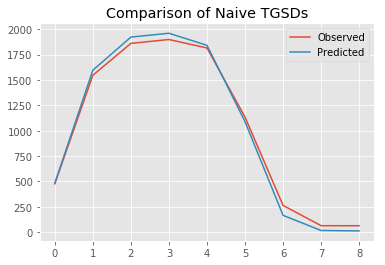

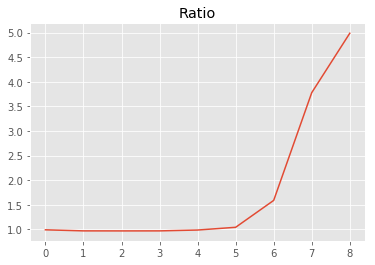

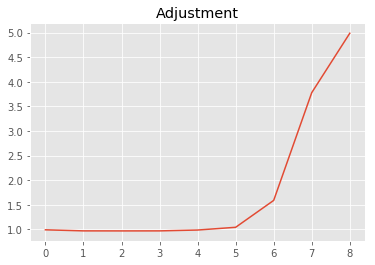

54981437325.06995
1.0


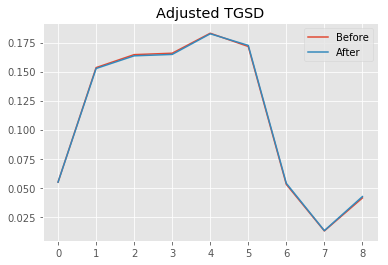

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00224 	1.32027 	31812.7 	3.17066 	6.50931 	10032.7 	6458 	0.000265401 	0
New Total Mass: 5.5e+10
After: 		|1.00224 	1.32027 	32386.5 	3.17066 	6.50931 	10032.7 	6458 	0.000265401 	0
Old Misfit: 4557.55
New Misfit: 4510.07
Convergence:
0.010416618270336932

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.01e+09 	4.85e+02 	4.77e+02 	0.9847 		0.0523
1 	8.39e+09 	1.59e+03 	1.55e+03 	0.9696 		0.1695
2 	8.99e+09 	1.91e+03 	1.86e+03 	0.9732 		0.2039
3 	9.06e+09 	1.94e+03 	1.90e+03 	0.9784 		0.2081
4 	1.00e+10 	1.82e+03 	1.82e+03 	0.9995 		0.1989
5 	9.49e+09 	1.07e+03 	1.13e+03 	1.0565 		0.1243
6 	2.96e+09 	1.65e+02 	2.64e+02 	1.5993 		0.0289
7 	7.20e+08 	1.69e+01 	6.43e+01 	3.7978 		0.0070
8 	2.33e+09 	1.29e+01 	6.40e+01 	4.9726 		0.0070


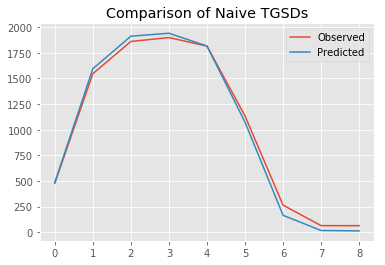

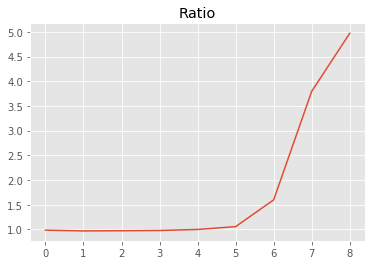

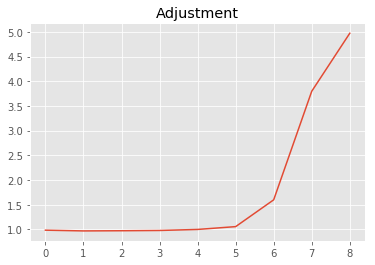

55060443740.25422
1.0


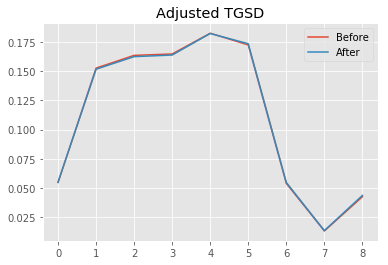

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00224 	1.32027 	32386.5 	3.17066 	6.50931 	10032.7 	6458 	0.000265401 	0
New Total Mass: 5.5e+10
After: 		|1.00164 	1.31857 	32982.5 	3.14325 	6.30563 	9423.54 	6458 	0.000260315 	0
Old Misfit: 4510.07
New Misfit: 4457.97
Convergence:
0.011552753680113829

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.01e+09 	4.79e+02 	4.77e+02 	0.9975 		0.0523
1 	8.34e+09 	1.57e+03 	1.55e+03 	0.9824 		0.1695
2 	8.94e+09 	1.90e+03 	1.86e+03 	0.9771 		0.2039
3 	9.01e+09 	1.96e+03 	1.90e+03 	0.9693 		0.2081
4 	1.00e+10 	1.86e+03 	1.82e+03 	0.9757 		0.1989
5 	9.54e+09 	1.11e+03 	1.13e+03 	1.0191 		0.1243
6 	3.01e+09 	1.73e+02 	2.64e+02 	1.5250 		0.0289
7 	7.34e+08 	1.80e+01 	6.43e+01 	3.5683 		0.0070
8 	2.39e+09 	1.41e+01 	6.40e+01 	4.5375 		0.0070


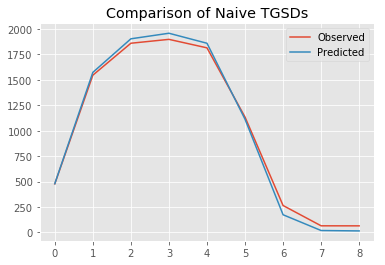

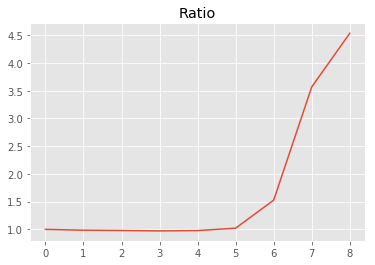

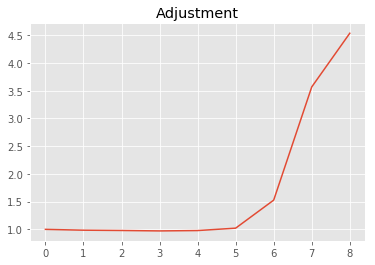

54967854918.988335
1.0000000000000002


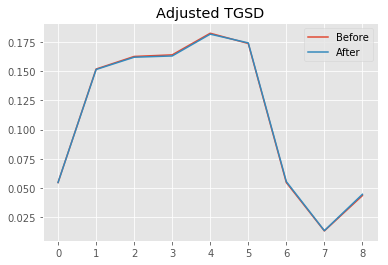

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00164 	1.31857 	32982.5 	3.14325 	6.30563 	9423.54 	6458 	0.000260315 	0
New Total Mass: 5.5e+10
After: 		|1.00164 	1.31857 	33568.8 	3.14325 	6.30563 	9423.54 	6458 	0.000260315 	0
Old Misfit: 4457.97
New Misfit: 4406.46
Convergence:
0.011555673223022379

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.01e+09 	4.82e+02 	4.77e+02 	0.9913 		0.0523
1 	8.32e+09 	1.58e+03 	1.55e+03 	0.9808 		0.1695
2 	8.90e+09 	1.90e+03 	1.86e+03 	0.9803 		0.2039
3 	8.96e+09 	1.94e+03 	1.90e+03 	0.9786 		0.2081
4 	9.98e+09 	1.83e+03 	1.82e+03 	0.9910 		0.1989
5 	9.57e+09 	1.09e+03 	1.13e+03 	1.0365 		0.1243
6 	3.05e+09 	1.72e+02 	2.64e+02 	1.5381 		0.0289
7 	7.47e+08 	1.79e+01 	6.43e+01 	3.5911 		0.0070
8 	2.45e+09 	1.41e+01 	6.40e+01 	4.5377 		0.0070


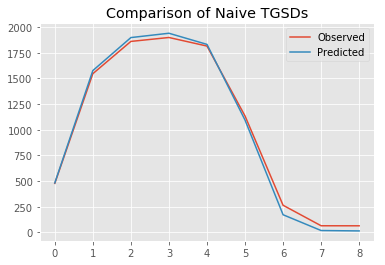

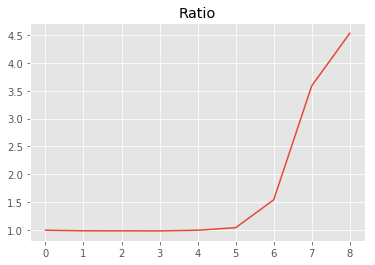

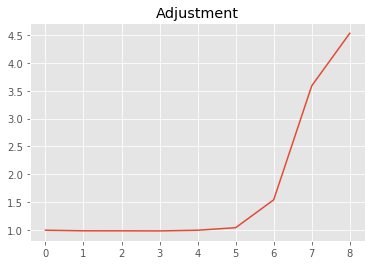

55043691031.45176
0.9999999999999999


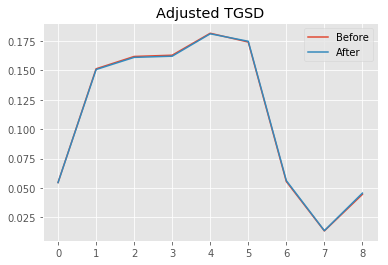

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00164 	1.31857 	33568.8 	3.14325 	6.30563 	9423.54 	6458 	0.000260315 	0
New Total Mass: 5.5e+10
After: 		|1.00217 	1.29162 	34469.4 	3.02254 	6.40929 	8718.1 	6458 	0.000374872 	0
Old Misfit: 4406.46
New Misfit: 4358.88
Convergence:
0.010796243711188622

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.01e+09 	4.93e+02 	4.77e+02 	0.9693 		0.0523
1 	8.29e+09 	1.62e+03 	1.55e+03 	0.9548 		0.1695
2 	8.86e+09 	1.96e+03 	1.86e+03 	0.9477 		0.2039
3 	8.91e+09 	2.01e+03 	1.90e+03 	0.9435 		0.2081
4 	9.96e+09 	1.88e+03 	1.82e+03 	0.9638 		0.1989
5 	9.61e+09 	1.10e+03 	1.13e+03 	1.0284 		0.1243
6 	3.10e+09 	1.72e+02 	2.64e+02 	1.5324 		0.0289
7 	7.60e+08 	1.80e+01 	6.43e+01 	3.5651 		0.0070
8 	2.51e+09 	1.40e+01 	6.40e+01 	4.5858 		0.0070


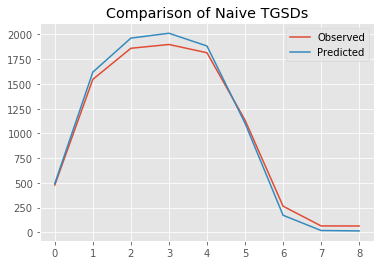

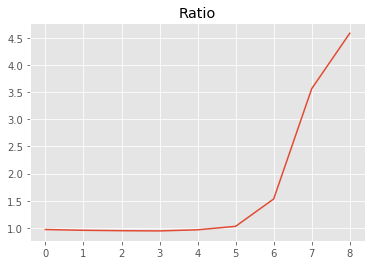

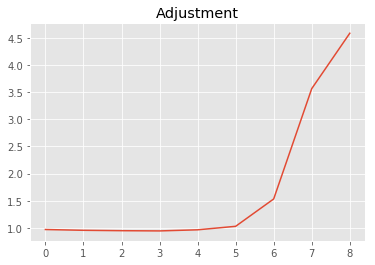

54819397500.3226
0.9999999999999999


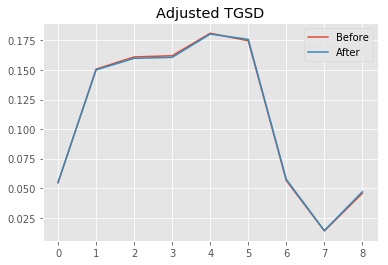

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00217 	1.29162 	34469.4 	3.02254 	6.40929 	8718.1 	6458 	0.000374872 	0
New Total Mass: 5.5e+10
After: 		|1.00163 	1.28985 	35025.3 	3.00116 	6.1698 	8626.68 	6458 	0.000335009 	0
Old Misfit: 4358.88
New Misfit: 4308.7
Convergence:
0.011512969694714738

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.01e+09 	4.84e+02 	4.77e+02 	0.9858 		0.0523
1 	8.25e+09 	1.58e+03 	1.55e+03 	0.9786 		0.1695
2 	8.79e+09 	1.91e+03 	1.86e+03 	0.9727 		0.2039
3 	8.84e+09 	1.97e+03 	1.90e+03 	0.9632 		0.2081
4 	9.92e+09 	1.87e+03 	1.82e+03 	0.9686 		0.1989
5 	9.67e+09 	1.12e+03 	1.13e+03 	1.0096 		0.1243
6 	3.16e+09 	1.78e+02 	2.64e+02 	1.4813 		0.0289
7 	7.77e+08 	1.89e+01 	6.43e+01 	3.4035 		0.0070
8 	2.59e+09 	1.53e+01 	6.40e+01 	4.1795 		0.0070


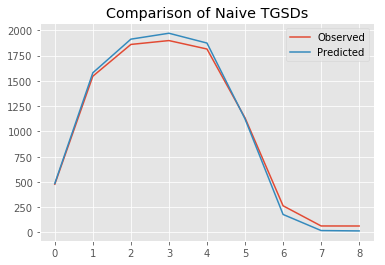

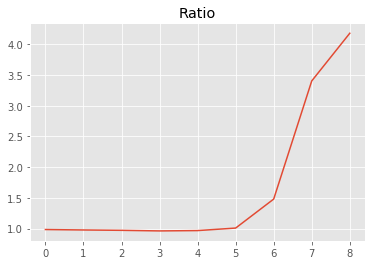

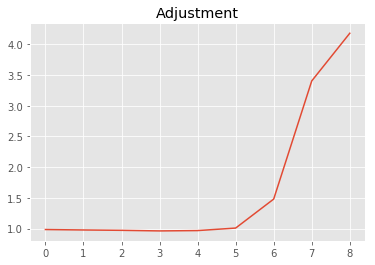

54915538547.09855
1.0


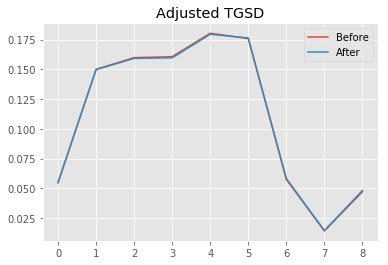

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00163 	1.28985 	35025.3 	3.00116 	6.1698 	8626.68 	6458 	0.000335009 	0
New Total Mass: 5.5e+10
After: 		|1.00163 	1.28985 	35615.7 	3.00116 	6.1698 	8626.68 	6458 	0.000335009 	0
Old Misfit: 4308.7
New Misfit: 4262.48
Convergence:
0.010727270044326432

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.01e+09 	4.87e+02 	4.77e+02 	0.9800 		0.0523
1 	8.24e+09 	1.58e+03 	1.55e+03 	0.9773 		0.1695
2 	8.75e+09 	1.91e+03 	1.86e+03 	0.9761 		0.2039
3 	8.78e+09 	1.95e+03 	1.90e+03 	0.9728 		0.2081
4 	9.87e+09 	1.85e+03 	1.82e+03 	0.9840 		0.1989
5 	9.70e+09 	1.11e+03 	1.13e+03 	1.0263 		0.1243
6 	3.21e+09 	1.77e+02 	2.64e+02 	1.4927 		0.0289
7 	7.91e+08 	1.88e+01 	6.43e+01 	3.4213 		0.0070
8 	2.65e+09 	1.53e+01 	6.40e+01 	4.1804 		0.0070


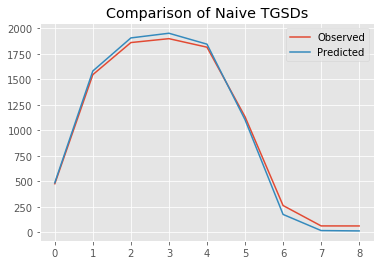

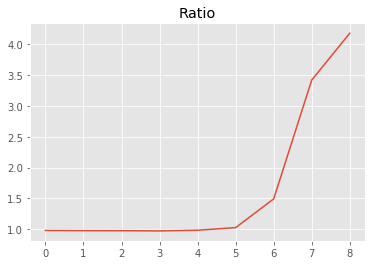

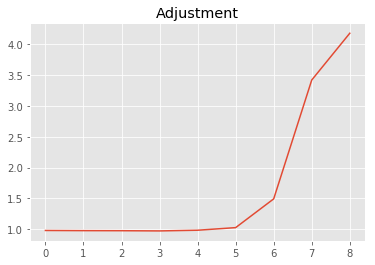

54991354353.08309
1.0000000000000002


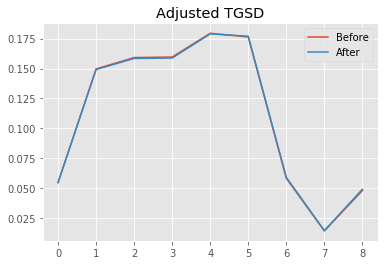

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00163 	1.28985 	35615.7 	3.00116 	6.1698 	8626.68 	6458 	0.000335009 	0
New Total Mass: 5.5e+10
After: 		|1.00244 	1.26957 	36300 	3.10948 	6.12542 	8100.07 	6458 	0.000446403 	0
Old Misfit: 4262.48
New Misfit: 4226.43
Convergence:
0.008457281022580898

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.01e+09 	4.89e+02 	4.77e+02 	0.9757 		0.0523
1 	8.20e+09 	1.59e+03 	1.55e+03 	0.9727 		0.1695
2 	8.71e+09 	1.92e+03 	1.86e+03 	0.9672 		0.2039
3 	8.73e+09 	1.98e+03 	1.90e+03 	0.9604 		0.2081
4 	9.84e+09 	1.87e+03 	1.82e+03 	0.9734 		0.1989
5 	9.73e+09 	1.11e+03 	1.13e+03 	1.0254 		0.1243
6 	3.25e+09 	1.77e+02 	2.64e+02 	1.4904 		0.0289
7 	8.05e+08 	1.89e+01 	6.43e+01 	3.3977 		0.0070
8 	2.71e+09 	1.53e+01 	6.40e+01 	4.1818 		0.0070


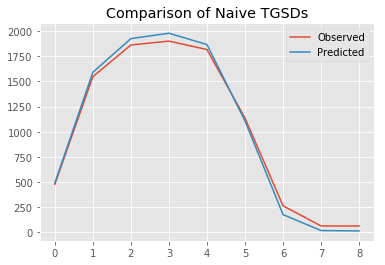

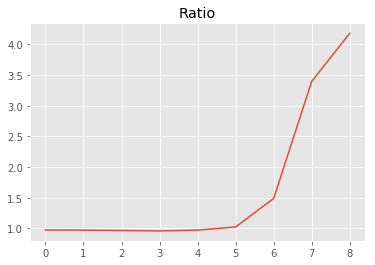

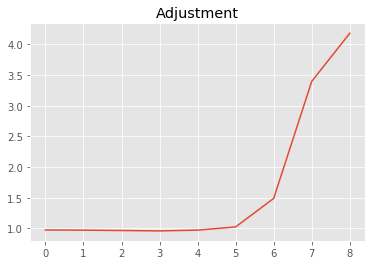

54926800218.276535
0.9999999999999998


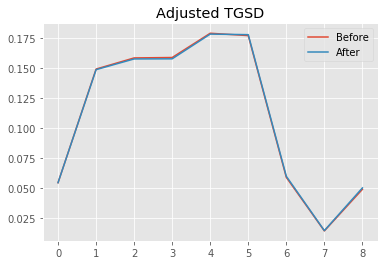

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00244 	1.26957 	36300 	3.10948 	6.12542 	8100.07 	6458 	0.000446403 	0
New Total Mass: 5.5e+10
After: 		|1.00244 	1.26957 	36879.8 	3.10948 	6.12542 	8100.07 	6458 	0.000446403 	0
Old Misfit: 4226.43
New Misfit: 4185.65
Convergence:
0.00964852754283166

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.01e+09 	4.92e+02 	4.77e+02 	0.9709 		0.0523
1 	8.18e+09 	1.59e+03 	1.55e+03 	0.9728 		0.1695
2 	8.67e+09 	1.91e+03 	1.86e+03 	0.9722 		0.2039
3 	8.67e+09 	1.96e+03 	1.90e+03 	0.9711 		0.2081
4 	9.80e+09 	1.84e+03 	1.82e+03 	0.9887 		0.1989
5 	9.78e+09 	1.09e+03 	1.13e+03 	1.0413 		0.1243
6 	3.30e+09 	1.76e+02 	2.64e+02 	1.5023 		0.0289
7 	8.19e+08 	1.88e+01 	6.43e+01 	3.4169 		0.0070
8 	2.77e+09 	1.53e+01 	6.40e+01 	4.1840 		0.0070


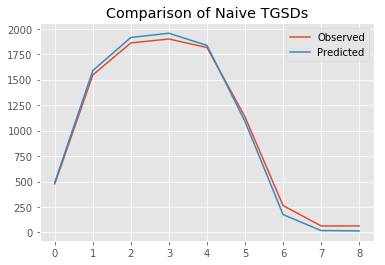

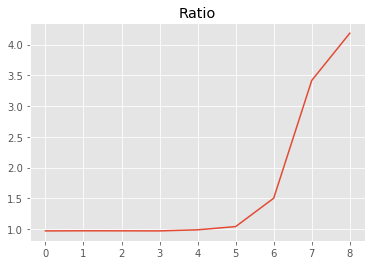

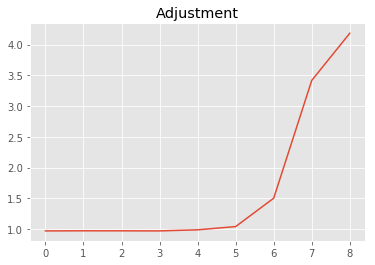

55008312809.35492
1.0


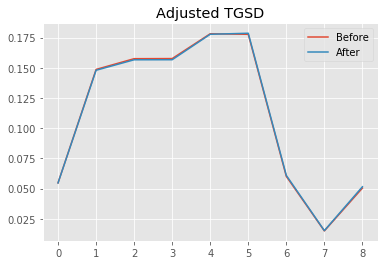

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00244 	1.26957 	36879.8 	3.10948 	6.12542 	8100.07 	6458 	0.000446403 	0
New Total Mass: 5.5e+10
After: 		|1.00216 	1.26241 	37119.1 	2.97346 	6.08592 	7919.75 	6458 	0.000380991 	0
Old Misfit: 4185.65
New Misfit: 4155.47
Convergence:
0.00721154599116349

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.01e+09 	4.90e+02 	4.77e+02 	0.9738 		0.0523
1 	8.14e+09 	1.58e+03 	1.55e+03 	0.9760 		0.1695
2 	8.62e+09 	1.91e+03 	1.86e+03 	0.9719 		0.2039
3 	8.62e+09 	1.97e+03 	1.90e+03 	0.9651 		0.2081
4 	9.78e+09 	1.87e+03 	1.82e+03 	0.9730 		0.1989
5 	9.83e+09 	1.12e+03 	1.13e+03 	1.0139 		0.1243
6 	3.35e+09 	1.82e+02 	2.64e+02 	1.4498 		0.0289
7 	8.33e+08 	1.97e+01 	6.43e+01 	3.2730 		0.0070
8 	2.83e+09 	1.63e+01 	6.40e+01 	3.9329 		0.0070


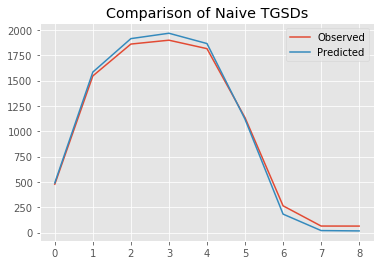

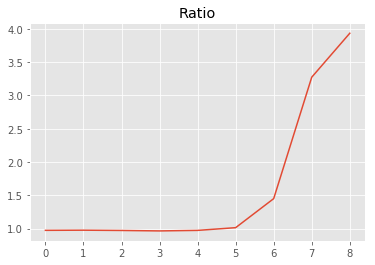

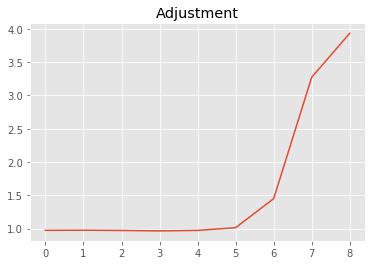

54930459958.99418
0.9999999999999998


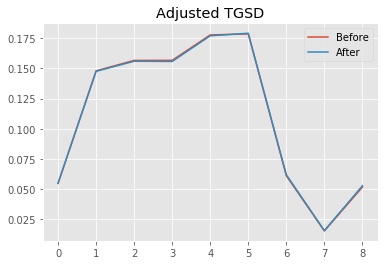

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00216 	1.26241 	37119.1 	2.97346 	6.08592 	7919.75 	6458 	0.000380991 	0
New Total Mass: 5.5e+10
After: 		|1.00216 	1.26241 	37686.2 	2.97346 	6.08592 	7919.75 	6458 	0.000380991 	0
Old Misfit: 4155.47
New Misfit: 4119.38
Convergence:
0.00868305560282758

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.00e+09 	4.92e+02 	4.77e+02 	0.9697 		0.0523
1 	8.12e+09 	1.58e+03 	1.55e+03 	0.9761 		0.1695
2 	8.58e+09 	1.91e+03 	1.86e+03 	0.9762 		0.2039
3 	8.57e+09 	1.95e+03 	1.90e+03 	0.9747 		0.2081
4 	9.74e+09 	1.84e+03 	1.82e+03 	0.9876 		0.1989
5 	9.86e+09 	1.10e+03 	1.13e+03 	1.0297 		0.1243
6 	3.40e+09 	1.81e+02 	2.64e+02 	1.4608 		0.0289
7 	8.48e+08 	1.96e+01 	6.43e+01 	3.2890 		0.0070
8 	2.89e+09 	1.63e+01 	6.40e+01 	3.9354 		0.0070


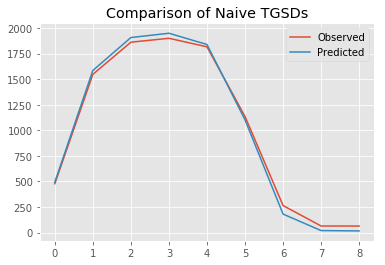

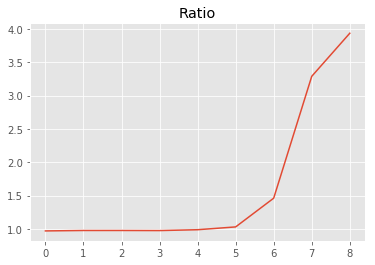

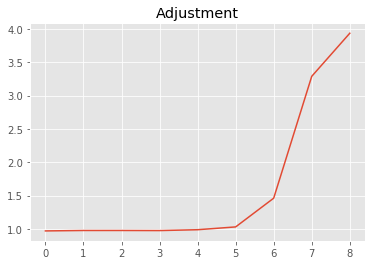

55006542908.34944
1.0


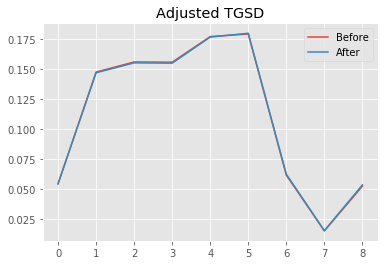

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00216 	1.26241 	37686.2 	2.97346 	6.08592 	7919.75 	6458 	0.000380991 	0
New Total Mass: 5.5e+10
After: 		|1.00171 	1.2496 	38105.3 	2.97547 	6.01443 	7602.34 	6458 	0.000738205 	0
Old Misfit: 4119.38
New Misfit: 4089.91
Convergence:
0.007155321385772734

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.00e+09 	4.91e+02 	4.77e+02 	0.9727 		0.0523
1 	8.08e+09 	1.58e+03 	1.55e+03 	0.9795 		0.1695
2 	8.54e+09 	1.91e+03 	1.86e+03 	0.9758 		0.2039
3 	8.52e+09 	1.96e+03 	1.90e+03 	0.9691 		0.2081
4 	9.71e+09 	1.86e+03 	1.82e+03 	0.9768 		0.1989
5 	9.89e+09 	1.12e+03 	1.13e+03 	1.0163 		0.1243
6 	3.44e+09 	1.84e+02 	2.64e+02 	1.4339 		0.0289
7 	8.61e+08 	2.01e+01 	6.43e+01 	3.2033 		0.0070
8 	2.95e+09 	1.69e+01 	6.40e+01 	3.7943 		0.0070


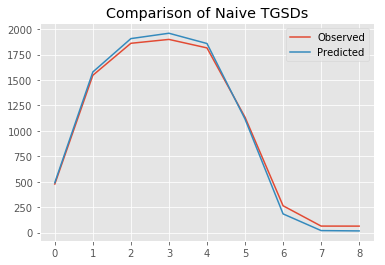

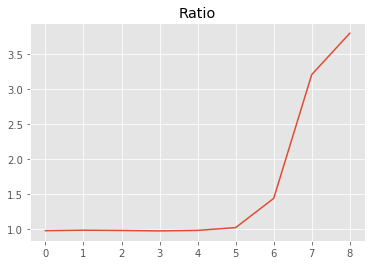

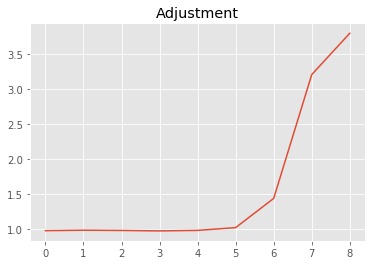

54960302293.3771
1.0


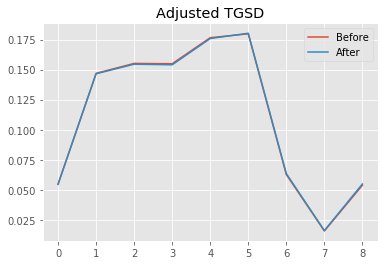

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00171 	1.2496 	38105.3 	2.97547 	6.01443 	7602.34 	6458 	0.000738205 	0
New Total Mass: 5.5e+10
After: 		|1.00171 	1.2496 	38649.9 	2.97547 	6.01443 	7602.34 	6458 	0.000738205 	0
Old Misfit: 4089.91
New Misfit: 4058.28
Convergence:
0.007732136895455541

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.00e+09 	4.92e+02 	4.77e+02 	0.9696 		0.0523
1 	8.06e+09 	1.58e+03 	1.55e+03 	0.9798 		0.1695
2 	8.50e+09 	1.90e+03 	1.86e+03 	0.9800 		0.2039
3 	8.47e+09 	1.94e+03 	1.90e+03 	0.9784 		0.2081
4 	9.68e+09 	1.83e+03 	1.82e+03 	0.9908 		0.1989
5 	9.92e+09 	1.10e+03 	1.13e+03 	1.0315 		0.1243
6 	3.49e+09 	1.83e+02 	2.64e+02 	1.4445 		0.0289
7 	8.75e+08 	2.00e+01 	6.43e+01 	3.2182 		0.0070
8 	3.01e+09 	1.68e+01 	6.40e+01 	3.7975 		0.0070


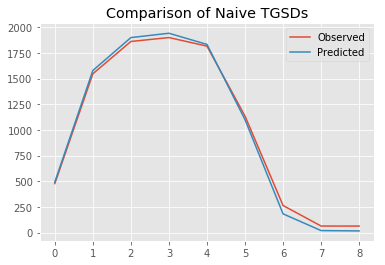

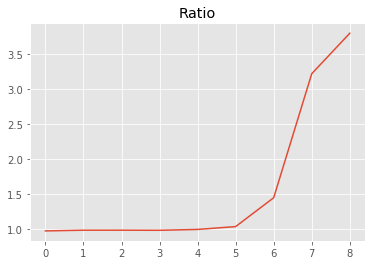

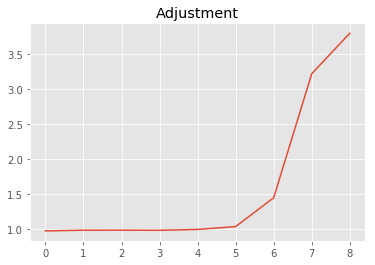

55033662025.35572
1.0000000000000002


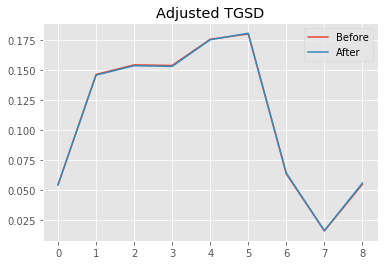

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00171 	1.2496 	38649.9 	2.97547 	6.01443 	7602.34 	6458 	0.000738205 	0
New Total Mass: 5.5e+10
After: 		|1.00126 	1.24915 	39157.7 	2.92694 	5.96793 	7219.01 	6458 	0.000743713 	0
Old Misfit: 4058.28
New Misfit: 4033.05
Convergence:
0.006218005232236677

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.99e+09 	4.91e+02 	4.77e+02 	0.9717 		0.0523
1 	8.03e+09 	1.58e+03 	1.55e+03 	0.9800 		0.1695
2 	8.46e+09 	1.91e+03 	1.86e+03 	0.9739 		0.2039
3 	8.43e+09 	1.97e+03 	1.90e+03 	0.9643 		0.2081
4 	9.65e+09 	1.87e+03 	1.82e+03 	0.9690 		0.1989
5 	9.95e+09 	1.13e+03 	1.13e+03 	1.0053 		0.1243
6 	3.53e+09 	1.89e+02 	2.64e+02 	1.3983 		0.0289
7 	8.88e+08 	2.08e+01 	6.43e+01 	3.0861 		0.0070
8 	3.07e+09 	1.77e+01 	6.40e+01 	3.6096 		0.0070


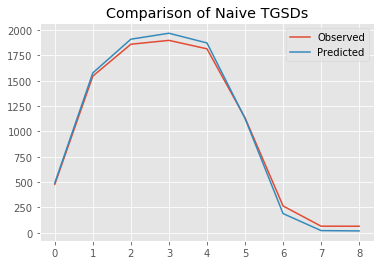

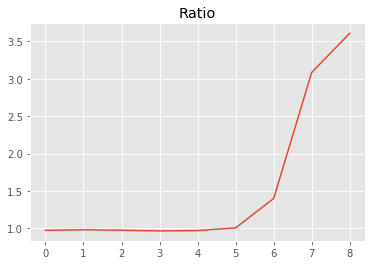

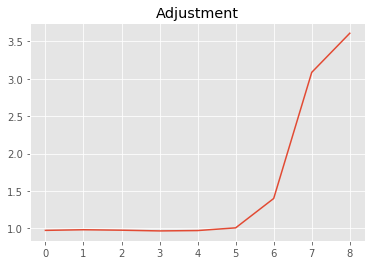

54917795110.44131
1.0


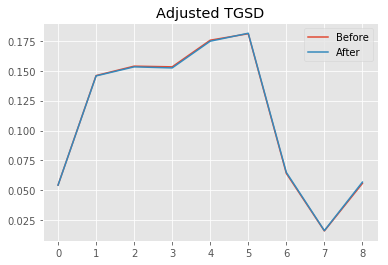

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00126 	1.24915 	39157.7 	2.92694 	5.96793 	7219.01 	6458 	0.000743713 	0
New Total Mass: 5.5e+10
After: 		|1.00126 	1.24915 	39668.9 	2.92694 	5.96793 	7219.01 	6458 	0.000743713 	0
Old Misfit: 4033.05
New Misfit: 4009.68
Convergence:
0.0057950751361043815

____________________
a = 1.00126	b = 1.24915	            h1 = 39668.88070	u = 2.92694	v = 5.96793	            D = 7219.01292	ftt = 6458.00000	TM = 0.00074	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 37
Misfit: 4009.677896506112


,Height,Suspended Mass
0,"4,130.75",2.03312e+09
1,"5,176.5",2.01915e+09
2,"6,222.25",2.00434e+09
3,"7,268",1.98892e+09
4,"8,313.75",1.97296e+09
5,"9,359.5",1.95649e+09
6,"10,405.2",1.93949e+09
7,"11,451",1.92197e+09
8,"12,496.8",1.90389e+09
9,"13,542.5",1.88523e+09


[[1.02000000e+00 1.56000000e+00 2.40000000e+04 ... 1.00000000e-05
  0.00000000e+00 5.50000000e+10]
 [1.02000000e+00 1.56000000e+00 2.40000000e+04 ... 1.00000000e-05
  0.00000000e+00 5.50000000e+10]
 [1.01644680e+00 1.56000000e+00 2.40000000e+04 ... 1.00000000e-05
  0.00000000e+00 5.50000000e+10]
 ...
 [1.00107079e+00 1.24070054e+00 3.94169698e+04 ... 7.86883166e-04
  0.00000000e+00 5.50000000e+10]
 [1.00126369e+00 1.24914796e+00 3.96688807e+04 ... 7.43713241e-04
  0.00000000e+00 5.50000000e+10]
 [1.00126369e+00 1.24914796e+00 3.96688807e+04 ... 7.43713241e-04
  0.00000000e+00 5.50000000e+10]]


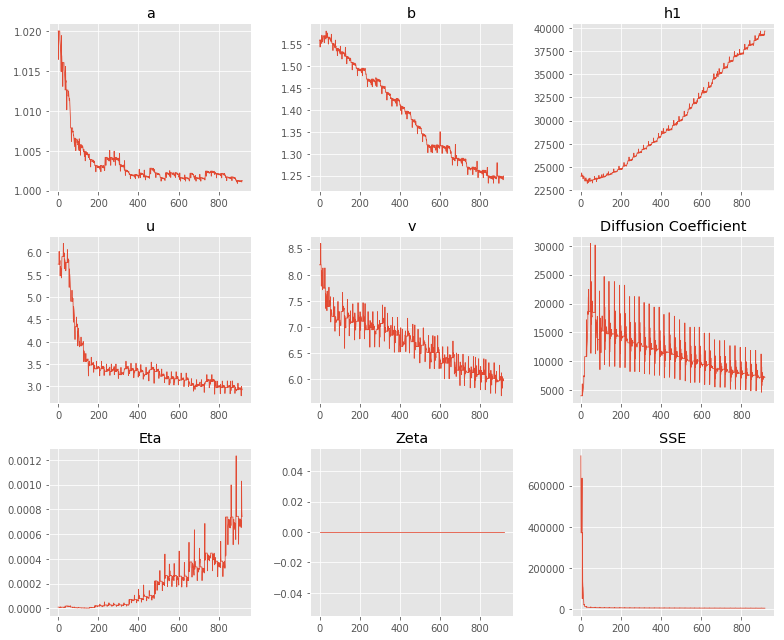

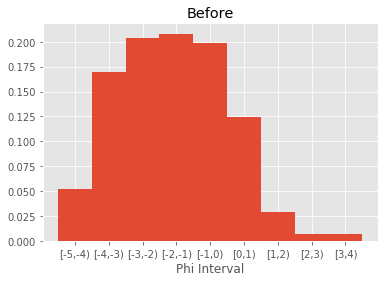

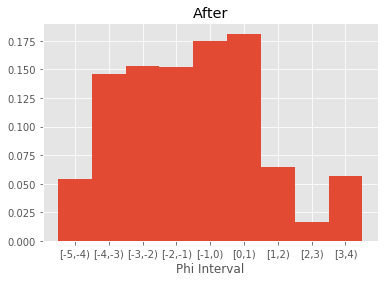

Observation Data Run Time: 3.02109 minutes


Total Run Time: 3.12552 minutes


In [18]:
prior_phi_steps = copy.deepcopy(naive_phi_steps)

z = np.linspace(config["VENT_ELEVATION"] + layer_thickness, config["THEO_MAX_COL"], 
                config["INV_STEPS"])
q_dist = beta(config["ALPHA"],config["BETA"])

q_mass = beta_plume(config["ALPHA"],config["BETA"],config["PLUME_HEIGHT"],
                    config["ERUPTION_MASS"],
                    z,
                    config["VENT_ELEVATION"], 
                    config["THEO_MAX_COL"])

# priors_vals = {
#     "a": 2.00397,
#     "b": 6.88605,
#     "h1": 35637.4,
#     "u": 2.57961,
#     "v": 6.00378,
#     "D": 19234.4,
#     "ftt": 6458
# }
# priors_vals = {
# "a": 1.25202,
# "b": 1.43166,
# "h1": 17322.4,
# "u": 6.81183,
# "v": 0.0681329,
# "D": 8405.14,
# "ftt": 6458,
# "eta": 3054.41,
# "zeta": 0
# }

priors_vals = {
    "a": config["ALPHA"],
    "b": config["BETA"],
    "h1": config["PLUME_HEIGHT"],
    "u": u,
    "v": v,
    "D": config["DIFFUSION_COEFFICIENT"],
    "ftt": config["FALL_TIME_THRESHOLD"],
    "eta": 0.00001,
    "zeta": 0
}

invert_params = {
    "a" : True,
    "b" : True,
    "h1" : True,
    "u": True,
    "v": True,
    "D": True,
    "ftt": False,
    "eta": True,
    "zeta": False
}



t_tot = process_time()
single_run_time = 0
wind_angle = np.radians(55.5)

names = ["No Inversion", "Forward Sim", "Observation Data"]
data_sets = [forward_df, forward_df, obs_df]


# names = ["No Inversion", "Forward Sim", 
# #          "T2 Simulation", 
#          "Observation Data"]
# data_sets = [forward_df, 
#              forward_df, 
# #              t2_const_df, 
#              obs_df]
inverted_masses_list = []
inverted_masses_list += [q_mass]
params_list = []
sim_params = priors_vals
params_list += [sim_params]
mass_list = []
tgsd_list = []
misfit_list = []
mass_list += [config["ERUPTION_MASS"]]
tgsd_list += [[phi["probability"].copy() for phi in prior_phi_steps]]
misfit_list += ["--"]

for name, df in zip(names[1:], data_sets[1:]):
    t = process_time()
    run_phis = copy.deepcopy(prior_phi_steps)
    print("========%s========"%name)
    out = gaussian_stack_inversion(
        df, len(df), config["INV_STEPS"], config["VENT_ELEVATION"], 
        config["THEO_MAX_COL"], 2500, run_phis, config["ERUPTION_MASS"],
        invert_params=invert_params, 
        priors=priors_vals,
        max_iter=40, tol=0.006, 
        adjust_TGSD=True, adjust_mass=False,
        adjustment_factor=0.5,
        column_cap=config["THEO_MAX_COL"]
    )
    inversion_table, params, misfit, status, param_trace, misfit_trace, tgsd_trace, mass_trace = out
    inv_mass = inversion_table["Suspended Mass"].values
    inverted_masses_list += [inv_mass]
    params_list += [params]
    tgsd_list += [tgsd_trace[-1]]
    mass_list += [mass_trace[-1]]
    misfit_list += [misfit]
    display(inversion_table)
    param_trace = np.array(param_trace)
    print(param_trace)
    fig, axs = plt.subplots(3,3, figsize=(
            11, 9), facecolor='w', edgecolor='k')
    axs = axs.ravel()
    axs[0].plot(param_trace[:,0], linewidth=.8)
    axs[0].set_title("a")

    axs[1].plot(param_trace[:,1], linewidth=.8)
    axs[1].set_title("b")

    axs[2].plot(param_trace[:,2], linewidth=.8)
    axs[2].set_title("h1")
    
    axs[3].plot(param_trace[:,3], linewidth=.8)
    axs[3].set_title("u")

    axs[4].plot(param_trace[:,4], linewidth=.8)
    axs[4].set_title("v")
    
    axs[5].plot(param_trace[:,5], linewidth=.8)
    axs[5].set_title("Diffusion Coefficient")
    
    axs[6].plot(param_trace[:,7], linewidth=.8)
    axs[6].set_title("Eta")
    
    axs[7].plot(param_trace[:,8], linewidth=.8)
    axs[7].set_title("Zeta")

    axs[8].plot(misfit_trace, linewidth=.8)
    axs[8].set_title("SSE")
    
#     print(sse_trace)

    plt.tight_layout()
    # plt.savefig("colima/real_trace.png", dpi=200, format='png')
    plt.show()
    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.bar(x, tgsd_trace[0], width=1, align="center")
    ax.set_xticks(x)
    ax.set_xticklabels(labels)
    plt.xlabel("Phi Interval")
    plt.title("Before")
    plt.show()
    
    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.bar(x, tgsd_trace[-1], width=1, align="center")
    ax.set_xticks(x)
    ax.set_xticklabels(labels)
    plt.xlabel("Phi Interval")
    plt.title("After")
    plt.show()
    
    run_time = process_time() - t
    print("%s Run Time: %.5f minutes\n\n"%(name, run_time/60))


total_run_time = process_time() - t_tot

print("Total Run Time: %.5f minutes"%(total_run_time/60))

In [ ]:
plt.plot([phi["probability"] for phi in prior_phi_steps])
plt.show()
plt.plot([phi["probability"] for phi in naive_phi_steps])
plt.show()
plt.plot(tgsd_list[0])
plt.plot(tgsd_list[1])
plt.plot(tgsd_list[2])
plt.show()



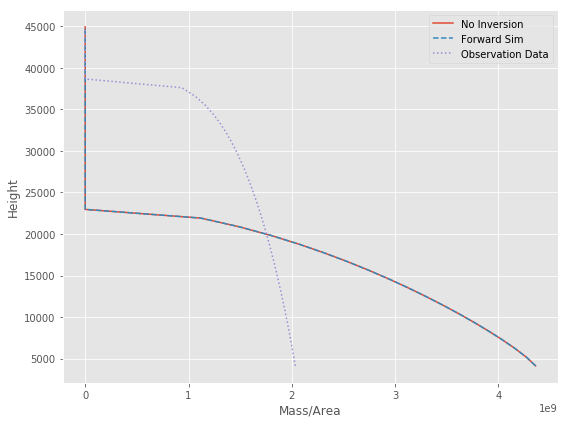

,Dataset,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
0,No Inversion,1.02,1.56,"24,000",5.73576,8.19152,"4,016","6,458",1e-05,0,5.5e+10,--
1,Forward Sim,1.02,1.56,"24,000",5.73576,8.19152,"4,016","6,458",5.62341e-06,0,5.5e+10,6.40582e-28
2,Observation Data,1.00126,1.24915,"39,668.9",2.92694,5.96793,"7,219.01","6,458",0.000743713,0,5.5e+10,"4,009.68"


In [19]:
fig, ax1 = plt.subplots(1,1, figsize=(
    8, 6), facecolor='w', edgecolor='k')

ltype = ["-", "--", ":", ".-"]

for name, mass, lt in zip(names, inverted_masses_list, ltype):
    ax1.plot(mass, 
         inversion_table["Height"], lt, label=name)
ax1.legend()
# ax1.set_title("Mass in Column as inverted from various datasets")
ax1.set_ylabel("Height")
ax1.set_xlabel("Mass/Area")

plt.tight_layout()
plt.show()
params_df = pd.DataFrame(params_list)
params_df["Dataset"] = names
params_df = params_df[["Dataset", "a", "b", "h1", "u", "v", "D", "ftt", "eta", "zeta"]]
params_df["M"] = mass_list
params_df["Misfit"] = misfit_list
display(params_df)

========No Inversion========
{'a': 3.50372, 'b': 3.18932, 'h1': 20454.9, 'u': 2.64743, 'v': 3.46851, 'D': 35460.2, 'ftt': 6458} 55000000000.0


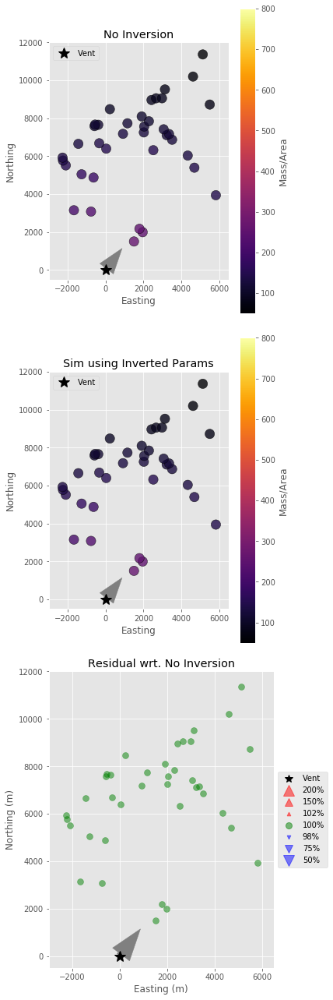

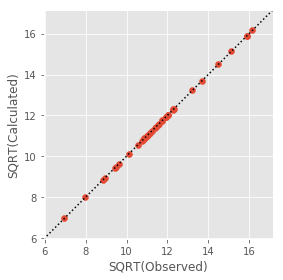

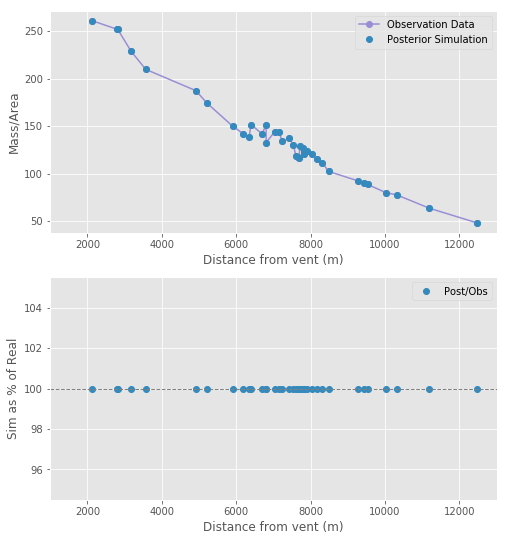

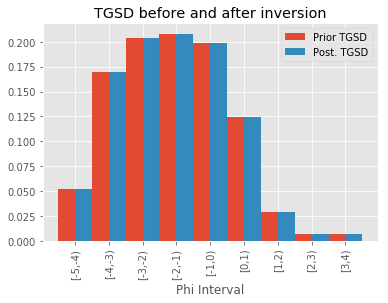

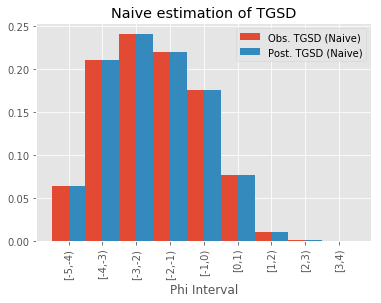

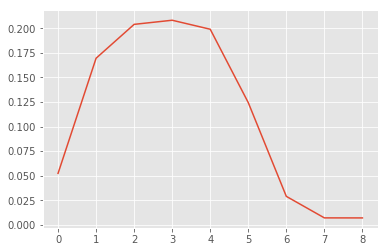

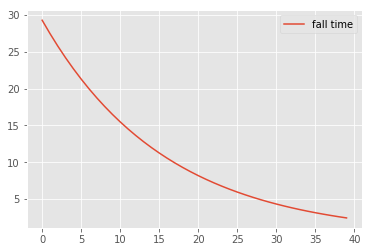

Fall Time:


[29.281875850532412,
 27.47299463948244,
 25.775856653231024,
 24.18355897951832,
 22.689625131917012,
 21.287978707473695,
 19.972918671643342,
 18.73909616999142,
 17.58149277234777,
 16.495400060922908,
 15.476400479363878,
 14.520349364855203,
 13.623358090182805,
 12.781778247193023,
 11.992186807314889,
 11.25137219878772,
 10.556321243964852,
 9.904206903562427,
 9.29237677800441,
 8.718342319094441,
 8.179768708134164,
 7.6744653593185035,
 7.200377009781541,
 6.755575360052767,
 6.338251230922241,
 5.946707204813642,
 5.579350721734799,
 5.234687601724312,
 4.91131596744757,
 4.60792054222299,
 4.323267300286413,
 4.056198447534188,
 3.8056277123296915,
 3.570535927219241,
 3.3499668835864584,
 3.1430234423844494,
 2.9488638851265954,
 2.7666984902940657,
 2.595786321234984,
 2.435432212490372]

Fall Time Adj: 17.459
Sigma Squared
6643763.588872153
Sigma Squared
10582549.100532053
Sigma Squared
14308607.184911666
Sigma Squared
17836808.475813728
Sigma Squared
21181104.977024943
Sigma Squared
24354586.810475975
Sigma Squared
27369535.458796807
Sigma Squared
30237473.718825325
Sigma Squared
32969212.56924935
Sigma Squared
35574895.143010706
Sigma Squared
38064037.983324066
Sigma Squared
40445569.751114614
Sigma Squared
42727867.54131261
Sigma Squared
44918790.95571707
Sigma Squared
47025714.071016066
Sigma Squared
49055555.43198988
Sigma Squared
51014806.19189086
Sigma Squared
52909556.51445767
Sigma Squared
54745520.34495125
Sigma Squared
56528058.65096546
Sigma Squared
58262201.227542184
Sigma Squared
59952667.1552802
Sigma Squared
61603883.994649224
Sigma Squared
63220005.7945794
Sigma Squared
64804929.98857439
Sigma Squared
66362313.24707094
Sigma Squared
67895586.35052237
Sigma Squared
69407968.14370103
Sigma Squared
70902478.62797657
Sigma Squared
72381951.24482192
Sigma S

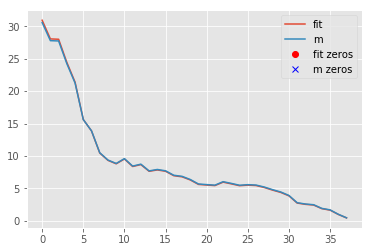

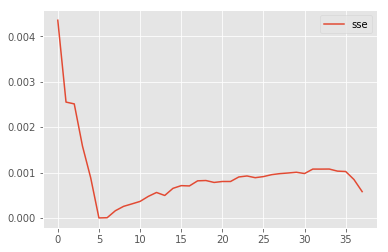

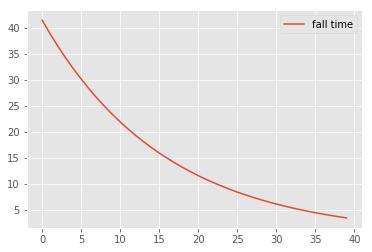

Fall Time:


[41.41082595954815,
 38.85268161815941,
 36.45256606078409,
 34.20071709528445,
 32.087975586718464,
 30.10574820361897,
 28.245972465612834,
 26.50108395021559,
 24.86398552541876,
 23.328018482927156,
 21.886935454633868,
 20.534875002173788,
 19.26633777620175,
 18.076164148425782,
 16.95951322541642,
 15.911843158833188,
 14.928892671982318,
 14.006663727567219,
 13.14140526613464,
 12.32959794907466,
 11.567939844118385,
 10.853332995110735,
 10.182870821432488,
 9.553826295820127,
 8.963640852498196,
 8.409913980509252,
 7.890393459913468,
 7.402966201144814,
 6.945649650263892,
 6.516583725149338,
 6.114023249829161,
 5.73633085617954,
 5.381970324119545,
 5.049500333213845,
 4.737568600268701,
 4.44490637907666,
 4.170323299938247,
 3.9127025279710352,
 3.6709962205130773,
 3.444221265144197]

Fall Time Adj: 24.6908
Sigma Squared
9389902.414782528
Sigma Squared
14942791.831247551
Sigma Squared
20183242.919362016
Sigma Squared
25132285.93113084
Sigma Squared
29809651.97953146
Sigma Squared
34233853.292531334
Sigma Squared
38422258.509431824
Sigma Squared
42391163.325797565
Sigma Squared
46155856.774311386
Sigma Squared
49730683.411144555
Sigma Squared
53129101.66077819
Sigma Squared
56363738.55658653
Sigma Squared
59446441.0998332
Sigma Squared
62388324.44597723
Sigma Squared
65199817.11428087
Sigma Squared
67890703.4046043
Sigma Squared
70470163.19391242
Sigma Squared
72946809.27436152
Sigma Squared
75328722.38483427
Sigma Squared
77623484.07840939
Sigma Squared
79838207.55945101
Sigma Squared
81979566.61574392
Sigma Squared
84053822.76335257
Sigma Squared
86066850.71461274
Sigma Squared
88024162.27284376
Sigma Squared
89930928.7509704
Sigma Squared
91792002.00523926
Sigma Squared
93611934.1695826
Sigma Squared
95394996.17089577
Sigma Squared
97145195.10053793
Sigma Squared


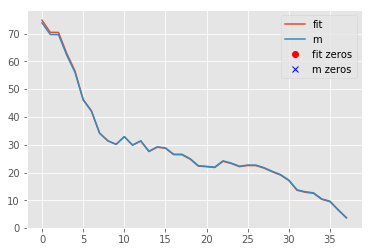

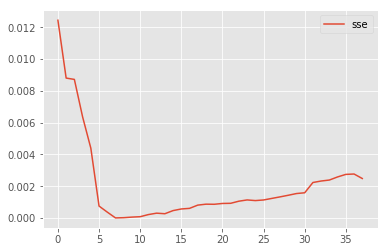

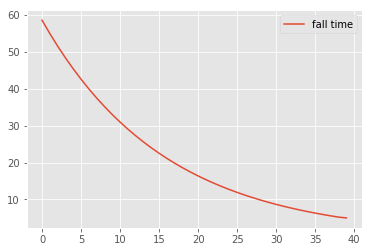

Fall Time:


[58.563751701064824,
 54.94598927896488,
 51.55171330646205,
 48.36711795903664,
 45.379250263834024,
 42.57595741494739,
 39.945837343286684,
 37.47819233998284,
 35.16298554469554,
 32.990800121845815,
 30.952800958727757,
 29.040698729710407,
 27.24671618036561,
 25.563556494386045,
 23.984373614629778,
 22.50274439757544,
 21.112642487929705,
 19.808413807124854,
 18.58475355600882,
 17.436684638188883,
 16.359537416268328,
 15.348930718637007,
 14.400754019563083,
 13.511150720105533,
 12.676502461844482,
 11.893414409627283,
 11.158701443469598,
 10.469375203448624,
 9.82263193489514,
 9.21584108444598,
 8.646534600572826,
 8.112396895068375,
 7.611255424659383,
 7.141071854438482,
 6.699933767172917,
 6.286046884768899,
 5.897727770253191,
 5.533396980588131,
 5.191572642469968,
 4.97744428540254]

Fall Time Adj: 34.918
Sigma Squared
13273529.186544307
Sigma Squared
21109106.23626411
Sigma Squared
28491232.44902333
Sigma Squared
35449649.092427455
Sigma Squared
42012260.174049884
Sigma Squared
48205245.93775196
Sigma Squared
54053169.34879361
Sigma Squared
59579076.00085065
Sigma Squared
64804587.8512987
Sigma Squared
69749991.1660214
Sigma Squared
74434319.03144813
Sigma Squared
78875428.76942922
Sigma Squared
83090074.56982523
Sigma Squared
87093975.63623415
Sigma Squared
90901880.12203214
Sigma Squared
94527625.11677976
Sigma Squared
97984192.9269817
Sigma Squared
101283763.88011536
Sigma Squared
104437765.86670248
Sigma Squared
107456920.82193092
Sigma Squared
110351288.33588436
Sigma Squared
113130306.5697604
Sigma Squared
115802830.64449845
Sigma Squared
118377168.6579588
Sigma Squared
120861115.47714879
Sigma Squared
123261984.44294187
Sigma Squared
125586637.11624473
Sigma Squared
127841511.18660207
Sigma Squared
130032646.65675314
Sigma Squared
132165710.40964381
Sigma S

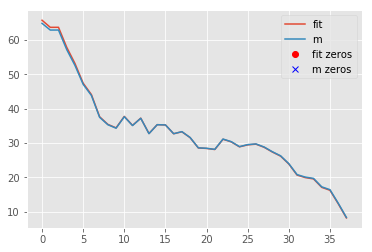

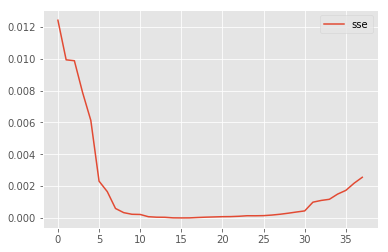

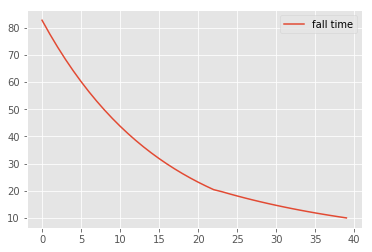

Fall Time:


[82.8216519190963,
 77.70536323631882,
 72.90513212156819,
 68.4014341905689,
 64.17595117343693,
 60.21149640723794,
 56.49194493122567,
 53.00216790043118,
 49.72797105083752,
 46.65603696585431,
 43.773870909267735,
 41.069750004347576,
 38.5326755524035,
 36.152328296851564,
 33.91902645083284,
 31.823686317666375,
 29.857785343964636,
 28.013327455134437,
 26.28281053226928,
 24.65919589814932,
 23.13587968823677,
 21.70666599022147,
 20.365741642864975,
 19.652928215040642,
 18.834987607414238,
 18.05108909419147,
 17.299815868112027,
 16.579810088405416,
 15.889770426648447,
 15.228449714762359,
 14.5946526908986,
 13.987233839139202,
 13.405095319107241,
 12.847184981745452,
 12.312494467676633,
 11.800057384708976,
 11.308947561192266,
 10.838277372068104,
 10.387196134588782,
 9.95488857080508]

Fall Time Adj: 49.3816
Sigma Squared
18765806.838365052
Sigma Squared
29829591.697695103
Sigma Squared
40240503.91792404
Sigma Squared
50040604.00306168
Sigma Squared
59269354.17906292
Sigma Squared
67963778.90186267
Sigma Squared
76158615.45006366
Sigma Squared
83886455.21479514
Sigma Squared
91177876.26142277
Sigma Squared
98061567.70228912
Sigma Squared
104564446.38635638
Sigma Squared
110711766.38037305
Sigma Squared
116527221.6868664
Sigma Squared
122033042.61675447
Sigma Squared
127250086.20856175
Sigma Squared
132197921.0620086
Sigma Squared
136894906.93102482
Sigma Squared
141358269.39992306
Sigma Squared
145604169.94646856
Sigma Squared
149647771.6768188
Sigma Squared
153503300.99970204
Sigma Squared
157184105.49068785
Sigma Squared
160702708.18190515
Sigma Squared
164148200.82866907
Sigma Squared
167505672.1076948
Sigma Squared
170779950.57688618
Sigma Squared
173975663.8330719
Sigma Squared
177097246.87585938
Sigma Squared
180148950.12339154
Sigma Squared
183134847.09449318


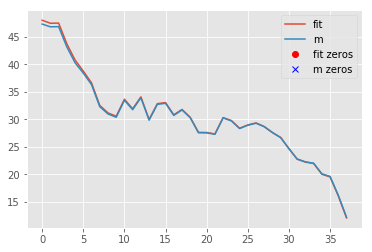

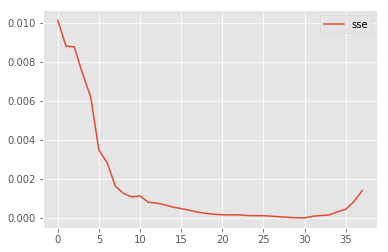

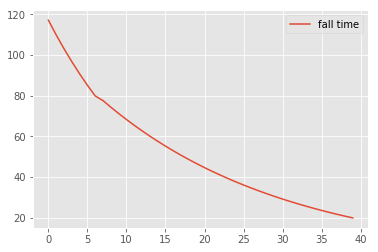

Fall Time:


[117.12750340212965,
 109.89197855792976,
 103.1034266129241,
 96.73423591807328,
 90.75850052766805,
 85.15191482989478,
 79.89167468657337,
 77.59757121908282,
 74.3680166275846,
 71.27287375407712,
 68.3065484804177,
 65.4636795116003,
 62.73912868582568,
 60.12797168785924,
 57.625489148892264,
 55.227158116820355,
 52.928643881522824,
 50.72579214036794,
 48.61462148978419,
 46.59131622932689,
 44.65221946523429,
 42.793826501008745,
 41.01277850307703,
 39.305856430081285,
 37.669975214828476,
 36.10217818838294,
 34.599631736224055,
 33.15962017681083,
 31.779540853296893,
 30.456899429524718,
 29.1893053817972,
 27.974467678278405,
 26.810190638214483,
 25.694369963490903,
 24.624988935353265,
 23.600114769417953,
 22.61789512238453,
 21.676554744136208,
 20.774392269177564,
 19.90977714161016]

Fall Time Adj: 69.8361
Sigma Squared
26533060.381888613
Sigma Squared
42162220.50772821
Sigma Squared
56856482.977246664
Sigma Squared
70675330.32565491
Sigma Squared
83674570.56809977
Sigma Squared
95906564.1923039
Sigma Squared
107420437.12878723
Sigma Squared
118636908.57655892
Sigma Squared
129423293.3998288
Sigma Squared
139798656.66420612
Sigma Squared
149781269.96110734
Sigma Squared
159388644.43157637
Sigma Squared
168637562.41567686
Sigma Squared
177544107.78466013
Sigma Squared
186123695.01073033
Sigma Squared
194391097.02694663
Sigma Squared
202360471.92761695
Sigma Squared
210045388.55744046
Sigma Squared
217458851.03564864
Sigma Squared
224613322.25946933
Sigma Squared
231520746.42939377
Sigma Squared
238192570.636958
Sigma Squared
244639765.55405727
Sigma Squared
250872845.26118514
Sigma Squared
256901886.2504366
Sigma Squared
262736545.6376194
Sigma Squared
268386078.6163908
Sigma Squared
273859355.1859658
Sigma Squared
279164876.1826301
Sigma Squared
284310788.64403343


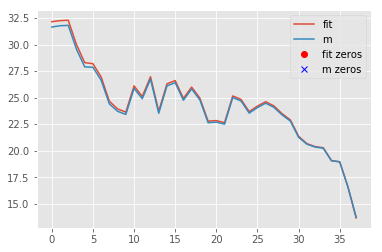

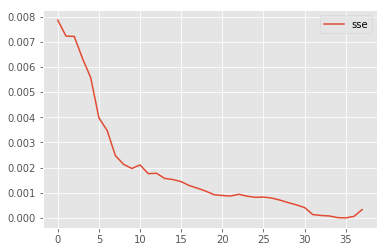

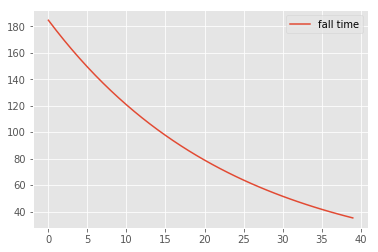

Fall Time:


[184.59453058586556,
 176.91184020711782,
 169.54889782560687,
 162.49239576177044,
 155.72958019201047,
 149.2482280976099,
 143.03662517301893,
 137.0835446535821,
 131.37822702444018,
 125.91036057393285,
 120.6700627563545,
 115.64786233037869,
 110.83468224086862,
 106.22182321313379,
 101.80094802998208,
 97.56406646314963,
 93.50352083187326,
 89.61197216250504,
 85.88238692415344,
 82.30802431637741,
 78.88242408595764,
 75.59939485072475,
 72.45300290934136,
 69.4375615168129,
 66.54762060634386,
 63.77795693896289,
 61.123564663113534,
 58.57964626714765,
 56.14160390836977,
 53.80503110296007,
 51.56570476175705,
 49.419577557504816,
 47.36277060977017,
 45.39156647430822,
 43.50240242420521,
 41.691864010655664,
 39.95667889173509,
 38.293710918014675,
 36.69995446432858,
 35.172528997448744]

Fall Time Adj: 107.748
Sigma Squared
41480079.97962075
Sigma Squared
66615390.89767051
Sigma Squared
90734332.16037284
Sigma Squared
113880369.50753899
Sigma Squared
136095159.6664379
Sigma Squared
157418625.64158538
Sigma Squared
177889028.87102652
Sigma Squared
197543038.37952632
Sigma Squared
216415797.05365452
Sigma Squared
234540985.1585496
Sigma Squared
251950881.21116117
Sigma Squared
268676420.31999195
Sigma Squared
284747250.09678257
Sigma Squared
300191784.2411921
Sigma Squared
315037253.8953231
Sigma Squared
329309756.86090946
Sigma Squared
343034304.768119
Sigma Squared
356234868.2812264
Sigma Squared
368934420.4228578
Sigma Squared
381154978.09511226
Sigma Squared
392917641.8726037
Sigma Squared
404242634.1393464
Sigma Squared
415149335.63840973
Sigma Squared
425656320.50040364
Sigma Squared
435781389.814104
Sigma Squared
445541603.79989195
Sigma Squared
454953312.64415973
Sigma Squared
464032186.050409
Sigma Squared
472793241.5604553
Sigma Squared
481250871.69692403
Sigma

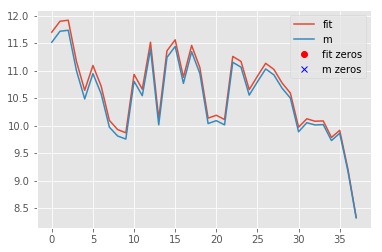

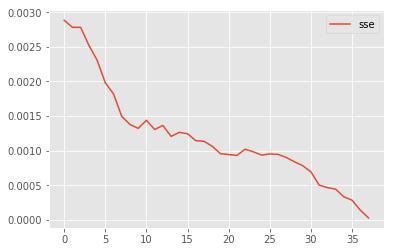

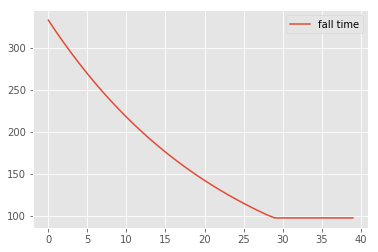

Fall Time:


[332.52990365547254,
 318.6902504254898,
 305.42659351770436,
 292.7149603832617,
 280.53237619339075,
 268.856822315018,
 257.6671965145965,
 246.94327481822327,
 236.6656749591097,
 226.8158213463428,
 217.3759114916207,
 208.32888383328293,
 199.65838689948168,
 191.34874975475904,
 183.38495367661642,
 175.75260501088448,
 168.43790915683314,
 161.42764563500225,
 154.70914419269084,
 148.27026190391896,
 142.09936122247228,
 136.18528894836297,
 130.5173560696914,
 125.08531844347479,
 119.87935828052582,
 114.89006640091705,
 110.1084252279602,
 105.52579248996351,
 101.13388560031024,
 97.46956201084642,
 97.46956201084642,
 97.46956201084642,
 97.46956201084642,
 97.46956201084642,
 97.46956201084642,
 97.46956201084642,
 97.46956201084642,
 97.46956201084642,
 97.46956201084642,
 97.46956201084642]

Fall Time Adj: 194.098
Sigma Squared
74711293.76056491
Sigma Squared
119956567.80671673
Sigma Squared
163348510.12854272
Sigma Squared
204965420.2196729
Sigma Squared
244882338.8056444
Sigma Squared
283171183.4714644
Sigma Squared
319900878.6444519
Sigma Squared
355137480.16728866
Sigma Squared
388944294.6864287
Sigma Squared
421381994.0716511
Sigma Squared
452508725.0735518
Sigma Squared
482380214.41717166
Sigma Squared
511049869.52170366
Sigma Squared
538568875.0283185
Sigma Squared
564986285.3105727
Sigma Squared
590349113.1346005
Sigma Squared
614702414.6293331
Sigma Squared
638089370.7203183
Sigma Squared
660551365.174325
Sigma Squared
682128059.3957864
Sigma Squared
702857464.1102709
Sigma Squared
722776008.0645376
Sigma Squared
741918603.8673476
Sigma Squared
760318711.0900248
Sigma Squared
778008396.7408211
Sigma Squared
795018393.2223804
Sigma Squared
811378153.8770545
Sigma Squared
827115906.2204648
Sigma Squared
842258702.9595214
Sigma Squared
856909745.0915895
Sigma Squared

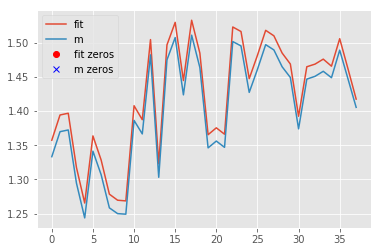

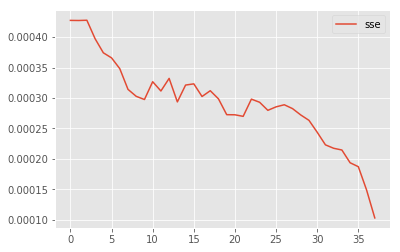

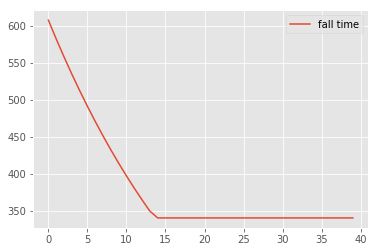

Fall Time:


[607.5899907199696,
 582.3025363132074,
 558.0675274044631,
 534.841161976006,
 512.5814610182899,
 491.24819265767684,
 470.8027994419076,
 451.2083286519003,
 432.4293655139196,
 414.4319691914081,
 397.1836114407905,
 380.6531178203794,
 364.8106113461226,
 349.6274584923589,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225]

Fall Time Adj: 354.65
Sigma Squared
136498953.91365463
Sigma Squared
219135205.479949
Sigma Squared
298361939.97702
Sigma Squared
374322224.20302624
Sigma Squared
447153170.6198293
Sigma Squared
516986185.1681483
Sigma Squared
583947204.768828
Sigma Squared
648156924.9394764
Sigma Squared
709731017.9378633
Sigma Squared
768780341.826348
Sigma Squared
825411140.8351989
Sigma Squared
879725237.3869357
Sigma Squared
324093237.95368487
Sigma Squared
370014886.47658193
Sigma Squared
418380954.74100316
Sigma Squared
470241425.8010613
Sigma Squared
525667327.80969644
Sigma Squared
584727907.3086061
Sigma Squared
647490753.2679373
Sigma Squared
714021907.2123828
Sigma Squared
784385961.5836928
Sigma Squared
858646148.0640625
Sigma Squared
936864417.2625939
Sigma Squared
1019101510.918269
Sigma Squared
1105417027.5778403
Sigma Squared
1195869482.5519545
Sigma Squared
1290516362.8281448
Sigma Squared
1389414177.5179274
Sigma Squared
1492618504.332157
Sigma Squared
1600184032.5100262
Sigma Square

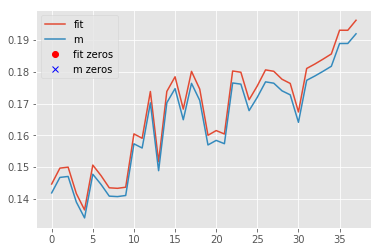

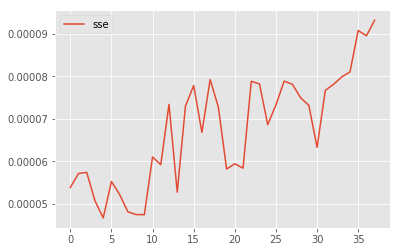

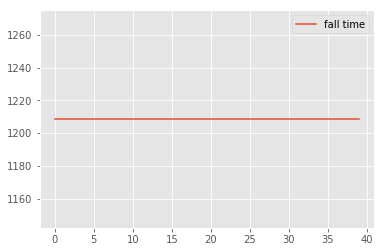

Fall Time:


[1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553]

Fall Time Adj: 676.089
Sigma Squared
267337004.9767635
Sigma Squared
438805051.1074403
Sigma Squared
610301093.2205173
Sigma Squared
781825131.315994
Sigma Squared
282949713.45674175
Sigma Squared
426436636.88778687
Sigma Squared
606127433.9230078
Sigma Squared
824537823.6144612
Sigma Squared
1084015291.930075
Sigma Squared
1386768547.5724056
Sigma Squared
1734889283.0269265
Sigma Squared
2130368791.64465
Sigma Squared
2575110997.0466304
Sigma Squared
3070942893.3526073
Sigma Squared
3619623063.513231
Sigma Squared
4222848736.9799695
Sigma Squared
4882261714.718925
Sigma Squared
5599453400.567839
Sigma Squared
6375969116.780088
Sigma Squared
7213311838.546522
Sigma Squared
8112945451.323075
Sigma Squared
9076297612.101265
Sigma Squared
10104762278.848124
Sigma Squared
11199701959.548584
Sigma Squared
12362449722.47227
Sigma Squared
13594311001.669744
Sigma Squared
14896565225.723053
Sigma Squared
16270467293.032404
Sigma Squared
17717248913.122517
Sigma Squared
19238119830.38535
Sigma 

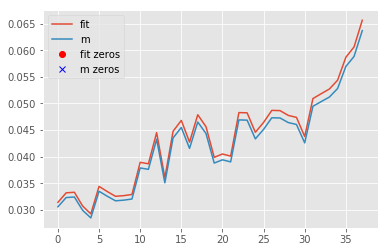

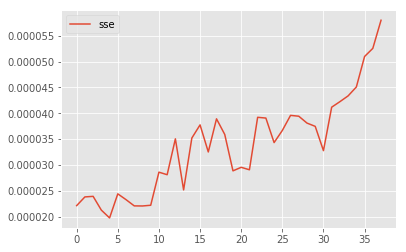

0.37280634203565177


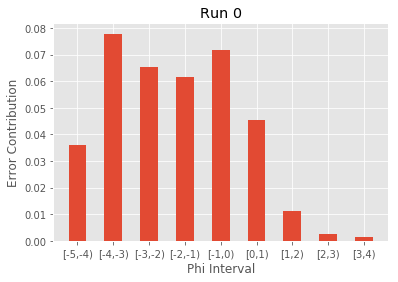

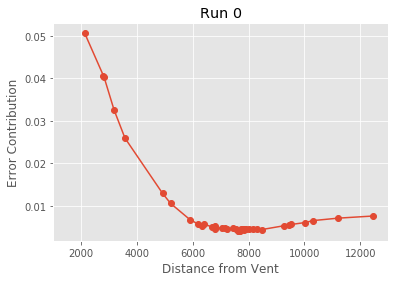

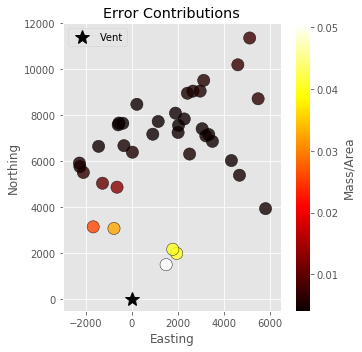

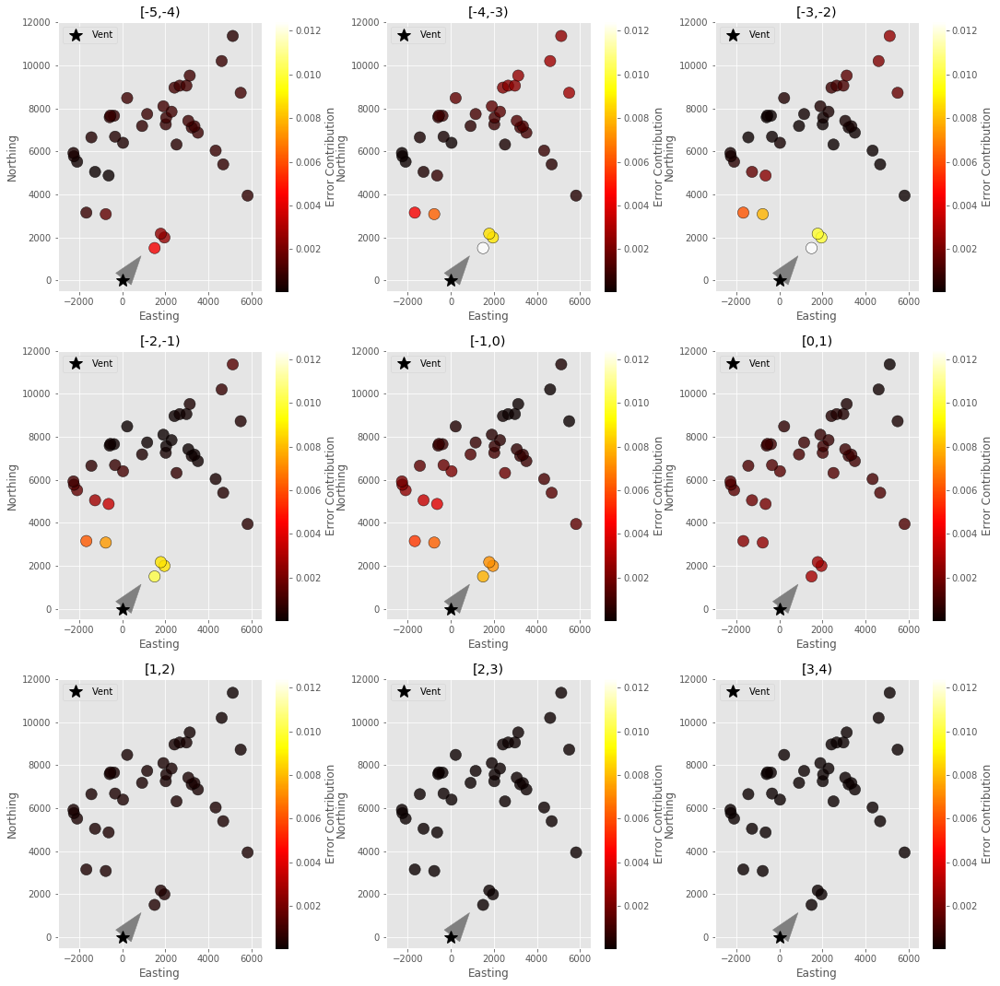

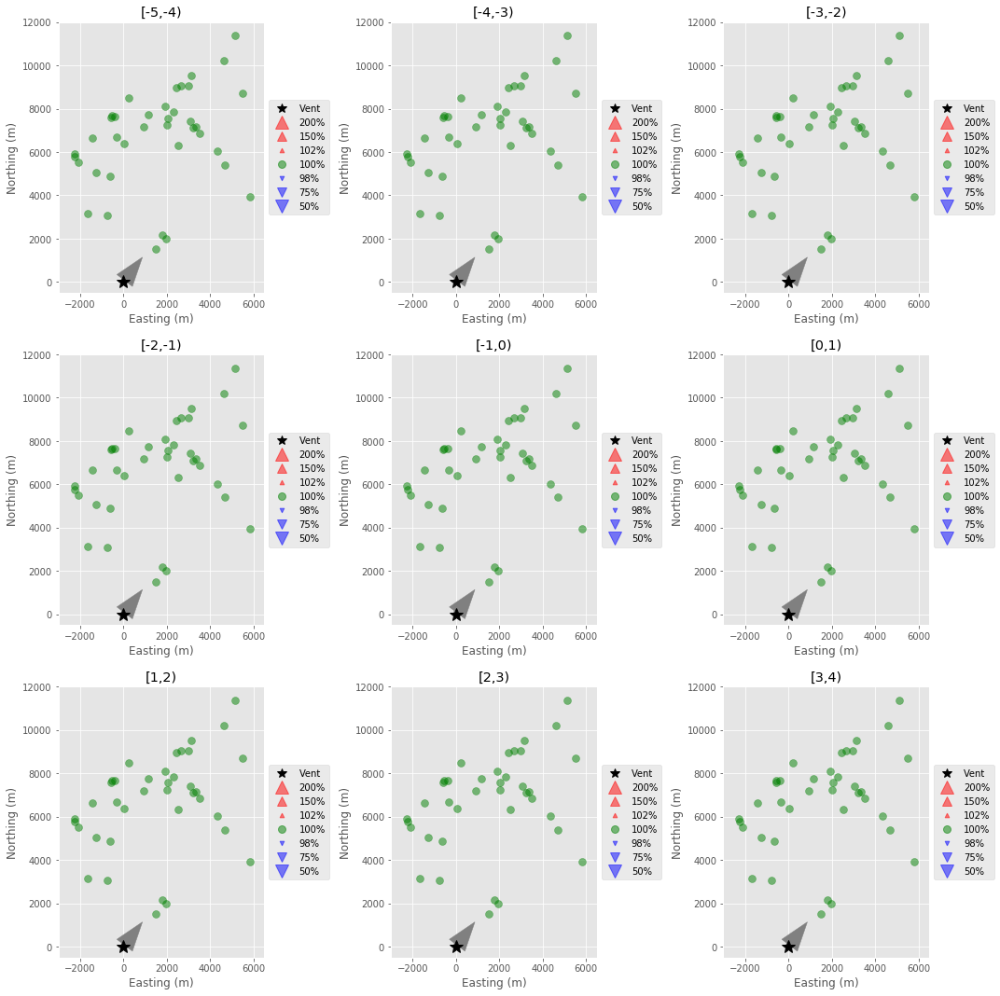

========Observation Data========
{'a': 2.057, 'b': 1.77, 'h1': 21317.53278914712, 'u': 1.7040120227225246, 'v': 4.0868760210741675, 'D': 16697.94914549471, 'ftt': 6457.999999999996} 55000000000.0


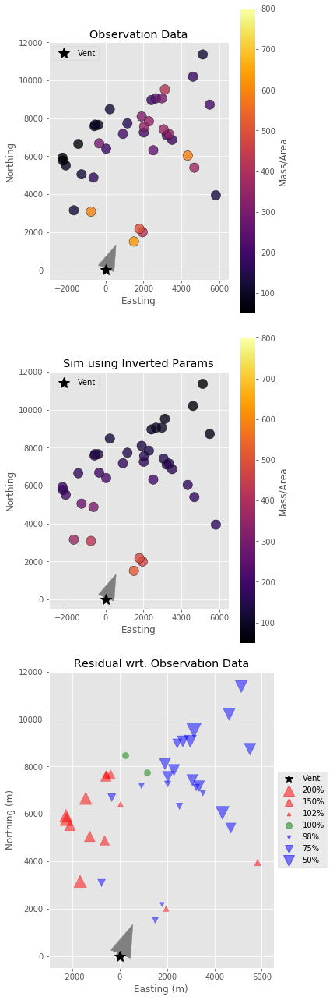

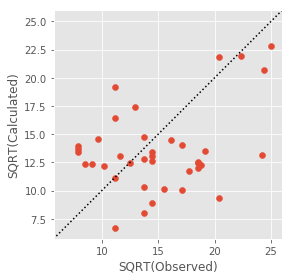

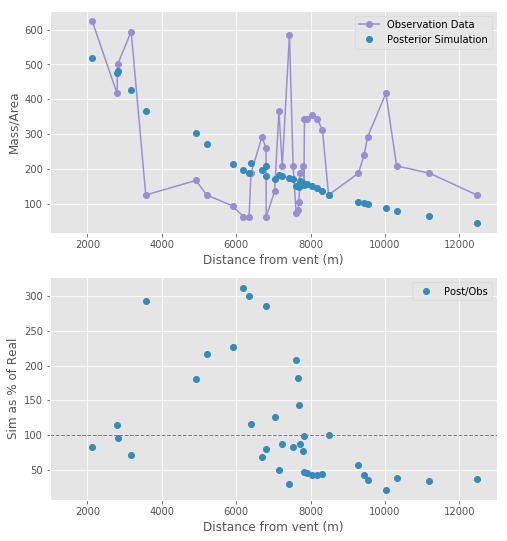

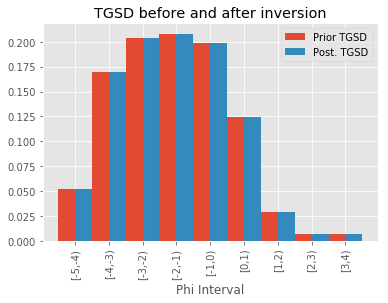

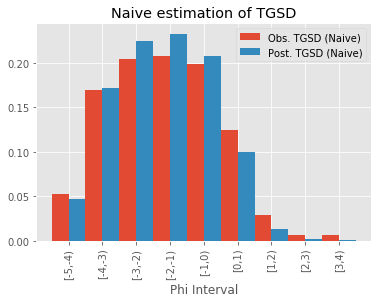

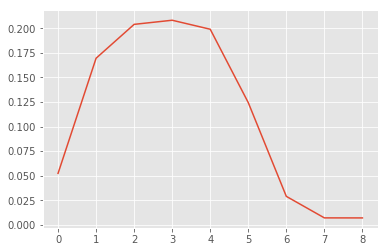

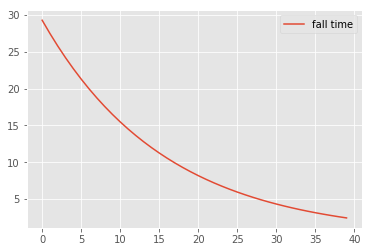

Fall Time:


[29.281875850532412,
 27.47299463948244,
 25.775856653231024,
 24.18355897951832,
 22.689625131917012,
 21.287978707473695,
 19.972918671643342,
 18.73909616999142,
 17.58149277234777,
 16.495400060922908,
 15.476400479363878,
 14.520349364855203,
 13.623358090182805,
 12.781778247193023,
 11.992186807314889,
 11.25137219878772,
 10.556321243964852,
 9.904206903562427,
 9.29237677800441,
 8.718342319094441,
 8.179768708134164,
 7.6744653593185035,
 7.200377009781541,
 6.755575360052767,
 6.338251230922241,
 5.946707204813642,
 5.579350721734799,
 5.234687601724312,
 4.91131596744757,
 4.60792054222299,
 4.323267300286413,
 4.056198447534188,
 3.8056277123296915,
 3.570535927219241,
 3.3499668835864584,
 3.1430234423844494,
 2.9488638851265954,
 2.7666984902940657,
 2.595786321234984,
 2.435432212490372]

Fall Time Adj: 17.459
Sigma Squared
3135906.181127862
Sigma Squared
5012870.824185967
Sigma Squared
6804476.554494821
Sigma Squared
8517725.844883095
Sigma Squared
10159188.592015453
Sigma Squared
11735028.838686531
Sigma Squared
13251029.84535134
Sigma Squared
14712617.612867547
Sigma Squared
16124882.95212573
Sigma Squared
17492602.190333255
Sigma Squared
18820256.59817217
Sigma Squared
20112050.61684884
Sigma Squared
21371928.959171787
Sigma Squared
22603592.654214267
Sigma Squared
23810514.100821536
Sigma Squared
24995951.191191096
Sigma Squared
26162960.561972022
Sigma Squared
27314410.026780594
Sigma Squared
28452990.24070017
Sigma Squared
29581225.644209187
Sigma Squared
30701484.73105052
Sigma Squared
31815989.681805566
Sigma Squared
32926825.402356453
Sigma Squared
34035948.00399933
Sigma Squared
35145192.75970057
Sigma Squared
36256281.56885707
Sigma Squared
37370829.96092269
Sigma Squared
38490353.66638727
Sigma Squared
39616274.78183485
Sigma Squared
40749927.55415693
Sigma

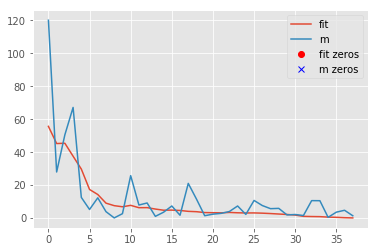

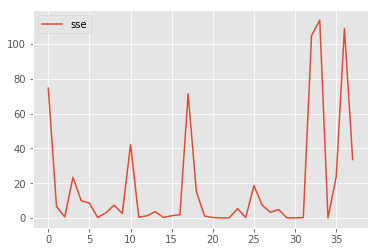

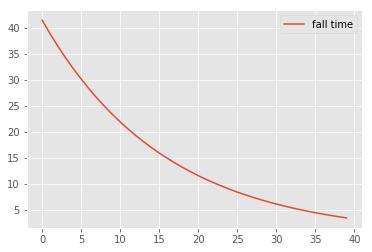

Fall Time:


[41.41082595954815,
 38.85268161815941,
 36.45256606078409,
 34.20071709528445,
 32.087975586718464,
 30.10574820361897,
 28.245972465612834,
 26.50108395021559,
 24.86398552541876,
 23.328018482927156,
 21.886935454633868,
 20.534875002173788,
 19.26633777620175,
 18.076164148425782,
 16.95951322541642,
 15.911843158833188,
 14.928892671982318,
 14.006663727567219,
 13.14140526613464,
 12.32959794907466,
 11.567939844118385,
 10.853332995110735,
 10.182870821432488,
 9.553826295820127,
 8.963640852498196,
 8.409913980509252,
 7.890393459913468,
 7.402966201144814,
 6.945649650263892,
 6.516583725149338,
 6.114023249829161,
 5.73633085617954,
 5.381970324119545,
 5.049500333213845,
 4.737568600268701,
 4.44490637907666,
 4.170323299938247,
 3.9127025279710352,
 3.6709962205130773,
 3.444221265144197]

Fall Time Adj: 24.6908
Sigma Squared
4429042.893879622
Sigma Squared
7066077.274784113
Sigma Squared
9570799.60800715
Sigma Squared
11953112.885593196
Sigma Squared
14222308.3445088
Sigma Squared
16387103.257673193
Sigma Squared
18455676.390456576
Sigma Squared
20435701.266861323
Sigma Squared
22334377.38069236
Sigma Squared
24158459.47866467
Sigma Squared
25914285.03455348
Sigma Squared
27607800.026135035
Sigma Squared
29244583.119762797
Sigma Squared
30829868.360946912
Sigma Squared
32368566.463228304
Sigma Squared
33865284.781937435
Sigma Squared
35324346.05407868
Sigma Squared
36749805.98056253
Sigma Squared
38145469.72229954
Sigma Squared
39514907.377251714
Sigma Squared
40861468.50139264
Sigma Squared
42188295.73263856
Sigma Squared
43498337.57316425
Sigma Squared
44794360.38209423
Sigma Squared
46078959.6273482
Sigma Squared
47354570.44240632
Sigma Squared
48623477.53093263
Sigma Squared
49887824.45954276
Sigma Squared
51149622.376512885
Sigma Squared
52410758.19189249
Sigma Squ

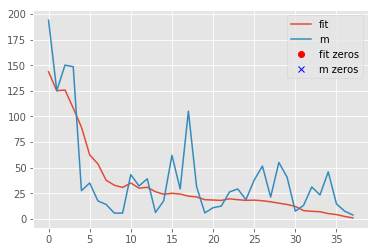

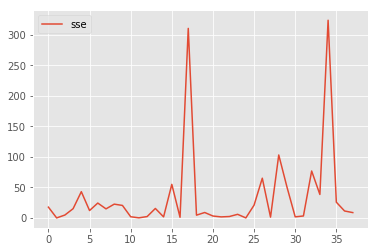

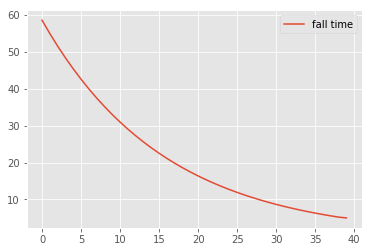

Fall Time:


[58.563751701064824,
 54.94598927896488,
 51.55171330646205,
 48.36711795903664,
 45.379250263834024,
 42.57595741494739,
 39.945837343286684,
 37.47819233998284,
 35.16298554469554,
 32.990800121845815,
 30.952800958727757,
 29.040698729710407,
 27.24671618036561,
 25.563556494386045,
 23.984373614629778,
 22.50274439757544,
 21.112642487929705,
 19.808413807124854,
 18.58475355600882,
 17.436684638188883,
 16.359537416268328,
 15.348930718637007,
 14.400754019563083,
 13.511150720105533,
 12.676502461844482,
 11.893414409627283,
 11.158701443469598,
 10.469375203448624,
 9.82263193489514,
 9.21584108444598,
 8.646534600572826,
 8.112396895068375,
 7.611255424659383,
 7.141071854438482,
 6.699933767172917,
 6.286046884768899,
 5.897727770253191,
 5.533396980588131,
 5.191572642469968,
 4.97744428540254]

Fall Time Adj: 34.918
Sigma Squared
6257814.371055723
Sigma Squared
9969749.683571937
Sigma Squared
13482971.18818964
Sigma Squared
16811483.83056619
Sigma Squared
19968427.404030904
Sigma Squared
22966129.99417306
Sigma Squared
25816158.121902682
Sigma Squared
28529363.78893509
Sigma Squared
31115928.61705146
Sigma Squared
33585405.260666505
Sigma Squared
35946756.26114434
Sigma Squared
38208390.50089768
Sigma Squared
40378197.40554358
Sigma Squared
42463579.03322853
Sigma Squared
44471480.18164307
Sigma Squared
46408416.635182194
Sigma Squared
48280501.66714404
Sigma Squared
50093470.90476119
Sigma Squared
51852705.658200346
Sigma Squared
53563254.80841837
Sigma Squared
55229855.34290104
Sigma Squared
56856951.62281113
Sigma Squared
58448713.4599129
Sigma Squared
60009053.07679865
Sigma Squared
61541641.01940112
Sigma Squared
63049921.08651413
Sigma Squared
64537124.33704539
Sigma Squared
66006282.231974535
Sigma Squared
67460238.9644697
Sigma Squared
68901663.02831386
Sigma Squared


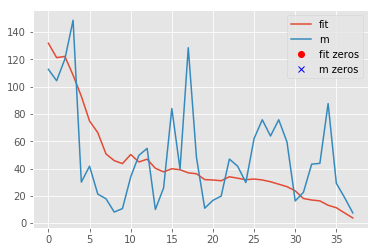

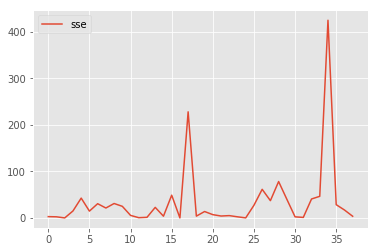

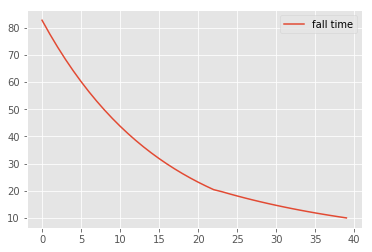

Fall Time:


[82.8216519190963,
 77.70536323631882,
 72.90513212156819,
 68.4014341905689,
 64.17595117343693,
 60.21149640723794,
 56.49194493122567,
 53.00216790043118,
 49.72797105083752,
 46.65603696585431,
 43.773870909267735,
 41.069750004347576,
 38.5326755524035,
 36.152328296851564,
 33.91902645083284,
 31.823686317666375,
 29.857785343964636,
 28.013327455134437,
 26.28281053226928,
 24.65919589814932,
 23.13587968823677,
 21.70666599022147,
 20.365741642864975,
 19.652928215040642,
 18.834987607414238,
 18.05108909419147,
 17.299815868112027,
 16.579810088405416,
 15.889770426648447,
 15.228449714762359,
 14.5946526908986,
 13.987233839139202,
 13.405095319107241,
 12.847184981745452,
 12.312494467676633,
 11.800057384708976,
 11.308947561192266,
 10.838277372068104,
 10.387196134588782,
 9.95488857080508]

Fall Time Adj: 49.3816
Sigma Squared
8844087.796559243
Sigma Squared
14076162.584768228
Sigma Squared
19015617.295214303
Sigma Squared
23682257.911986392
Sigma Squared
28094666.9090176
Sigma Squared
32270278.832146384
Sigma Squared
36225451.21211316
Sigma Squared
39975531.09692264
Sigma Squared
43534917.474184714
Sigma Squared
46917119.83732935
Sigma Squared
50134813.13390696
Sigma Squared
53199889.31947007
Sigma Squared
56123505.726725586
Sigma Squared
58916130.44669382
Sigma Squared
61587584.906456605
Sigma Squared
64147083.81667488
Sigma Squared
66603272.65135735
Sigma Squared
68964262.81232506
Sigma Squared
71237664.62139907
Sigma Squared
73430618.27450344
Sigma Squared
75549822.88358527
Sigma Squared
77601563.72447713
Sigma Squared
79591737.8015285
Sigma Squared
81562297.77150773
Sigma Squared
83506222.00120622
Sigma Squared
85425784.22326863
Sigma Squared
87323163.53923726
Sigma Squared
89200448.35802989
Sigma Squared
91059640.17050093
Sigma Squared
92902657.16690822
Sigma Square

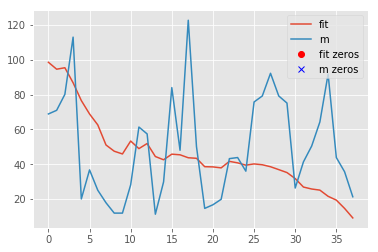

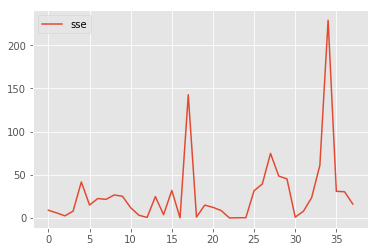

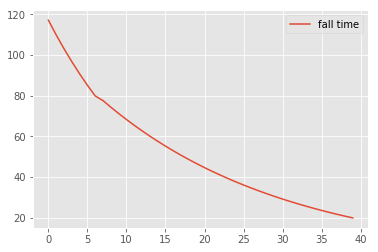

Fall Time:


[117.12750340212965,
 109.89197855792976,
 103.1034266129241,
 96.73423591807328,
 90.75850052766805,
 85.15191482989478,
 79.89167468657337,
 77.59757121908282,
 74.3680166275846,
 71.27287375407712,
 68.3065484804177,
 65.4636795116003,
 62.73912868582568,
 60.12797168785924,
 57.625489148892264,
 55.227158116820355,
 52.928643881522824,
 50.72579214036794,
 48.61462148978419,
 46.59131622932689,
 44.65221946523429,
 42.793826501008745,
 41.01277850307703,
 39.305856430081285,
 37.669975214828476,
 36.10217818838294,
 34.599631736224055,
 33.15962017681083,
 31.779540853296893,
 30.456899429524718,
 29.1893053817972,
 27.974467678278405,
 26.810190638214483,
 25.694369963490903,
 24.624988935353265,
 23.600114769417953,
 22.61789512238453,
 21.676554744136208,
 20.774392269177564,
 19.90977714161016]

Fall Time Adj: 69.8361
Sigma Squared
12501630.750911446
Sigma Squared
19883507.402343873
Sigma Squared
26839960.45557928
Sigma Squared
33398999.801932383
Sigma Squared
39586905.02806181
Sigma Squared
45428332.30514612
Sigma Squared
50946414.67500536
Sigma Squared
56339265.73512596
Sigma Squared
61544405.02432081
Sigma Squared
66570810.14271619
Sigma Squared
71427085.04923733
Sigma Squared
76121475.612284
Sigma Squared
80661884.51319827
Sigma Squared
85055885.52946074
Sigma Squared
89310737.22343059
Sigma Squared
93433396.06137003
Sigma Squared
97430528.98646471
Sigma Squared
101308525.46856391
Sigma Squared
105073509.05241948
Sigma Squared
108731348.42529532
Sigma Squared
112287668.02395113
Sigma Squared
115747858.200171
Sigma Squared
119117084.96321027
Sigma Squared
122400299.31676874
Sigma Squared
125602246.20736574
Sigma Squared
128727473.10029058
Sigma Squared
131780338.19862783
Sigma Squared
134765018.32021308
Sigma Squared
137685516.44675514
Sigma Squared
140545668.95876977
Sigma

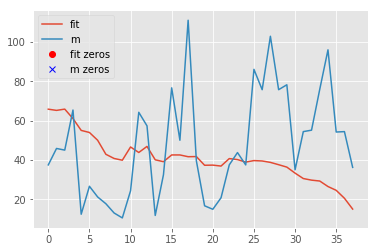

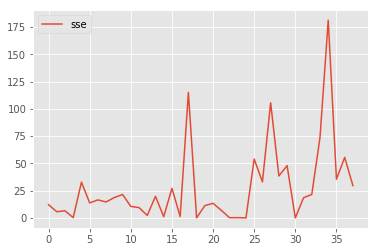

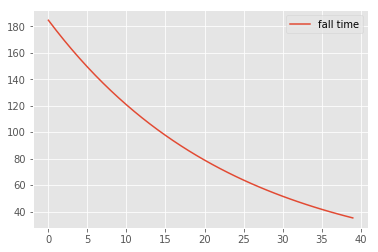

Fall Time:


[184.59453058586556,
 176.91184020711782,
 169.54889782560687,
 162.49239576177044,
 155.72958019201047,
 149.2482280976099,
 143.03662517301893,
 137.0835446535821,
 131.37822702444018,
 125.91036057393285,
 120.6700627563545,
 115.64786233037869,
 110.83468224086862,
 106.22182321313379,
 101.80094802998208,
 97.56406646314963,
 93.50352083187326,
 89.61197216250504,
 85.88238692415344,
 82.30802431637741,
 78.88242408595764,
 75.59939485072475,
 72.45300290934136,
 69.4375615168129,
 66.54762060634386,
 63.77795693896289,
 61.123564663113534,
 58.57964626714765,
 56.14160390836977,
 53.80503110296007,
 51.56570476175705,
 49.419577557504816,
 47.36277060977017,
 45.39156647430822,
 43.50240242420521,
 41.691864010655664,
 39.95667889173509,
 38.293710918014675,
 36.69995446432858,
 35.172528997448744]

Fall Time Adj: 107.748
Sigma Squared
19540073.092456166
Sigma Squared
31398326.710113525
Sigma Squared
42792792.16038018
Sigma Squared
53743937.14261875
Sigma Squared
64271377.50540048
Sigma Squared
74393912.69991681
Sigma Squared
84129559.75784585
Sigma Squared
93495585.85508452
Sigma Squared
102508539.52020195
Sigma Squared
111184280.54401968
Sigma Squared
119538008.64437674
Sigma Squared
127584290.9378881
Sigma Squared
135337088.26834846
Sigma Squared
142809780.43936703
Sigma Squared
150015190.39683816
Sigma Squared
156965607.40495554
Sigma Squared
163672809.25765684
Sigma Squared
170148083.56564477
Sigma Squared
176402248.15745765
Sigma Squared
182445670.6314617
Sigma Squared
188288287.09410438
Sigma Squared
193939620.1182947
Sigma Squared
199408795.9543689
Sigma Squared
204704561.0247485
Sigma Squared
209835297.73210216
Sigma Squared
214809039.6095835
Sigma Squared
219633485.84052765
Sigma Squared
224316015.17384726
Sigma Squared
228863699.26028112
Sigma Squared
233283315.4335971


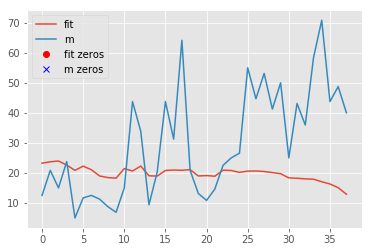

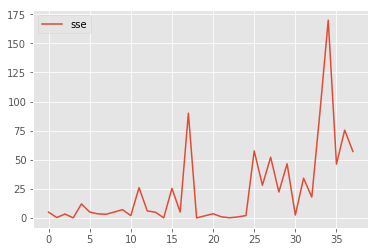

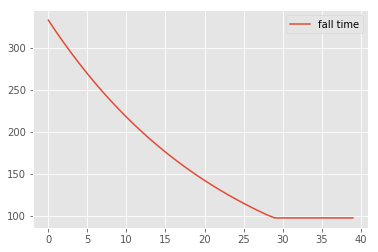

Fall Time:


[332.52990365547254,
 318.6902504254898,
 305.42659351770436,
 292.7149603832617,
 280.53237619339075,
 268.856822315018,
 257.6671965145965,
 246.94327481822327,
 236.6656749591097,
 226.8158213463428,
 217.3759114916207,
 208.32888383328293,
 199.65838689948168,
 191.34874975475904,
 183.38495367661642,
 175.75260501088448,
 168.43790915683314,
 161.42764563500225,
 154.70914419269084,
 148.27026190391896,
 142.09936122247228,
 136.18528894836297,
 130.5173560696914,
 125.08531844347479,
 119.87935828052582,
 114.89006640091705,
 110.1084252279602,
 105.52579248996351,
 101.13388560031024,
 97.46956201084642,
 97.46956201084642,
 97.46956201084642,
 97.46956201084642,
 97.46956201084642,
 97.46956201084642,
 97.46956201084642,
 97.46956201084642,
 97.46956201084642,
 97.46956201084642,
 97.46956201084642]

Fall Time Adj: 194.098
Sigma Squared
35188408.91000002
Sigma Squared
56516297.262679234
Sigma Squared
76986278.1236405
Sigma Squared
96635222.1524613
Sigma Squared
115498465.47862941
Sigma Squared
133609873.56757133
Sigma Squared
151001902.42862302
Sigma Squared
167705657.27556953
Sigma Squared
183750948.7457751
Sigma Squared
199166346.7795145
Sigma Squared
213979232.25688505
Sigma Squared
228215846.48562837
Sigma Squared
241901338.62930456
Sigma Squared
255059811.16154042
Sigma Squared
267714363.4285046
Sigma Squared
279887133.39834446
Sigma Squared
291599337.6730415
Sigma Squared
302871309.83500236
Sigma Squared
313722537.1976926
Sigma Squared
324171696.02673584
Sigma Squared
334236685.29513633
Sigma Squared
343934659.0336334
Sigma Squared
353282057.3346579
Sigma Squared
362294636.06592655
Sigma Squared
370987495.34737754
Sigma Squared
379375106.8429176
Sigma Squared
387471339.9163056
Sigma Squared
395289486.69844735
Sigma Squared
402842286.1114084
Sigma Squared
410178334.75097144
Si

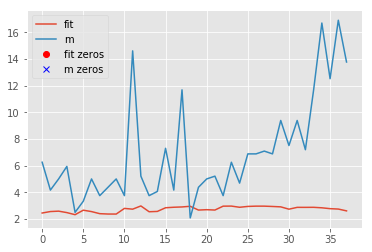

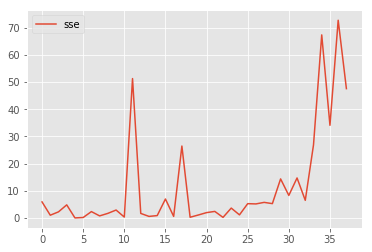

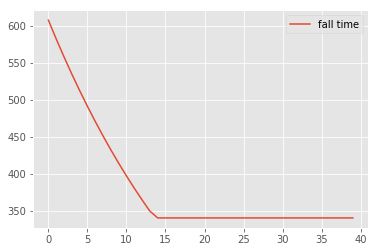

Fall Time:


[607.5899907199696,
 582.3025363132074,
 558.0675274044631,
 534.841161976006,
 512.5814610182899,
 491.24819265767684,
 470.8027994419076,
 451.2083286519003,
 432.4293655139196,
 414.4319691914081,
 397.1836114407905,
 380.6531178203794,
 364.8106113461226,
 349.6274584923589,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225,
 340.4504156893225]

Fall Time Adj: 354.65
Sigma Squared
64283766.72116301
Sigma Squared
103218793.2493651
Sigma Squared
140563115.97477192
Sigma Squared
176384104.0075425
Sigma Squared
210746322.60436964
Sigma Squared
243711649.86282593
Sigma Squared
275339388.558976
Sigma Squared
305686373.33038837
Sigma Squared
334807073.39826834
Sigma Squared
362753691.0143697
Sigma Squared
389576255.81061876
Sigma Squared
415322715.2219735
Sigma Squared
324093237.95368487
Sigma Squared
370014886.47658193
Sigma Squared
418380954.74100316
Sigma Squared
470241425.8010613
Sigma Squared
525667327.80969644
Sigma Squared
584727907.3086061
Sigma Squared
647490753.2679373
Sigma Squared
714021907.2123828
Sigma Squared
784385961.5836928
Sigma Squared
858646148.0640625
Sigma Squared
936864417.2625939
Sigma Squared
1019101510.918269
Sigma Squared
1105417027.5778403
Sigma Squared
1195869482.5519545
Sigma Squared
1290516362.8281448
Sigma Squared
1389414177.5179274
Sigma Squared
1492618504.332157
Sigma Squared
1600184032.5100262
Sigm

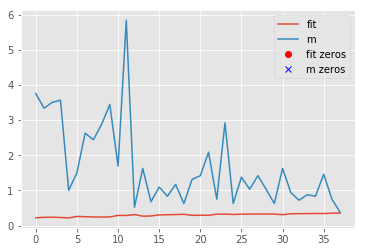

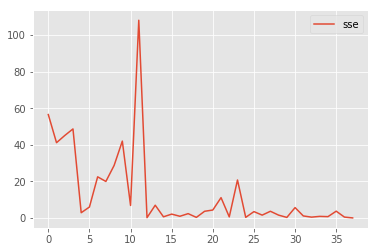

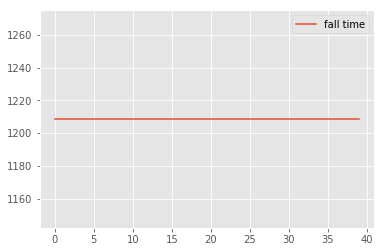

Fall Time:


[1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553,
 1208.5806915716553]

Fall Time Adj: 676.089
Sigma Squared
125894449.2031409
Sigma Squared
206659718.8811022
Sigma Squared
287452984.54146355
Sigma Squared
368274246.18422484
Sigma Squared
282949713.45674175
Sigma Squared
426436636.88778687
Sigma Squared
606127433.9230078
Sigma Squared
824537823.6144612
Sigma Squared
1084015291.930075
Sigma Squared
1386768547.5724056
Sigma Squared
1734889283.0269265
Sigma Squared
2130368791.64465
Sigma Squared
2575110997.0466304
Sigma Squared
3070942893.3526073
Sigma Squared
3619623063.513231
Sigma Squared
4222848736.9799695
Sigma Squared
4882261714.718925
Sigma Squared
5599453400.567839
Sigma Squared
6375969116.780088
Sigma Squared
7213311838.546522
Sigma Squared
8112945451.323075
Sigma Squared
9076297612.101265
Sigma Squared
10104762278.848124
Sigma Squared
11199701959.548584
Sigma Squared
12362449722.47227
Sigma Squared
13594311001.669744
Sigma Squared
14896565225.723053
Sigma Squared
16270467293.032404
Sigma Squared
17717248913.122517
Sigma Squared
19238119830.38535
Sig

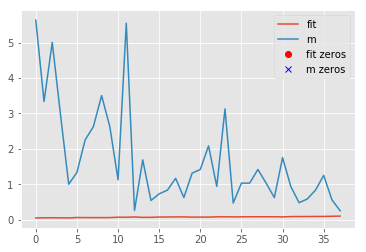

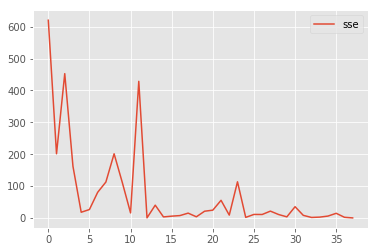

10207.688490719842


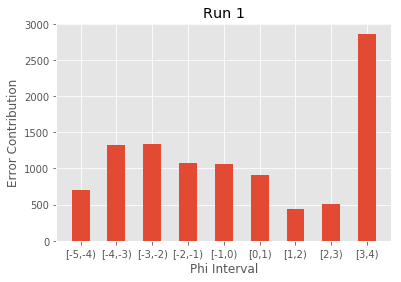

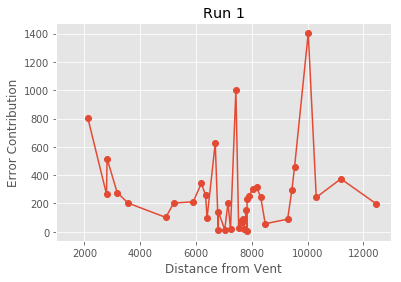

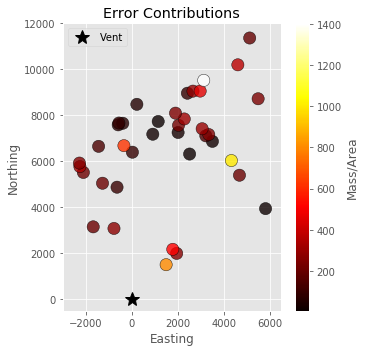

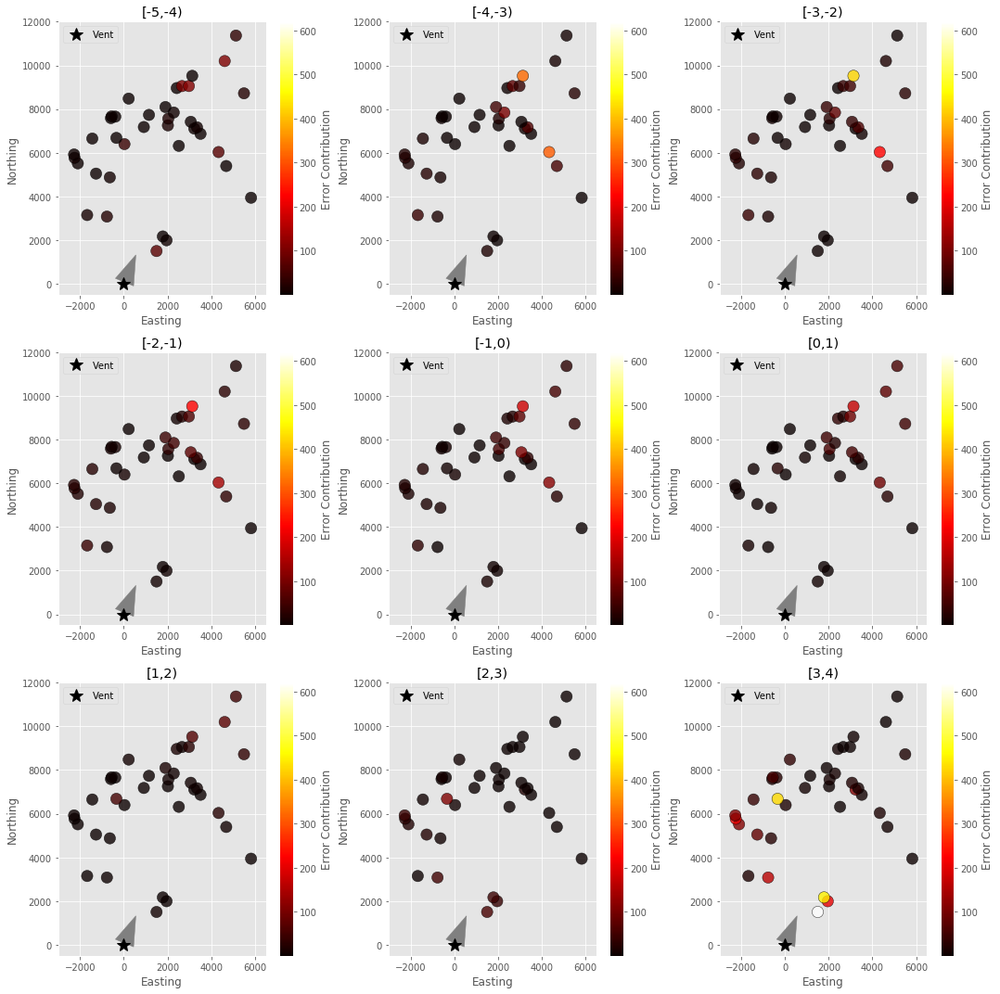

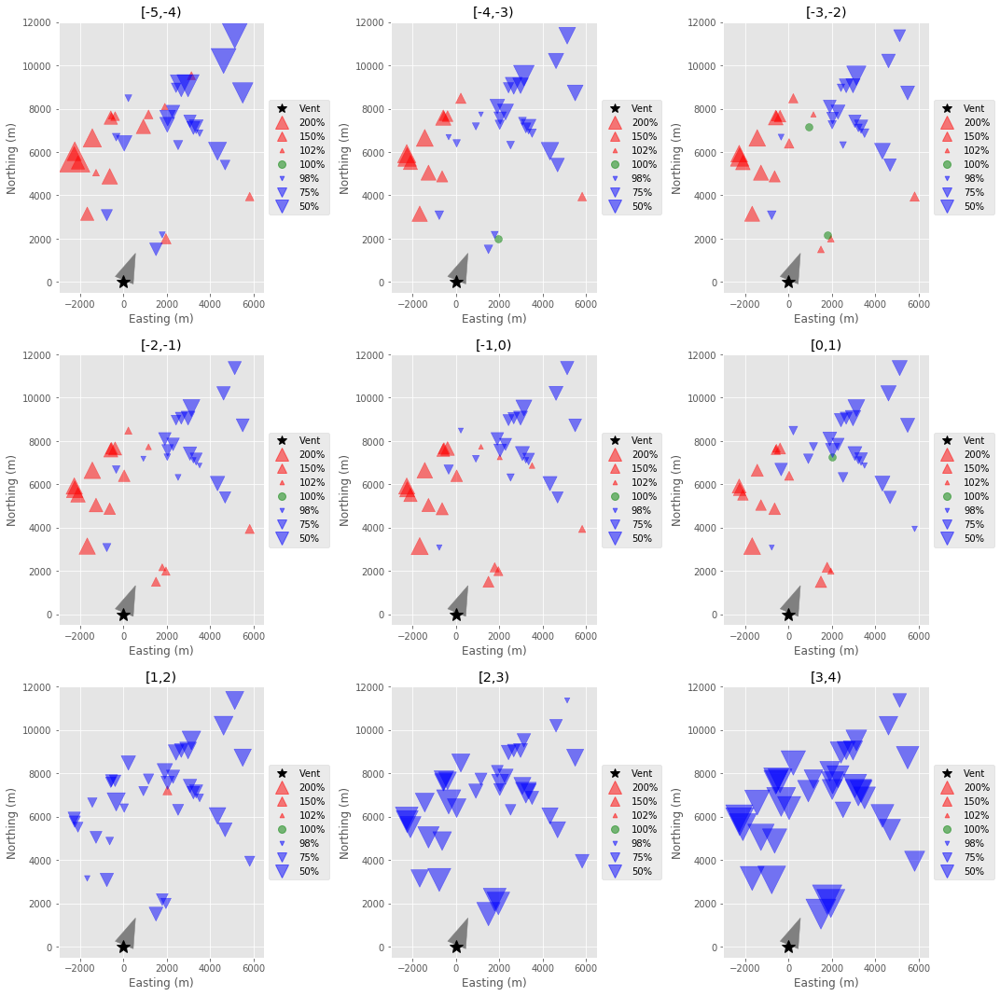

In [21]:
for i, name in enumerate(names):
    print("========%s========"%name)

    data = data_sets[i]
    
    print(params_list[i], mass_list[i])
    q_dist = beta(params["a"],params["b"])

    phi_new = copy.deepcopy(prior_phi_steps)
    for j, new_phi in enumerate(phi_new):
        new_phi["probability"] = tgsd_list[i][j]


    q_dist = beta(params["a"],params["b"])

    grid = data[["Easting", "Northing"]]


    post_df = gaussian_stack_forward(
        grid, int(config["COL_STEPS"]), config["VENT_ELEVATION"], 
        params_list[i]["h1"], 2500, phi_new, (params_list[i]["a"],params_list[i]["b"]), 
        mass_list[i], 
        (params_list[i]["u"],params_list[i]["v"]), params_list[i]["D"], config["EDDY_CONST"],
        config["FALL_TIME_THRESHOLD"]
    )
    if name == "No Inversion":
        data = post_df
    post_df["radius"] = np.sqrt(post_df["Easting"]**2 + post_df["Northing"]**2)
    post_df = post_df.sort_values(by=['radius'])
    post_df["Residual"] = post_df["MassArea"].values/data["MassArea"].values


#     display(post_df)
    ####################### SPATIAL PLOTS
    fig, axs = plt.subplots(3,1, figsize=(
            6, 18), facecolor='w', edgecolor='k')
    axs = axs.ravel()
    bounds=(50, 800)
    vis.plot_sample(data, vent=(0,0), log=False,bounds=bounds, 
                title=name, cbar_label="Mass/Area", ax=axs[0],
                   wind=(params_list[i]["u"]*20,params_list[i]["v"]*20))
    axs[0].set_xlim([-3000, 6500])
    axs[0].set_ylim([-500, 12000])
    vis.plot_sample(post_df, vent=(0,0), log=False, bounds=bounds,
                title="Sim using Inverted Params", cbar_label="Mass/Area", ax=axs[1],
                   wind=(params_list[i]["u"]*20,params_list[i]["v"]*20))
    axs[1].set_xlim([-3000, 6500])
    axs[1].set_ylim([-500, 12000])
    vis.plot_residuals(post_df, vent=(0,0), values="Residual", plot_type="size",
                title="Residual wrt. %s"%name, ax=axs[2],
                       wind=(params_list[i]["u"]*20,params_list[i]["v"]*20))
    axs[2].set_xlim([-3000, 6500])
    axs[2].set_ylim([-500, 12000])

    plt.tight_layout()
    plt.show()
    

    
    ################ EQUILINE PLOT
    
    min_mass = min((min(data["MassArea"].values), min(post_df["MassArea"].values)))
    max_mass = max((max(data["MassArea"].values), max(post_df["MassArea"].values)))

    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.scatter(np.sqrt(data["MassArea"].values), np.sqrt(post_df["MassArea"].values))
    ax.plot([0,100],[0,100], "k:")
    ax.set_xlabel("SQRT(Observed)")
    ax.set_ylabel("SQRT(Calculated)")
    ax.set_aspect('equal', 'box')
    ax.set_xlim([np.sqrt(min_mass)-1, np.sqrt(max_mass)+1])
    ax.set_ylim([np.sqrt(min_mass)-1, np.sqrt(max_mass)+1])
    fig.tight_layout()
    plt.show()

    
    ################# DISTANCE PLOTS
    fig, axs = plt.subplots(2,1, figsize=(
            8, 9), facecolor='w', edgecolor='k')
    axs = axs.ravel()

    axs[0].plot(data["radius"].values, data["MassArea"].values, 'C2o-', label="Observation Data")
    axs[0].plot(post_df["radius"].values, post_df["MassArea"].values, 'C1o', label="Posterior Simulation")
    axs[0].legend()
    axs[0].set_xlabel("Distance from vent (m)")
    axs[0].set_ylabel("Mass/Area")
    axs[0].set_xlim(1000, 13000)

    axs[1].plot(post_df["radius"].values, post_df["Residual"].values*100, 'C1o', label="Post/Obs")
    axs[1].axhline(100, linestyle="--", lw=1, c="gray")  
    axs[1].legend()
    axs[1].set_xlabel("Distance from vent (m)")
    axs[1].set_ylabel("Sim as % of Real")
    axs[1].set_xlim(1000, 13000)
    plt.show()
        


    ################# TGSD PLOTS

    old_tgsd = [phi["probability"].copy() for phi in prior_phi_steps]
    x = [phi["centroid"] for phi in prior_phi_steps]
    labels = [phi["interval"] for phi in prior_phi_steps]
    
    obs_tgsd = get_tgsd(data, prior_phi_steps)
    post_tgsd = get_tgsd(post_df, prior_phi_steps)
    
    
    
    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.bar([xx-0.25 for xx in x], old_tgsd, width=0.5, align="center", label="Prior TGSD")
    ax.bar([xx+0.25 for xx in x], tgsd_list[i], width=0.5, align="center", label="Post. TGSD")
    ax.set_xticks(x)
    ax.set_xticklabels(labels, rotation=90)
    ax.set_xlabel("Phi Interval")
    plt.title("TGSD before and after inversion")
    plt.legend()
    
    plt.show()
    
    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.bar([xx-0.25 for xx in x], obs_tgsd, width=0.5, align="center", label="Obs. TGSD (Naive)")
    ax.bar([xx+0.25 for xx in x], post_tgsd, width=0.5, align="center", label="Post. TGSD (Naive)")
    ax.set_xticks(x)
    ax.set_xticklabels(labels, rotation=90)
    ax.set_xlabel("Phi Interval")
    plt.title("Naive estimation of TGSD")
    plt.legend()
    
    plt.show()
    
    ################# ERROR CONTRIBUTION PLOTS
    
    new_steps = copy.deepcopy(prior_phi_steps)
    for j, phi in enumerate(new_steps):
        phi["probability"] = tgsd_list[i][j]

    misfit, contributions, setup = get_error_contributions(
        data, len(data), int(config["INV_STEPS"]), 
        config["VENT_ELEVATION"], config["THEO_MAX_COL"], 2500, new_steps, 
        params_list[i], mass_list[i], column_cap = config["THEO_MAX_COL"], debug=True)
    
    print(misfit)
    
    point_contributions = np.sum(contributions, 0)
    phi_contributions = np.sum(contributions, 1)
    
    #### Phi Error Contributions
    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.bar(x, phi_contributions, width=0.5, align="center")
    ax.set_xticks(x)
    ax.set_xticklabels(labels)
    plt.xlabel("Phi Interval")
    plt.ylabel("Error Contribution")
    plt.title("Run %d"%i)
    plt.show()
    
    #### Distance Error Contributions
    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.plot(data["radius"], point_contributions, "C0o-")
    plt.xlabel("Distance from Vent")
    plt.ylabel("Error Contribution")
    plt.title("Run %d"%i)
    ax.set_xlim(1000, 13000)
    plt.show()
    
    #### Spatial Error Contributions
    data["Contributions"] = point_contributions
    fig, ax = plt.subplots(1, 1, figsize=(5,5), facecolor='w', edgecolor='k')

    vis.plot_sample(data, vent=(0,0), log=False, values="Contributions",
                title="Error Contributions", cbar_label="Mass/Area", ax = ax, cmap="hot")
    ax.set_xlim([-3000, 6500])
    ax.set_ylim([-500, 12000])
    plt.tight_layout()
    plt.show()
#      bounds=(min(min(contributions)),max(max(contributions))),
    #### Phi and Spatial Error Contributions
    fig, axs = plt.subplots(3, 3, figsize=(15,15), facecolor='w', edgecolor='k')
    axs = axs.ravel()
    for j, phi_cont in enumerate(phi_contributions):
        data["Contributions"] = contributions[j]
#         display(data[["Contributions", "MassArea"]])
        vis.plot_sample(data, vent=(0,0), log=False, values="Contributions", 
                        bounds=(min(min(contributions)),max(max(contributions))),
                        title=phi_new[j]["interval"], cbar_label="Error Contribution", 
                        ax = axs[j], cmap="hot", 
                        wind=(params_list[i]["u"]*20,params_list[i]["v"]*20))
        axs[j].set_xlim([-3000, 6500])
        axs[j].set_ylim([-500, 12000])
    plt.tight_layout()
    plt.show()

    #################### PHI AND SPATIAL RESIDUALS
    fig, axs = plt.subplots(3, 3, figsize=(15,15), facecolor='w', edgecolor='k')
    axs = axs.ravel()
    for j, phi_step in enumerate(phi_new):
        post_df["mass_res"] = (post_df["MassArea"].values*(post_df[phi_step["interval"]].values/100))/\
                             (data["MassArea"].values*(data[phi_step["interval"]].values/100))
        vis.plot_residuals(post_df, vent=(0,0), values="mass_res", plot_type="size",
                        title=prior_phi_steps[j]["interval"],  
                        ax = axs[j]
                          , wind=(params_list[i]["u"]*20,params_list[i]["v"]*20))
        axs[j].set_xlim([-3000, 6500])
        axs[j].set_ylim([-500, 12000])
    plt.tight_layout()
    plt.show()

In [18]:
full_inversion_priors = {
    "a": 1.00002,
    "b": 1.13405,
    "h1": 44908,
    "u": 2.60482,
    "v": 5.33615,
    "D": 5999.9,
    "ftt": 6458,
    "eta": 2.34894,
    "zeta": 0
}

phi_probs = [
    0.058657896918929336,
    0.15114329504320803,
    0.15644352749157492,
    0.15138125134809738,
    0.17100876050061856,
    0.1814490666782764,
    0.06799943098150356,
    0.01682410991463832,
    0.045092661123153584
]

In [16]:


def col_truncnorm(mean, top=config["THEO_MAX_COL"]):
    bottom = 5000
    std = (top - bottom)/4
    standard_a, standard_b = (bottom - mean) / std, (top - mean) / std
    return truncnorm.rvs(standard_a, standard_b, loc=mean, scale=std)

def lognorm(prior, bottom=0):
    std_norm = norm.rvs()
    std_lognorm = np.exp(std_norm)
    lognorm = bottom + (prior-bottom)*std_lognorm
    return lognorm

def normal(prior):
    std_norm = norm.rvs()
    normal = prior*std_norm
    return normal

def uninformed(bottom, top):
    unif = uniform.rvs(loc = bottom, scale = (top-bottom))
    return unif


,invert,sample_function,value
a,False,<function uninformed at 0x000002A3BE222268>,"[1.00002, 5]"
b,False,<function uninformed at 0x000002A3BE222268>,"[1.13405, 5]"
h1,False,<function uninformed at 0x000002A3BE222268>,"[44908, 44915.0]"
u,False,<function uninformed at 0x000002A3BE222268>,"[2.60482, 10]"
v,False,<function uninformed at 0x000002A3BE222268>,"[5.33615, 10]"
D,False,<function uninformed at 0x000002A3BE222268>,"[5999.9, 6000]"
ftt,False,<function uninformed at 0x000002A3BE222268>,"[6458.0, 10000]"
eta,False,<function uninformed at 0x000002A3BE222268>,"[2.34894, 10]"
zeta,False,<function uninformed at 0x000002A3BE222268>,"[0, 0]"


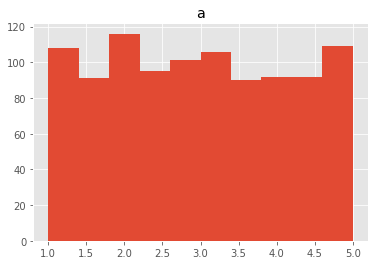

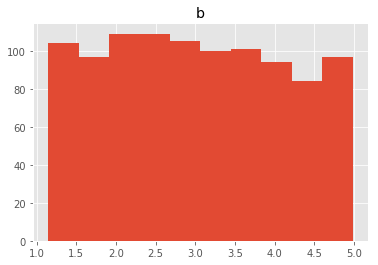

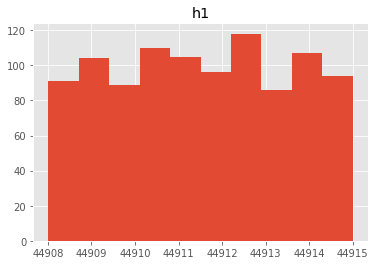

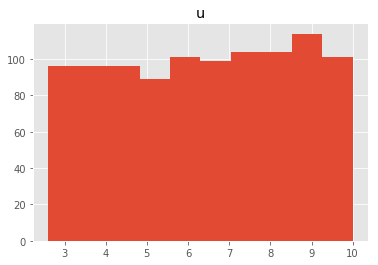

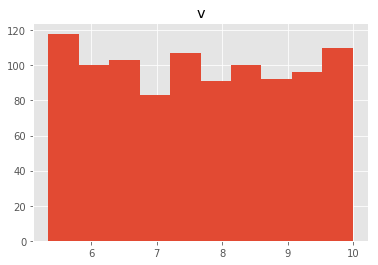

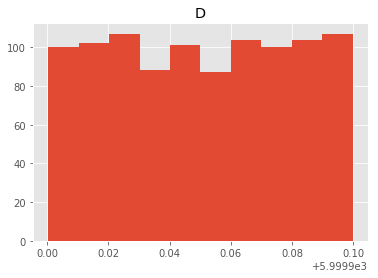

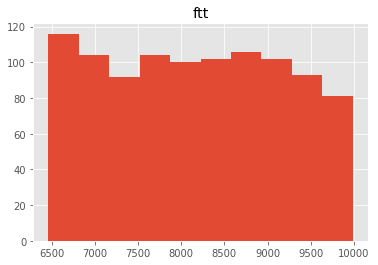

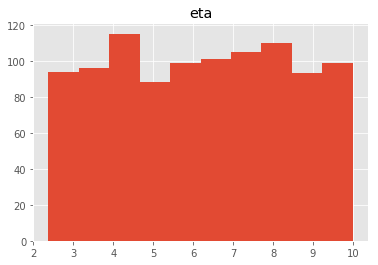

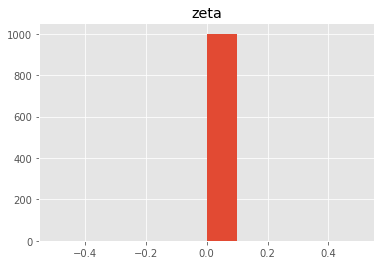

In [19]:
# param_config = {
#     "a": {
#         "value":[1.01, 5],
#         "invert":True,
#         "sample_function": uninformed
#     },
#     "b": {
#         "value":[1.01, 5],
#         "invert":True,
#         "sample_function": uninformed
#     },
#     "h1": {
#         "value":[5000, config["THEO_MAX_COL"]],
#         "invert":True,
#         "sample_function": uninformed
#     },
#     "u": {
#         "value":[0, 10],
#         "invert":True,
#         "sample_function": uninformed
#     },
#     "v": {
#         "value":[0, 10],
#         "invert":True,
#         "sample_function": uninformed
#     },
#     "D": {
#         "value":[0.5*config["FALL_TIME_THRESHOLD"], 1.4*config["FALL_TIME_THRESHOLD"]],
#         "invert":True,
#         "sample_function": uninformed
#     },
#     "ftt": {
#         "value":[config["FALL_TIME_THRESHOLD"], 10000],
#         "invert":False,
#         "sample_function": uninformed
#     },
#     "eta": {
#         "value":[0, 10],
#         "invert":True,
#         "sample_function": uninformed
#     },
#     "zeta": {
#         "value":[0, 0],
#         "invert":False,
#         "sample_function": uninformed
#     },
# }



param_config = {
    "a": {
        "value":[full_inversion_priors["a"], 5],
        "invert":False,
        "sample_function": uninformed
    },
    "b": {
        "value":[full_inversion_priors["b"], 5],
        "invert":False,
        "sample_function": uninformed
    },
    "h1": {
        "value":[full_inversion_priors["h1"], config["THEO_MAX_COL"]],
        "invert":False,
        "sample_function": uninformed
    },
    "u": {
        "value":[full_inversion_priors["u"], 10],
        "invert":False,
        "sample_function": uninformed
    },
    "v": {
        "value":[full_inversion_priors["v"], 10],
        "invert":False,
        "sample_function": uninformed
    },
    "D": {
        "value":[full_inversion_priors["D"], 6000],
        "invert":False,
        "sample_function": uninformed
    },
    "ftt": {
        "value":[config["FALL_TIME_THRESHOLD"], 10000],
        "invert":False,
        "sample_function": uninformed
    },
    "eta": {
        "value":[full_inversion_priors["eta"], 10],
        "invert":False,
        "sample_function": uninformed
    },
    "zeta": {
        "value":[0, 0],
        "invert":False,
        "sample_function": uninformed
    },
}
param_config_df = pd.DataFrame(param_config)
display(param_config_df.T)

for key, val in param_config.items():
    x = [val["sample_function"](*val["value"]) for i in range(1000)]
    plt.hist(x)
    plt.title(key)
    plt.show()



In [20]:
data_set = obs_df
generations = 5

# tgsd = get_tgsd(data_set, naive_phi_steps)

# prior_phi_steps = copy.deepcopy(naive_phi_steps)
prior_phi_steps = copy.deepcopy(naive_phi_steps)
for j, phi in enumerate(prior_phi_steps):
    phi["probability"] = phi_probs[j]
# for i, phi in enumerate(prior_phi_steps):
# #     phi["probability"] = 1/8
#     phi["probability"] = tgsd[i]

out = annealed_gaussian_stack_genetic_optimisation(
    data_set, len(data_set), int(config["INV_STEPS"]), 
    config["VENT_ELEVATION"], 
    config["THEO_MAX_COL"], 2500, prior_phi_steps, 
    config["ERUPTION_MASS"], param_config, generations=generations, 
    column_cap = config["THEO_MAX_COL"], 
    sol_iter=0, max_iter=200, tol=0.1,
    adjust_TGSD=True, adjust_mass=False,
    adjustment_factor=0.5, 
    population_size=50, mating_pool_decrement=10, migrants=5,
    crossover_method="weighted-selection"
)
column_logs, misfit_logs, mating_logs, offspring_logs, mutated_logs, heights, tgsd_logs, mass_logs = out

KeyboardInterrupt: 

============GENERATION 1============
Mating Pool:


,a,b,h1,u,v,D,ftt,Misfit
30,2.77267,4.91801,"12,427.3",7.84575,9.01724,"43,890.3","6,458","11,721.3"
28,1.52162,1.36414,"8,615.32",6.35846,6.64653,"80,702.6","6,458","13,846.2"
27,2.75788,4.81691,"7,872.17",1.86563,5.68857,"98,013.3","6,458","14,139.2"
17,2.19259,3.46067,"24,369.9",5.883,5.18199,"21,206.9","6,458","15,887.2"
8,3.57787,4.08881,"9,399.22",7.52822,2.3315,"45,972","6,458","16,714.2"
32,2.12841,2.89515,"8,755.84",8.78725,1.04299,"70,781.5","6,458","16,798.2"
14,1.39623,3.49274,"32,459.3",7.57202,5.36623,"21,580.9","6,458","17,347"
33,4.64535,1.22938,"8,429.98",1.76513,4.29607,"78,740","6,458","17,739.9"
4,4.87051,2.79228,"8,910.52",8.46473,5.07445,"78,471.5","6,458","17,740.8"
47,2.87169,3.28956,"13,944.9",6.50219,0.991658,"37,299.7","6,458","18,024.3"


Offspring:


,a,b,h1,u,v,D,ftt
0,4.59193,4.08881,"8,429.98",9.59591,5.68857,"71,645.4","6,458"
1,1.61939,3.27706,"32,459.3",6.35846,7.54048,"37,299.7","6,458"
2,2.19259,2.89515,"32,459.3",1.76513,7.33131,"80,702.6","6,458"
3,4.59193,3.22868,"9,399.22",1.86563,5.75016,"98,013.3","6,458"
4,2.12841,4.91801,"24,369.9",6.35846,7.47931,"40,519.2","6,458"
5,2.75788,3.49274,"17,393.1",1.27015,3.62691,"24,844.6","6,458"
6,2.27799,1.0531,"9,399.22",7.84575,5.36623,"78,740","6,458"
7,2.12841,1.44349,"24,369.9",1.6442,6.64653,"29,609.6","6,458"
8,1.81492,2.85788,"13,944.9",5.75232,5.68857,"43,820.9","6,458"
9,2.75788,2.76102,"7,872.17",8.78725,5.36623,"24,725.6","6,458"


Mutated Offspring:


,a,b,h1,u,v,D,ftt,Misfit
13,1.17141,3.25299,"34,183.9",2.08257,5.78454,"17,209.2","6,458","8,509.29"
1,1.53154,3.96133,"34,291.7",3.94735,6.25557,"18,006","6,458","9,848.56"
24,1.8074,2.50118,"14,487.7",1.84502,6.98174,"30,425.1","6,458","10,107.9"
41,1.58839,3.22073,"32,278.7",3.2544,3.37468,"16,123.4","6,458","10,384.2"
17,1.80714,1.04628,"14,638.4",2.8724,4.49733,"21,357.4","6,458","10,719.1"
10,2.73037,3.37713,"12,246.3",1.7187,6.9477,"36,682.9","6,458","10,728.4"
2,2.24251,3.19929,"34,980.9",2.17608,4.16274,"12,338.5","6,458","10,785.7"
8,1.808,2.90646,"13,838.5",5.65645,5.92559,"36,670.7","6,458","10,885.8"
44,2.48845,4.27936,"9,207.66",7.25047,9.20954,"64,516.6","6,458","10,916.6"
19,3.08039,7.50609,"42,734.1",2.41552,3.35225,"14,731.3","6,458","11,089.6"


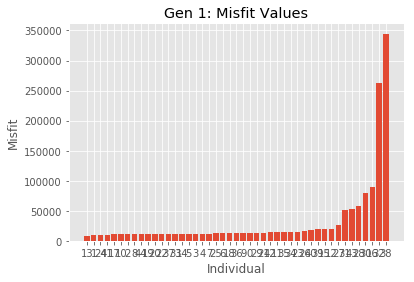

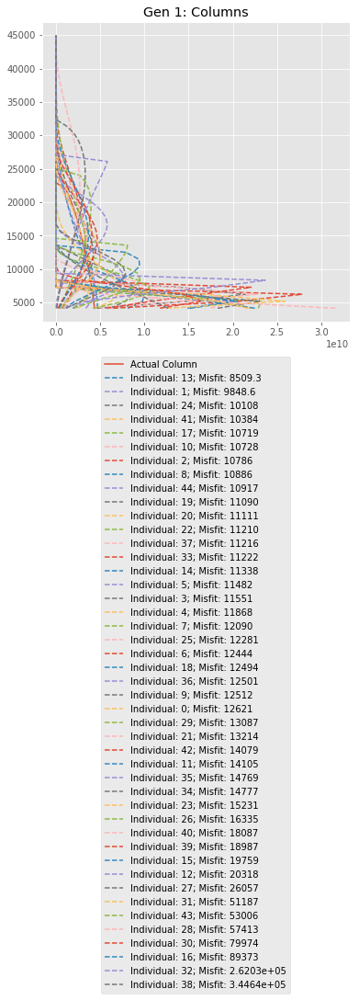

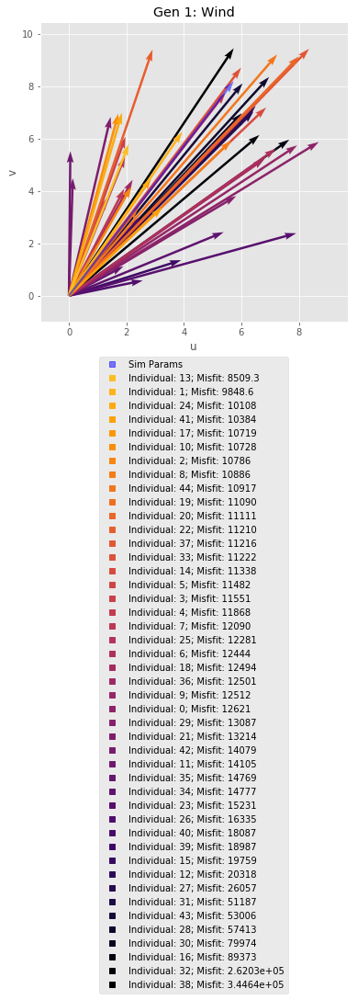

============GENERATION 2============
Mating Pool:


,a,b,h1,u,v,D,ftt,Misfit
13,1.17141,3.25299,"34,183.9",2.08257,5.78454,"17,209.2","6,458","8,509.29"
1,1.53154,3.96133,"34,291.7",3.94735,6.25557,"18,006","6,458","9,848.56"
24,1.8074,2.50118,"14,487.7",1.84502,6.98174,"30,425.1","6,458","10,107.9"
41,1.58839,3.22073,"32,278.7",3.2544,3.37468,"16,123.4","6,458","10,384.2"
17,1.80714,1.04628,"14,638.4",2.8724,4.49733,"21,357.4","6,458","10,719.1"
10,2.73037,3.37713,"12,246.3",1.7187,6.9477,"36,682.9","6,458","10,728.4"
2,2.24251,3.19929,"34,980.9",2.17608,4.16274,"12,338.5","6,458","10,785.7"
8,1.808,2.90646,"13,838.5",5.65645,5.92559,"36,670.7","6,458","10,885.8"
44,2.48845,4.27936,"9,207.66",7.25047,9.20954,"64,516.6","6,458","10,916.6"
19,3.08039,7.50609,"42,734.1",2.41552,3.35225,"14,731.3","6,458","11,089.6"


Offspring:


,a,b,h1,u,v,D,ftt
0,1.80714,2.50211,"14,649.5",1.30455,4.49733,"36,670.7","6,458"
1,4.77531,2.50118,"12,246.3",9.1019,0.576278,"61,057.9","6,458"
2,4.59931,3.08427,"12,246.3",1.95334,0.765278,"12,338.5","6,458"
3,1.17141,2.98779,"14,649.5",5.38663,3.19321,"16,375.9","6,458"
4,2.29226,2.98779,"13,838.5",2.17608,6.82654,"6,456.84","6,458"
5,1.8074,5.46413,"8,095.15",8.00616,9.13429,"96,227.2","6,458"
6,2.78494,3.22073,"8,204.42",8.69629,9.20954,"47,913.4","6,458"
7,4.46811,3.32106,"13,825.3",1.95334,6.9477,"28,195","6,458"
8,1.8074,1.0465,"7,636.14",1.8969,7.74589,"8,371.46","6,458"
9,4.69043,3.22073,"8,126.07",2.08257,5.73803,"17,617.7","6,458"


Mutated Offspring:


,a,b,h1,u,v,D,ftt,Misfit
16,1.66385,3.49186,"43,240.7",2.14413,4.98829,"10,135.2","6,458","9,237.91"
4,2.30831,2.97392,"13,917.3",2.28085,7.15523,"32,254.3","6,458","10,184.1"
34,1.57968,2.75965,"10,554",6.20023,9.6906,"46,528","6,458","10,323.5"
28,3.1991,2.80757,"10,545.4",2.95768,7.0292,"38,117.4","6,458","10,593.3"
15,2.82352,2.79003,"10,094.2",5.28459,8.96513,"40,799.7","6,458","10,716.1"
19,2.50644,4.39915,"14,593.2",5.27144,6.1046,"34,339.4","6,458","10,824.2"
32,4.08654,2.81279,"8,678.05",1.90321,9.15685,"45,412.6","6,458","10,846.8"
6,2.83901,3.31389,"8,119.46",7.50911,9.68387,"63,011.3","6,458","10,902.3"
18,1.67895,2.4457,"8,619.75",5.82732,8.96684,"66,972.1","6,458","10,935.3"
31,1.16224,2.75084,"9,306.5",6.77081,8.45276,"62,752.7","6,458","11,087.9"


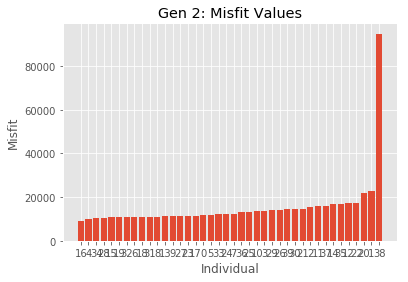

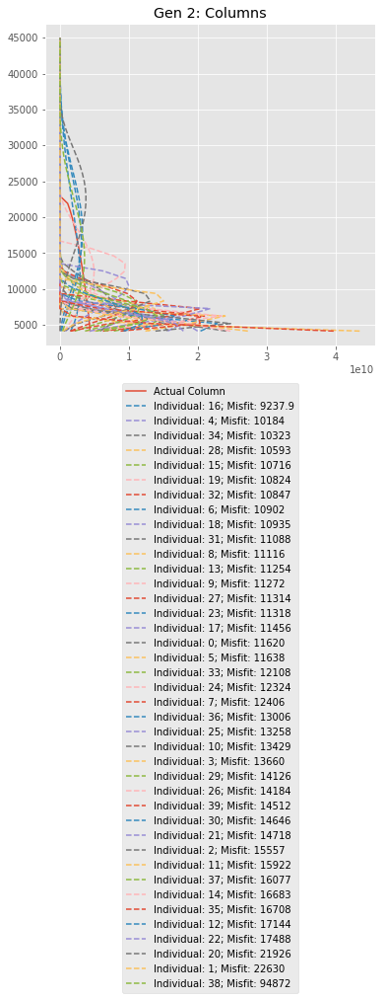

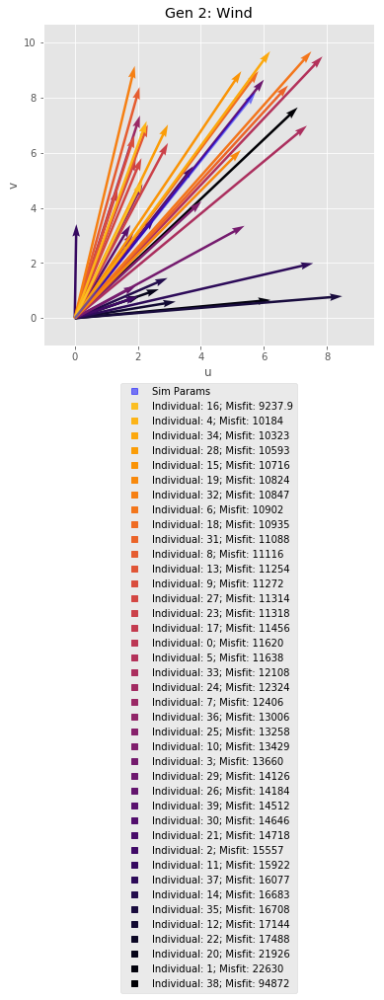

============GENERATION 3============
Mating Pool:


,a,b,h1,u,v,D,ftt,Misfit
16,1.66385,3.49186,"43,240.7",2.14413,4.98829,"10,135.2","6,458","9,237.91"
4,2.30831,2.97392,"13,917.3",2.28085,7.15523,"32,254.3","6,458","10,184.1"
34,1.57968,2.75965,"10,554",6.20023,9.6906,"46,528","6,458","10,323.5"
28,3.1991,2.80757,"10,545.4",2.95768,7.0292,"38,117.4","6,458","10,593.3"
15,2.82352,2.79003,"10,094.2",5.28459,8.96513,"40,799.7","6,458","10,716.1"
19,2.50644,4.39915,"14,593.2",5.27144,6.1046,"34,339.4","6,458","10,824.2"
32,4.08654,2.81279,"8,678.05",1.90321,9.15685,"45,412.6","6,458","10,846.8"
6,2.83901,3.31389,"8,119.46",7.50911,9.68387,"63,011.3","6,458","10,902.3"
18,1.67895,2.4457,"8,619.75",5.82732,8.96684,"66,972.1","6,458","10,935.3"
31,1.16224,2.75084,"9,306.5",6.77081,8.45276,"62,752.7","6,458","11,087.9"


Offspring:


,a,b,h1,u,v,D,ftt
0,2.30831,2.4457,"7,118.08",1.35709,5.7923,"22,702.7","6,458"
1,4.08654,3.49392,"7,796.62",6.77081,8.39159,"40,799.7","6,458"
2,1.66385,2.79409,"10,554",5.38663,5.80923,"87,452.1","6,458"
3,4.08654,2.81279,"13,917.3",5.38663,7.15523,"10,135.2","6,458"
4,4.12047,2.98779,"13,917.3",1.8582,6.63409,"45,758","6,458"
5,1.80021,4.65144,"13,625.4",6.00408,4.8648,"69,103.7","6,458"
6,3.43477,2.97392,"8,619.75",2.53018,3.3816,"62,752.7","6,458"
7,1.67895,4.39915,"8,619.75",1.87159,6.1046,"37,756.8","6,458"
8,1.66385,1.58689,"9,394.7",5.28459,6.98877,"34,339.4","6,458"
9,4.08654,3.49186,"28,449.9",5.27144,8.39159,"33,595.7","6,458"


Mutated Offspring:


,a,b,h1,u,v,D,ftt,Misfit
30,1.31577,5.21688,"44,143.7",1.06866,6.3293,"17,188.2","6,458","9,016.01"
18,1.164,2.51225,"17,509.4",2.27183,6.23416,"30,389.2","6,458","10,124.1"
26,3.6541,26.7635,"42,622.5",1.99529,7.7573,"29,968.1","6,458","10,304.7"
8,1.67528,1.57912,"9,614.95",5.4167,7.16349,"44,584.9","6,458","10,651.2"
13,1.8163,1.58841,"12,362.2",4.86338,6.39382,"31,496.3","6,458","10,656"
23,2.89408,3.60454,"13,486.7",2.24799,8.26163,"31,679.5","6,458","10,679.1"
1,4.2047,3.43759,"7,988.83",6.54511,9.10488,"58,122.7","6,458","10,880"
20,1.5649,2.47117,"8,278.8",3.09679,10.1497,"70,324.7","6,458","10,963.5"
17,3.82473,4.88555,"13,486.7",4.75124,6.5443,"31,802","6,458","11,241.9"
22,2.5252,2.78995,"8,464.86",7.11639,7.24154,"59,023.6","6,458","11,408.3"


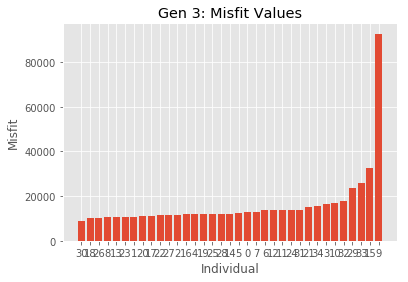

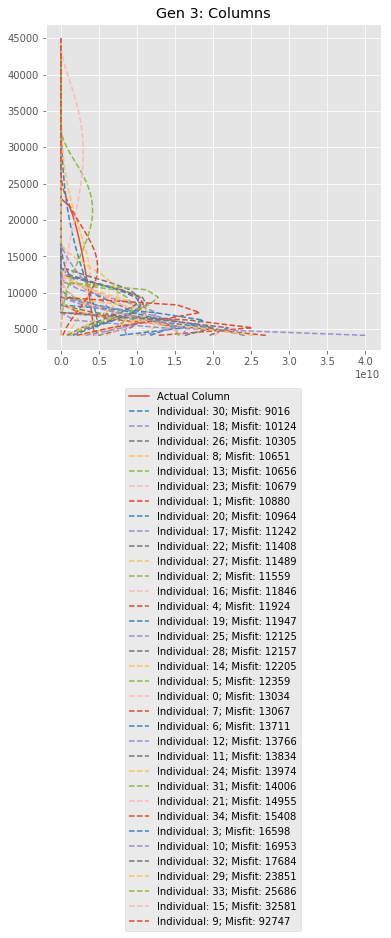

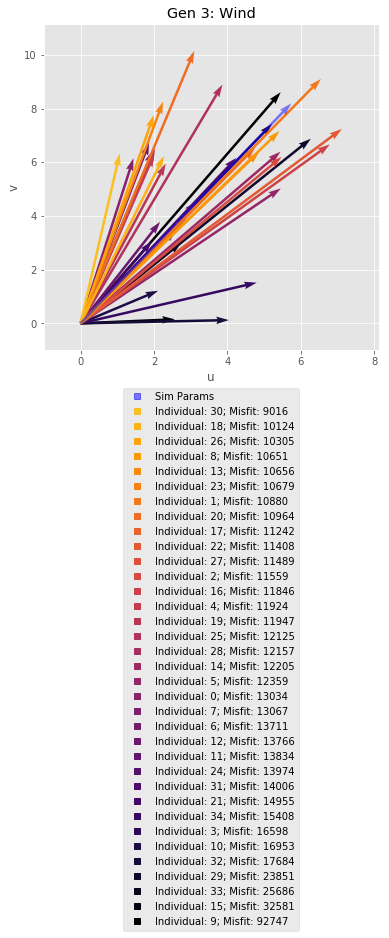

============GENERATION 4============
Mating Pool:


,a,b,h1,u,v,D,ftt,Misfit
30,1.31577,5.21688,"44,143.7",1.06866,6.3293,"17,188.2","6,458","9,016.01"
18,1.164,2.51225,"17,509.4",2.27183,6.23416,"30,389.2","6,458","10,124.1"
26,3.6541,26.7635,"42,622.5",1.99529,7.7573,"29,968.1","6,458","10,304.7"
8,1.67528,1.57912,"9,614.95",5.4167,7.16349,"44,584.9","6,458","10,651.2"
13,1.8163,1.58841,"12,362.2",4.86338,6.39382,"31,496.3","6,458","10,656"
23,2.89408,3.60454,"13,486.7",2.24799,8.26163,"31,679.5","6,458","10,679.1"
1,4.2047,3.43759,"7,988.83",6.54511,9.10488,"58,122.7","6,458","10,880"
20,1.5649,2.47117,"8,278.8",3.09679,10.1497,"70,324.7","6,458","10,963.5"
17,3.82473,4.88555,"13,486.7",4.75124,6.5443,"31,802","6,458","11,241.9"
22,2.5252,2.78995,"8,464.86",7.11639,7.24154,"59,023.6","6,458","11,408.3"


Offspring:


,a,b,h1,u,v,D,ftt
0,2.89408,3.02195,"17,509.4",2.60662,6.50521,"70,324.7","6,458"
1,3.6541,2.51225,"13,529.9",4.86338,6.7362,"30,389.2","6,458"
2,2.33024,6.75743,"44,866.2",1.44103,8.26163,"34,277.4","6,458"
3,3.5011,1.57912,"44,866.2",2.88709,7.7573,"31,496.3","6,458"
4,1.79428,4.78179,"17,509.4",2.32089,7.16349,"3,523.66","6,458"
5,1.164,1.14985,"10,829.1",2.00144,7.7573,"59,023.6","6,458"
6,3.76481,3.09589,"36,095.4",2.32089,0.687135,"93,404.4","6,458"
7,1.57118,2.51225,"44,143.7",2.27183,6.3293,"52,301.4","6,458"
8,3.81716,1.14985,"9,919.18",3.15996,6.5443,"31,496.3","6,458"
9,1.17225,2.44706,"8,464.86",5.4167,7.7573,"28,106.3","6,458"


Mutated Offspring:


,a,b,h1,u,v,D,ftt,Misfit
12,1.62254,5.98133,"44,315.6",2.25241,5.93561,"16,326.4","6,458","8,807.09"
16,1.76568,5.47158,"43,467.6",2.31303,5.71182,"15,407.8","6,458","9,168.99"
7,1.52107,2.61834,"44,516.7",2.64428,4.39609,"8,643.5","6,458","9,303.73"
26,1.16106,2.93251,"15,892.8",5.19598,8.56644,"34,541.4","6,458","9,713.43"
14,1.5559,5.52131,"24,221.3",4.4809,6.75847,"28,127.2","6,458","9,716.96"
4,1.79225,4.16006,"17,472.5",2.53269,7.81721,"34,541.4","6,458","9,839.9"
5,1.15112,1.13751,"11,276",2.09203,8.1084,"36,375","6,458","10,114.2"
2,2.3818,8.26995,"44,895.3",1.63305,5.58532,"18,024.2","6,458","10,174.6"
11,1.54142,3.78543,"44,853.9",3.27258,5.56125,"14,240.1","6,458","10,203.7"
27,1.77545,3.52416,"37,041.5",3.6515,4.27454,"14,525.8","6,458","10,570.7"


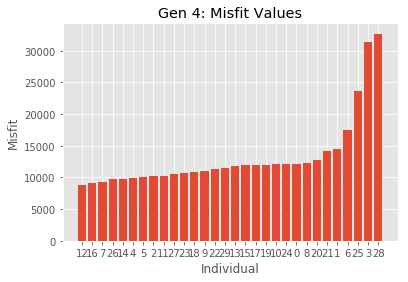

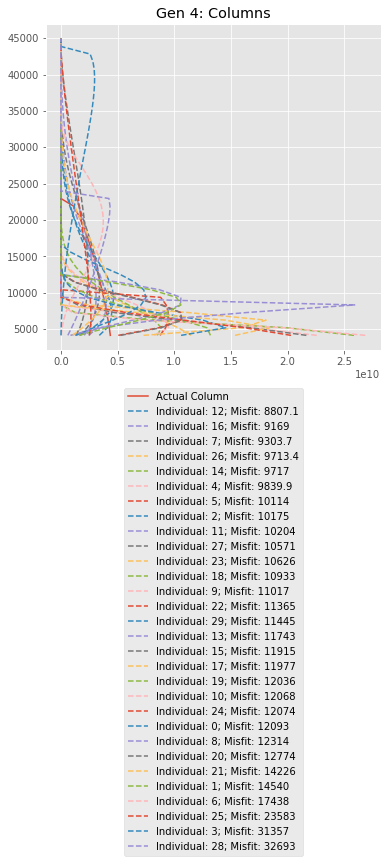

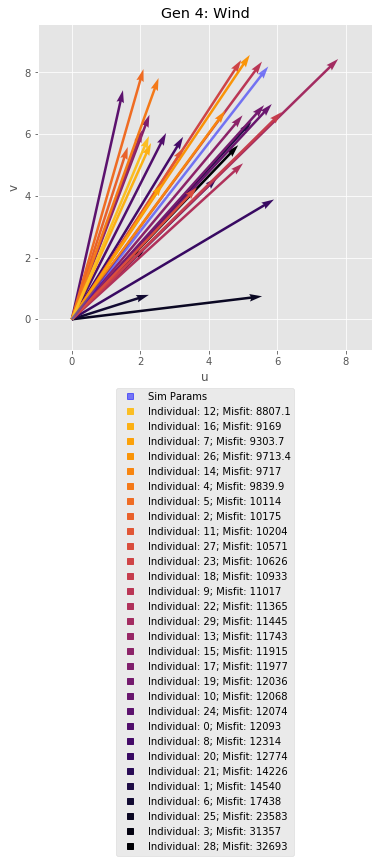

============GENERATION 5============
Mating Pool:


,a,b,h1,u,v,D,ftt,Misfit
12,1.62254,5.98133,"44,315.6",2.25241,5.93561,"16,326.4","6,458","8,807.09"
16,1.76568,5.47158,"43,467.6",2.31303,5.71182,"15,407.8","6,458","9,168.99"
7,1.52107,2.61834,"44,516.7",2.64428,4.39609,"8,643.5","6,458","9,303.73"
26,1.16106,2.93251,"15,892.8",5.19598,8.56644,"34,541.4","6,458","9,713.43"
14,1.5559,5.52131,"24,221.3",4.4809,6.75847,"28,127.2","6,458","9,716.96"
4,1.79225,4.16006,"17,472.5",2.53269,7.81721,"34,541.4","6,458","9,839.9"
5,1.15112,1.13751,"11,276",2.09203,8.1084,"36,375","6,458","10,114.2"
2,2.3818,8.26995,"44,895.3",1.63305,5.58532,"18,024.2","6,458","10,174.6"
11,1.54142,3.78543,"44,853.9",3.27258,5.56125,"14,240.1","6,458","10,203.7"
27,1.77545,3.52416,"37,041.5",3.6515,4.27454,"14,525.8","6,458","10,570.7"


Offspring:


,a,b,h1,u,v,D,ftt
0,3.422,5.47158,"37,041.5",5.55212,8.34879,"44,523.7","6,458"
1,2.3818,8.26995,"15,892.8",2.09203,5.58532,"61,379.8","6,458"
2,1.15112,2.61834,"11,276",1.63305,5.24911,"27,830.4","6,458"
3,1.98554,5.52131,"44,315.6",2.31303,5.56125,"6,664.69","6,458"
4,2.54139,5.47158,"11,010.5",4.4809,8.34879,"8,643.5","6,458"
5,1.62254,4.16006,"35,217.1",3.94298,8.34879,"27,830.4","6,458"
6,1.54142,2.46049,"9,568.08",3.27258,8.1084,"34,541.4","6,458"
7,2.3818,1.13751,"8,915.85",2.64428,6.93776,"14,525.8","6,458"
8,1.62254,1.13751,"43,467.6",5.19598,8.34879,"36,105.4","6,458"
9,1.62254,28.6251,"9,568.08",4.4809,6.97441,"34,541.4","6,458"


Mutated Offspring:


,a,b,h1,u,v,D,ftt,Misfit
14,1.1284,3.91141,"43,962.7",2.97251,6.40785,"13,245.8","6,458","8,237.26"
3,1.98518,5.69511,"44,376.5",2.37086,5.00512,"13,042","6,458","9,440.63"
19,1.16466,2.60875,"13,484.6",4.81014,9.20462,"37,225.6","6,458","9,778.56"
5,1.59403,4.54102,"36,353",4.33304,6.22823,"16,817","6,458","10,245.2"
0,3.22531,21.45,"38,043.7",4.7035,7.90728,"35,257.5","6,458","10,390.7"
6,1.55924,2.46931,"10,385.5",3.52129,8.7246,"51,335.6","6,458","10,423.1"
4,2.59291,4.70831,"10,926.8",4.82142,8.98326,"53,703.7","6,458","10,427.1"
7,2.39622,1.14727,"9,053.09",2.72916,7.16045,"45,367.2","6,458","10,724.4"
13,1.59528,2.89176,"44,659.6",3.14848,4.86254,"10,282.3","6,458","10,947.2"
11,1.98195,3.27912,"44,294.3",2.57288,4.27275,"8,860.9","6,458","11,365.1"


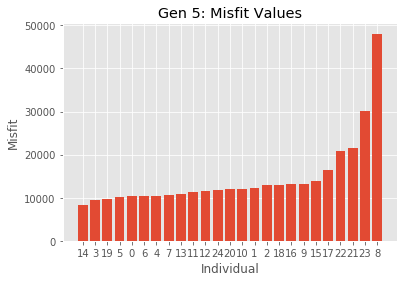

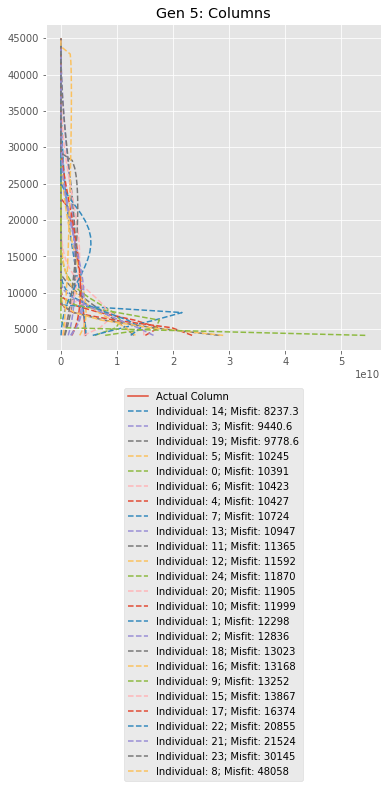

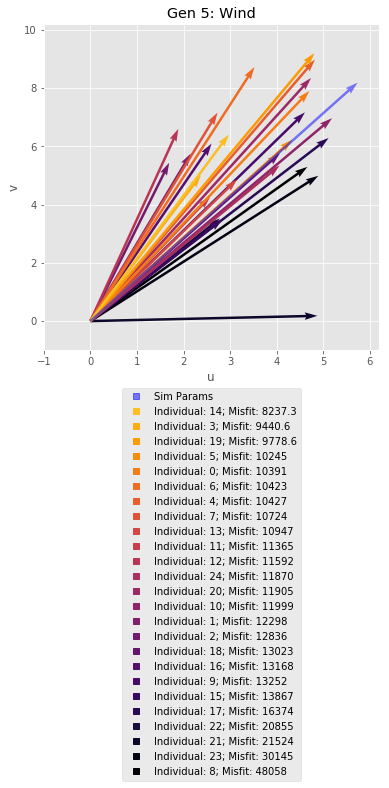

a          1.1284
b         3.91141
h1       43,962.7
u         2.97251
v         6.40785
D        13,245.8
ftt         6,458
Misfit   8,237.26
Name: 14, dtype: float64

[]

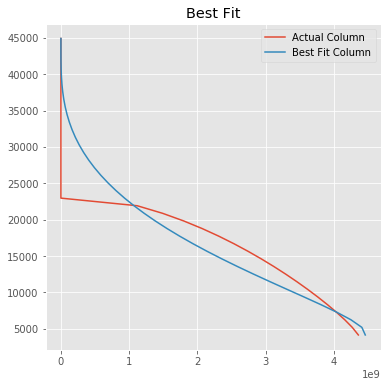

In [22]:
from matplotlib import cm
q_mass = beta_plume(config["ALPHA"],config["BETA"],config["PLUME_HEIGHT"],
                    config["ERUPTION_MASS"],
                    heights,
                    config["VENT_ELEVATION"], 
                    config["THEO_MAX_COL"])
gen=1
for column, misfit, mating_pool, offspring, mutated, tgsd, mass in zip(column_logs, misfit_logs, mating_logs, offspring_logs, mutated_logs, tgsd_logs, mass_logs):
    print("============GENERATION %d============"%gen)
    print("Mating Pool:")
    mating_pool_df = pd.DataFrame(mating_pool).sort_values(by=['Misfit'])
    mating_pool_df = mating_pool_df[["a", "b", "h1", "u", "v", "D", "ftt", "Misfit"]]
    display(mating_pool_df)
    print("Offspring:")
    offspring_df = pd.DataFrame(offspring)
    offspring_df = offspring_df[["a", "b", "h1", "u", "v", "D", "ftt"]]
    display(offspring_df)
    print("Mutated Offspring:")
    mutated_df = pd.DataFrame(mutated)
    
    mutated_df = mutated_df[["a", "b", "h1", "u", "v", "D", "ftt", "Misfit"]].sort_values(by=['Misfit'])
    display(mutated_df)
    
    plt.bar([str(idx) for idx in mutated_df.index], mutated_df["Misfit"].values)
    plt.title("Gen %d: Misfit Values"%gen)
    plt.xlabel("Individual")
    plt.ylabel("Misfit")
    plt.show()
    
    
    fig, ax1 = plt.subplots(1,1, figsize=(6, 6), facecolor='w', edgecolor='k')
    ax1.plot(q_mass, heights, label="Actual Column")
    fig, ax2 = plt.subplots(1,1, figsize=(6, 6), facecolor='w', edgecolor='k')
    
    ax2.quiver(0,0, sim_params["u"], sim_params["v"], 
               angles='xy', scale_units='xy', scale=1, color="b", label="Simulation Parameters",
               zorder=max(mutated_df["Misfit"].values)+10,alpha=.5)
    origins = np.zeros(len(mutated_df))
    
    color = cm.inferno_r(np.linspace(.15, 1, len(mutated_df)))
    
    for i, idx in enumerate(mutated_df.index):
        ax1.plot(column[idx], heights, '--',
                 label="Individual: %d; Misfit: %.5g"%(idx, mutated_df.loc[idx]["Misfit"]))
        ax2.quiver(0,0, mutated_df.loc[idx]["u"], mutated_df.loc[idx]["v"], 
                   color=color[i], angles='xy', scale_units='xy', scale=1, label=idx, 
                   zorder=1/mutated_df.loc[idx]["Misfit"] + 1)

    ax1.set_title("Gen %d: Columns"%gen)
    ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1))
    markers = [plt.Line2D([0,0],[0,0], color='b', marker='s', linestyle='', alpha=.5)]
    markers += [plt.Line2D([0,0],[0,0], color=col, marker='s', linestyle='') for col in color]
    labels = ["Sim Params"]
    labels += ["Individual: %d; Misfit: %.5g"%(i, m) for i, m in zip(mutated_df.index, mutated_df["Misfit"].values)]
    ax2.legend(markers, labels, numpoints=1, loc='upper center', bbox_to_anchor=(0.5, -0.1))
    ax2.set_xlim([-1, max(mutated_df["u"].values)+1])
    ax2.set_ylim([-1, max(mutated_df["v"].values)+1])
    ax2.set_xlabel("u")
    ax2.set_ylabel("v")
    ax2.set_title("Gen %d: Wind"%gen)
    plt.show()
#     for i, t in enumerate(tgsd):
#         plt.plot(t, label="Ind. %d"%i)
#     plt.legend()
#     plt.show()
    gen += 1
    
    

fig, ax1 = plt.subplots(1,1, figsize=(6, 6), facecolor='w', edgecolor='k')

ax1.plot(q_mass, heights, label="Actual Column")
ax1.plot(column[mutated_df.index[0]], heights, label="Best Fit Column")
ax1.legend()
ax1.set_title("Best Fit")
display(mutated_df.loc[mutated_df.index[0]])

plt.plot()

Run 0===========================================================================


C:\Users\nmostert\Documents\repos\inversion_project\utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


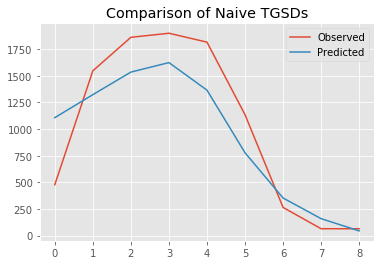

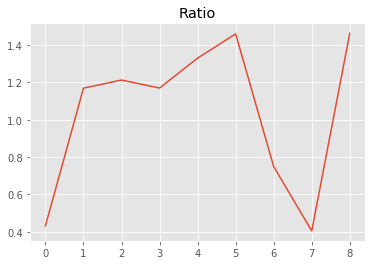

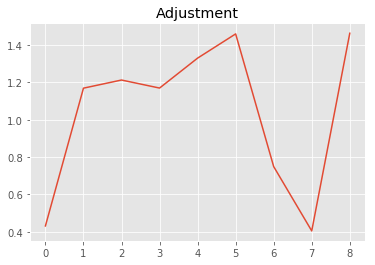

63196567258.89917
1.125


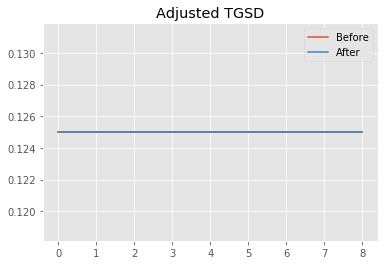

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


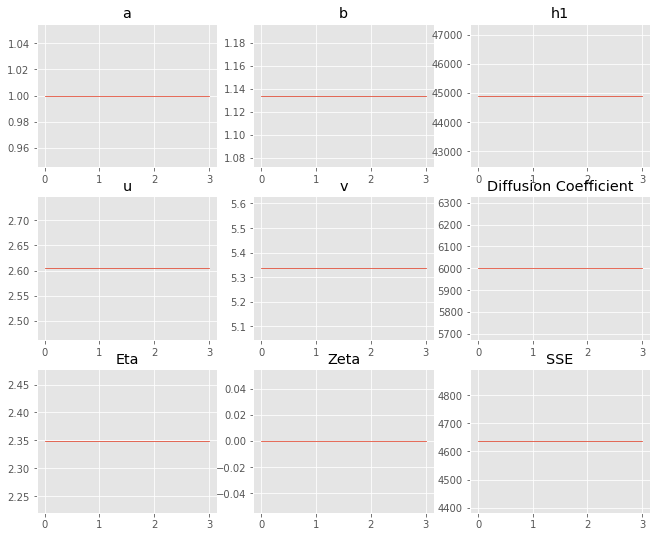

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 1 Time: 0.047 minutes


Estimated remaining run time: 0.420 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


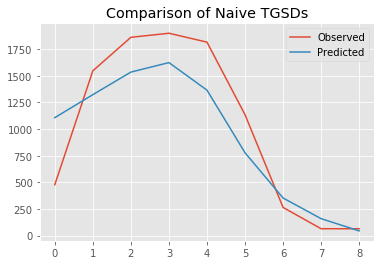

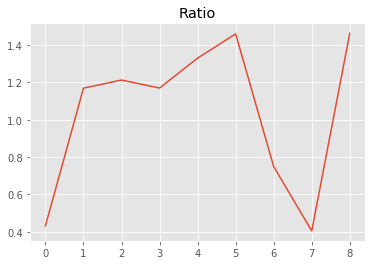

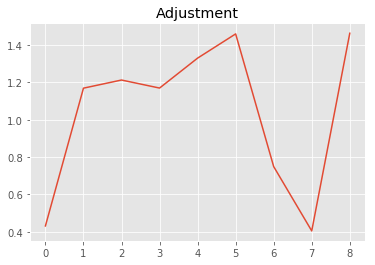

63196567258.89917
1.125


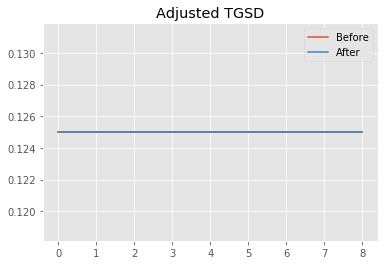

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


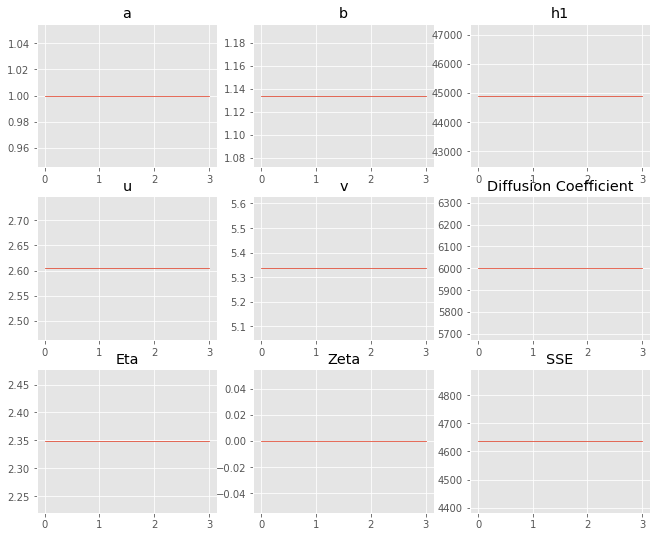

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 2 Time: 0.044 minutes


Estimated remaining run time: 0.515 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


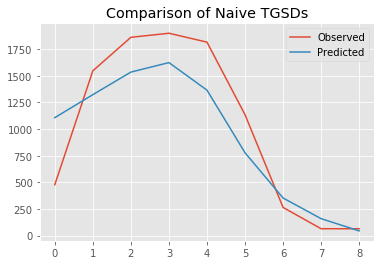

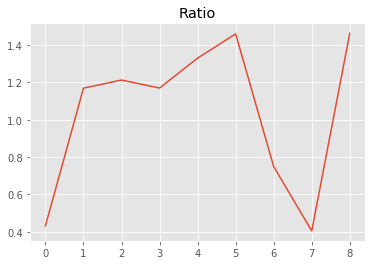

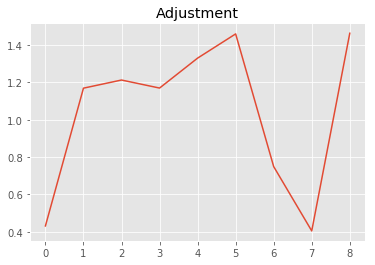

63196567258.89917
1.125


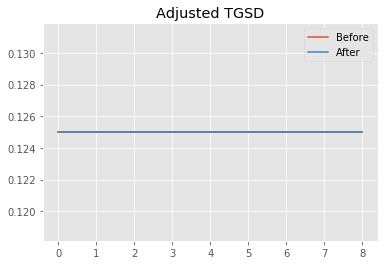

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


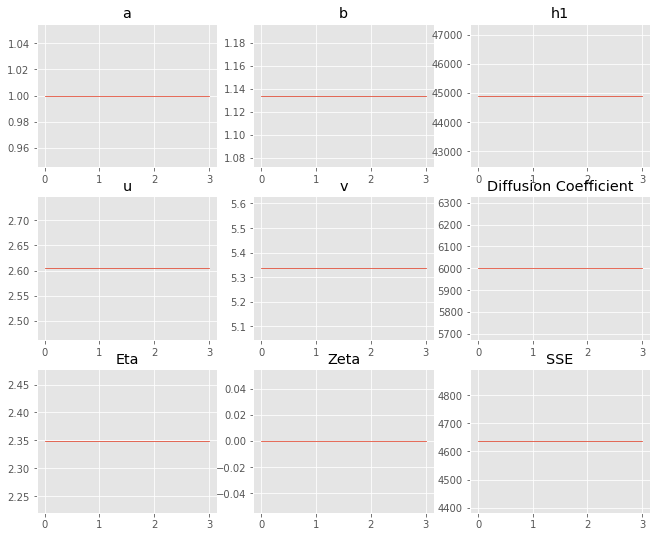

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 3 Time: 0.047 minutes


Estimated remaining run time: 0.550 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


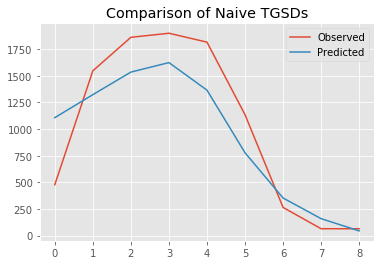

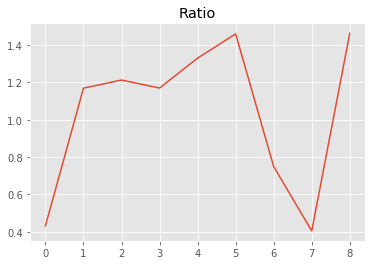

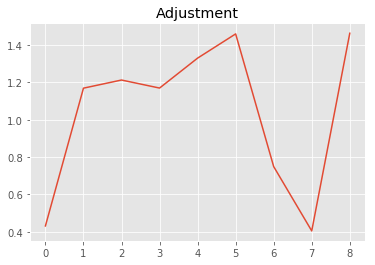

63196567258.89917
1.125


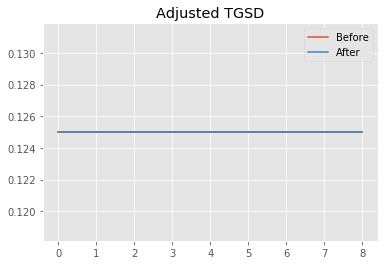

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


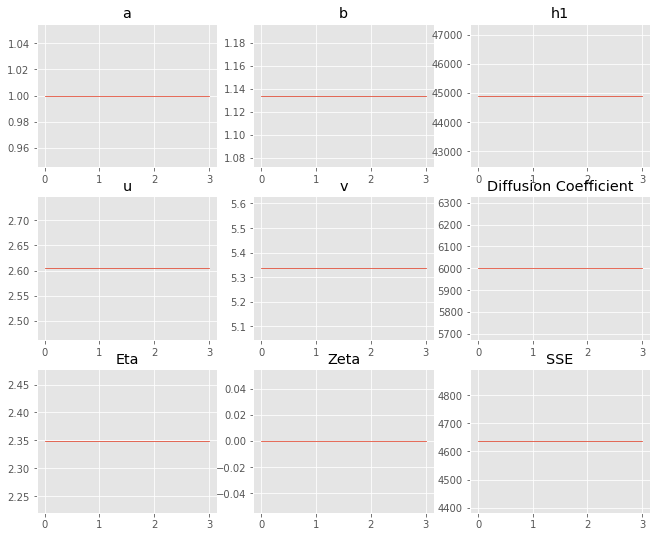

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 4 Time: 0.047 minutes


Estimated remaining run time: 0.552 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


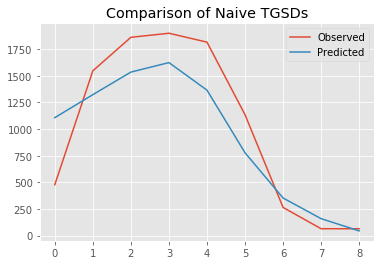

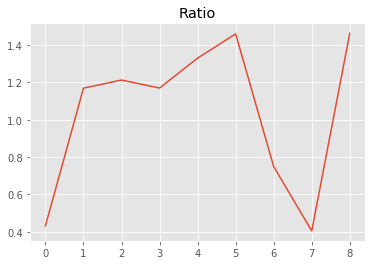

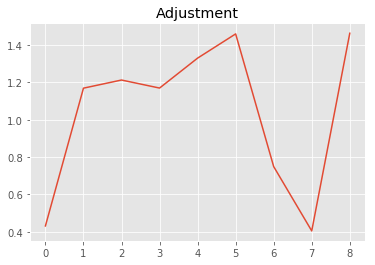

63196567258.89917
1.125


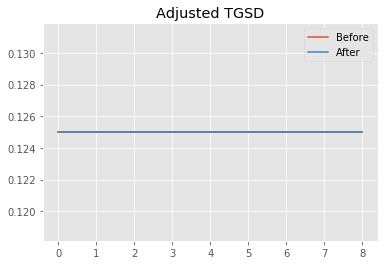

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


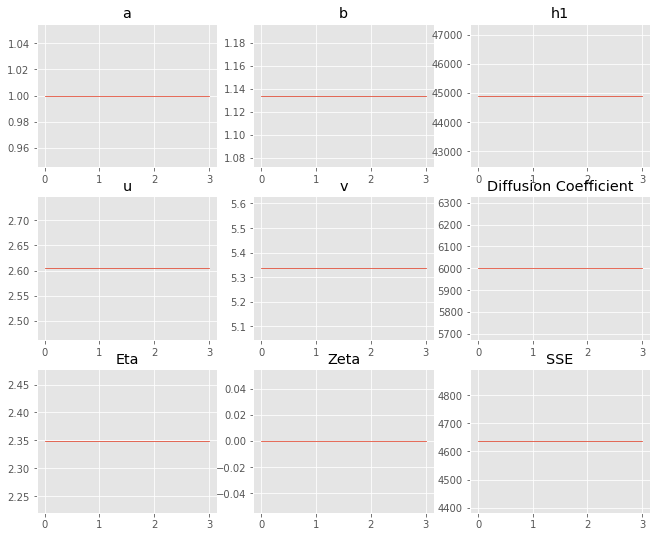

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 5 Time: 0.043 minutes


Estimated remaining run time: 0.530 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


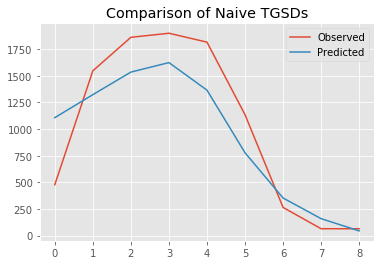

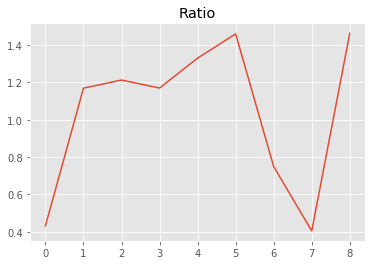

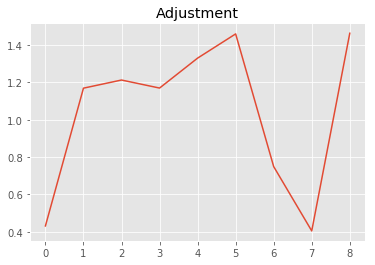

63196567258.89917
1.125


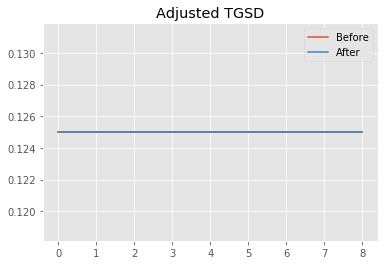

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


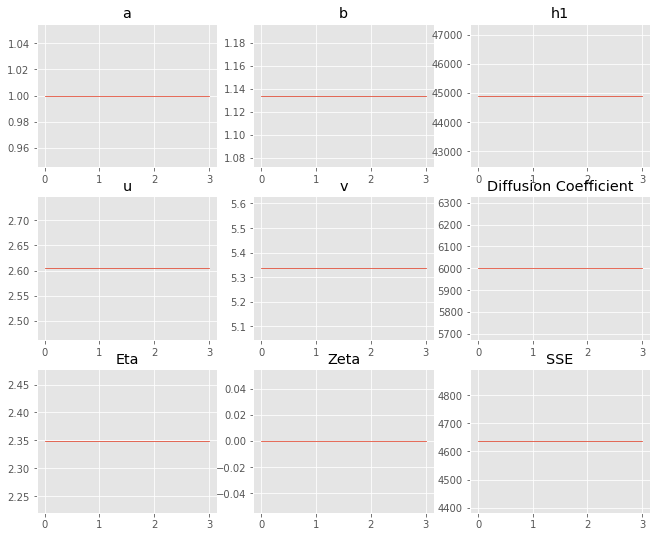

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 6 Time: 0.044 minutes


Estimated remaining run time: 0.505 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


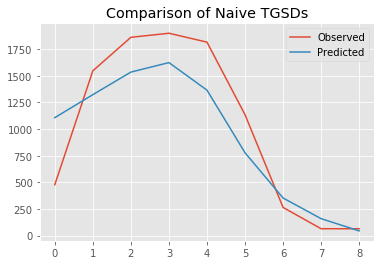

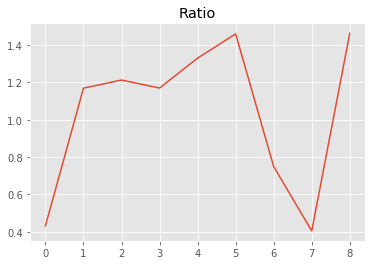

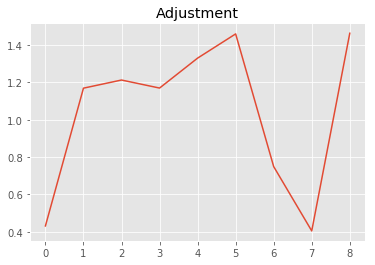

63196567258.89917
1.125


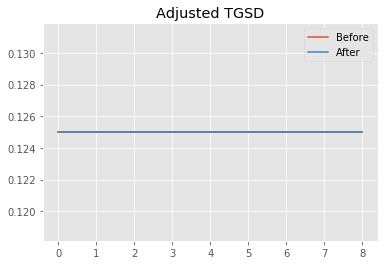

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


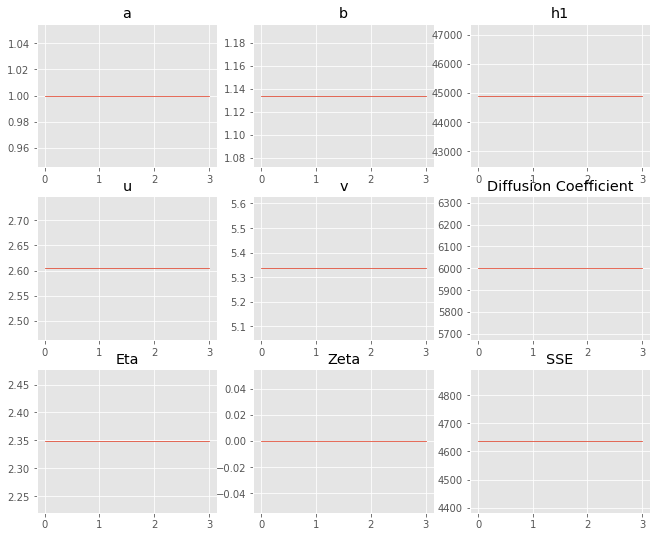

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 7 Time: 0.047 minutes


Estimated remaining run time: 0.479 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


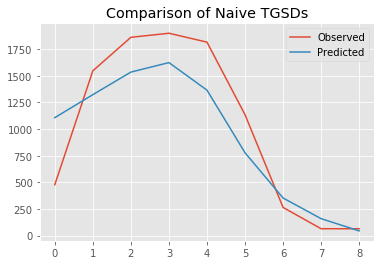

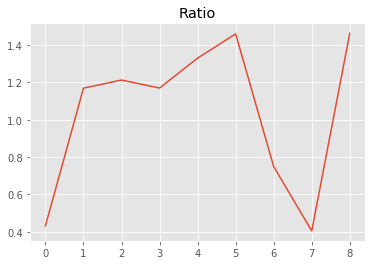

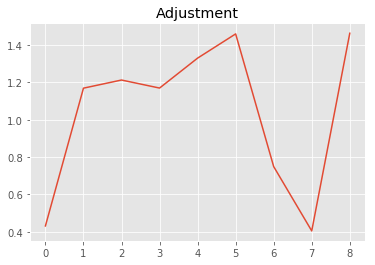

63196567258.89917
1.125


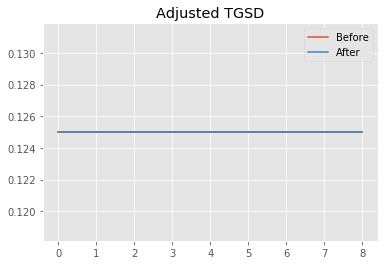

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


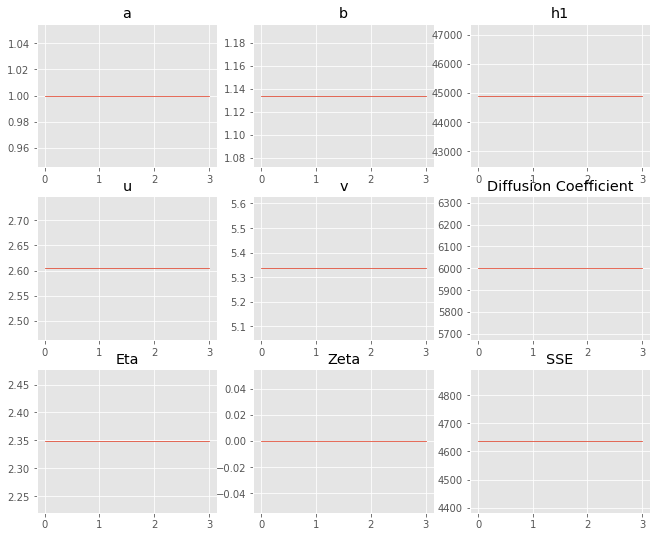

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 8 Time: 0.045 minutes


Estimated remaining run time: 0.444 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


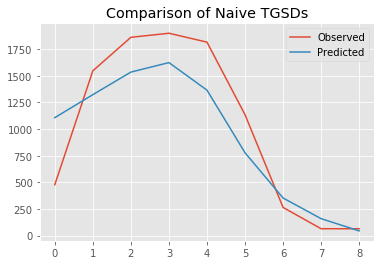

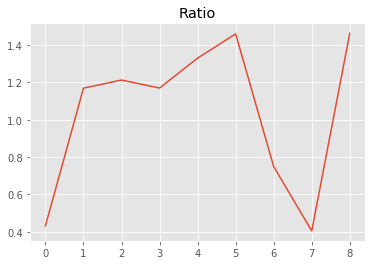

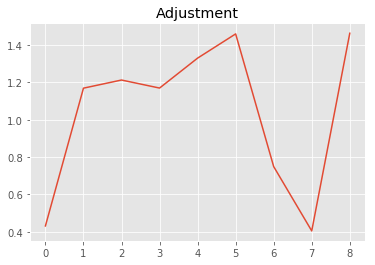

63196567258.89917
1.125


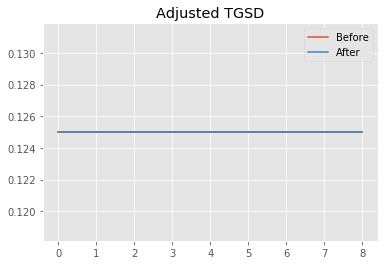

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


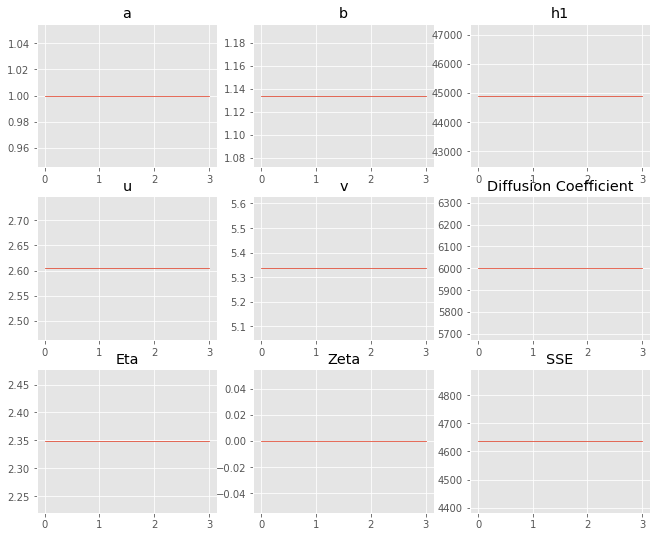

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 9 Time: 0.047 minutes


Estimated remaining run time: 0.410 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


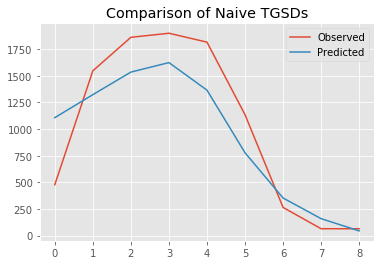

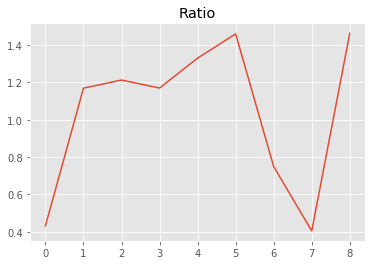

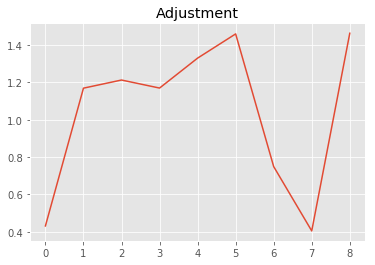

63196567258.89917
1.125


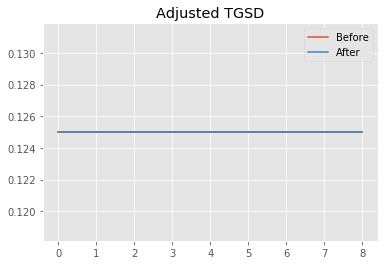

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


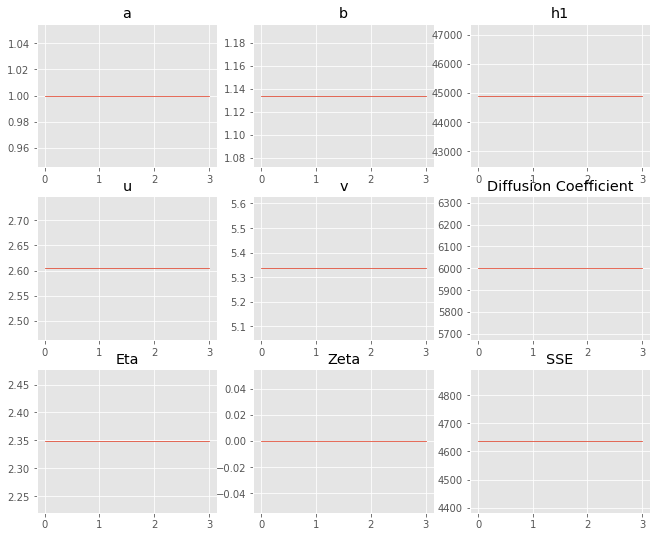

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 10 Time: 0.046 minutes


Estimated remaining run time: 0.373 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


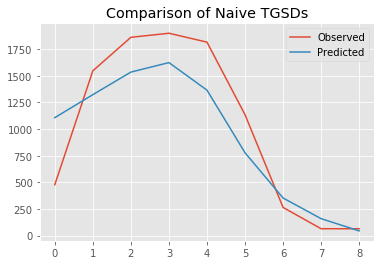

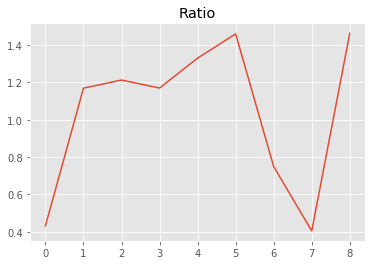

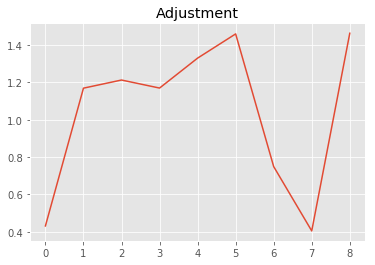

63196567258.89917
1.125


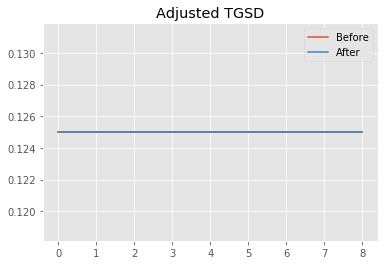

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


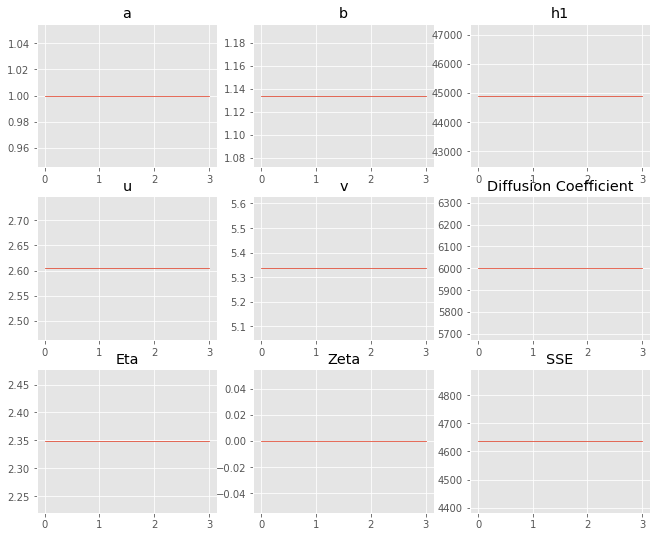

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 11 Time: 0.049 minutes


Estimated remaining run time: 0.337 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


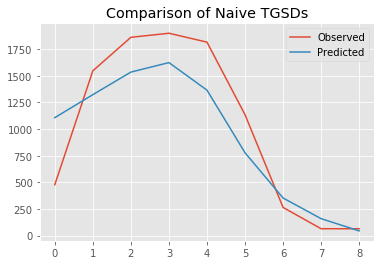

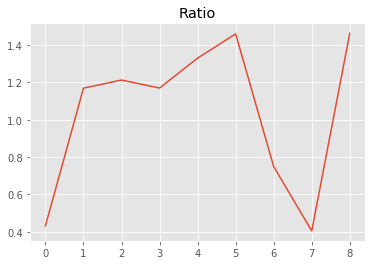

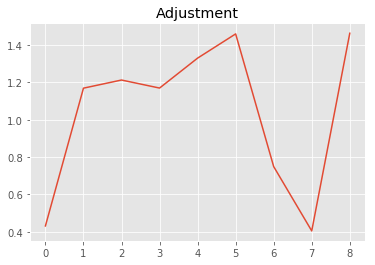

63196567258.89917
1.125


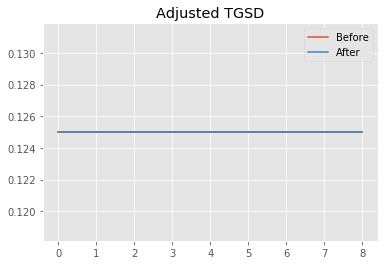

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


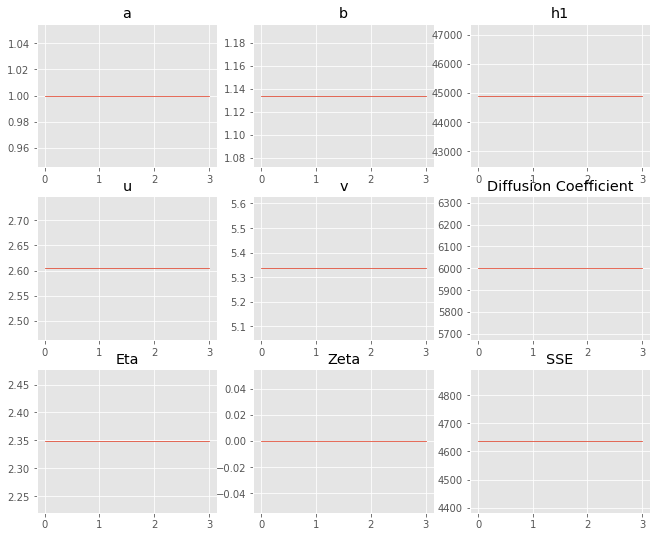

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 12 Time: 0.051 minutes


Estimated remaining run time: 0.299 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


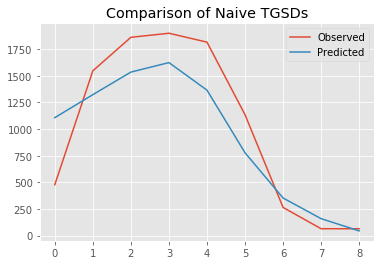

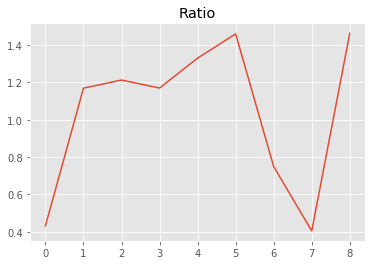

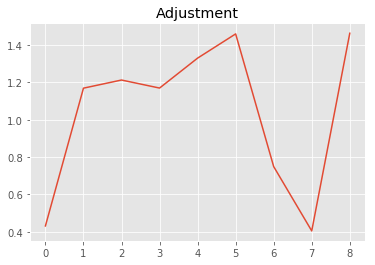

63196567258.89917
1.125


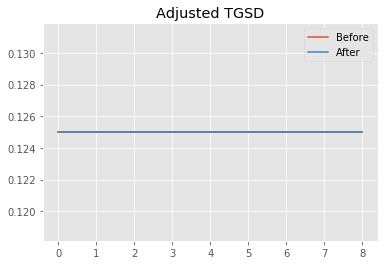

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


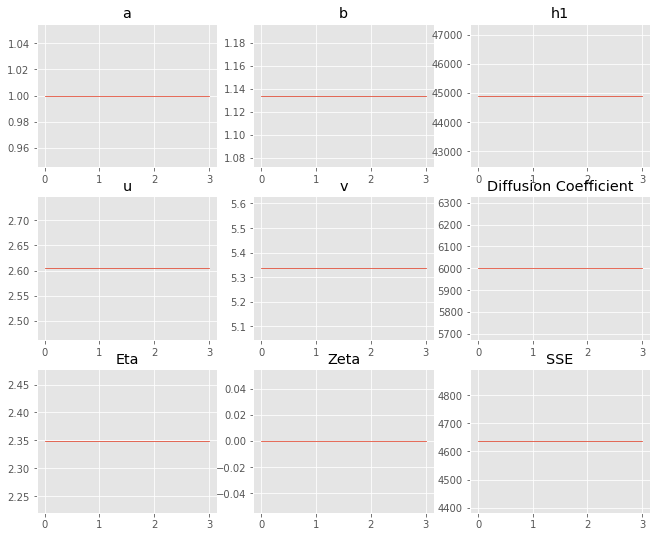

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 13 Time: 0.046 minutes


Estimated remaining run time: 0.258 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


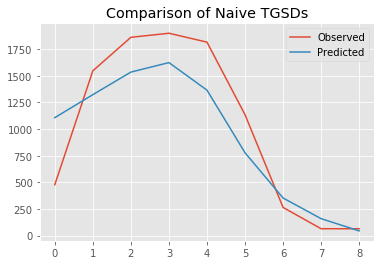

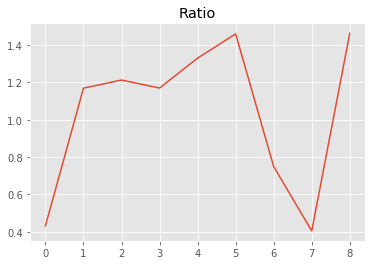

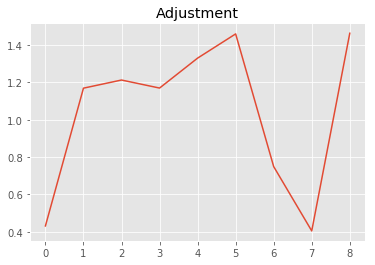

63196567258.89917
1.125


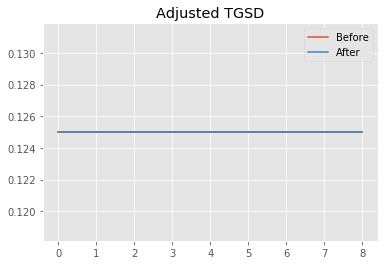

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


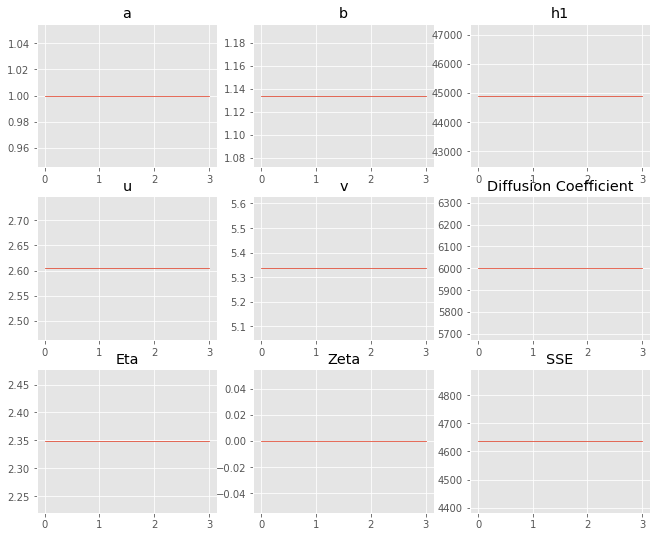

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 14 Time: 0.047 minutes


Estimated remaining run time: 0.216 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


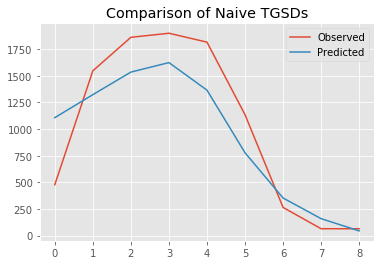

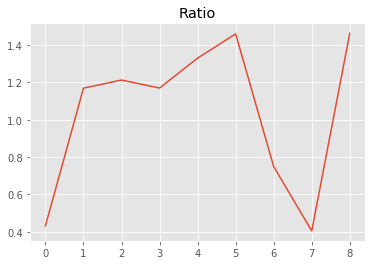

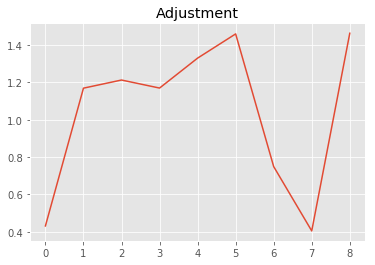

63196567258.89917
1.125


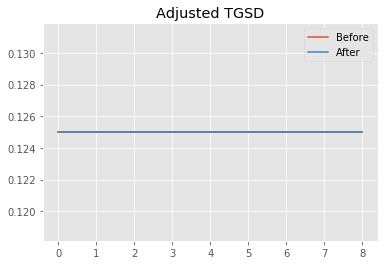

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


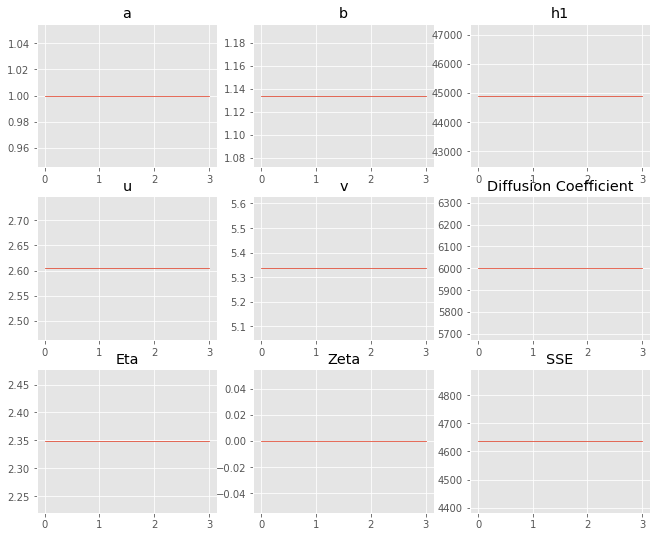

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 15 Time: 0.046 minutes


Estimated remaining run time: 0.174 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


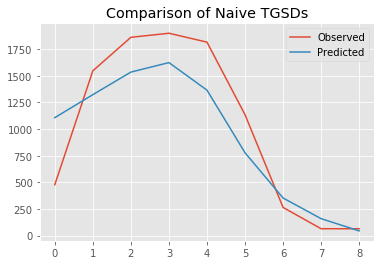

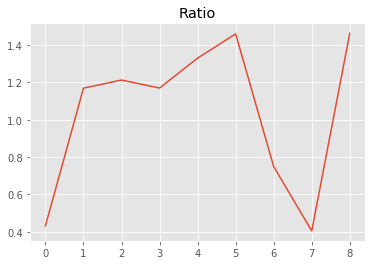

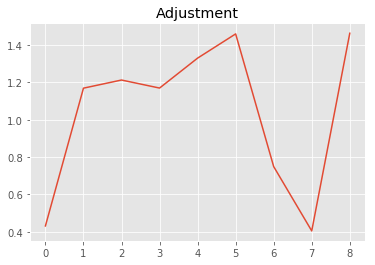

63196567258.89917
1.125


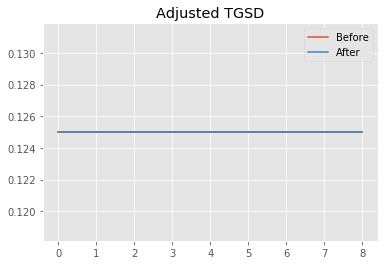

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


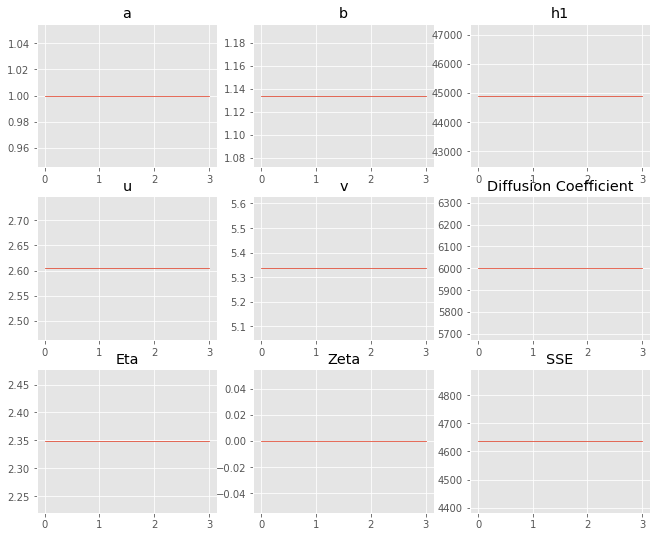

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 16 Time: 0.044 minutes


Estimated remaining run time: 0.131 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


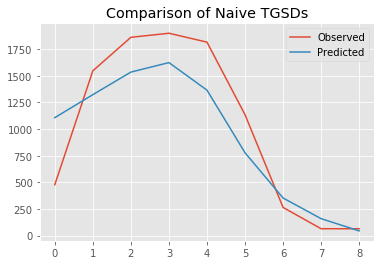

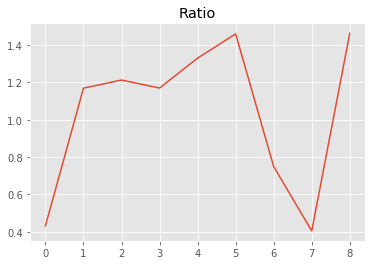

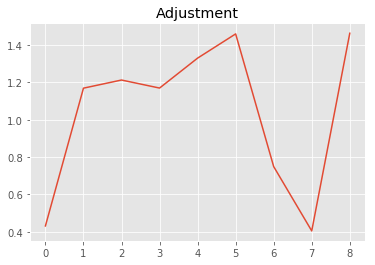

63196567258.89917
1.125


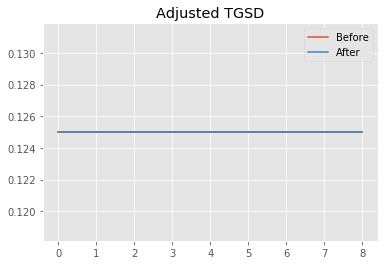

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


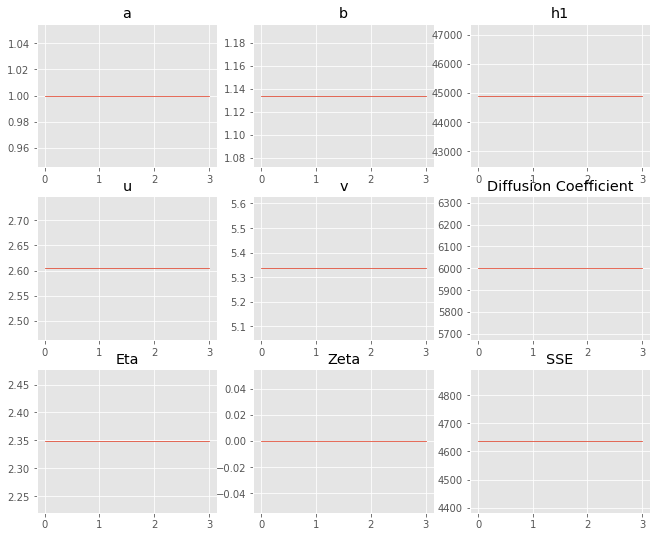

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 17 Time: 0.047 minutes


Estimated remaining run time: 0.087 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


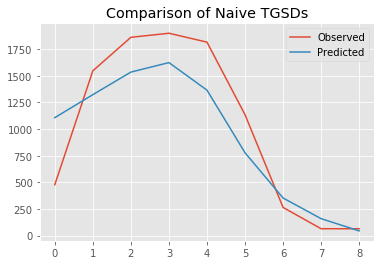

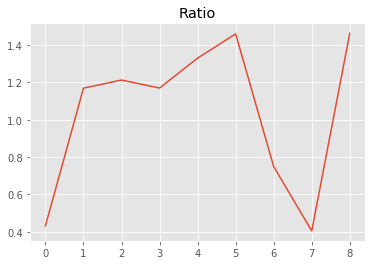

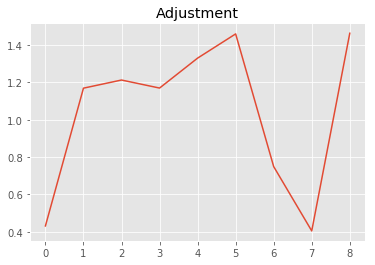

63196567258.89917
1.125


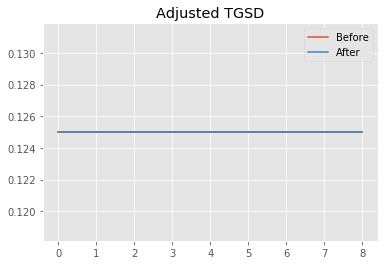

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


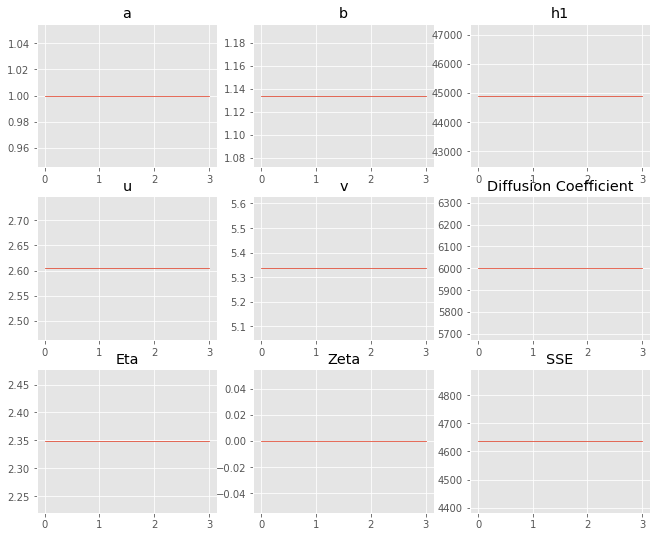

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 18 Time: 0.045 minutes


Estimated remaining run time: 0.044 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


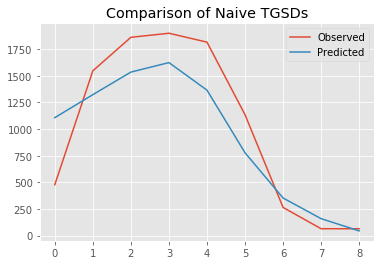

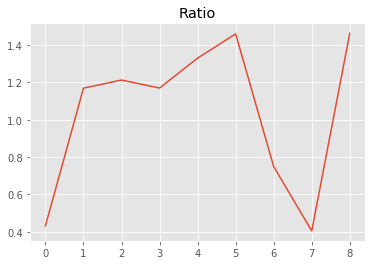

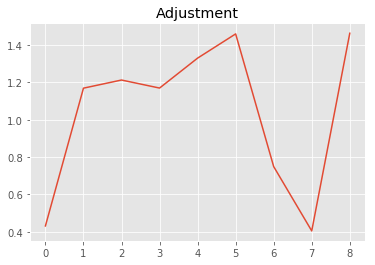

63196567258.89917
1.125


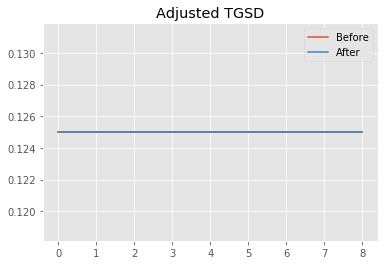

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


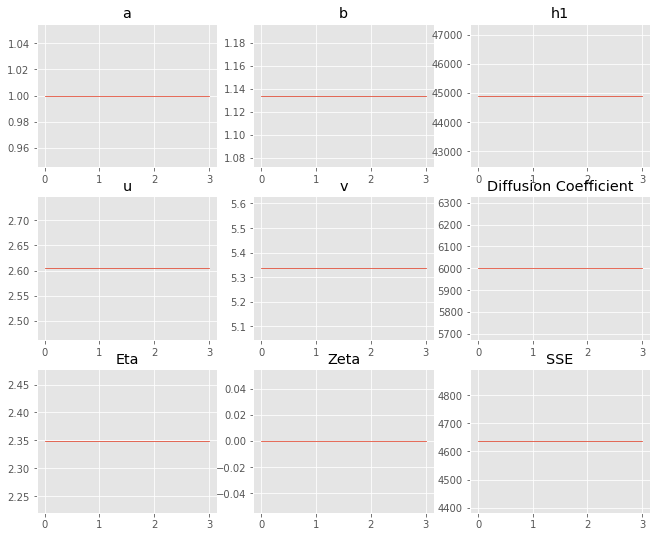

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 19 Time: 0.049 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.88e+09 	1.11e+03 	4.77e+02 	0.4314 		0.0523
1 	6.88e+09 	1.32e+03 	1.55e+03 	1.1692 		0.1695
2 	6.88e+09 	1.53e+03 	1.86e+03 	1.2127 		0.2039
3 	6.88e+09 	1.62e+03 	1.90e+03 	1.1698 		0.2081
4 	6.88e+09 	1.36e+03 	1.82e+03 	1.3301 		0.1989
5 	6.88e+09 	7.77e+02 	1.13e+03 	1.4597 		0.1243
6 	6.88e+09 	3.53e+02 	2.64e+02 	0.7491 		0.0289
7 	6.88e+09 	1.59e+02 	6.43e+01 	0.4047 		0.0070
8 	6.88e+09 	4.37e+01 	6.40e+01 	1.4633 		0.0070


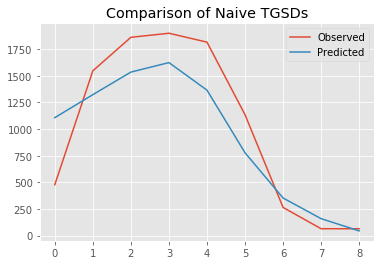

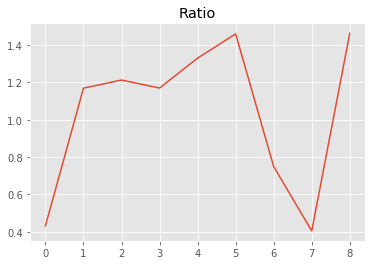

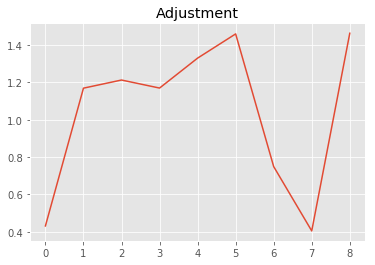

63196567258.89917
1.125


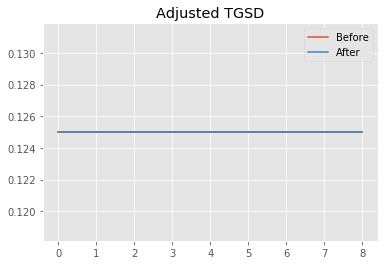

Old Total Mass: 5.5e+10
New Total Mass: 5.5e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 5.5e+10
After: 		|1.00002 	1.13405 	44908 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 4637
New Misfit: 4637
Convergence:
3.922772687686651e-16

____________________
a = 1.00002	b = 1.13405	            h1 = 44908.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 55000000000.00000
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 4636.9992563055075
Prior Misfit: 4637,	 Post Misfit: 4637


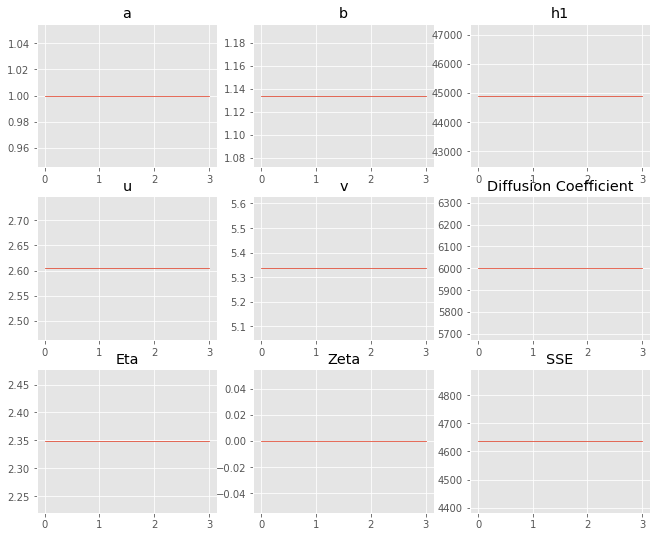

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.00002,1.00002
b,1.13405,1.13405
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,908","44,908"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 20 Time: 0.047 minutes


Estimated remaining run time: -0.044 minutes


Total Run Time: 0.92786 minutes


In [27]:
log="verb"
data_set = obs_df
iterations = 20

# tgsd = get_tgsd(data_set, naive_phi_steps)

prior_phi_steps = copy.deepcopy(naive_phi_steps)
for i, phi in enumerate(prior_phi_steps):
    phi["probability"] = 1/8
#     phi["probability"] = tgsd[i]

# prior_phi_steps = copy.deepcopy(naive_phi_steps)
# for j, phi in enumerate(prior_phi_steps):
#     phi["probability"] = phi_probs[j]

out = gaussian_stack_multi_run(
    data_set, len(data_set), int(config["INV_STEPS"]), 
    config["VENT_ELEVATION"], 
    config["THEO_MAX_COL"], 2500, prior_phi_steps, config["ERUPTION_MASS"], param_config, runs=iterations, column_cap = config["THEO_MAX_COL"], pre_samples=5,
    sol_iter=0, max_iter=40, tol=0.006, 
    adjust_TGSD=False, adjust_mass=False,
    adjustment_factor=0.5
)
inverted_masses_list, misfit_list, params_list, priors_list, heights, tgsd_list, mass_list = out

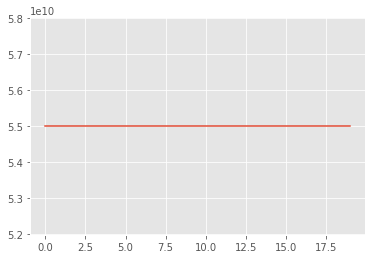

In [28]:
plt.plot(mass_list)
plt.show()

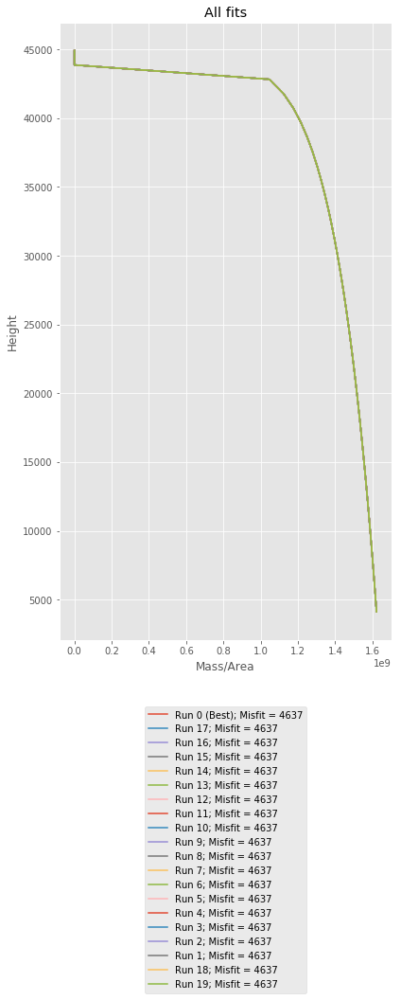

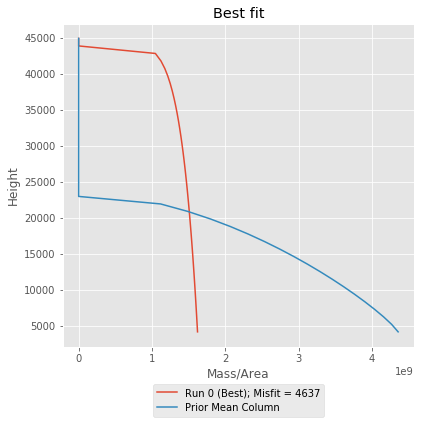

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
0,1.00002,1.13405,"44,908",2.60482,5.33615,"5,999.9","6,458",2.34894,0,5.5e+10,"4,637"
17,1.00002,1.13405,"44,908",2.60482,5.33615,"5,999.9","6,458",2.34894,0,5.5e+10,"4,637"
16,1.00002,1.13405,"44,908",2.60482,5.33615,"5,999.9","6,458",2.34894,0,5.5e+10,"4,637"
15,1.00002,1.13405,"44,908",2.60482,5.33615,"5,999.9","6,458",2.34894,0,5.5e+10,"4,637"
14,1.00002,1.13405,"44,908",2.60482,5.33615,"5,999.9","6,458",2.34894,0,5.5e+10,"4,637"
13,1.00002,1.13405,"44,908",2.60482,5.33615,"5,999.9","6,458",2.34894,0,5.5e+10,"4,637"
12,1.00002,1.13405,"44,908",2.60482,5.33615,"5,999.9","6,458",2.34894,0,5.5e+10,"4,637"
11,1.00002,1.13405,"44,908",2.60482,5.33615,"5,999.9","6,458",2.34894,0,5.5e+10,"4,637"
10,1.00002,1.13405,"44,908",2.60482,5.33615,"5,999.9","6,458",2.34894,0,5.5e+10,"4,637"
9,1.00002,1.13405,"44,908",2.60482,5.33615,"5,999.9","6,458",2.34894,0,5.5e+10,"4,637"


,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


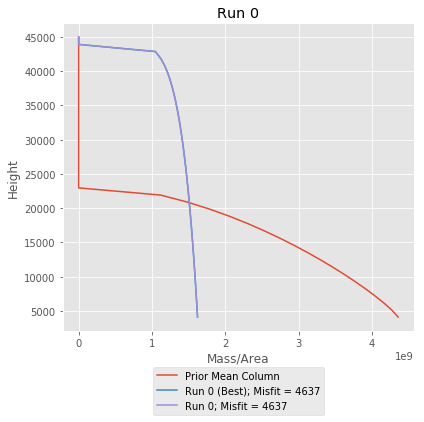

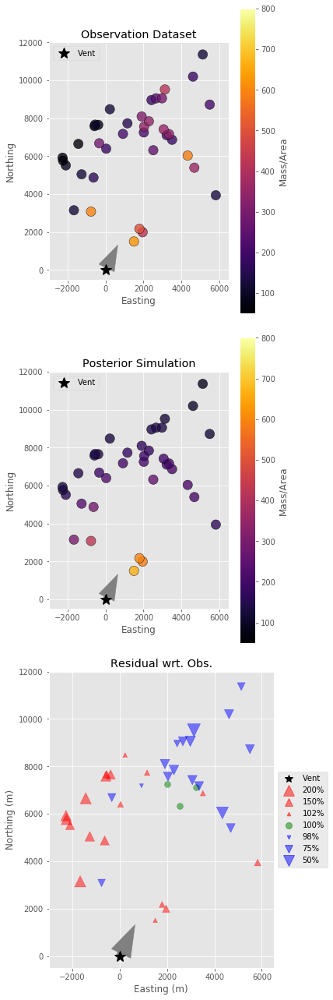

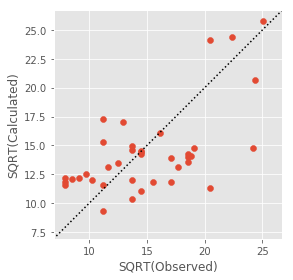

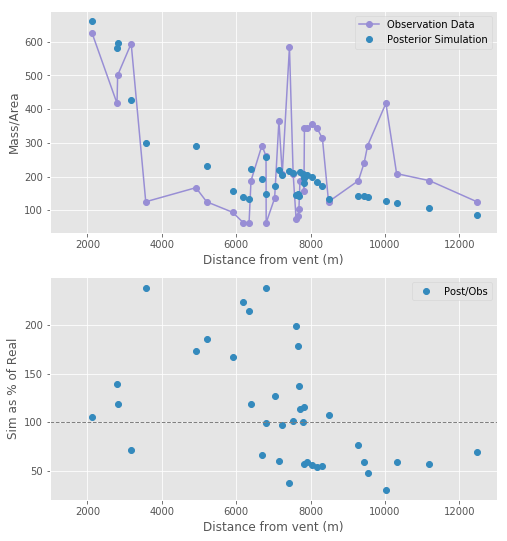

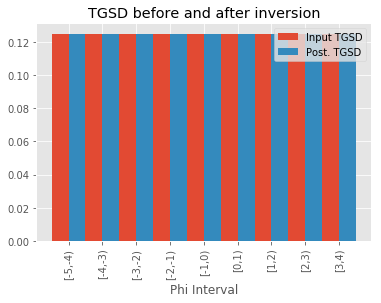

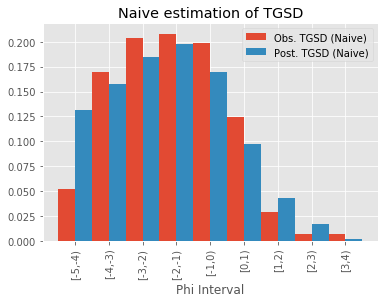

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


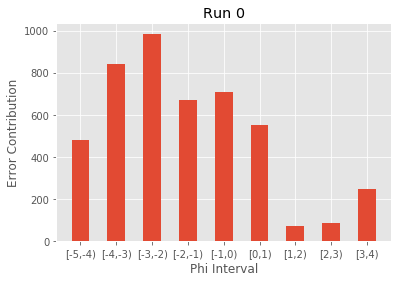

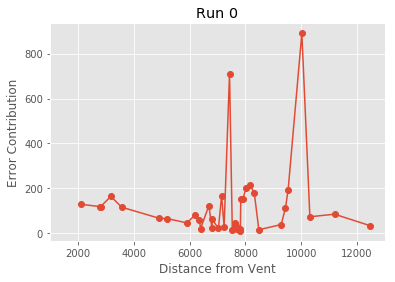

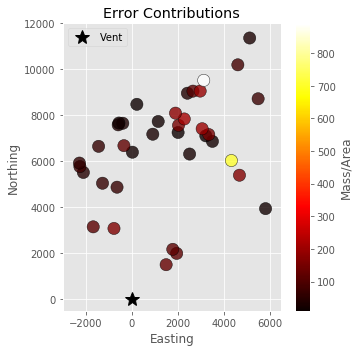

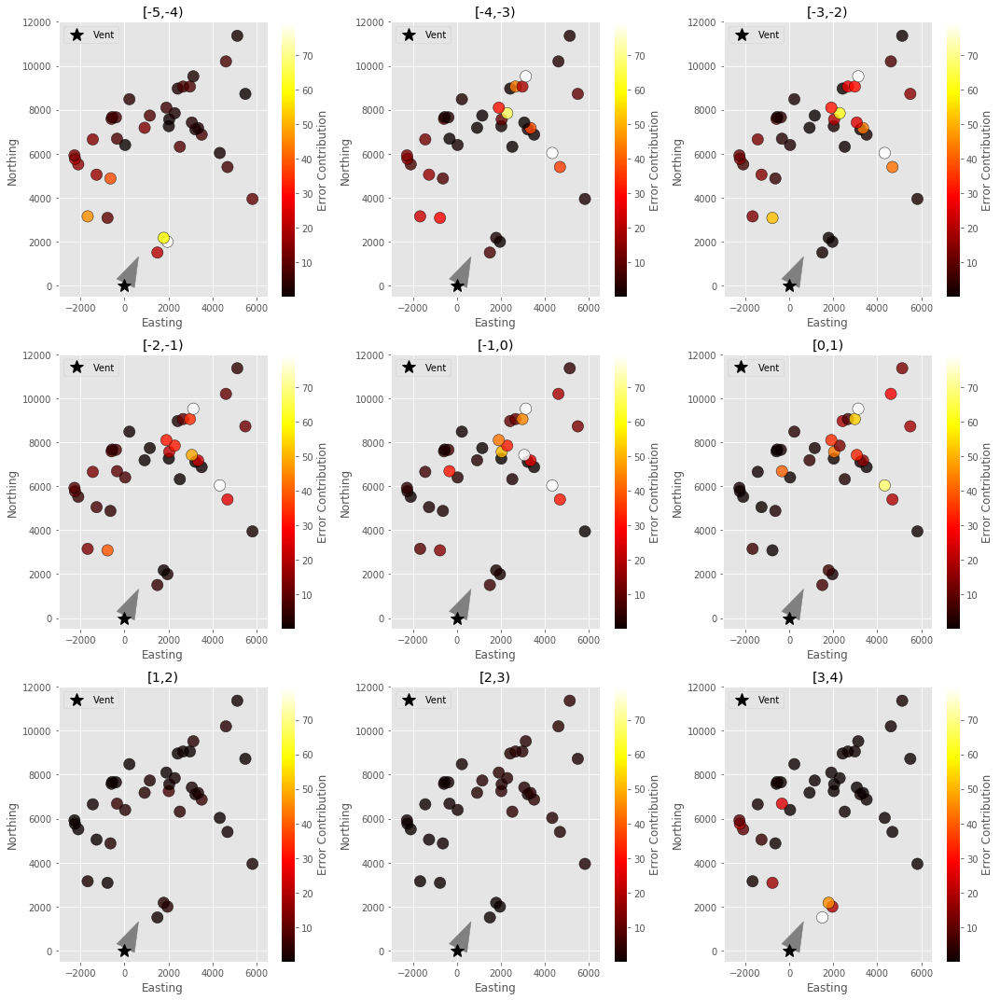

c:\users\nmostert\envs\spew\lib\site-packages\ipykernel_launcher.py:283: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
c:\users\nmostert\envs\spew\lib\site-packages\ipykernel_launcher.py:284: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
c:\users\nmostert\envs\spew\lib\site-packages\pandas\core\frame.py:3781: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  return super(DataFrame,

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


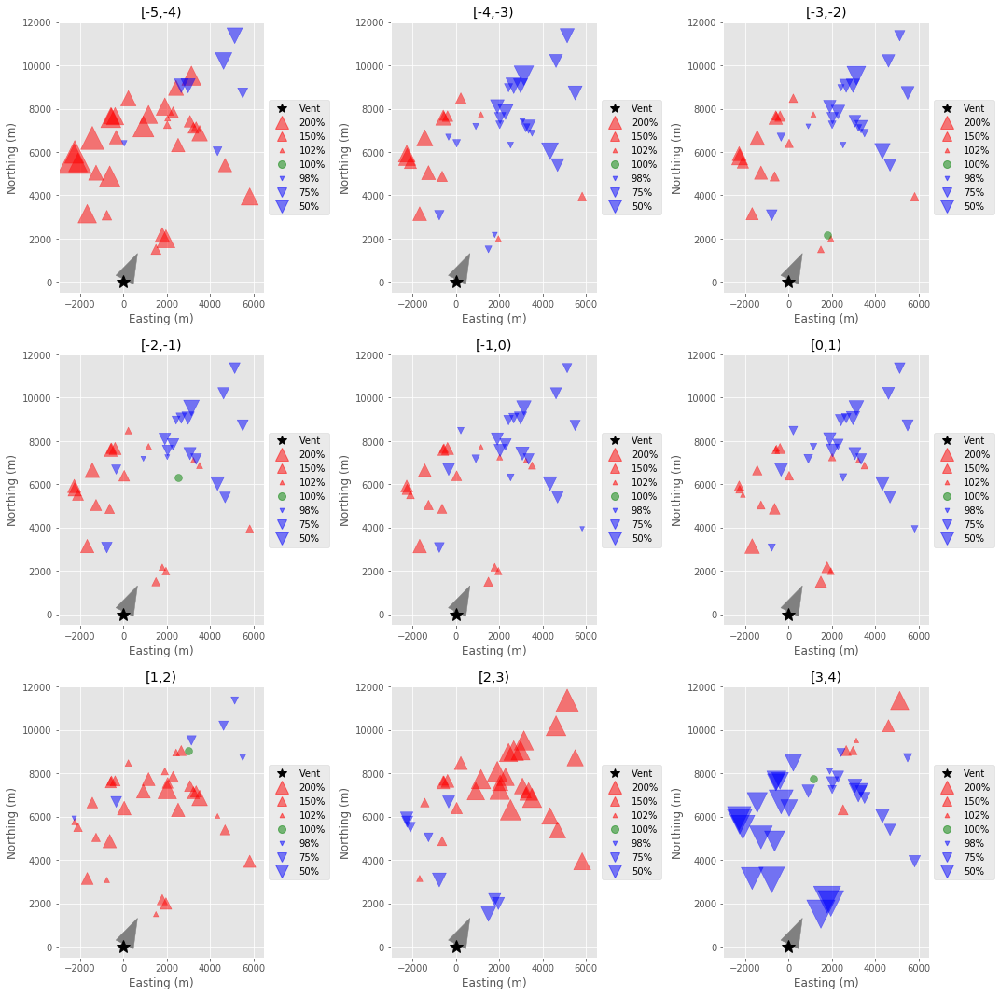

,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


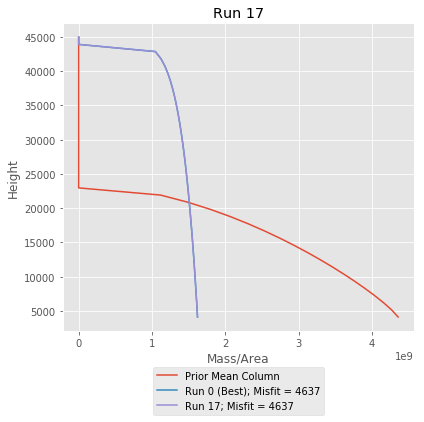

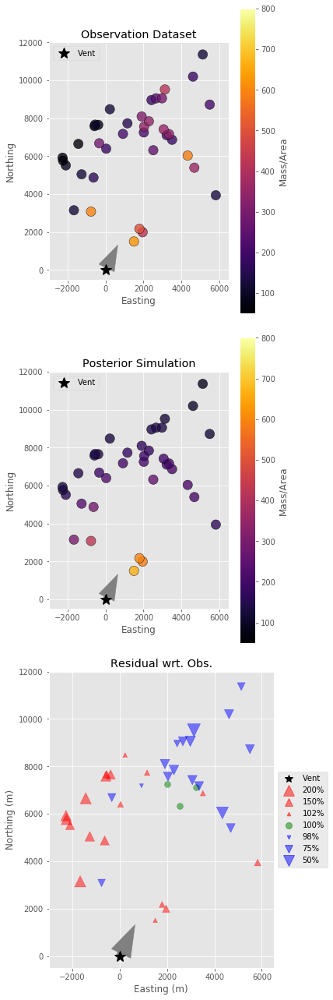

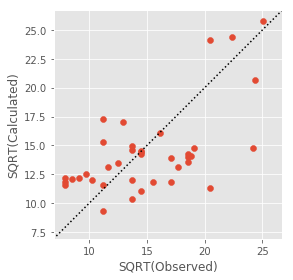

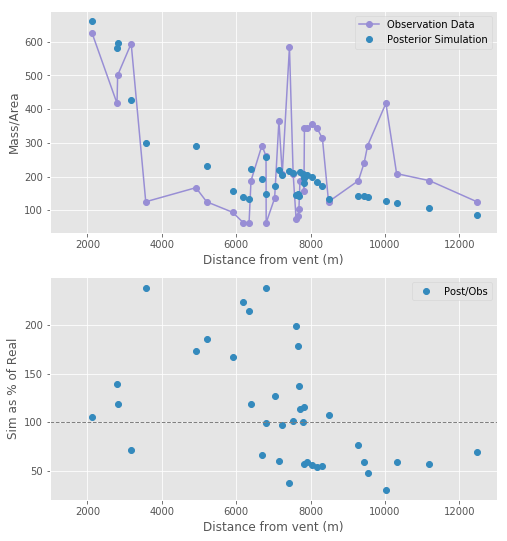

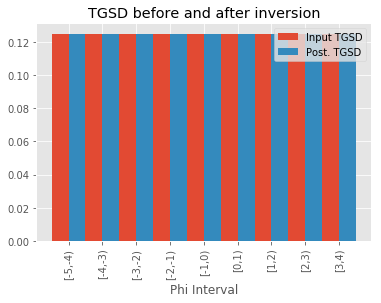

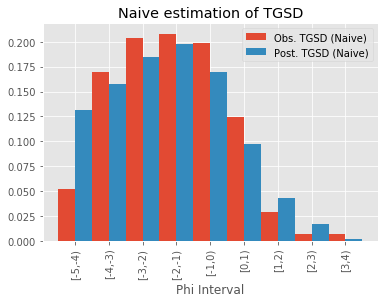

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


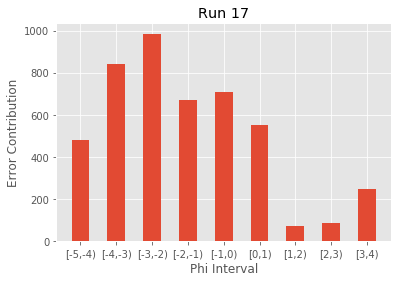

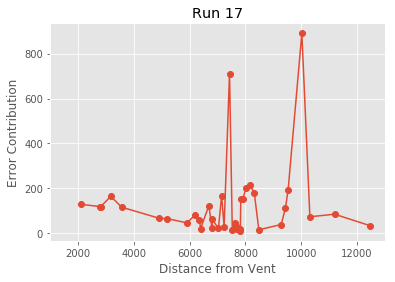

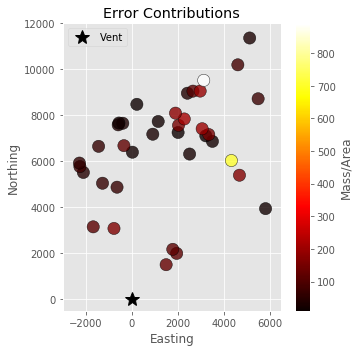

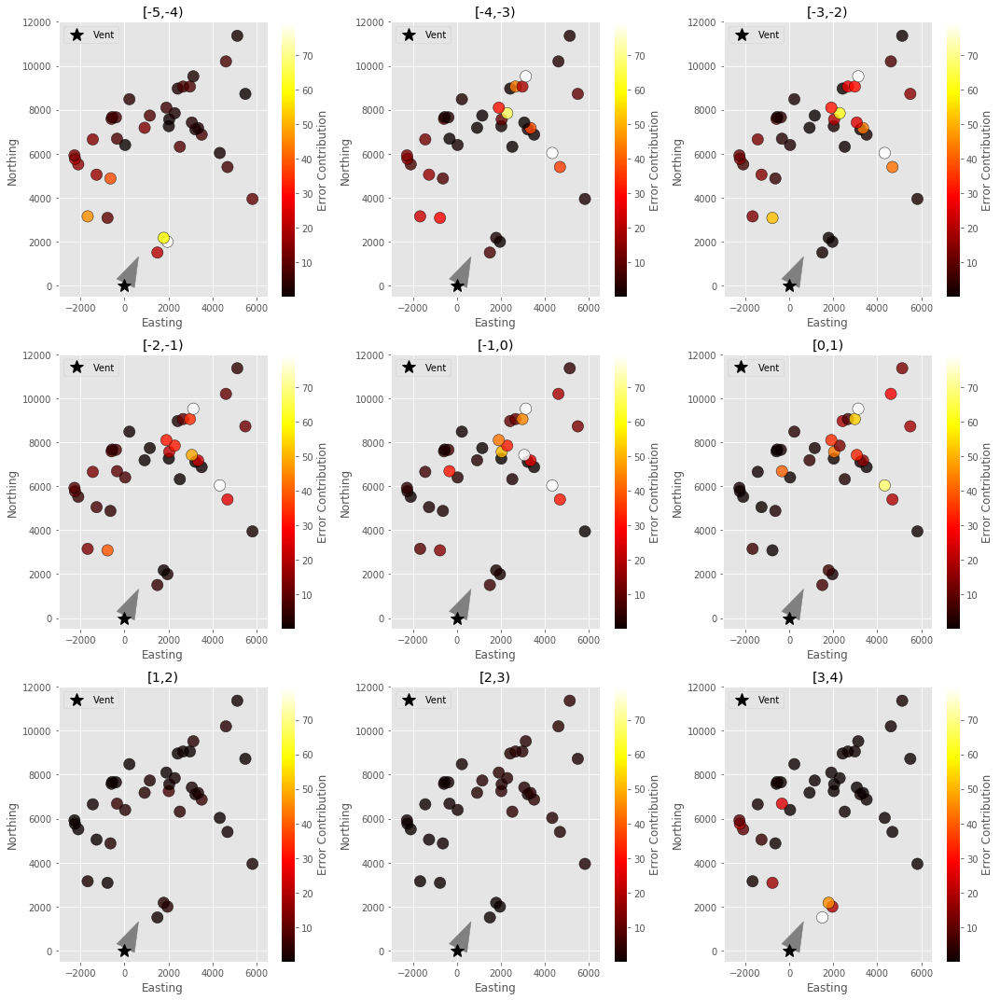

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


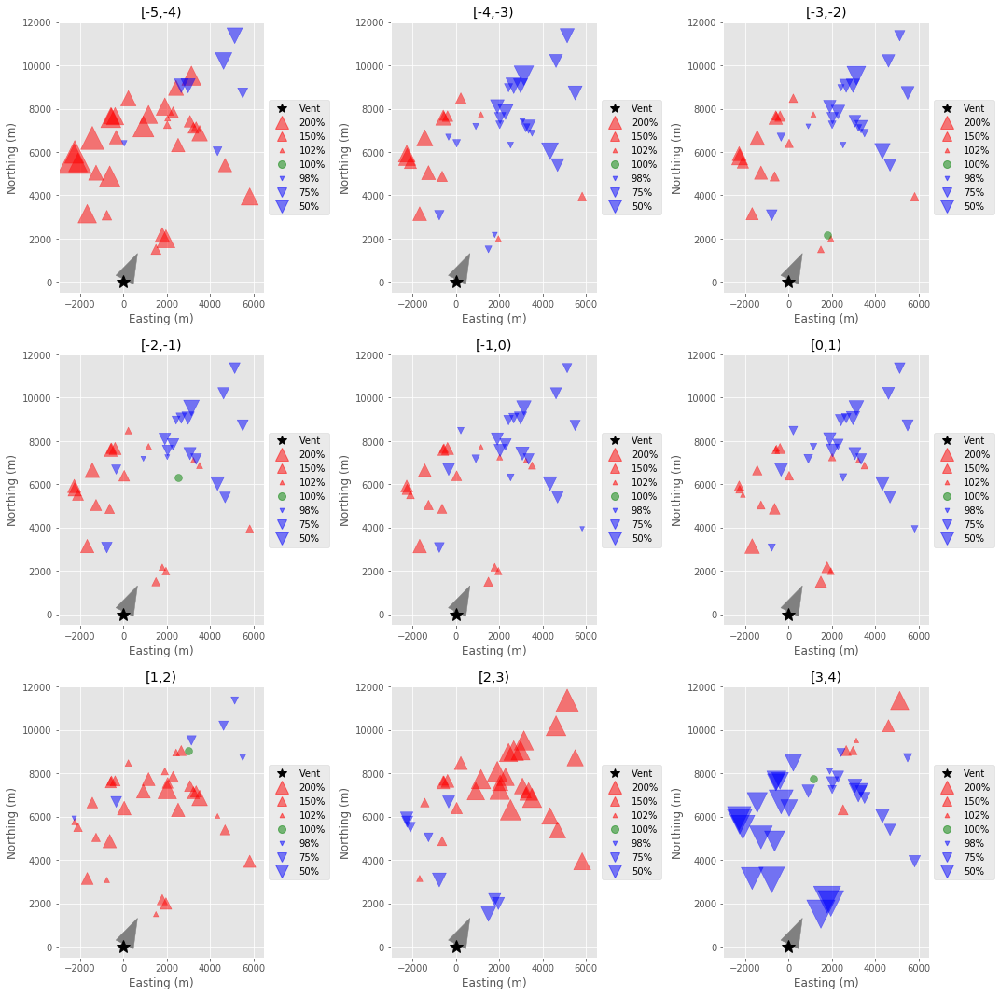

,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


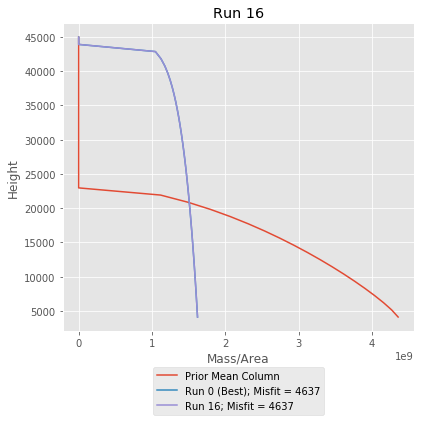

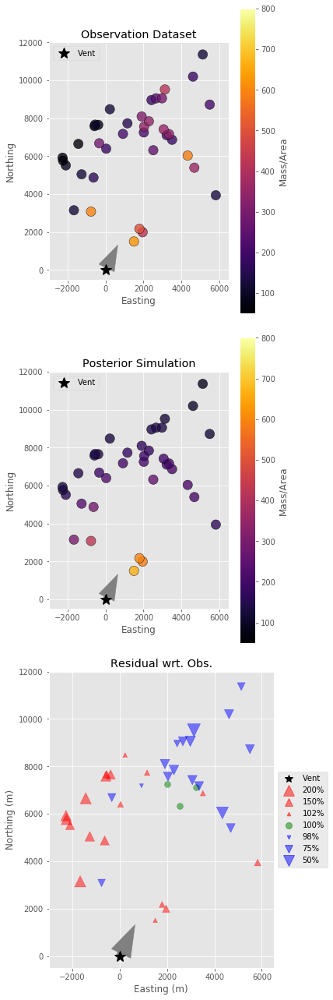

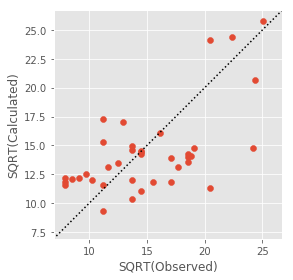

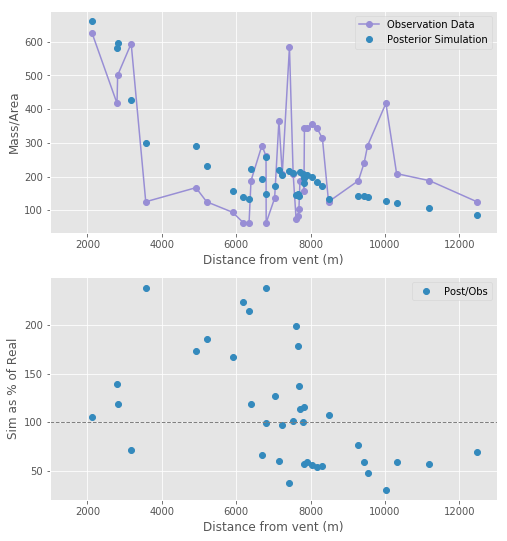

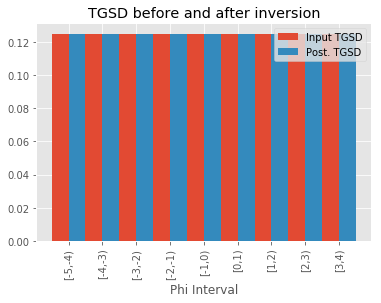

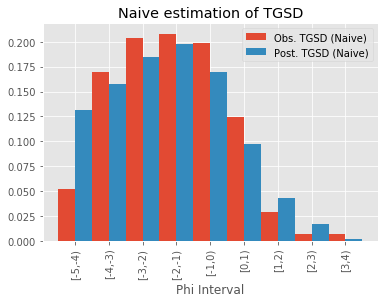

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


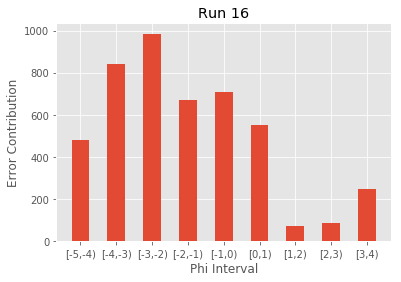

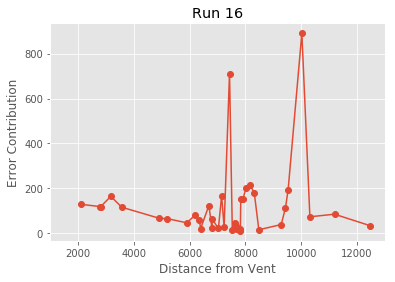

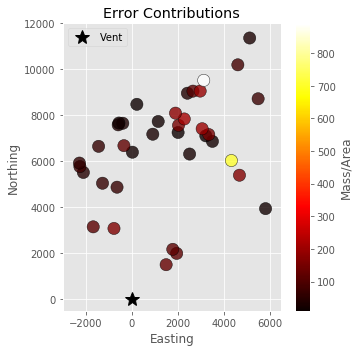

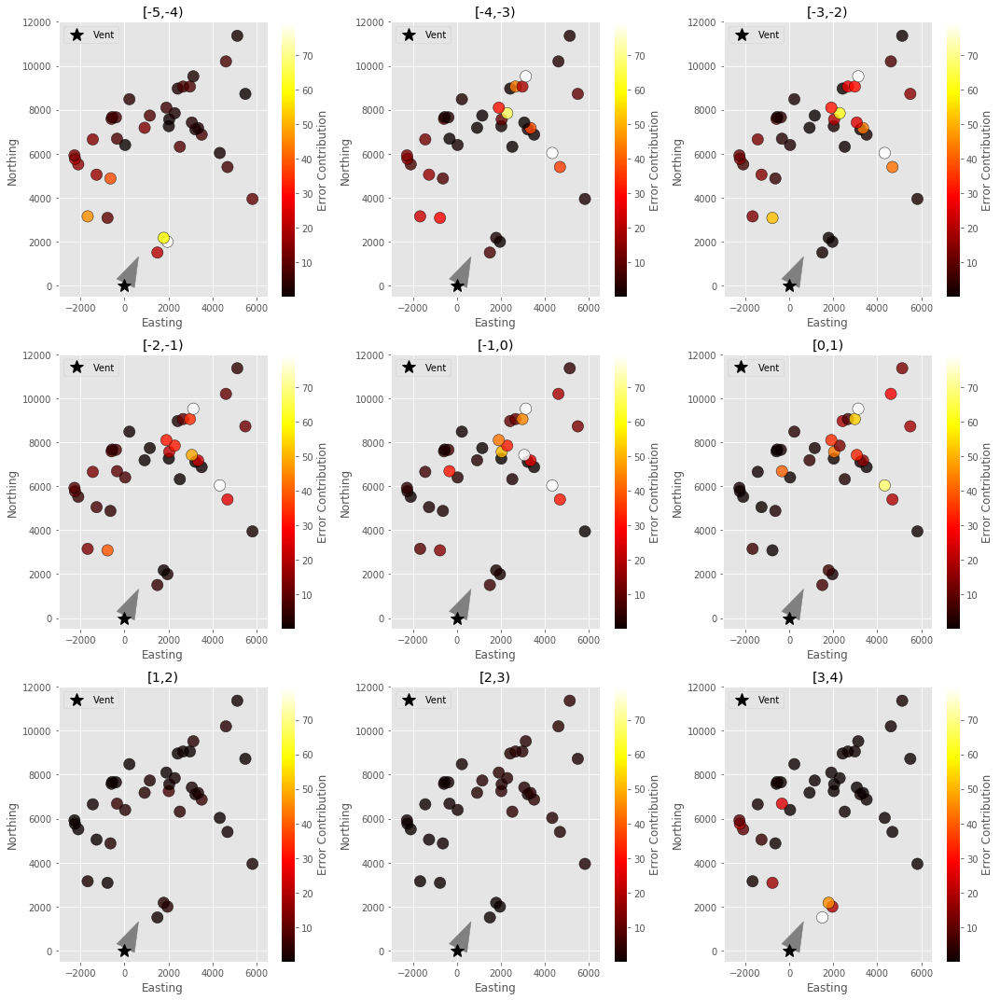

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


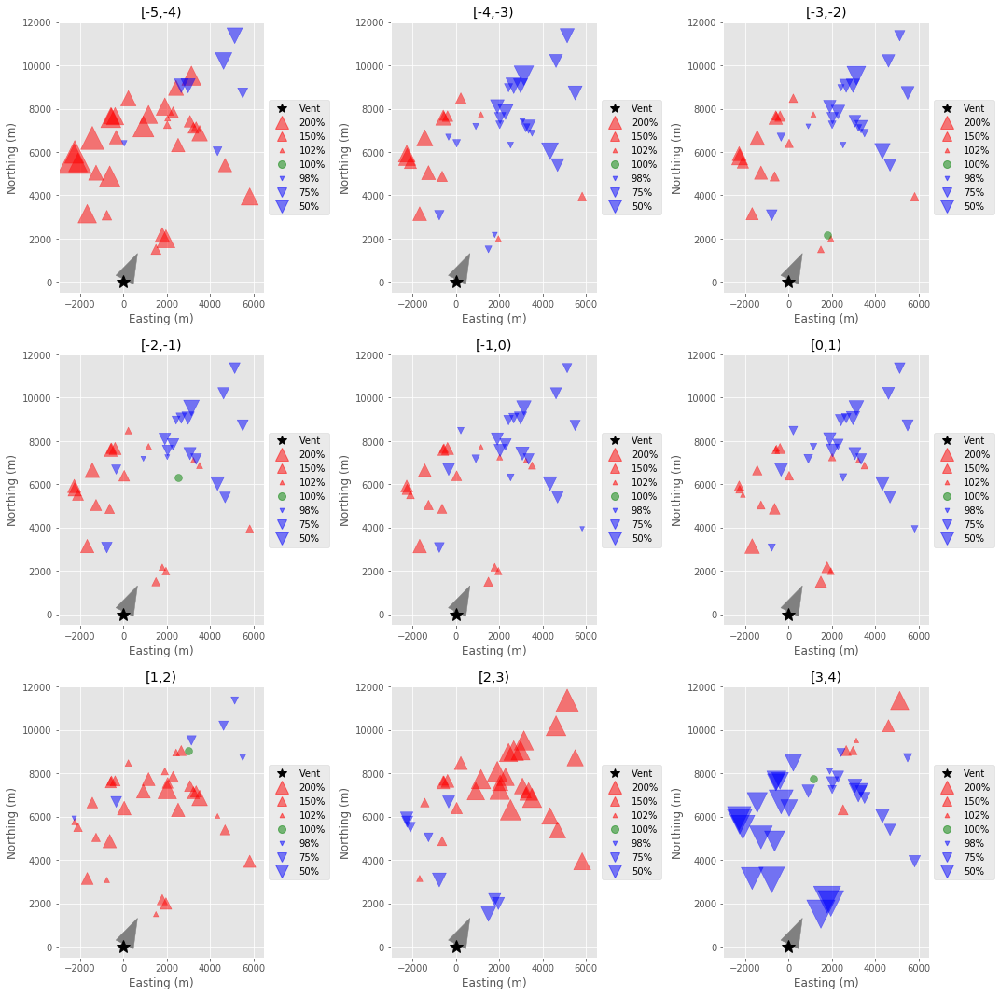

,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


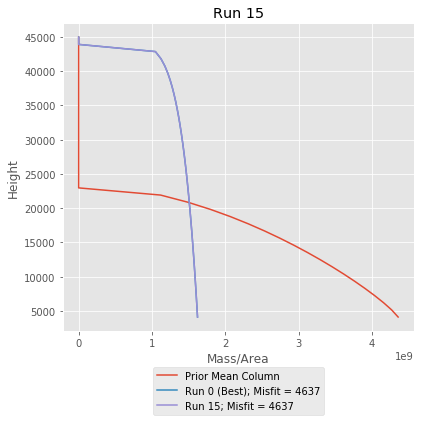

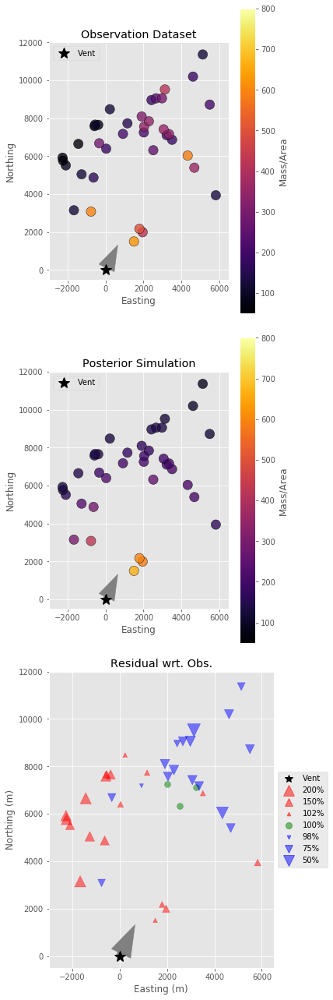

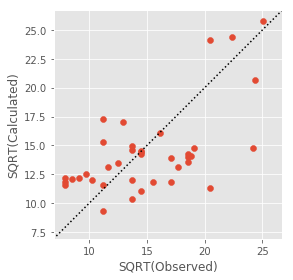

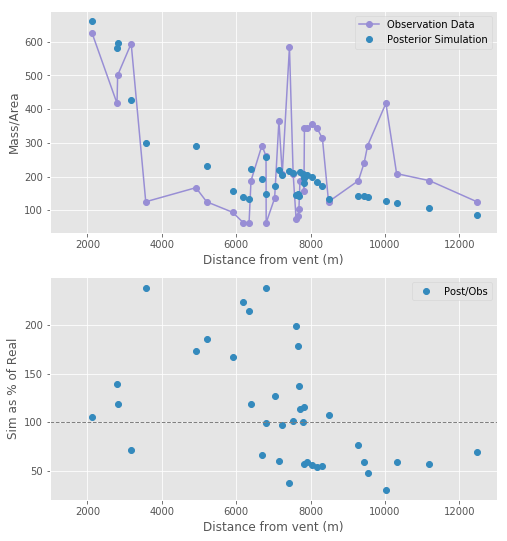

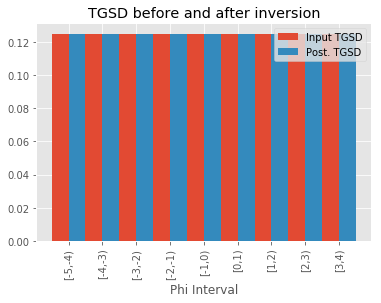

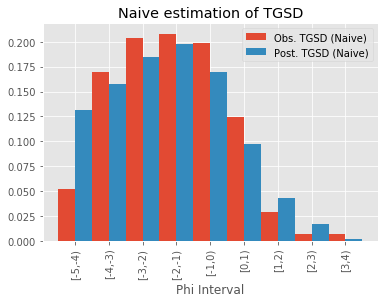

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


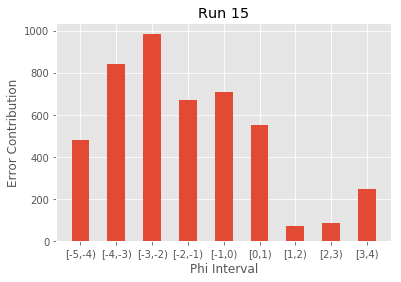

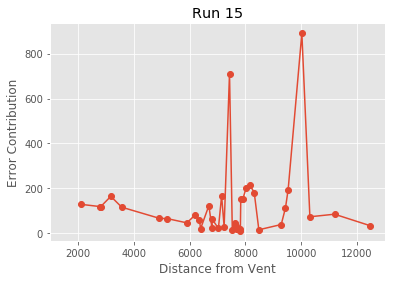

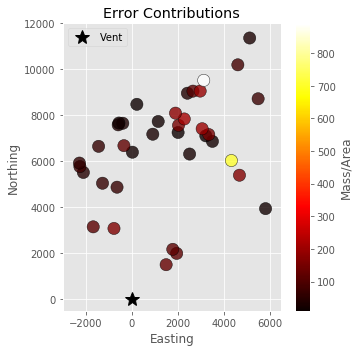

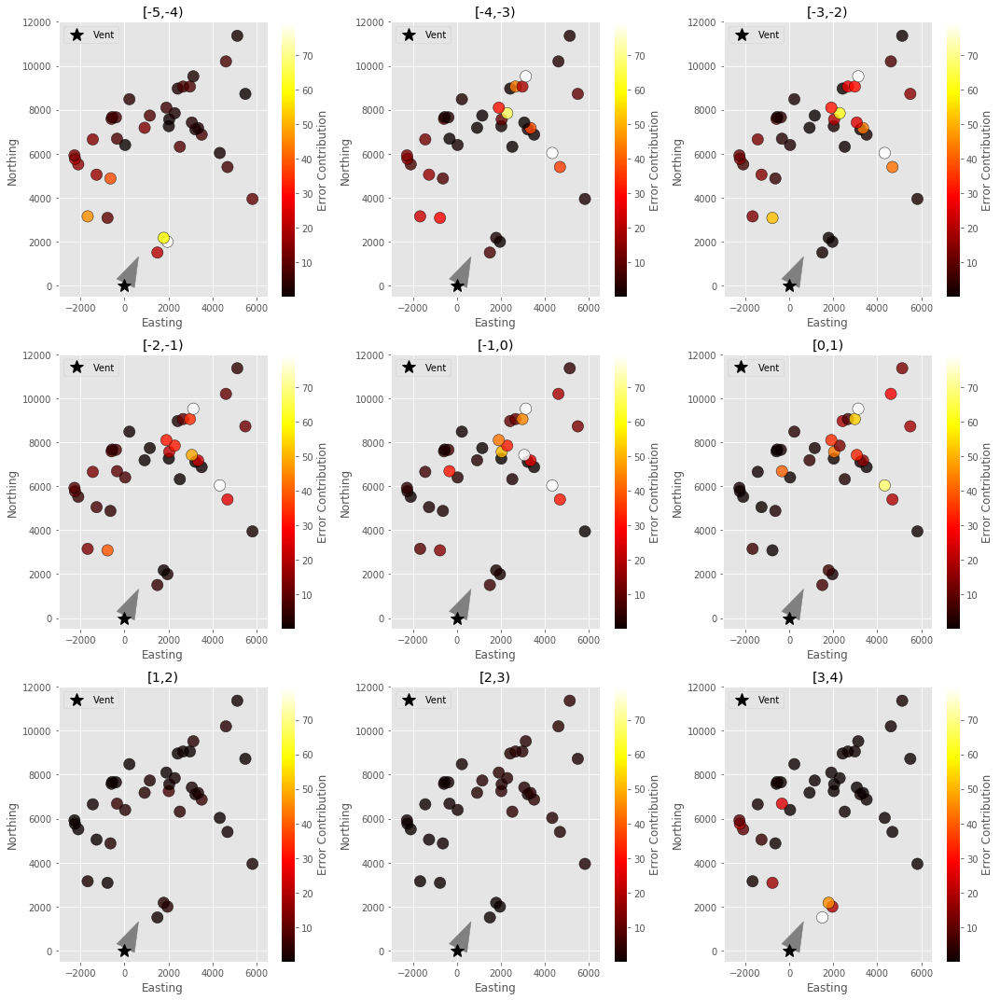

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


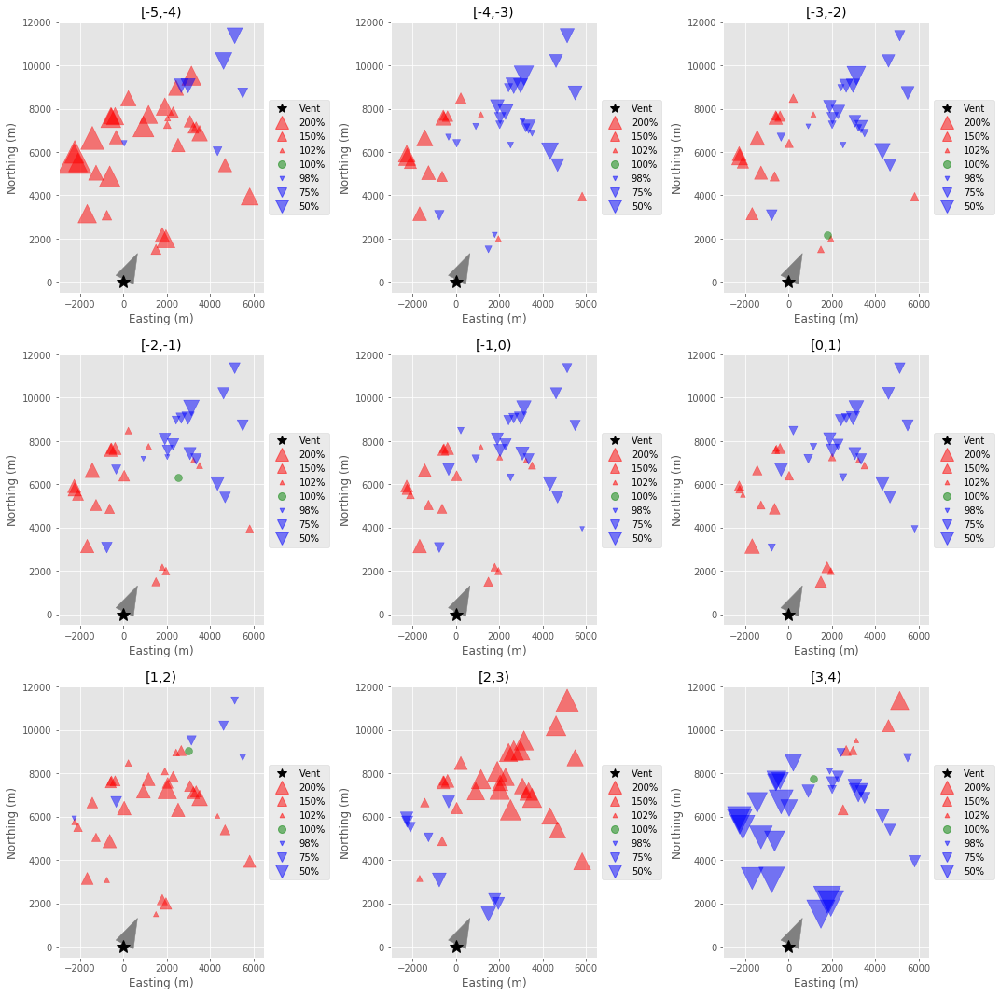

,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


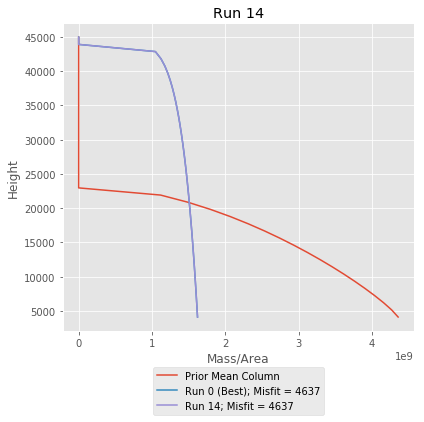

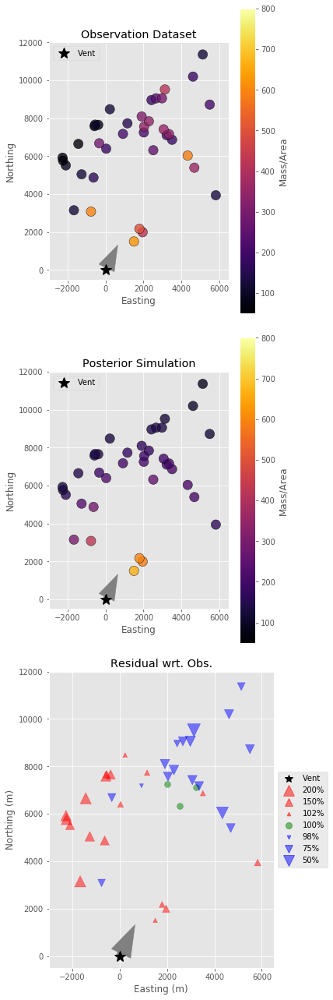

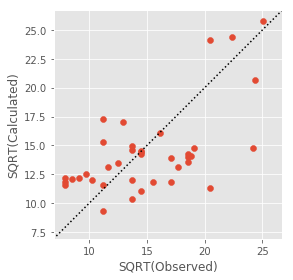

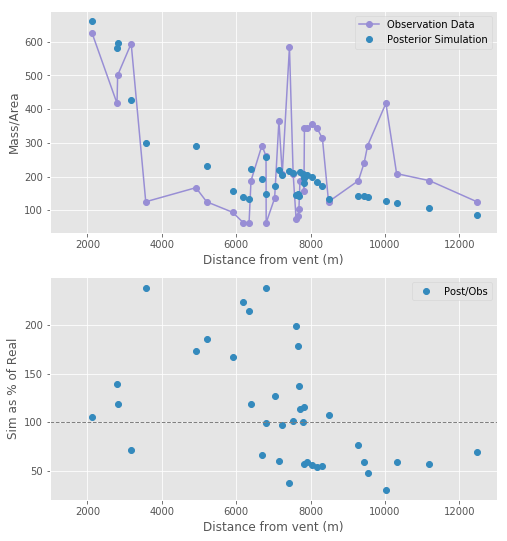

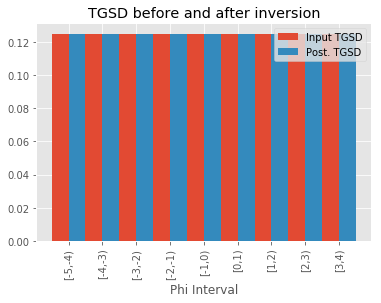

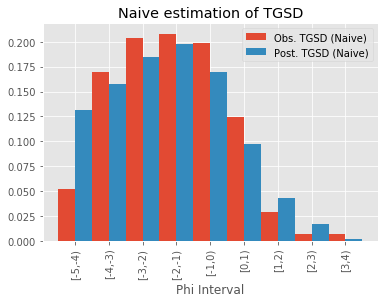

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


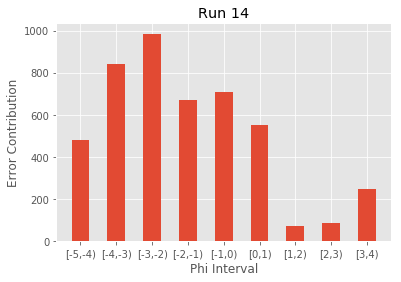

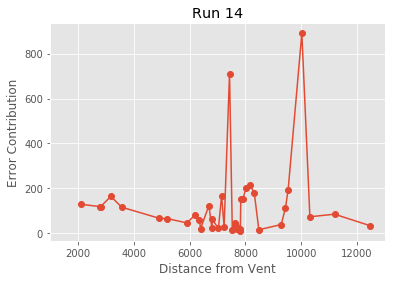

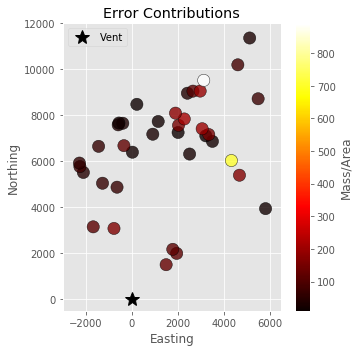

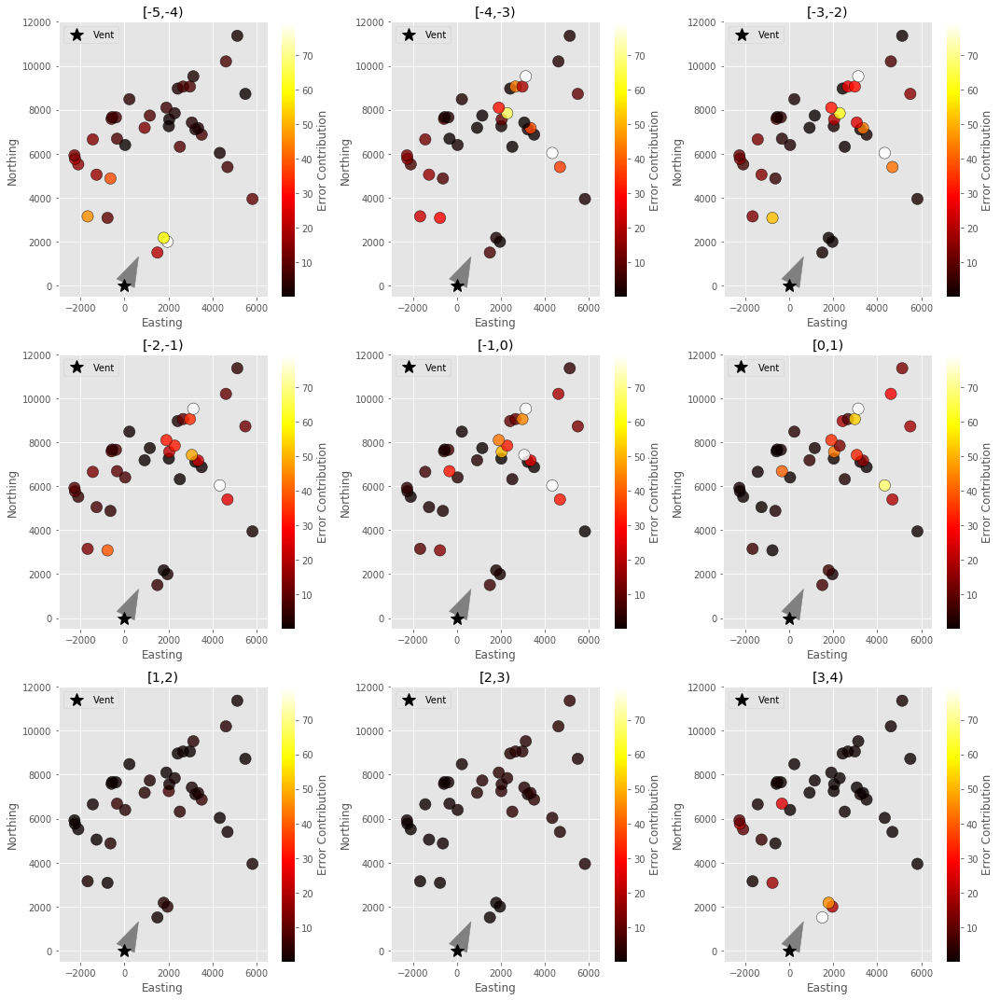

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


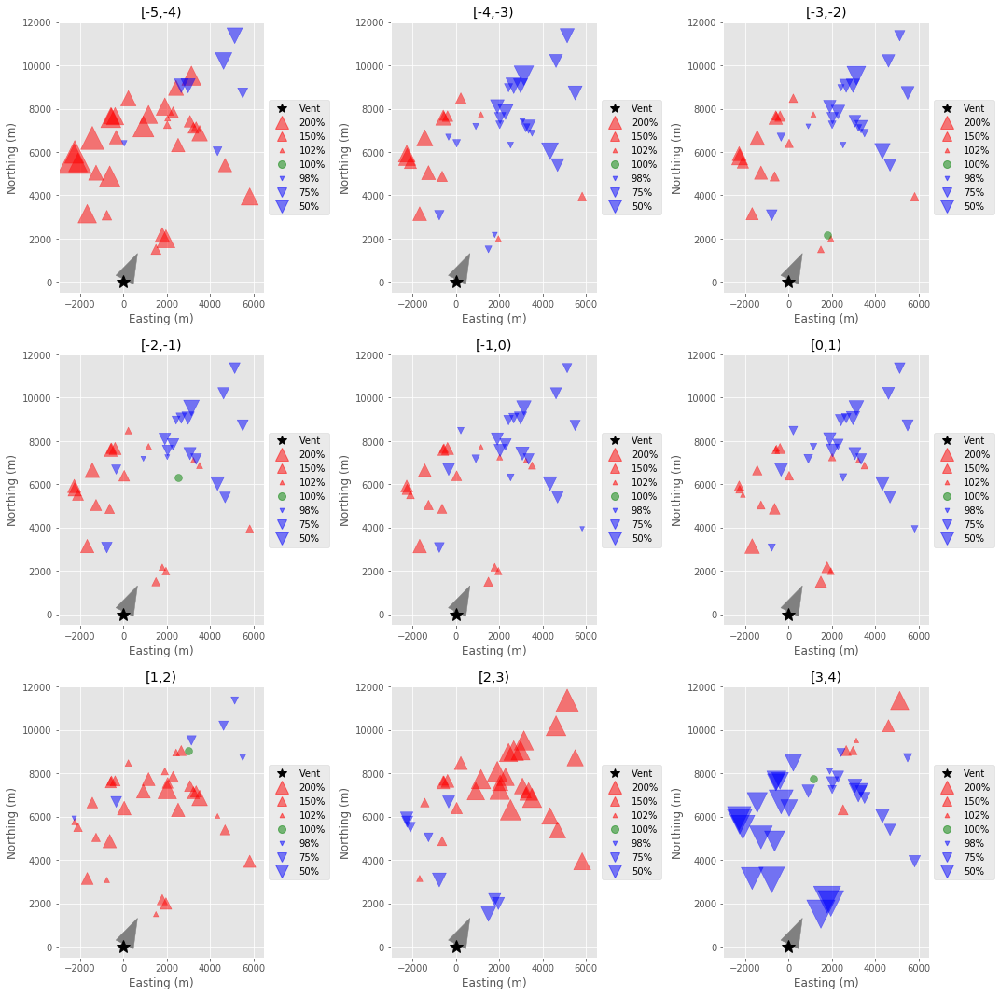

,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


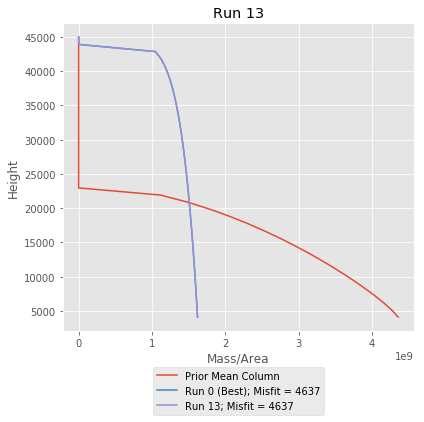

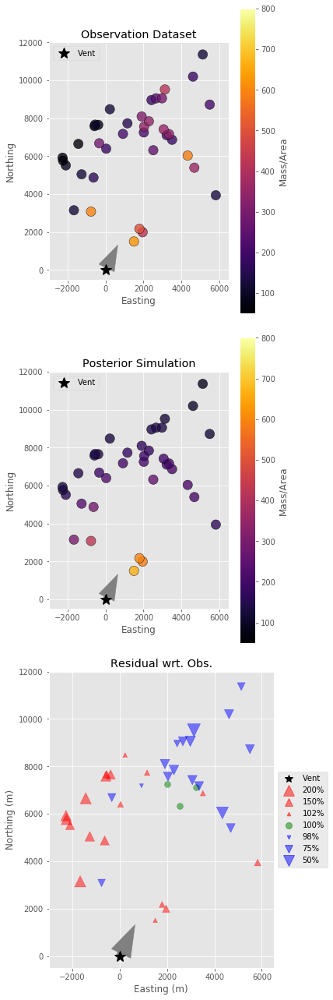

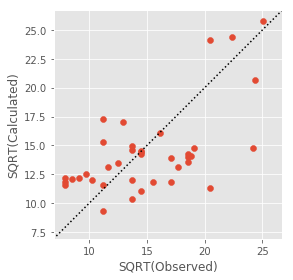

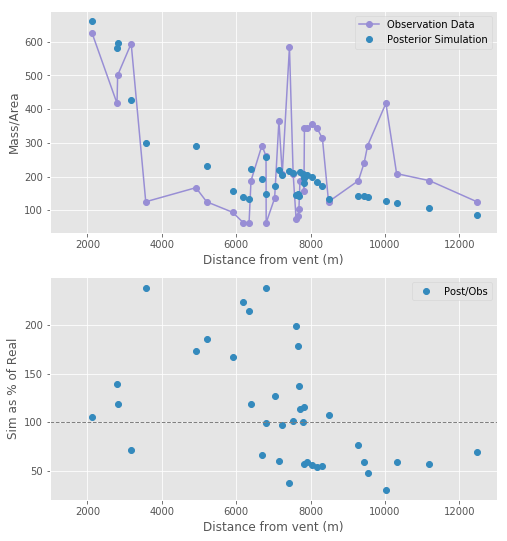

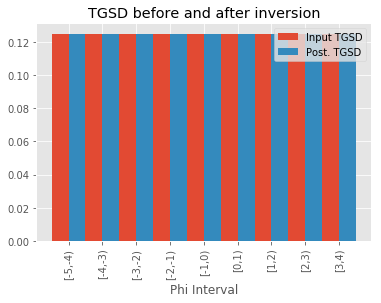

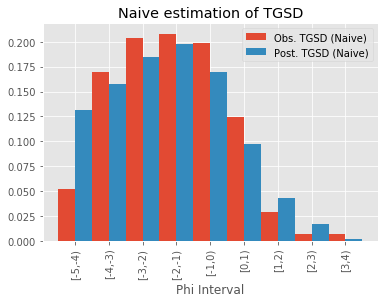

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


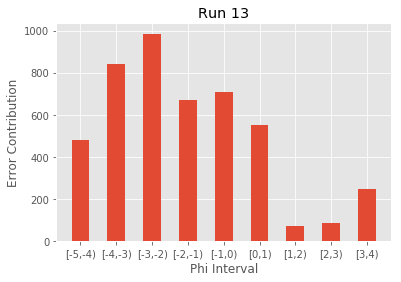

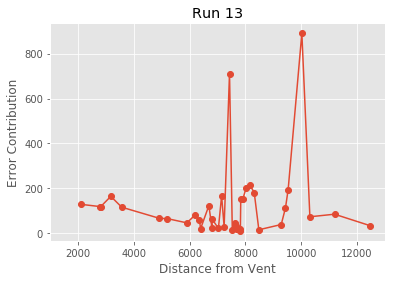

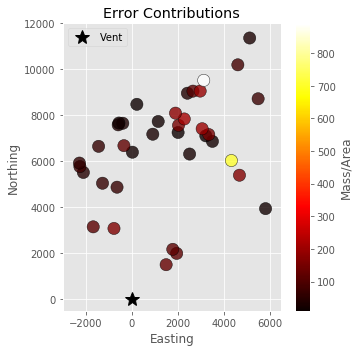

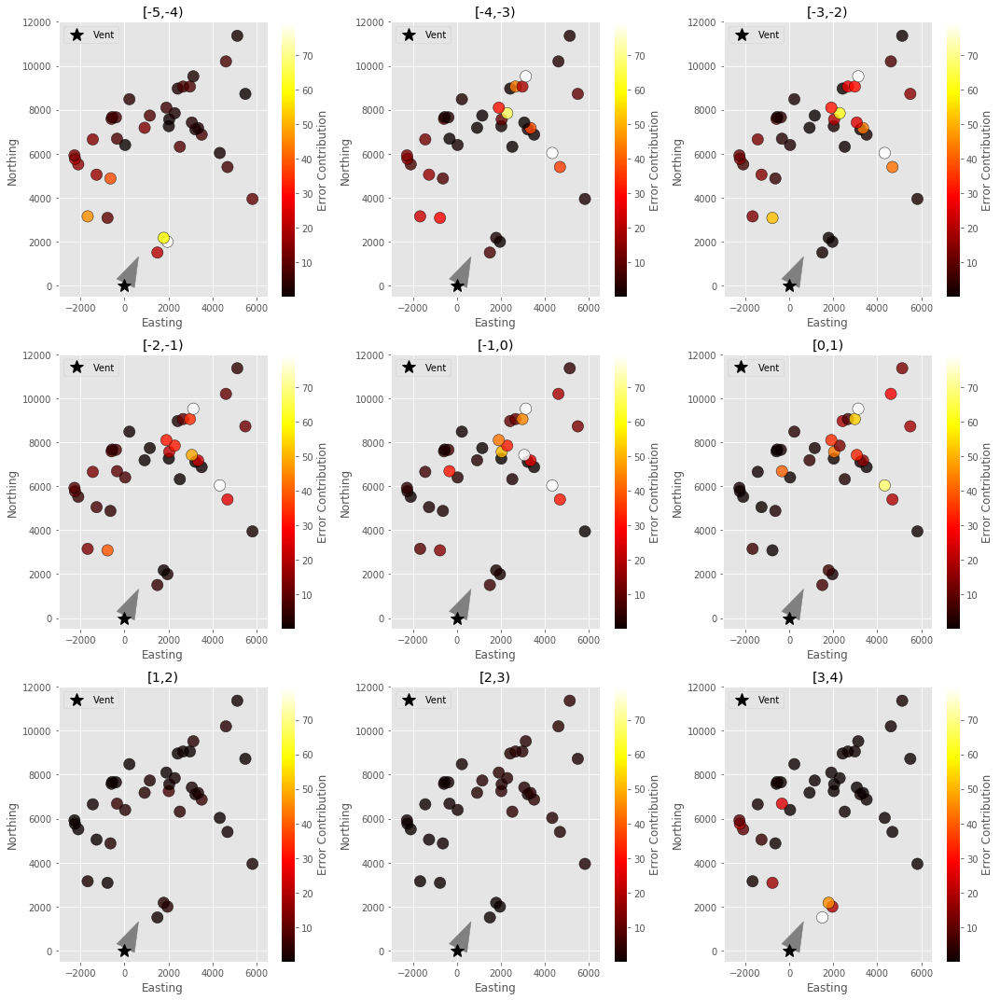

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


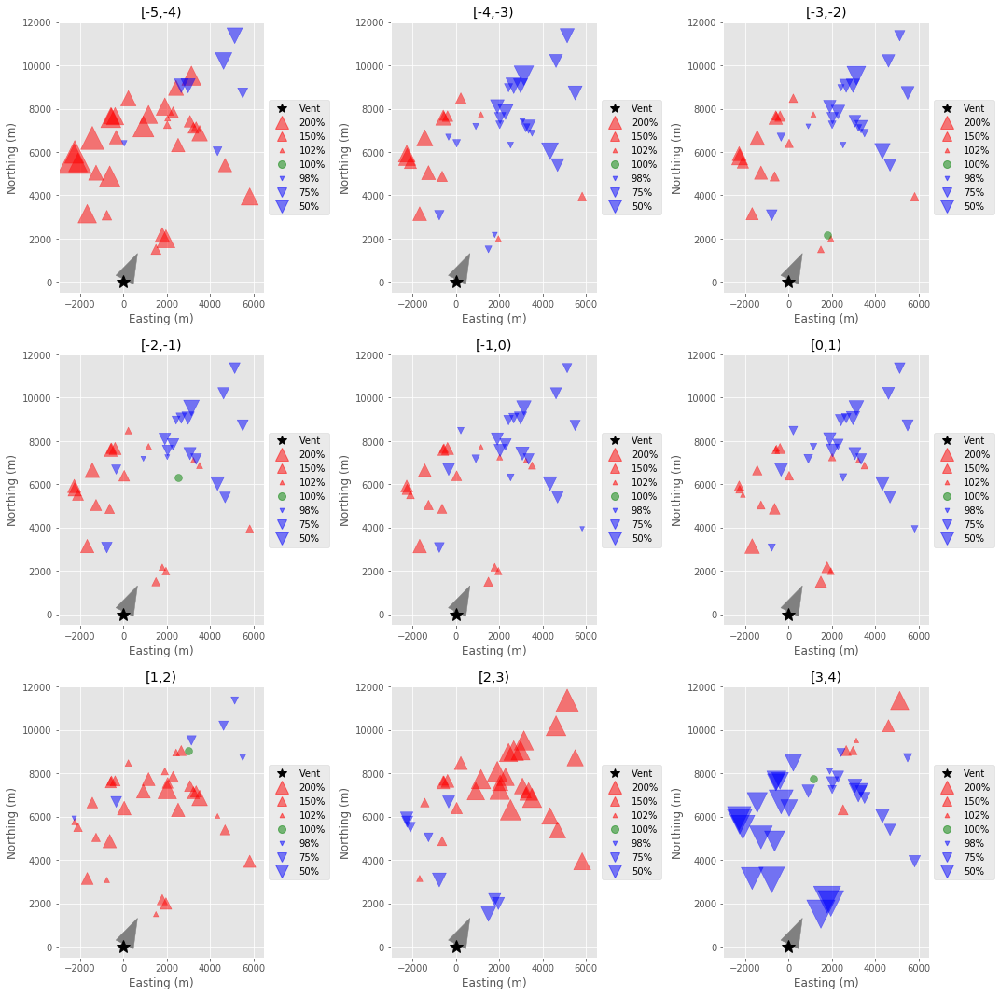

,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


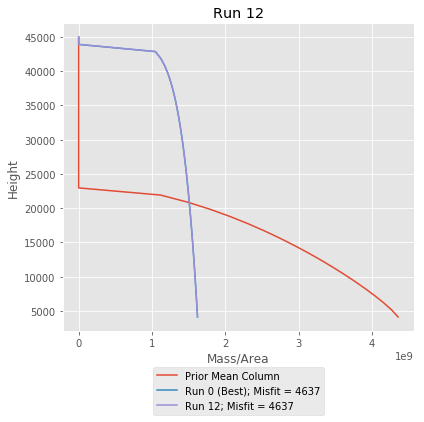

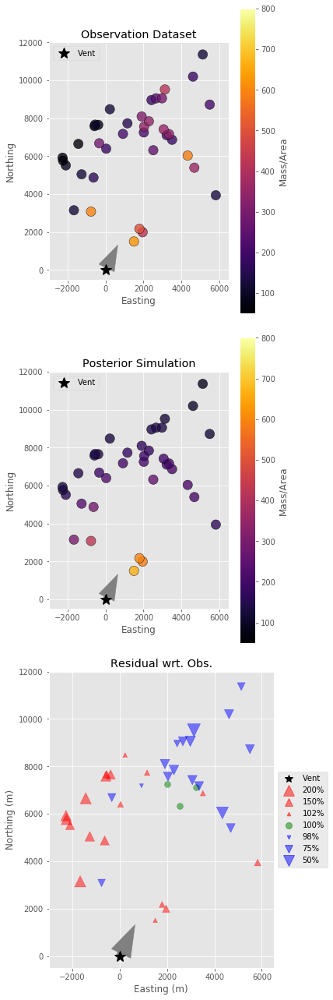

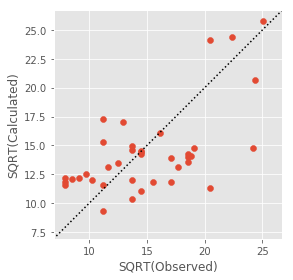

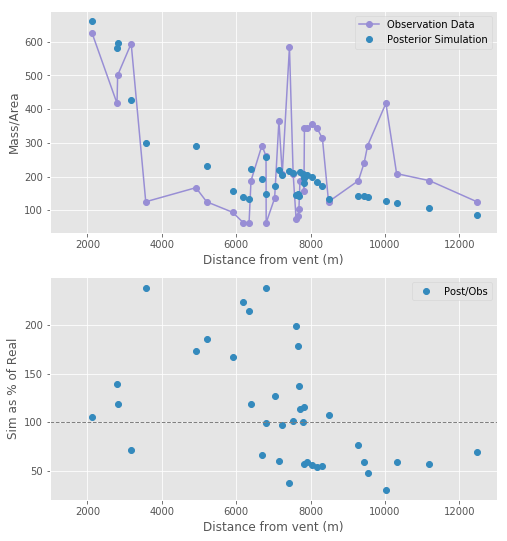

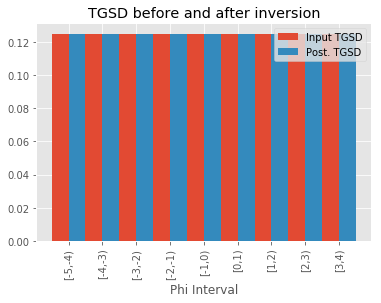

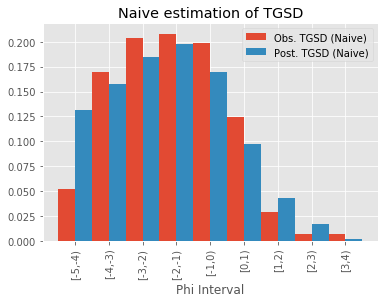

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


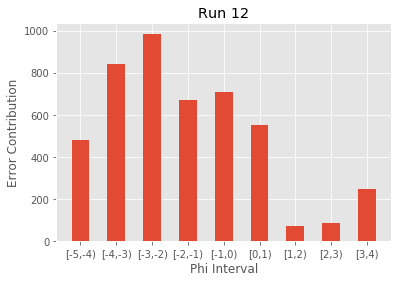

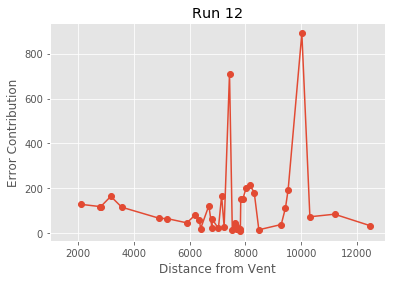

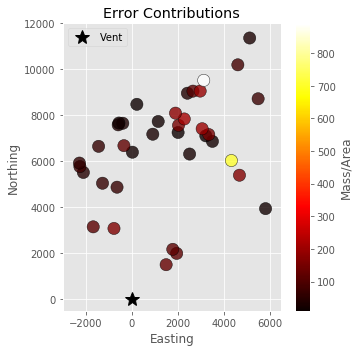

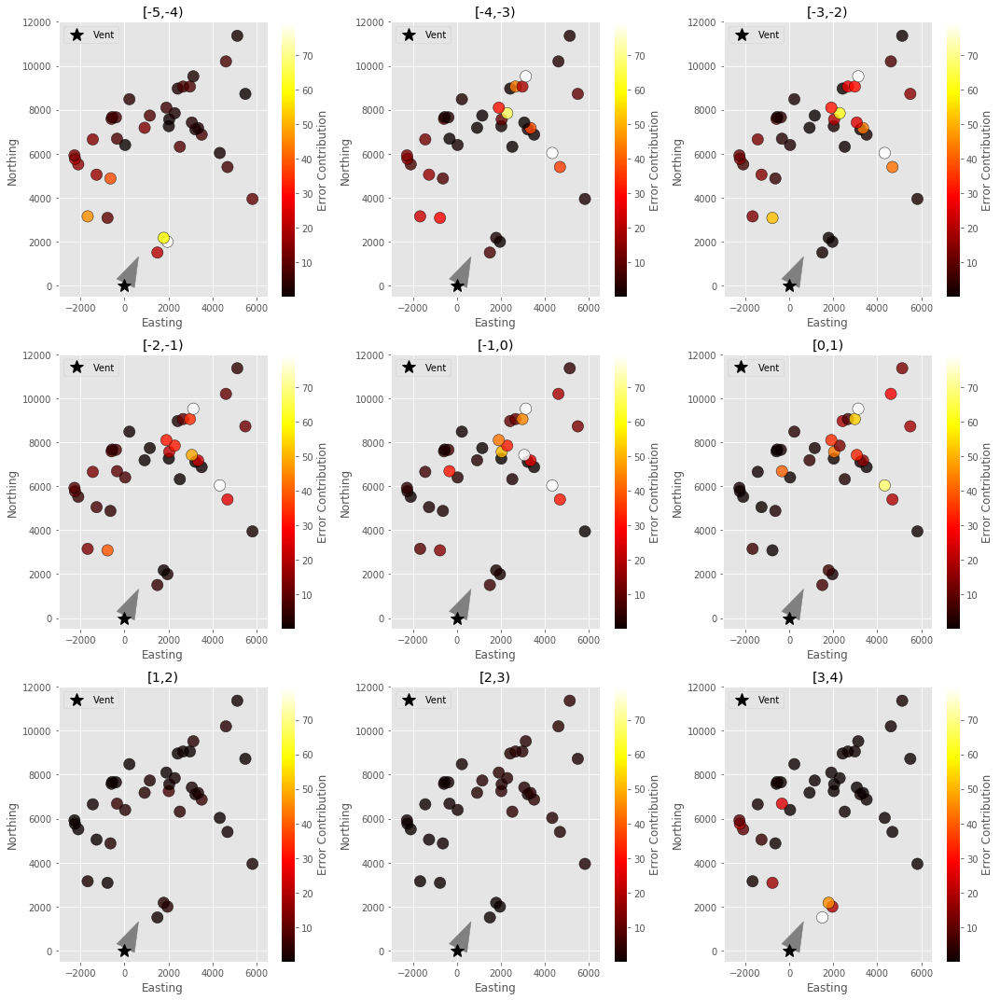

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


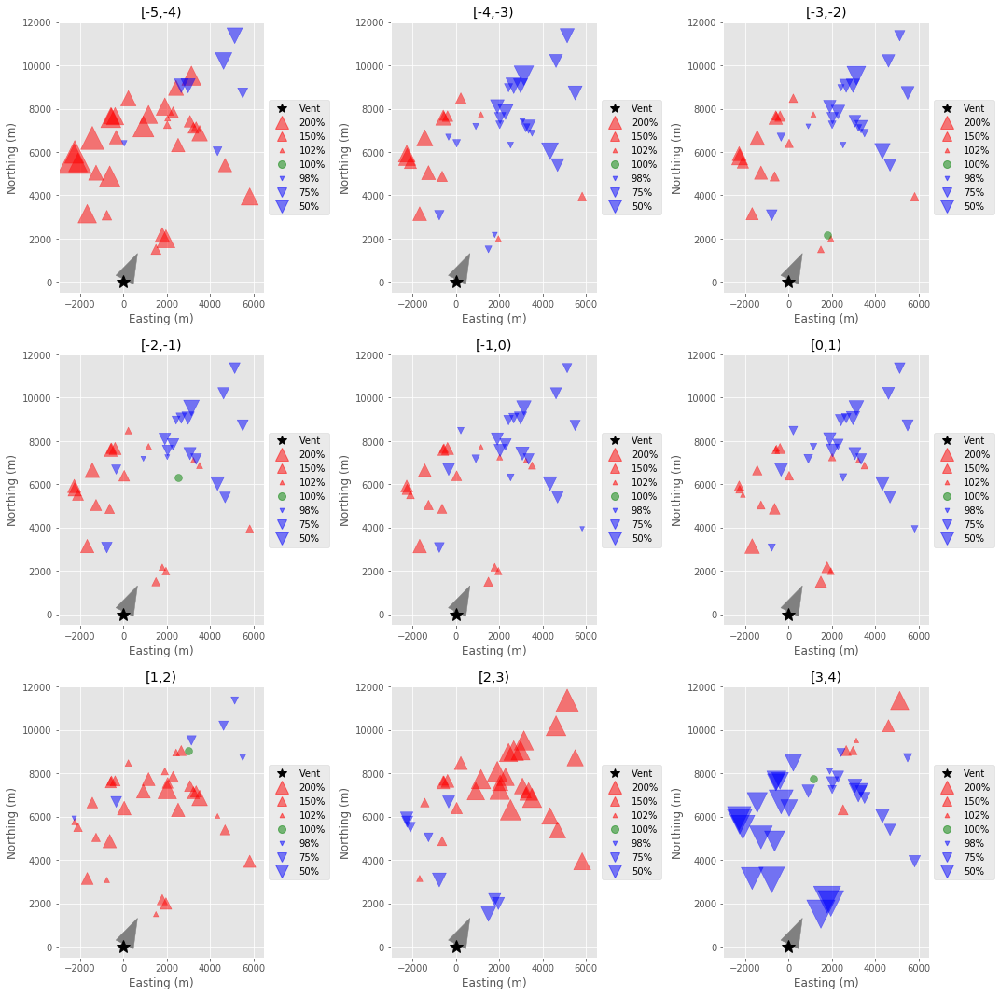

,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


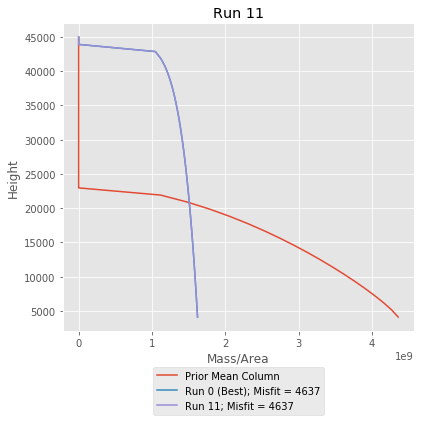

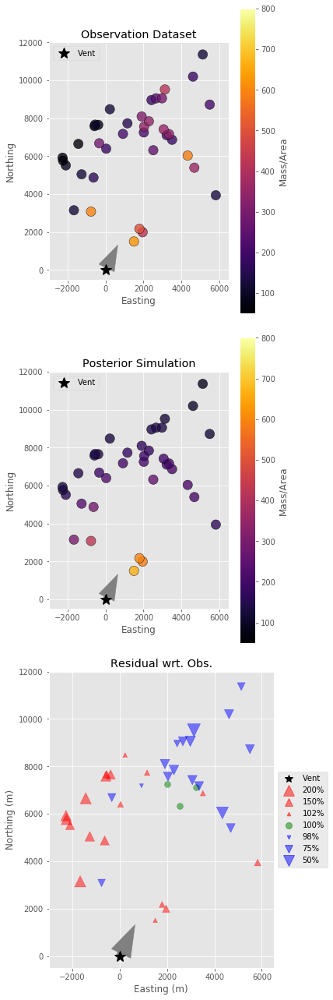

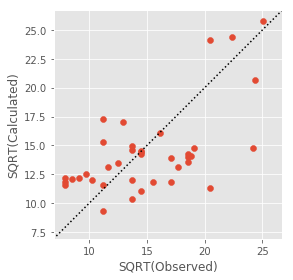

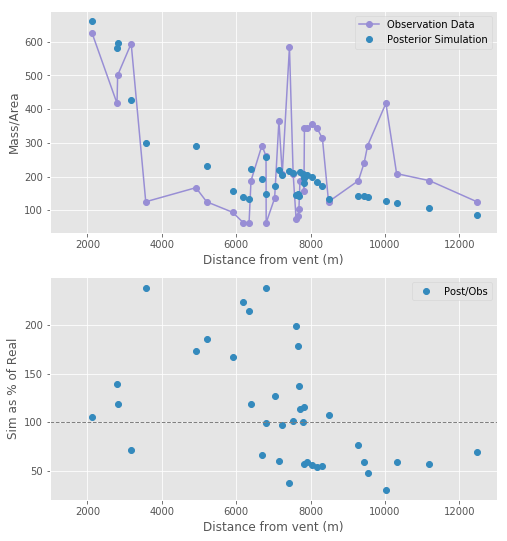

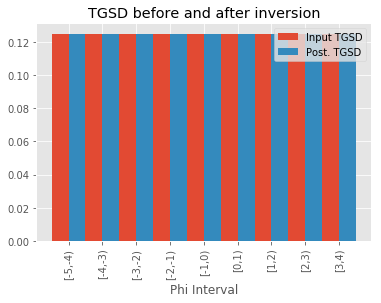

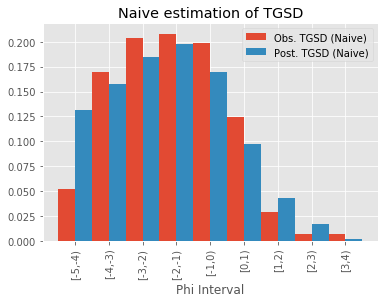

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


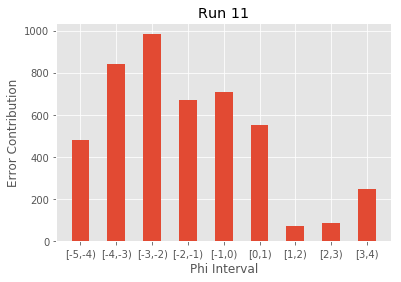

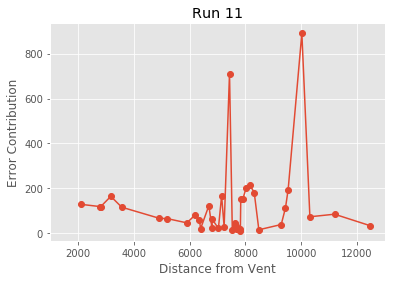

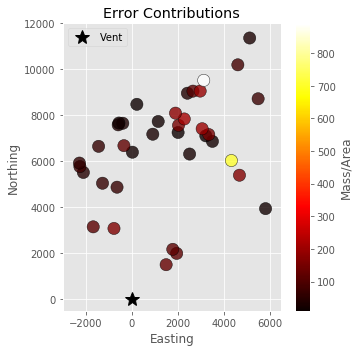

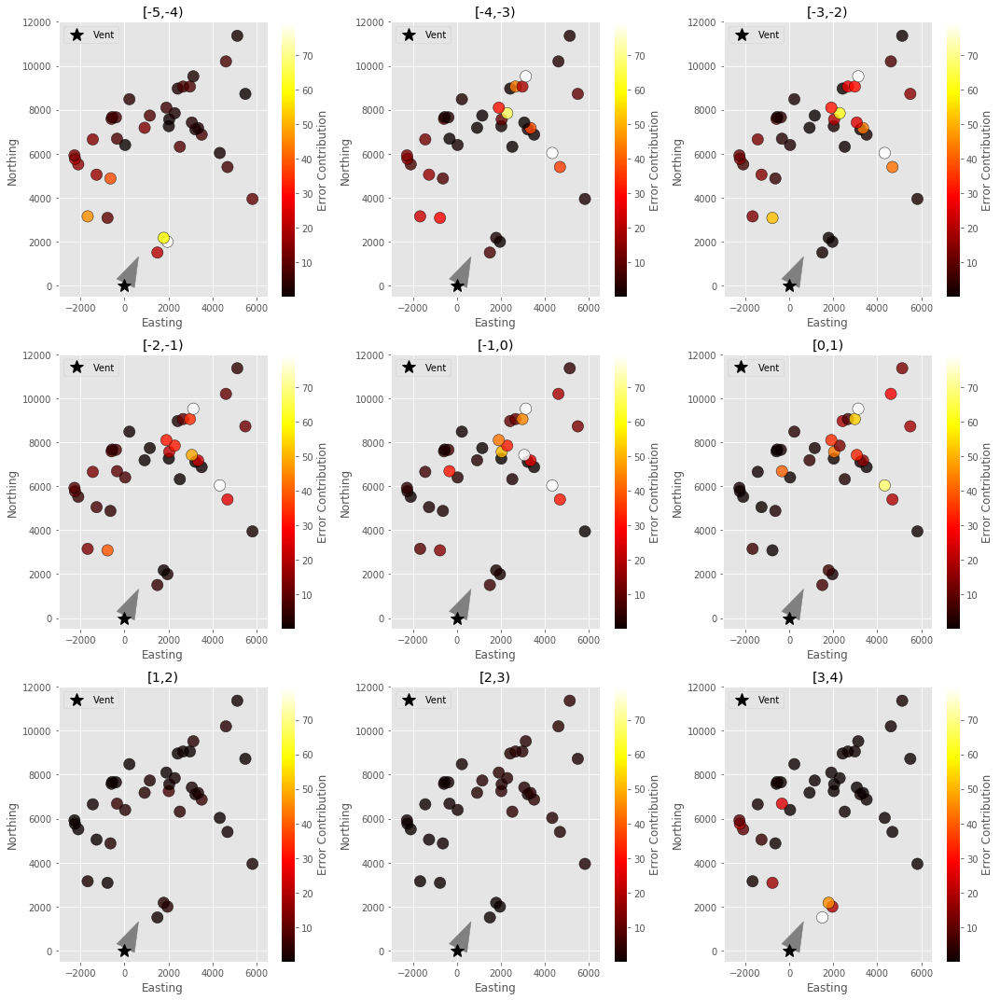

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


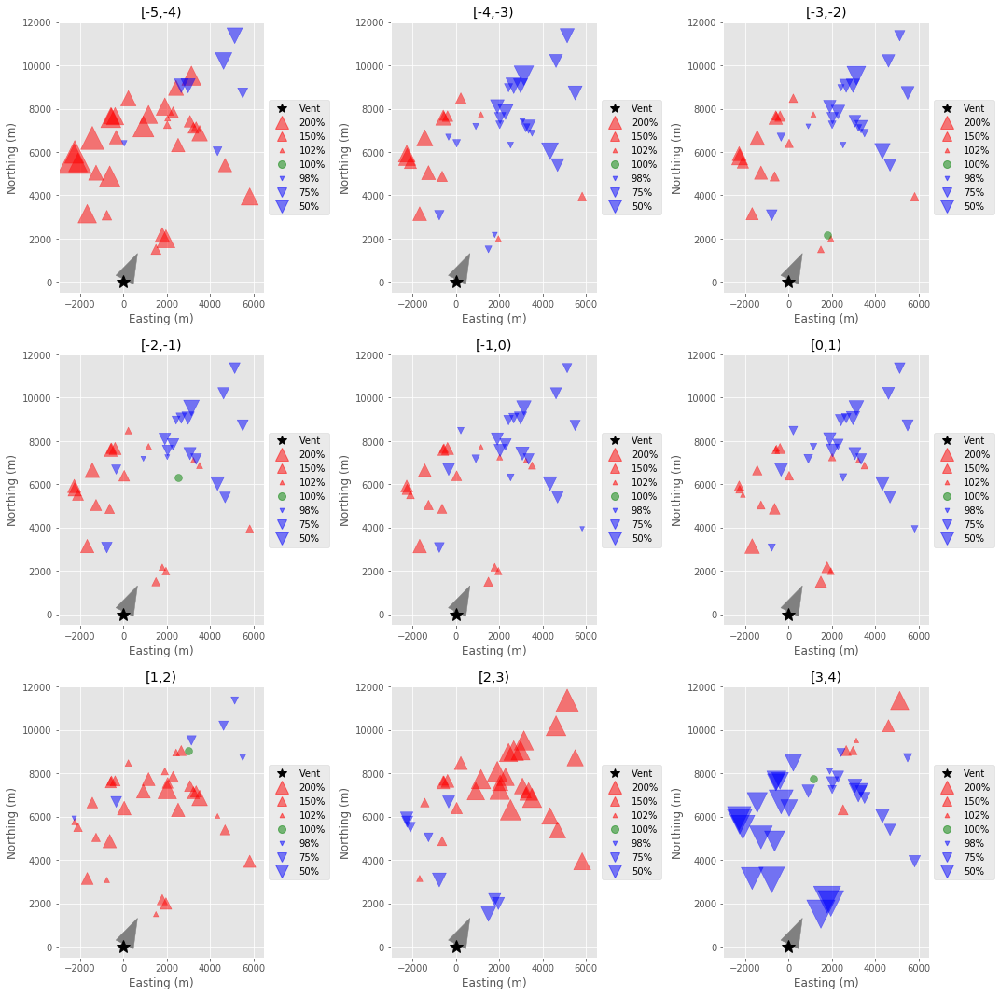

,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


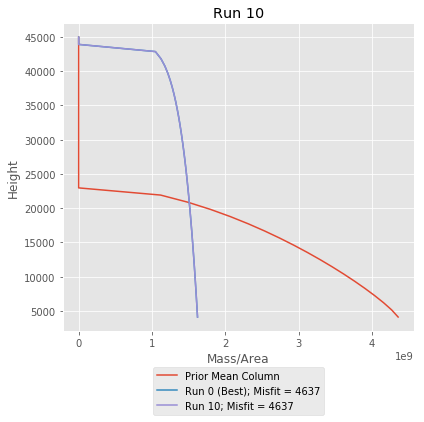

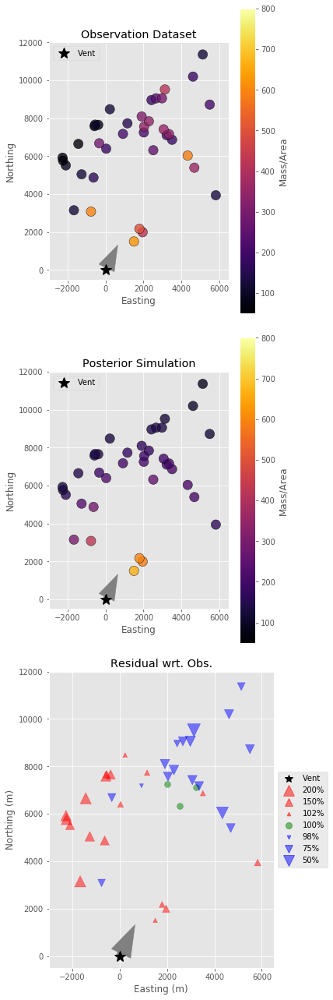

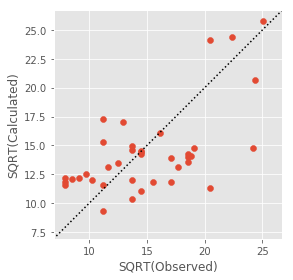

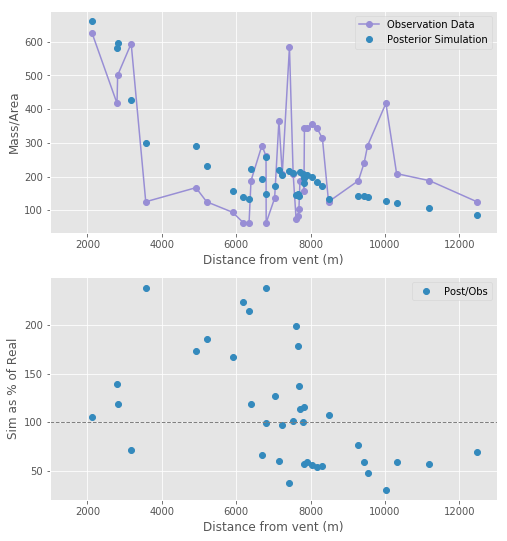

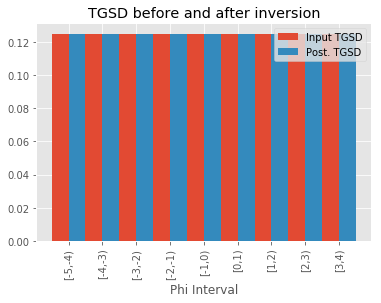

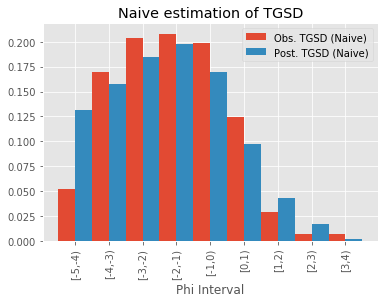

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


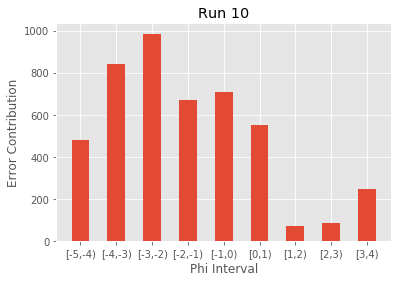

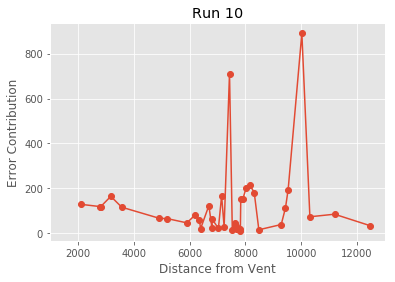

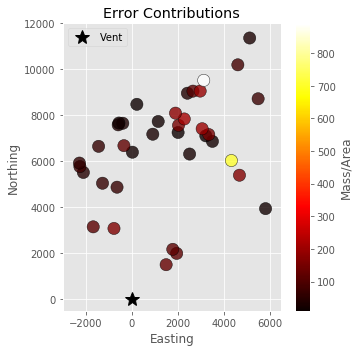

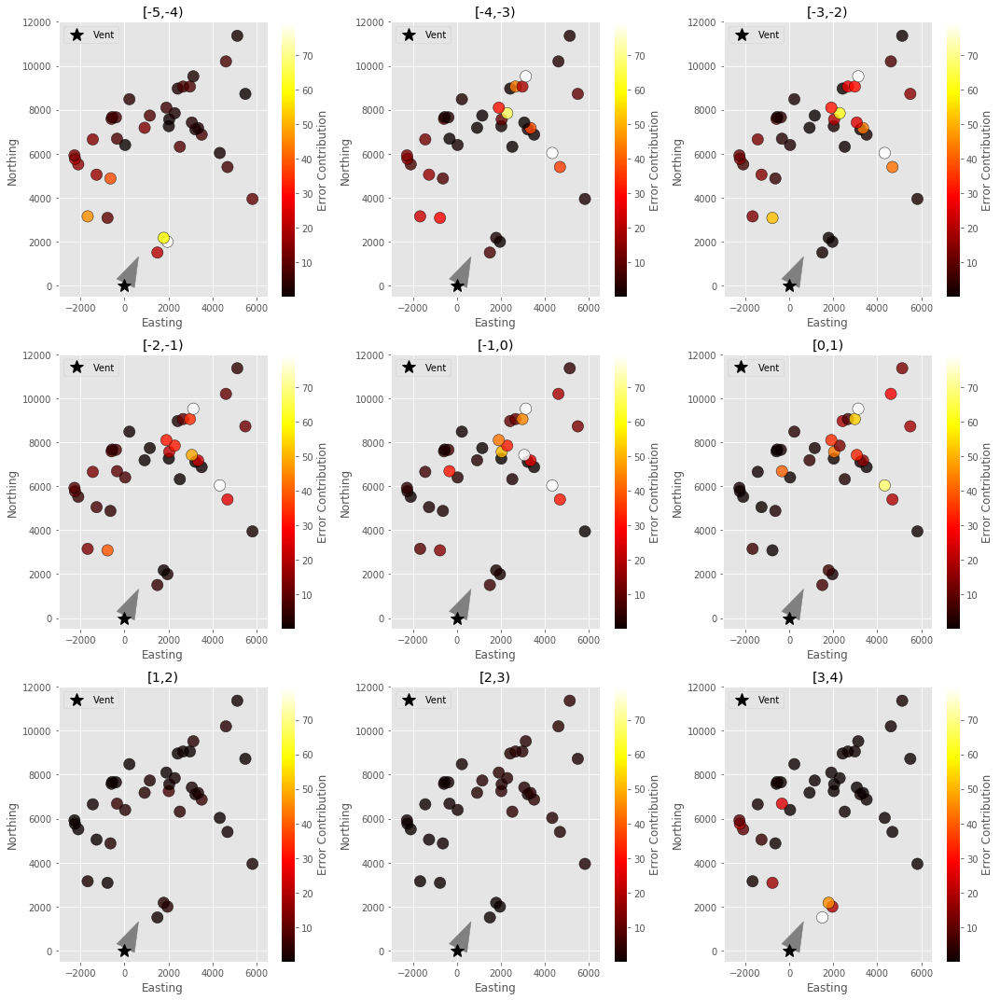

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


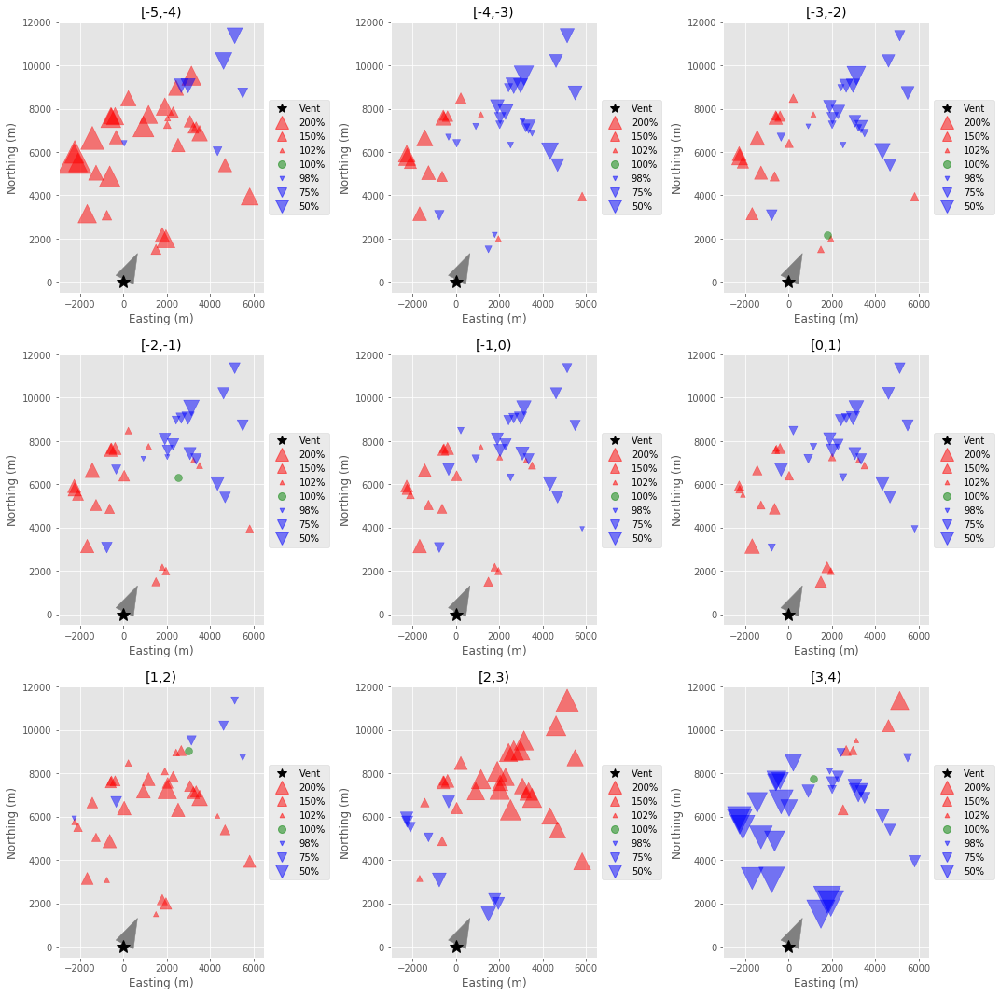

,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


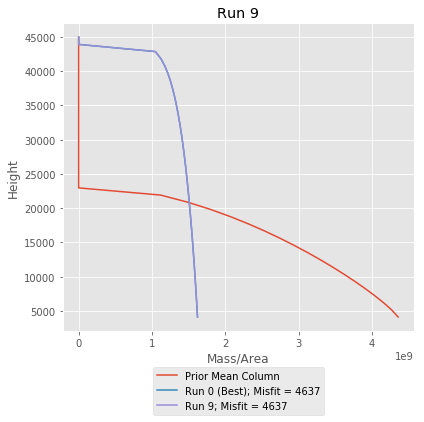

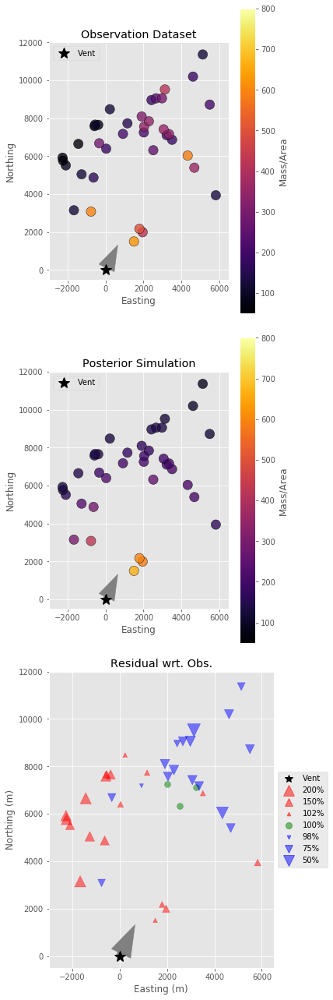

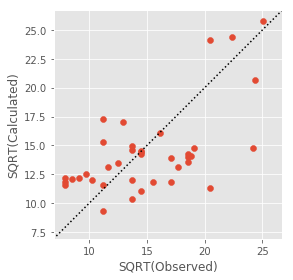

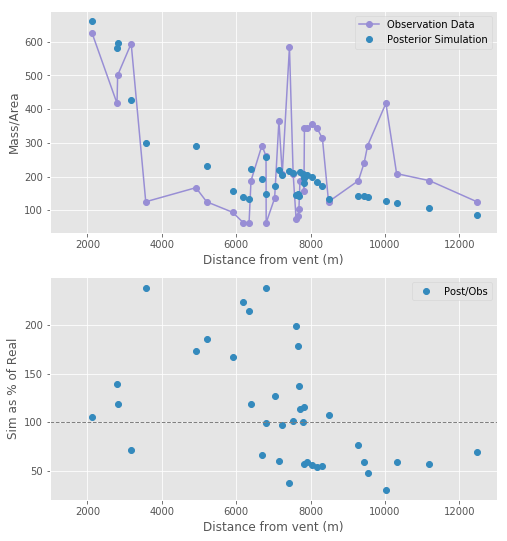

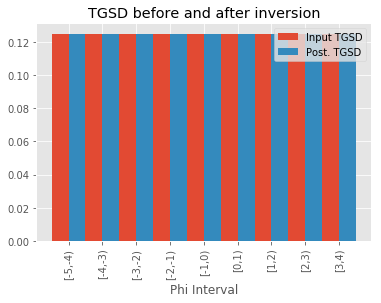

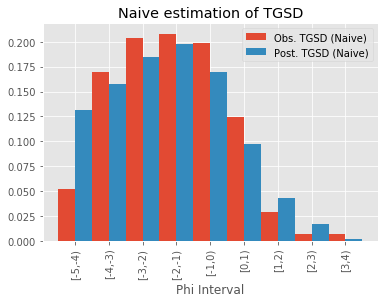

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


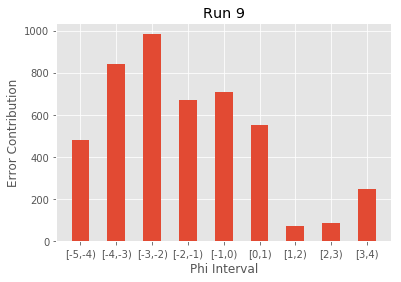

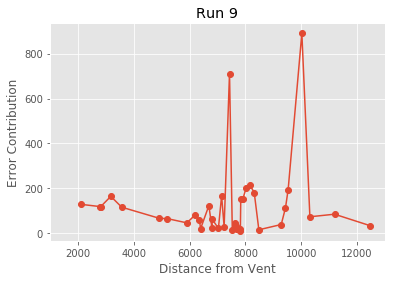

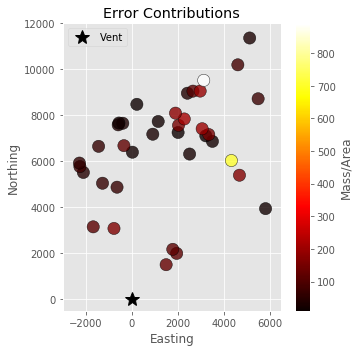

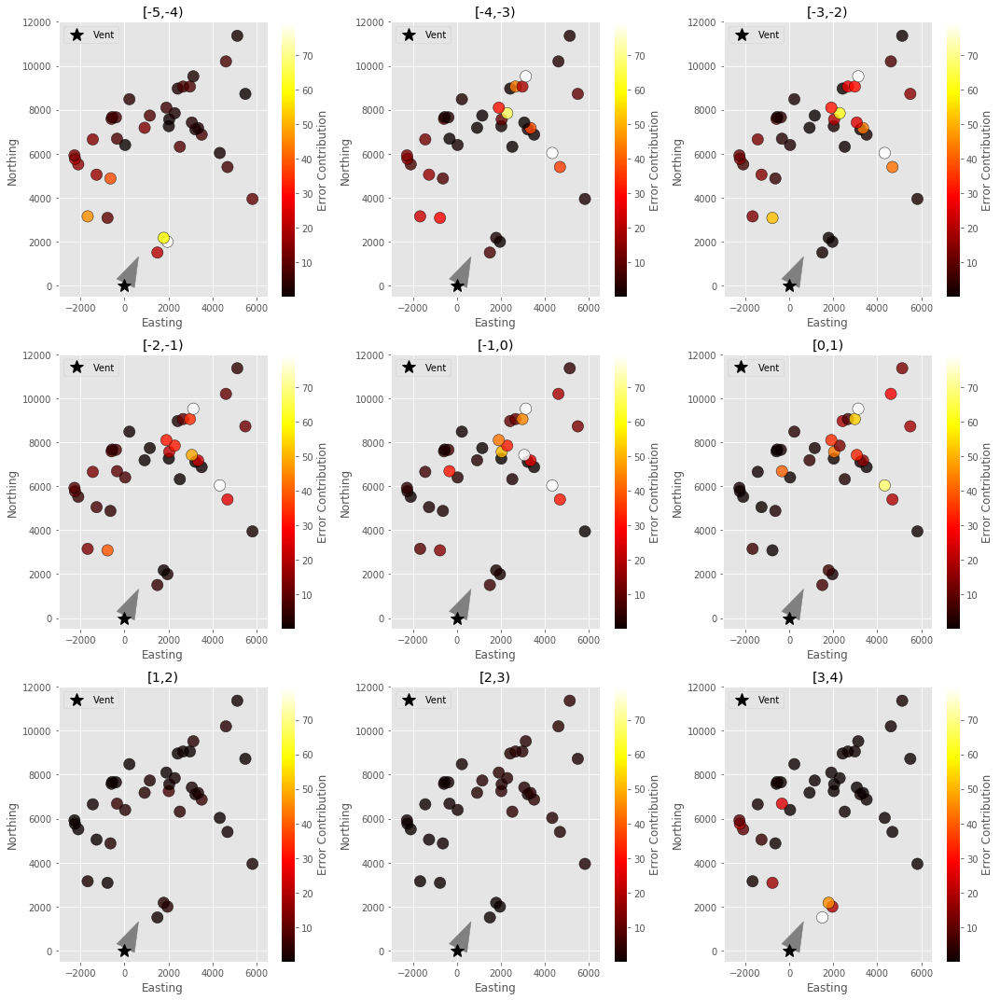

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


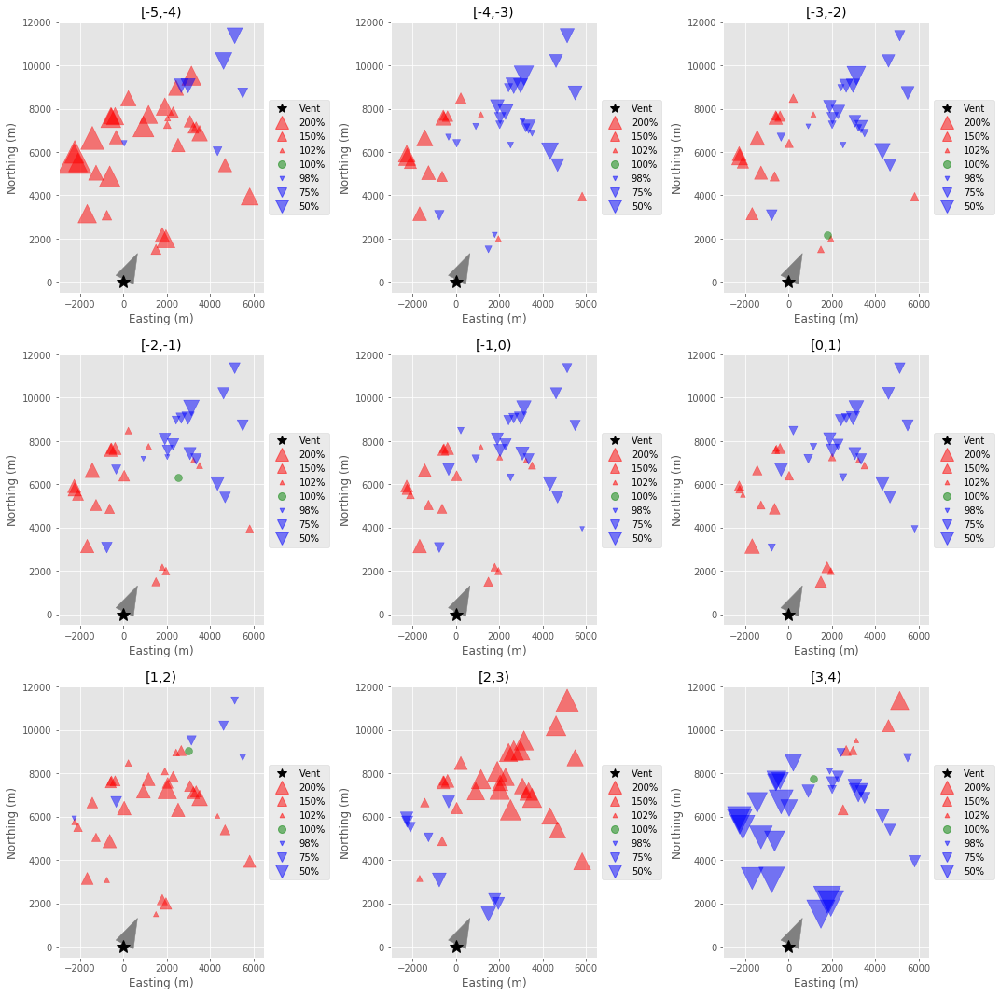

,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


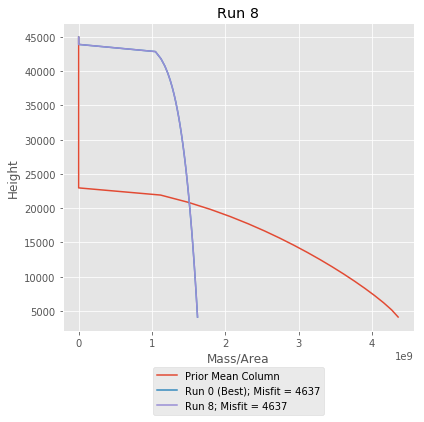

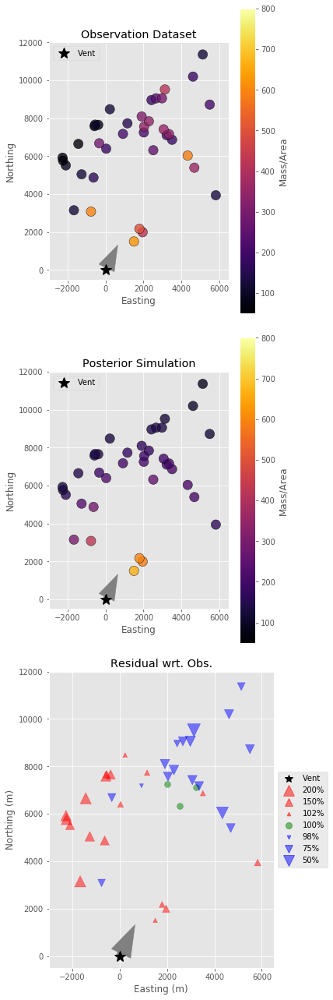

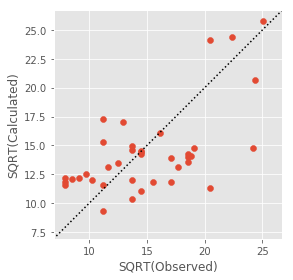

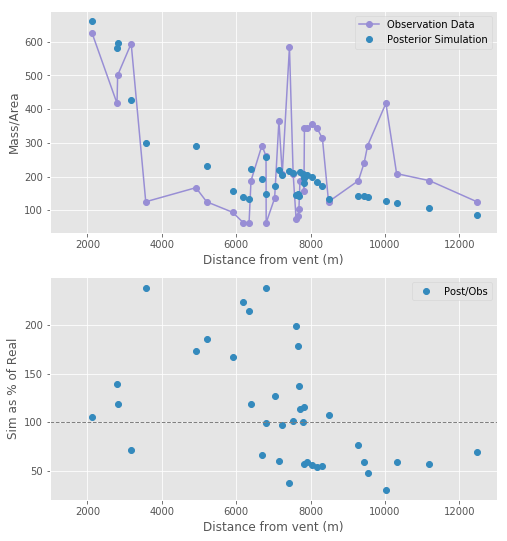

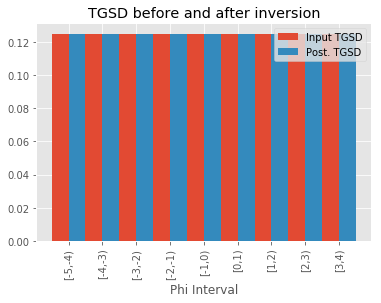

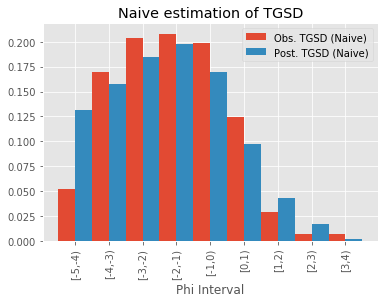

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


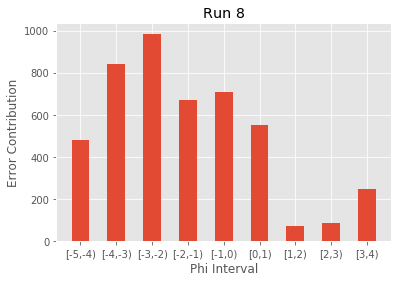

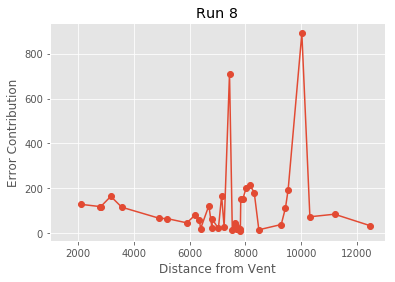

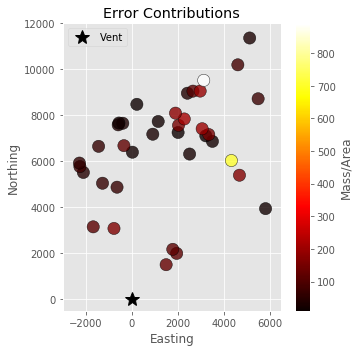

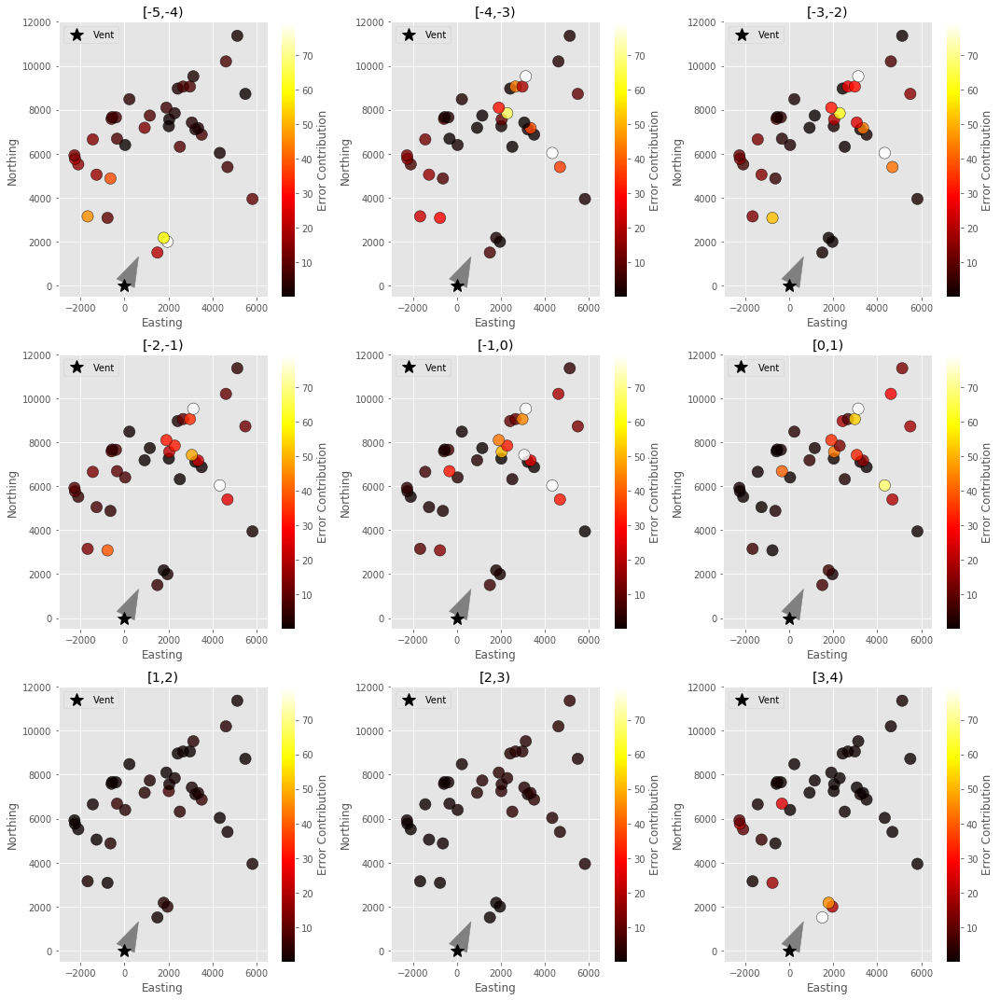

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


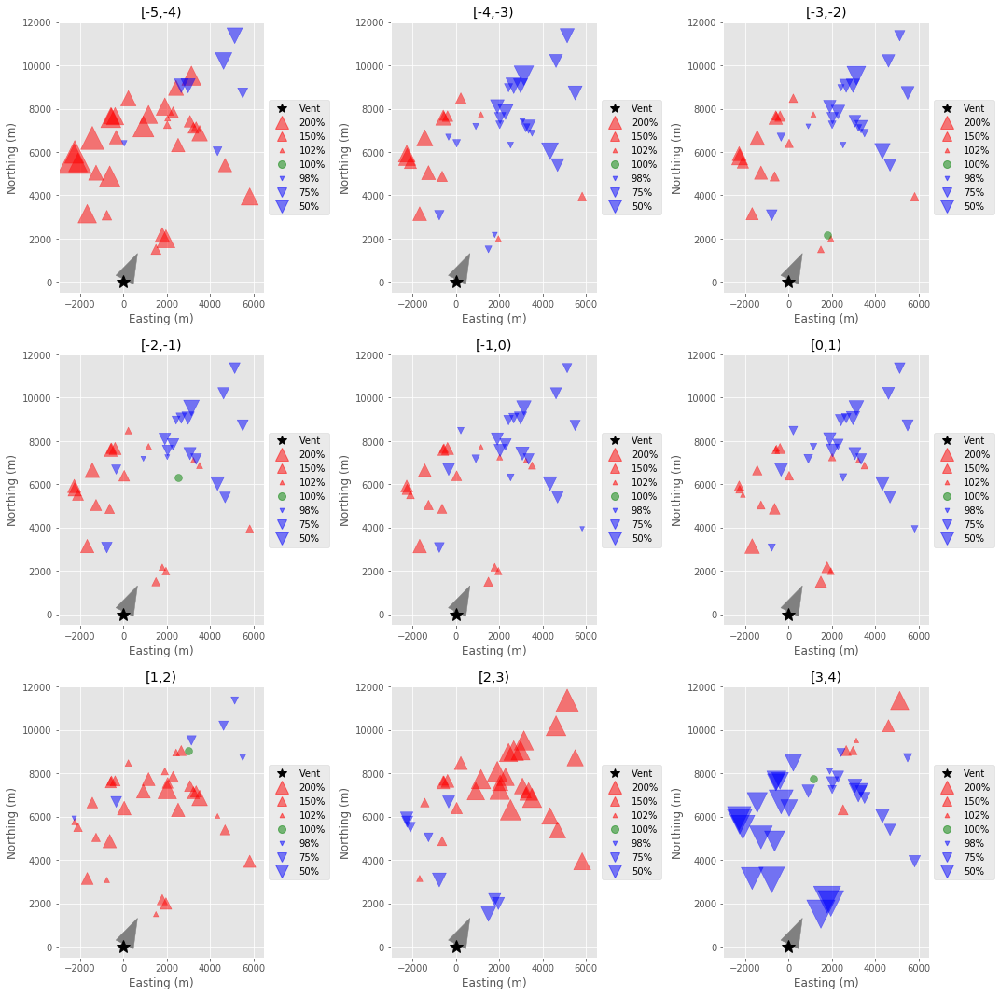

,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


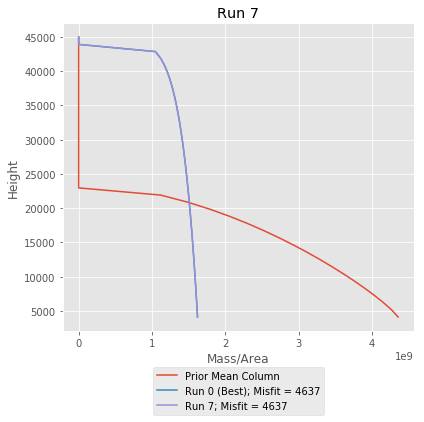

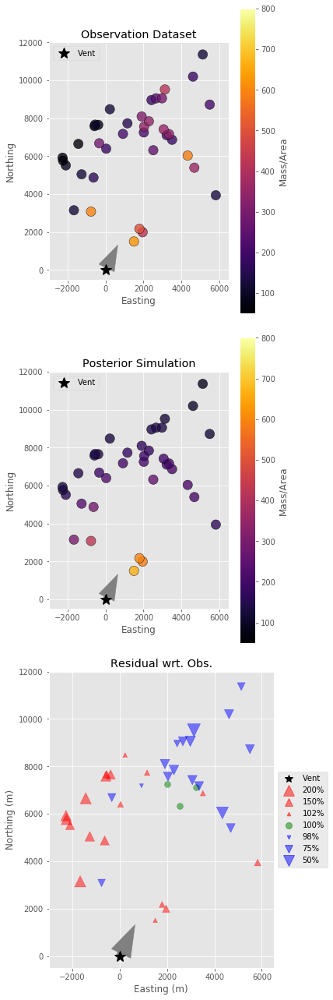

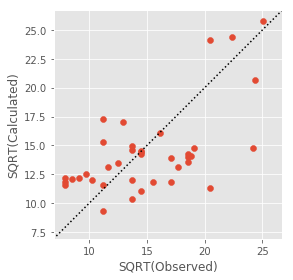

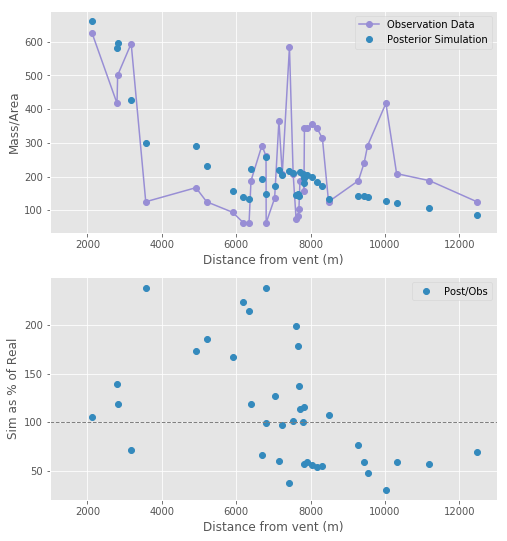

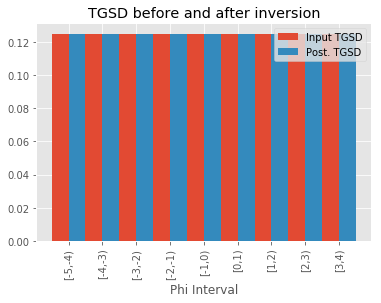

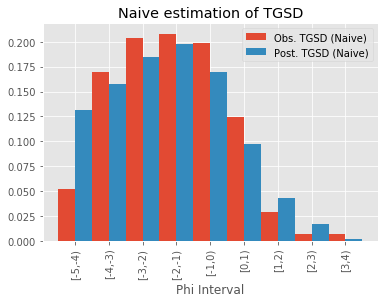

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


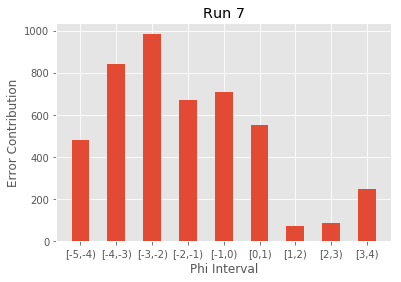

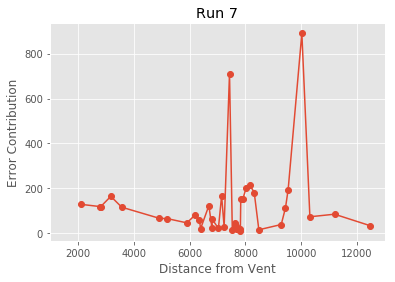

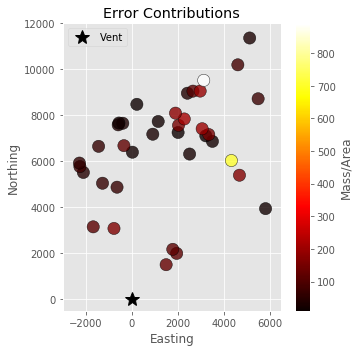

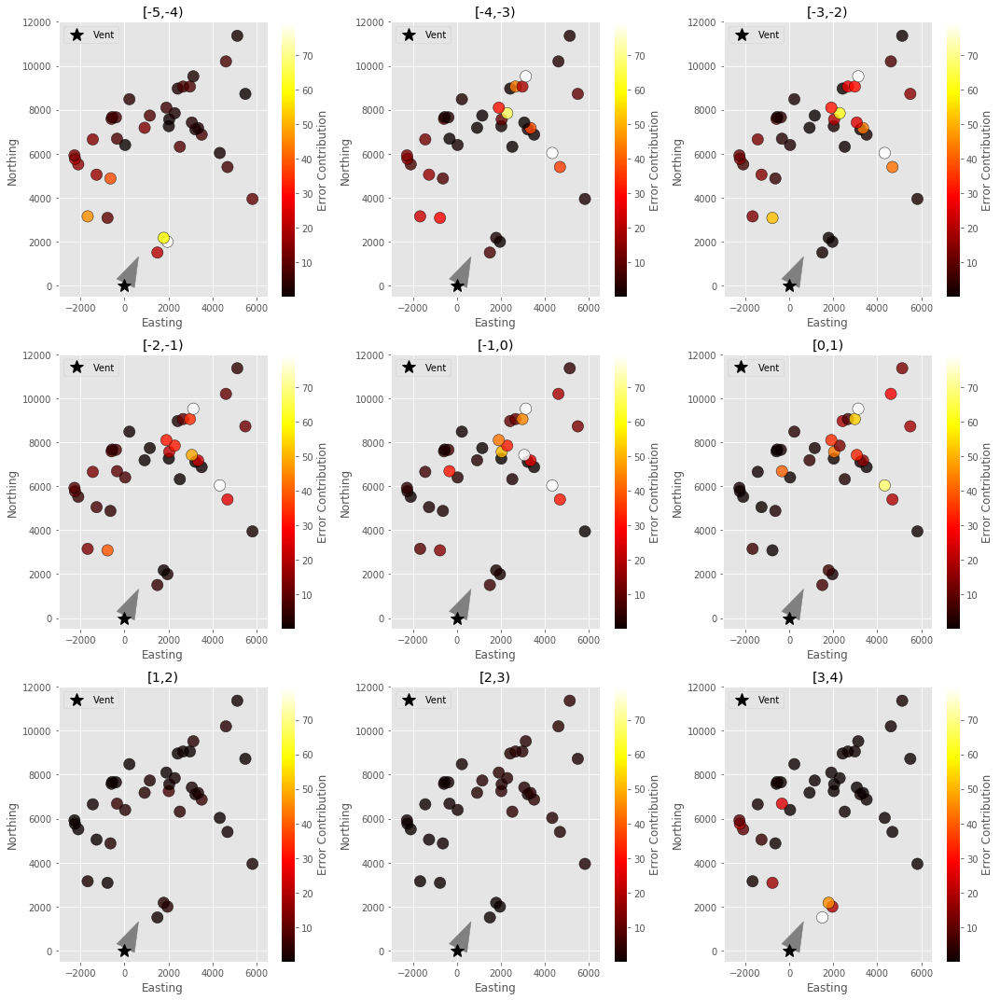

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


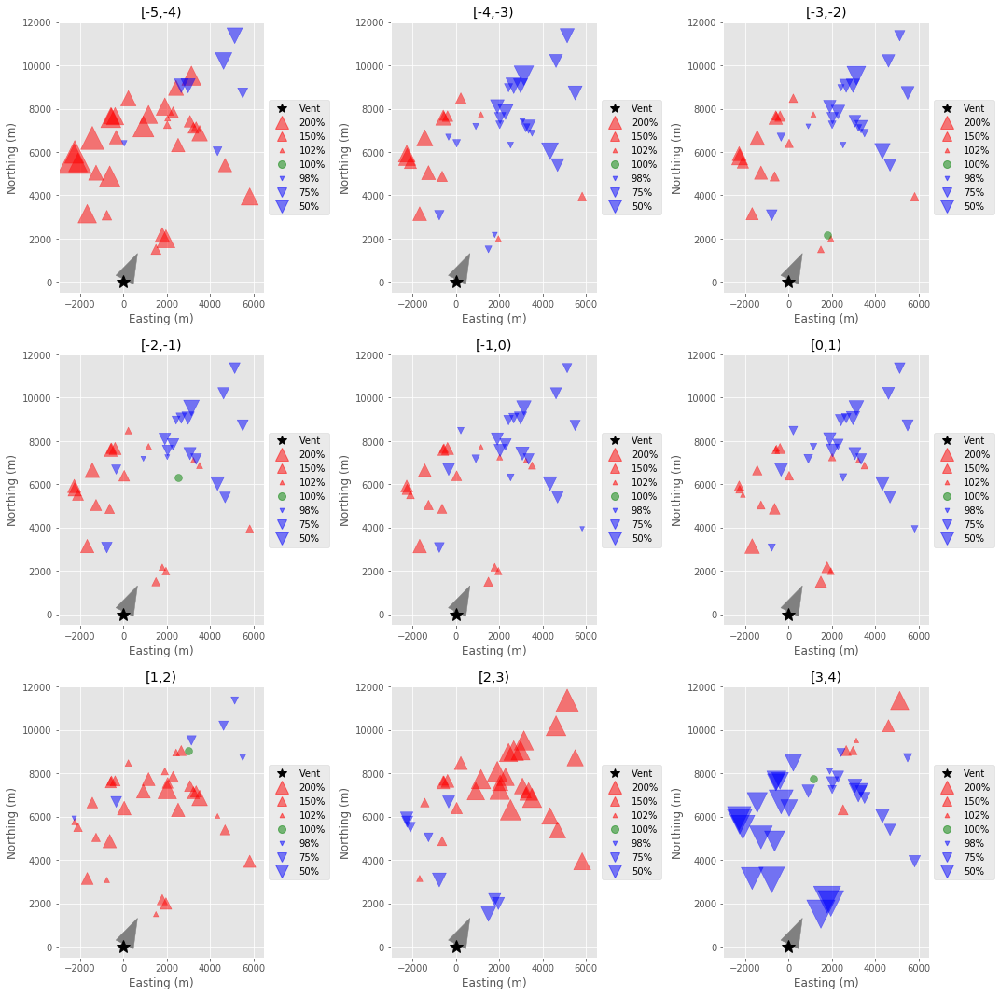

,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


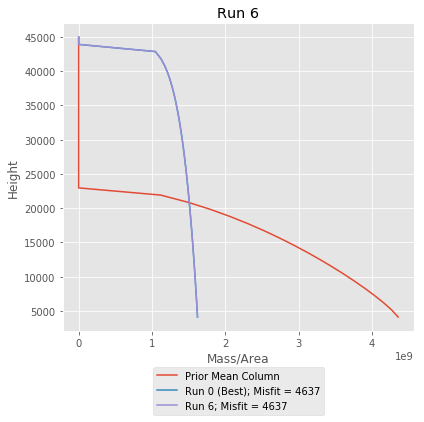

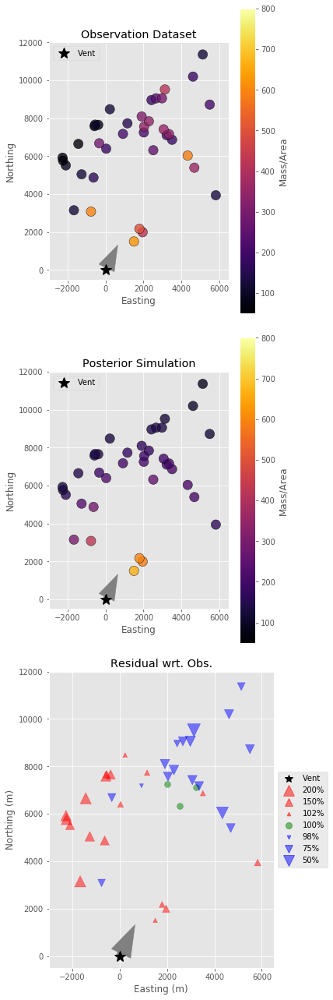

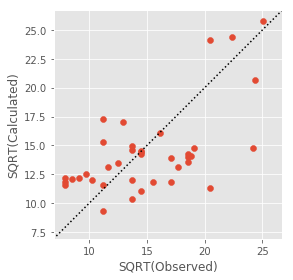

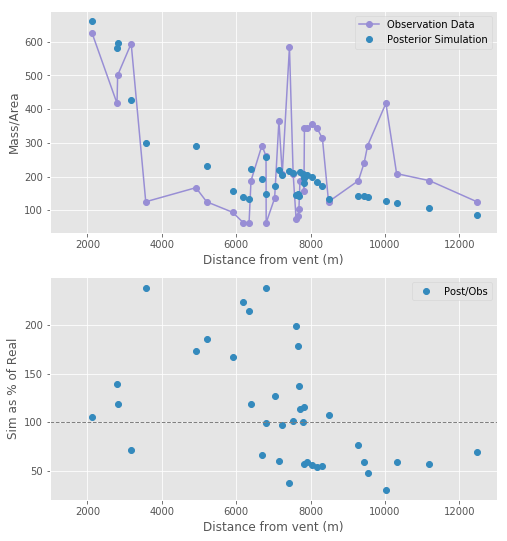

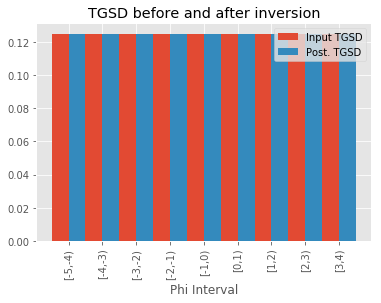

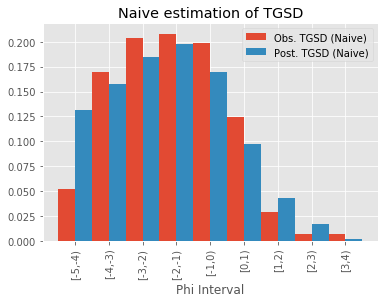

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


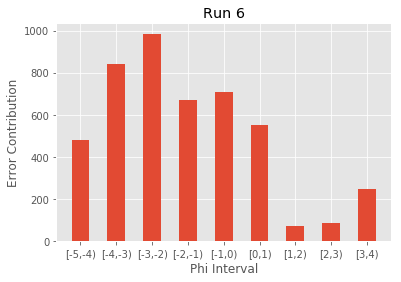

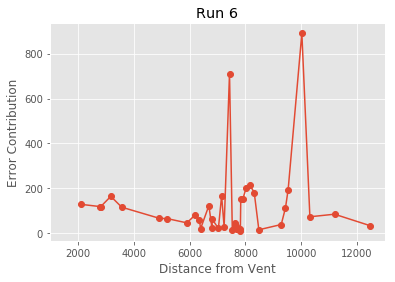

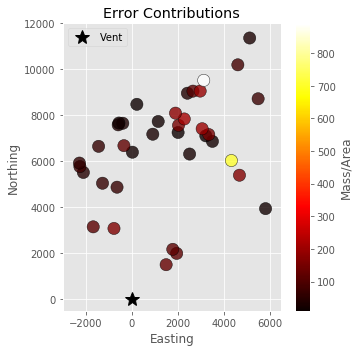

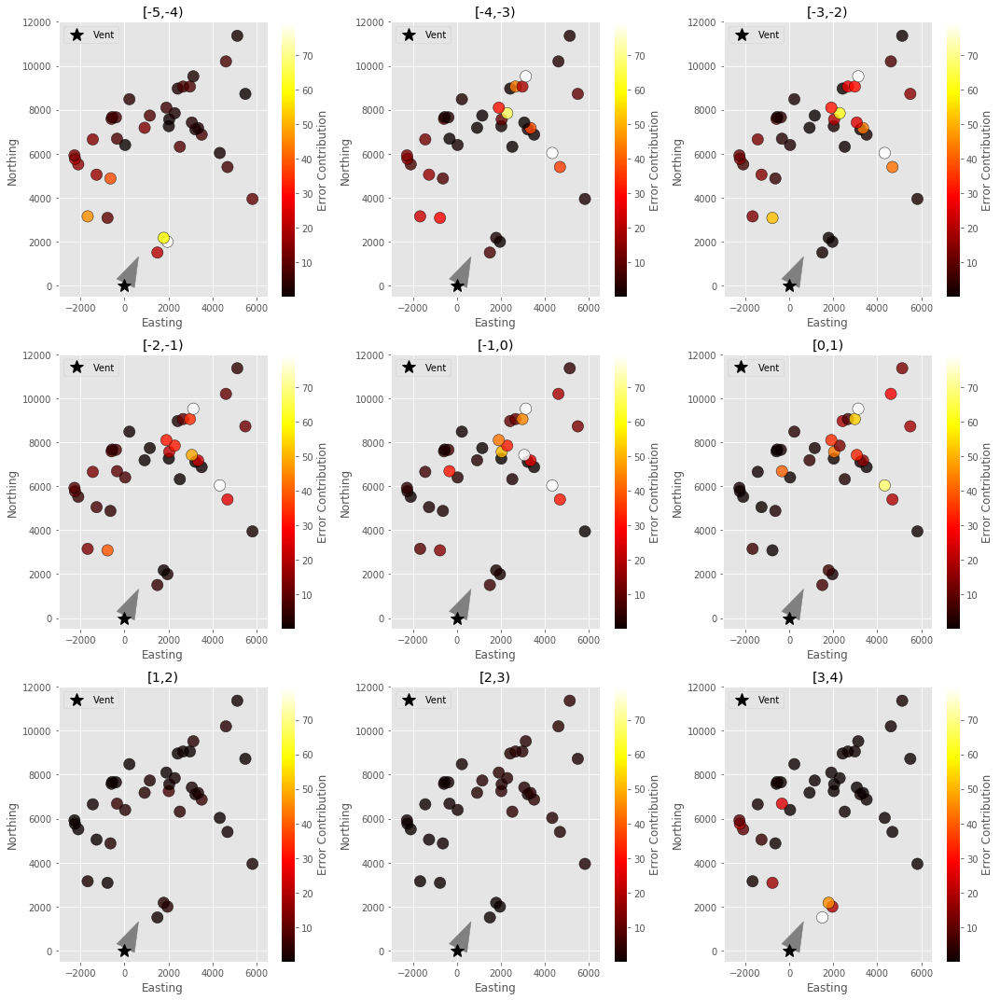

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


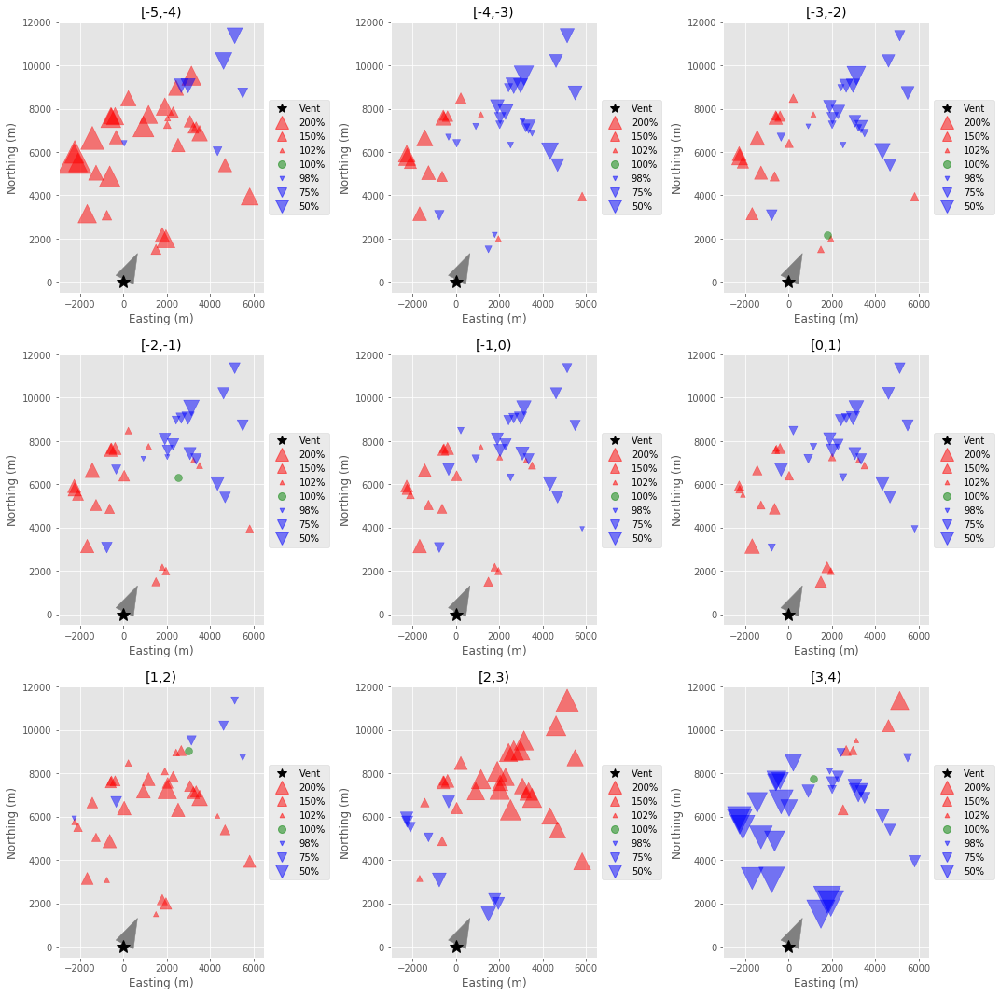

,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


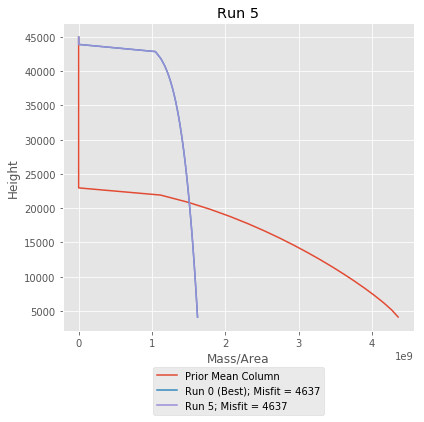

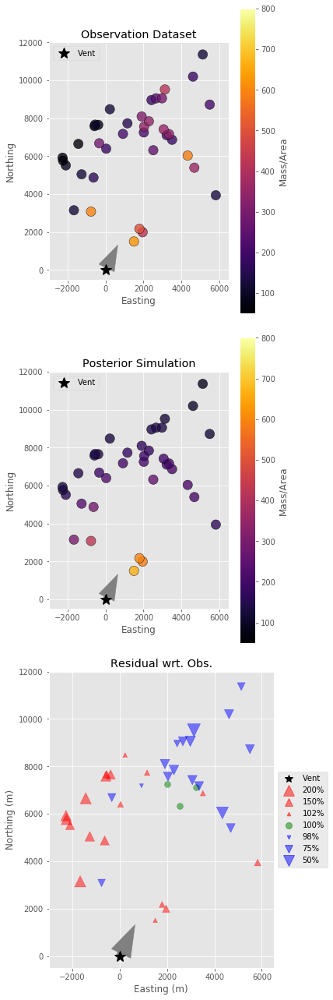

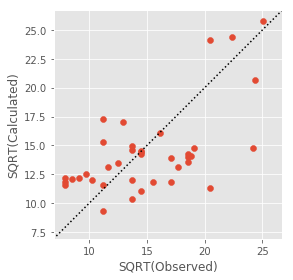

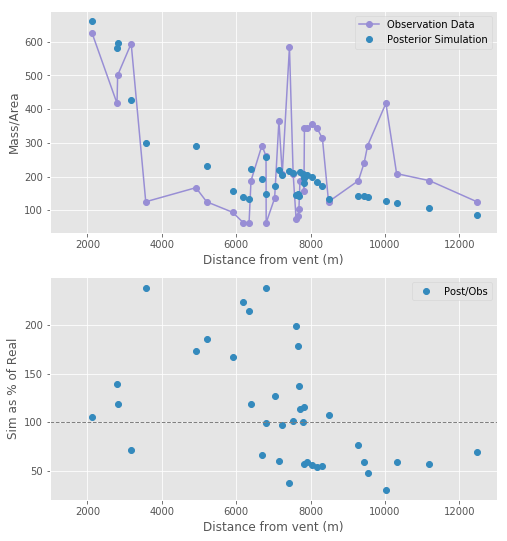

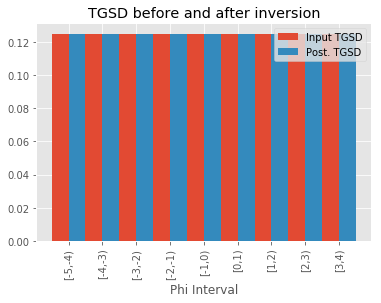

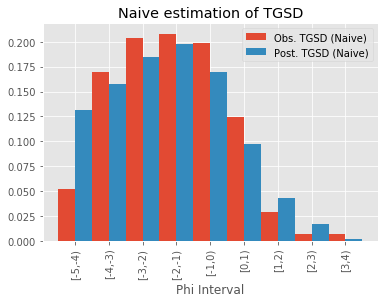

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


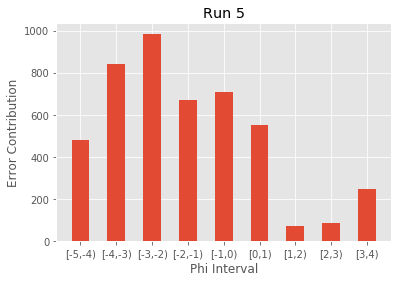

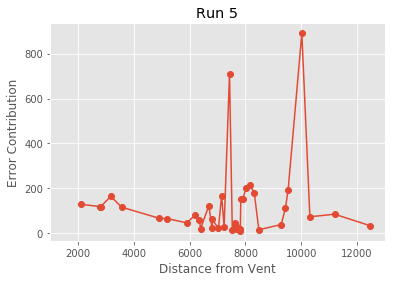

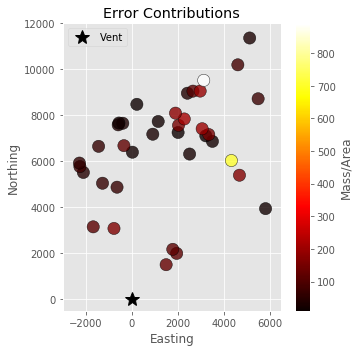

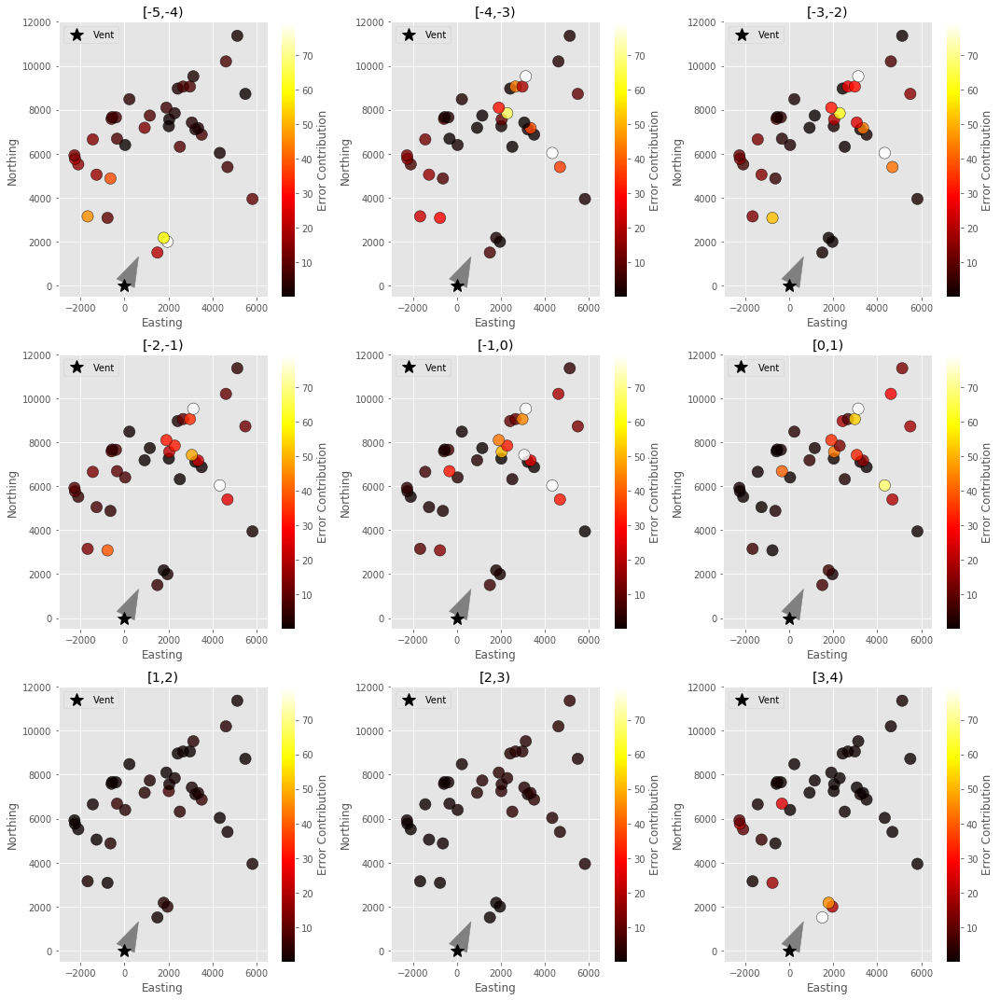

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


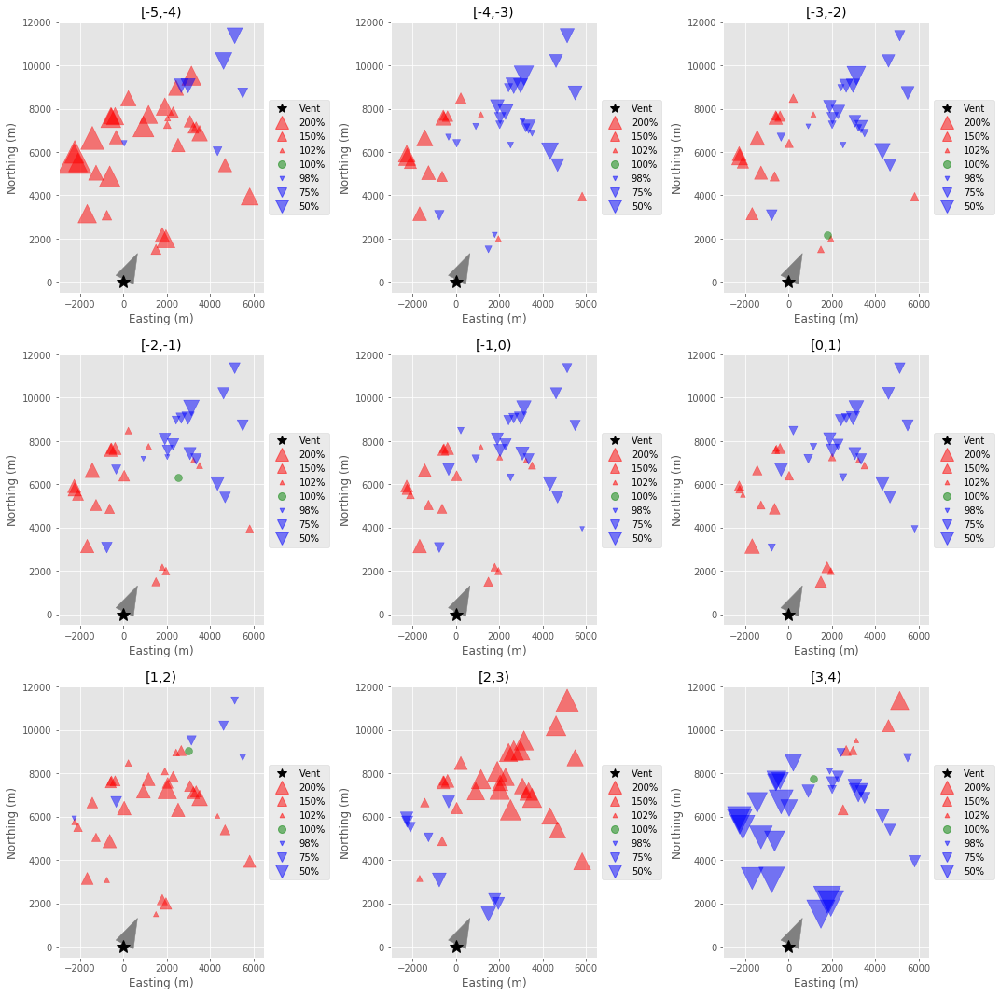

,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


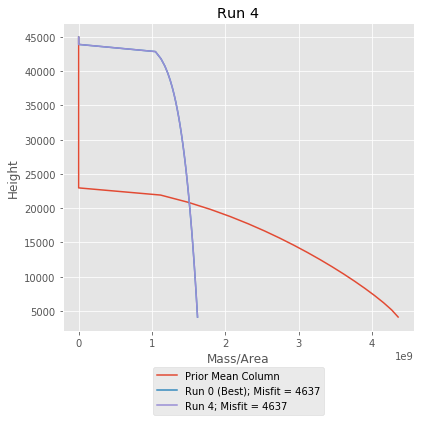

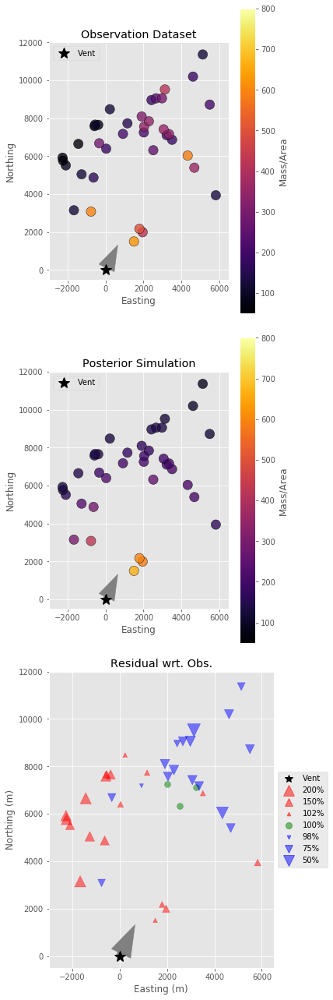

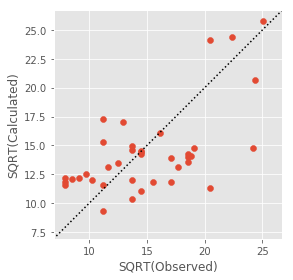

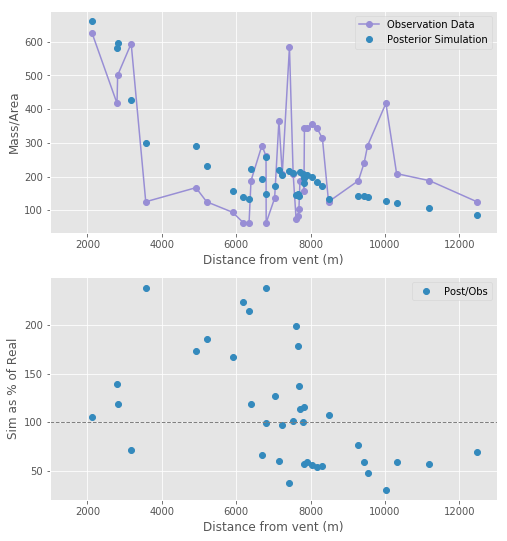

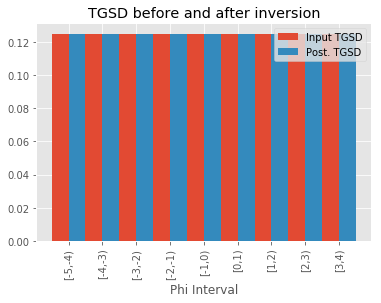

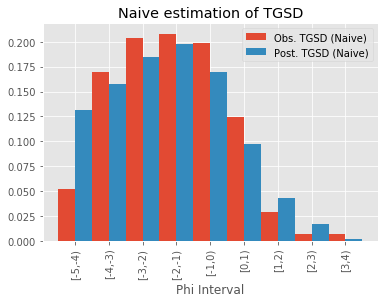

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


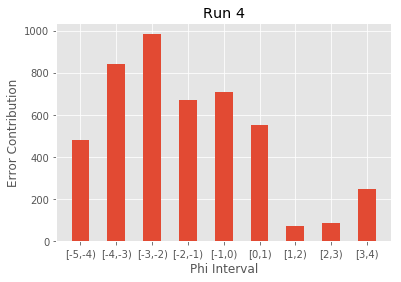

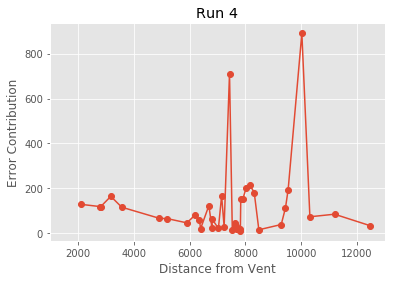

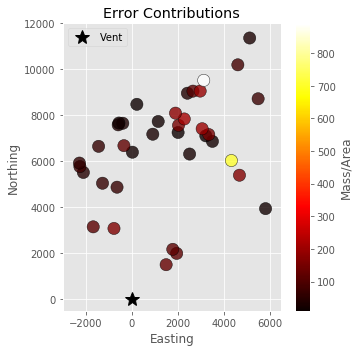

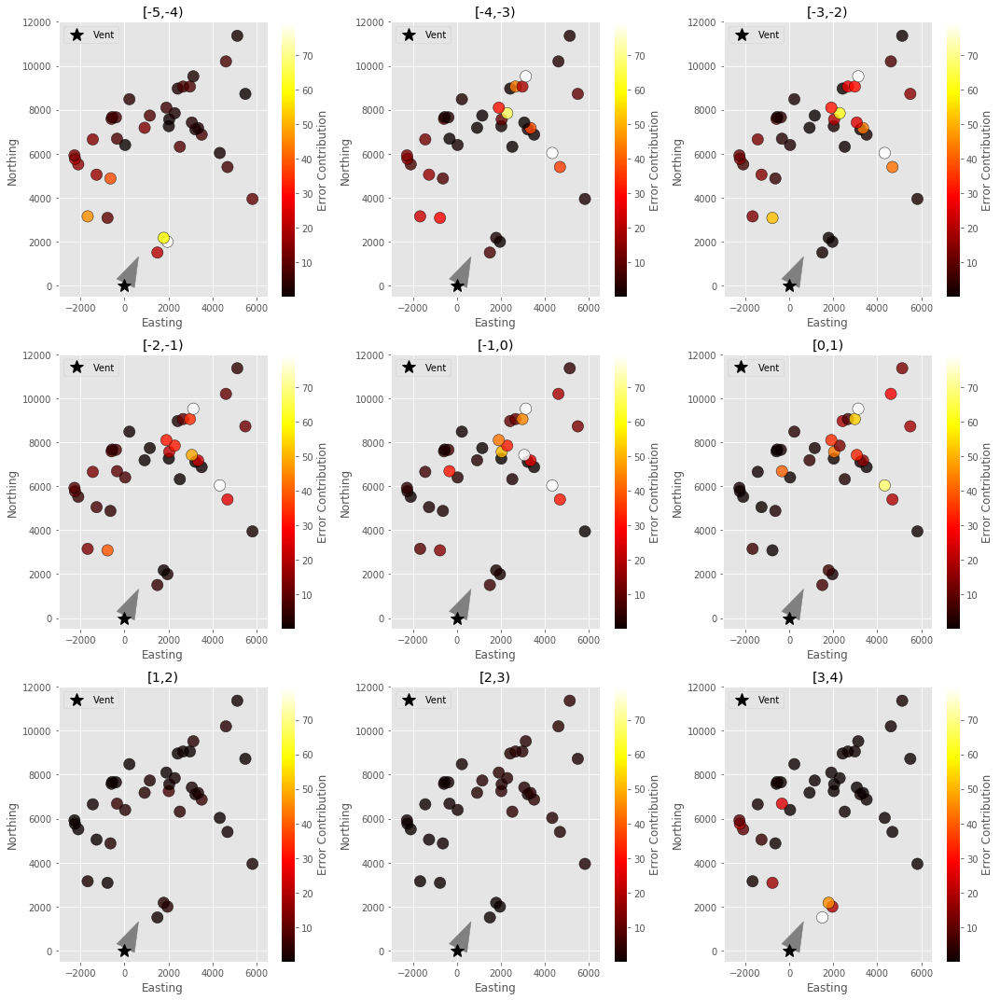

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


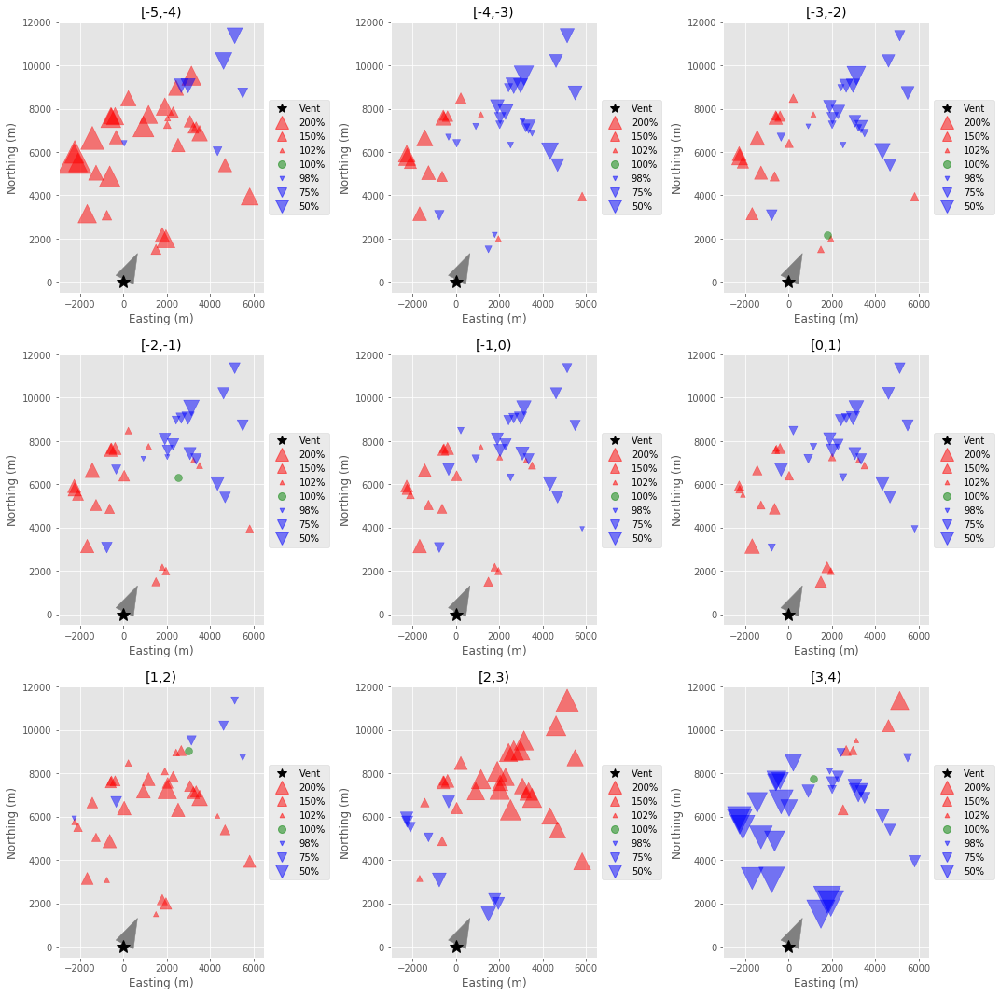

,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


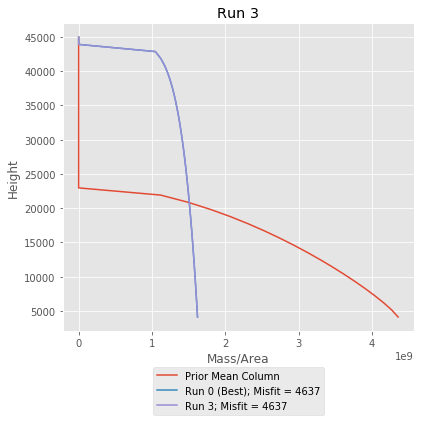

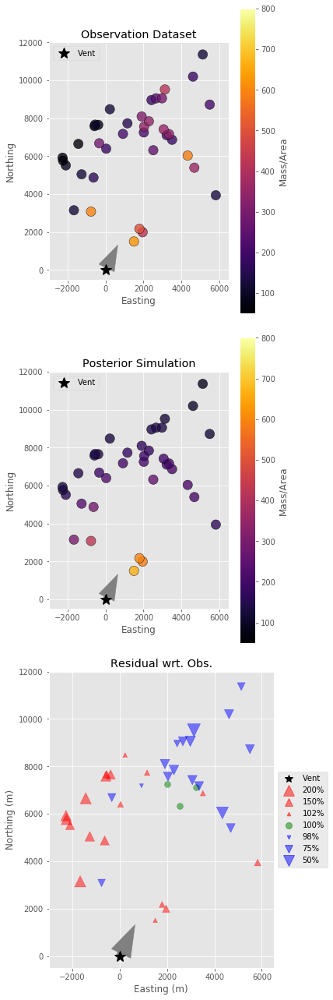

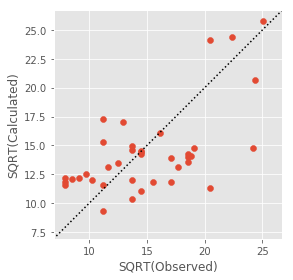

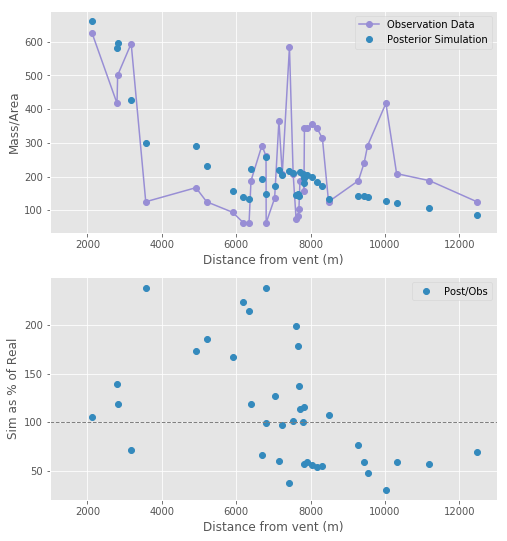

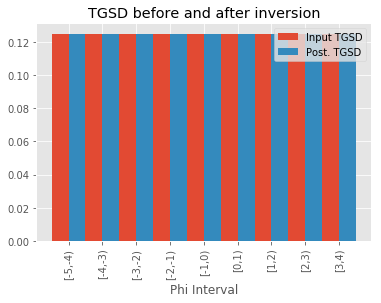

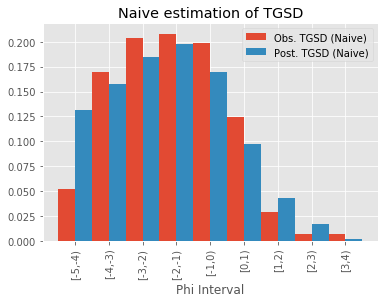

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


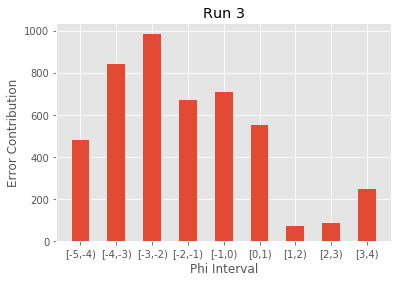

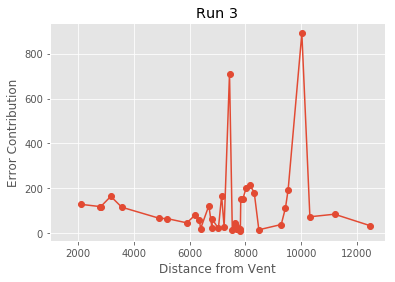

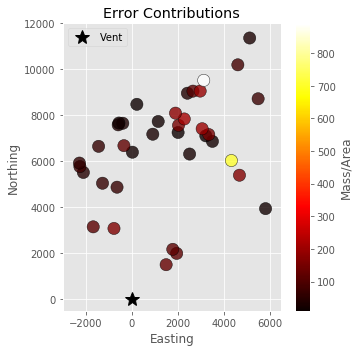

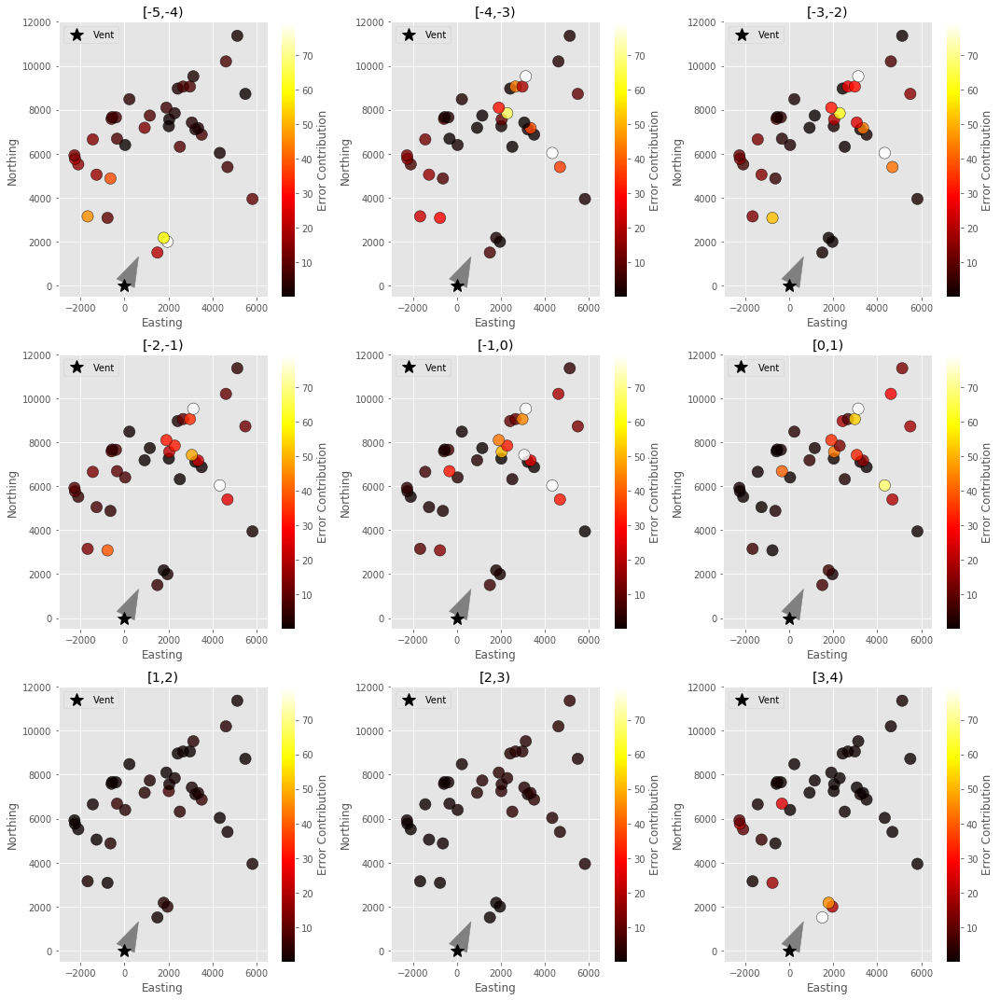

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


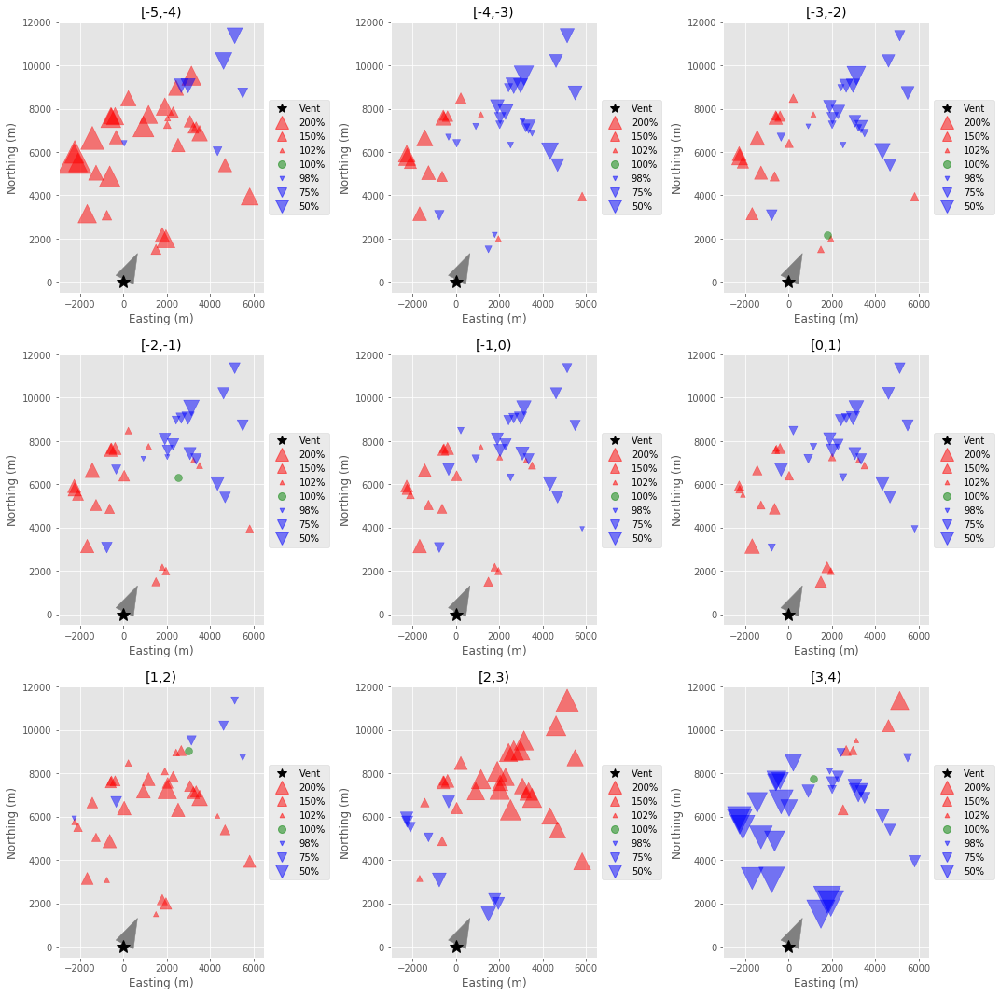

,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


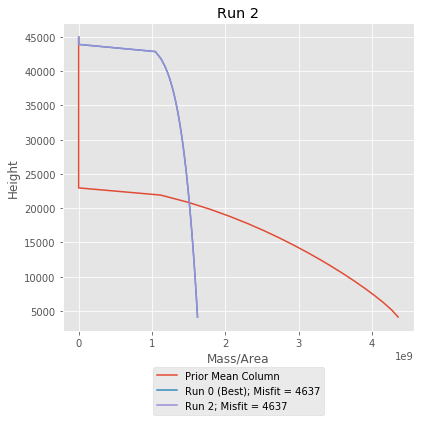

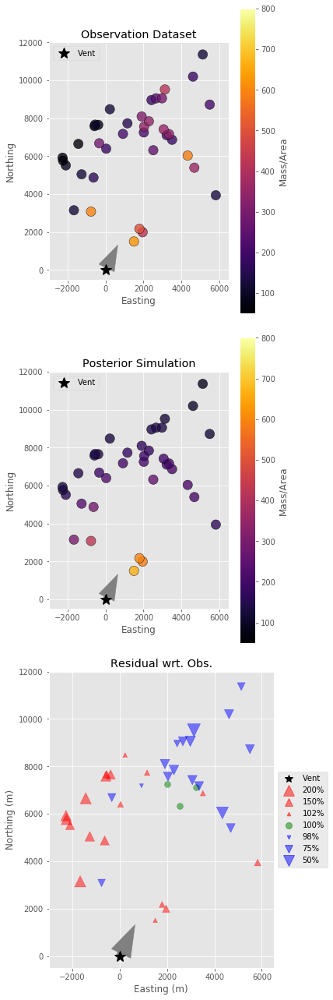

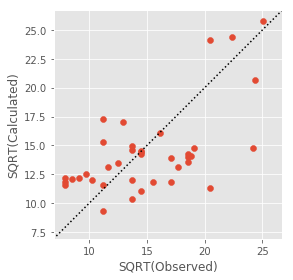

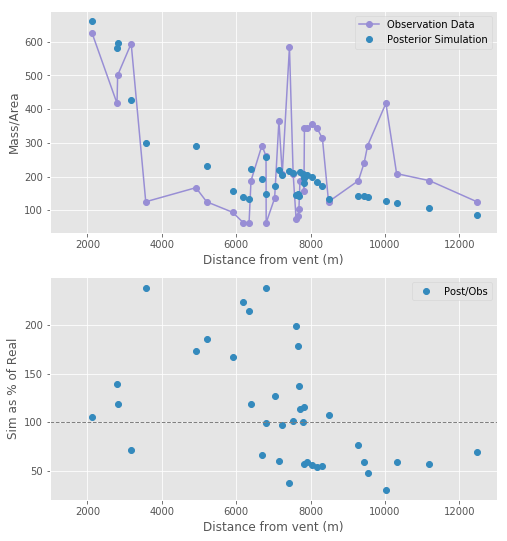

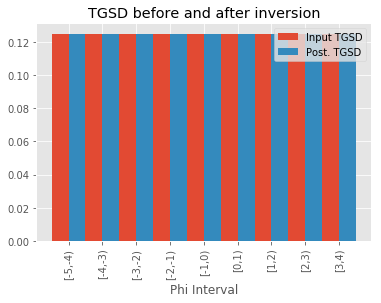

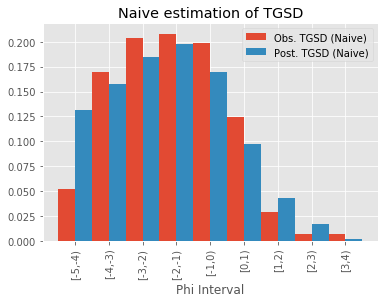

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


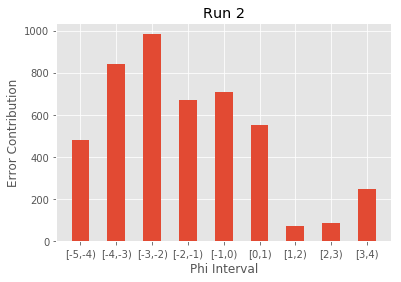

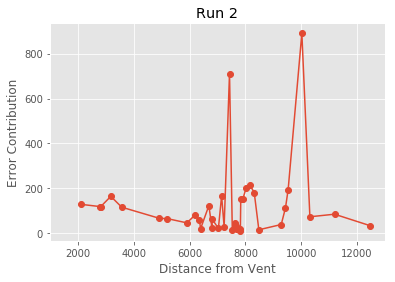

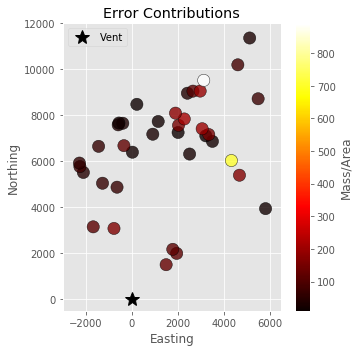

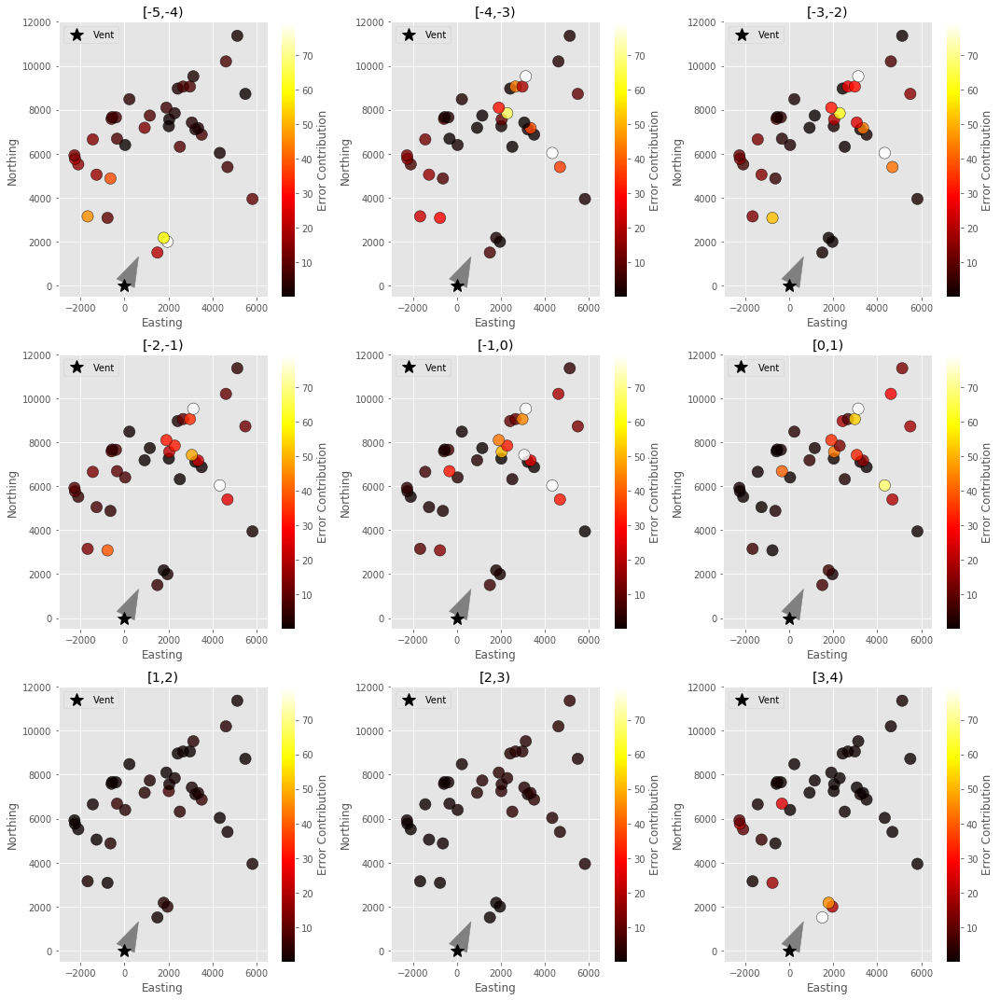

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


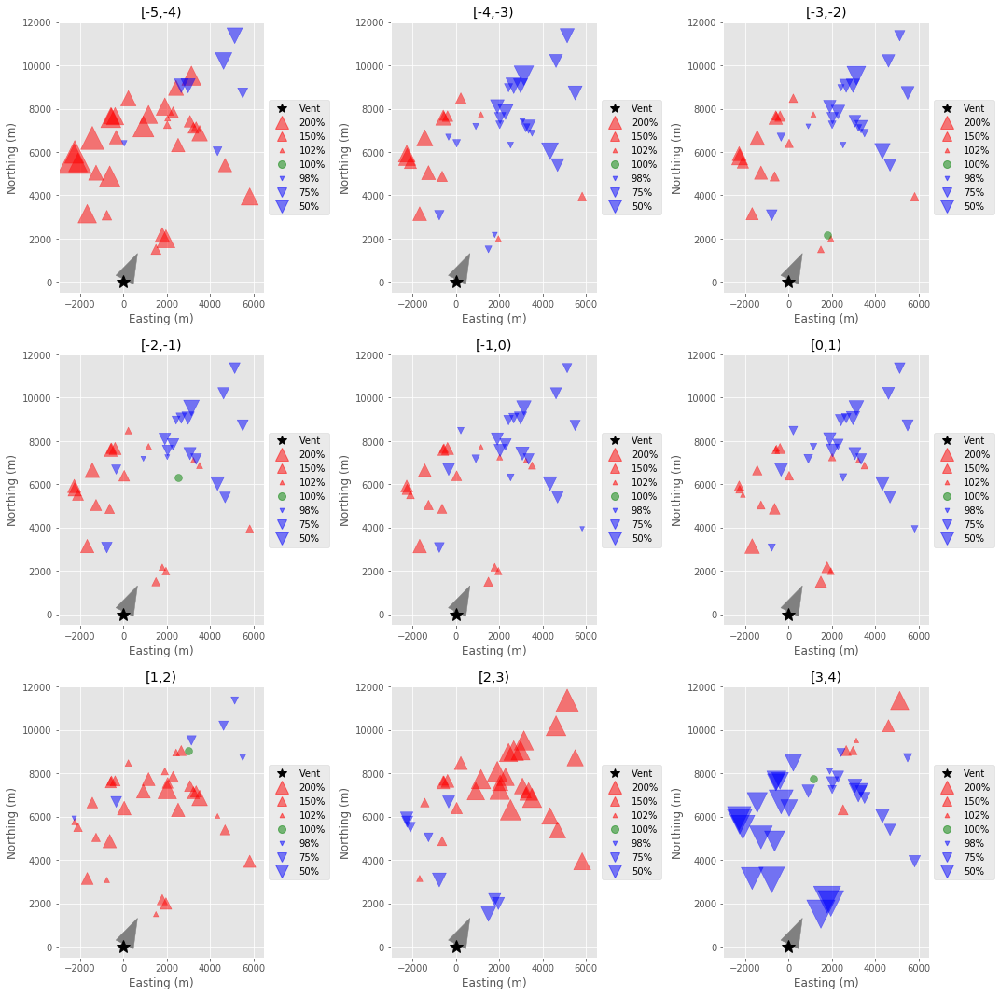

,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


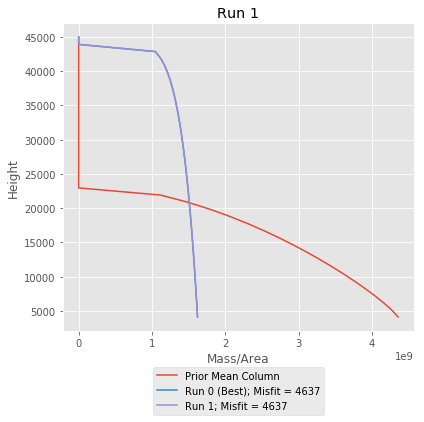

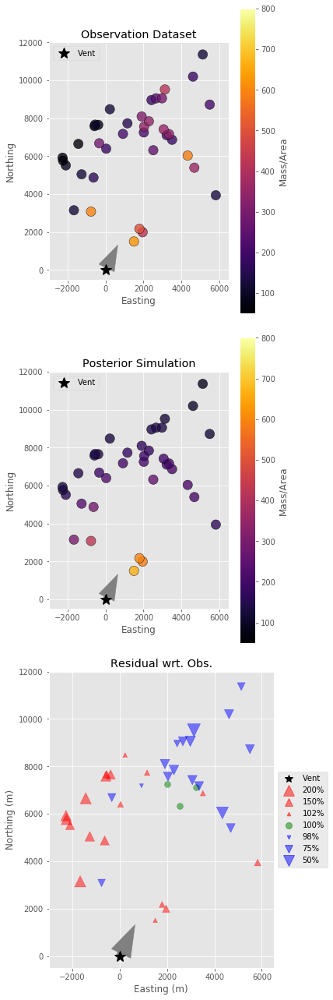

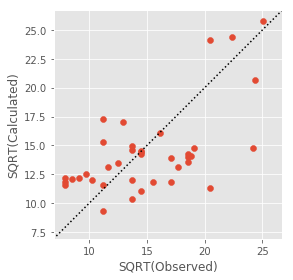

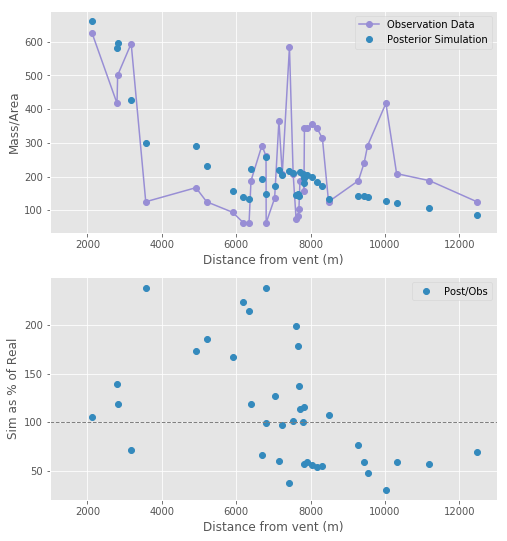

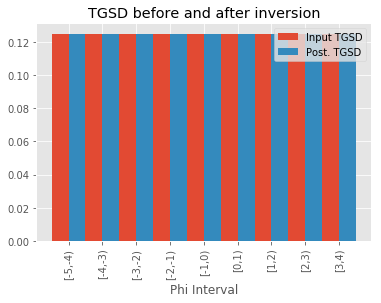

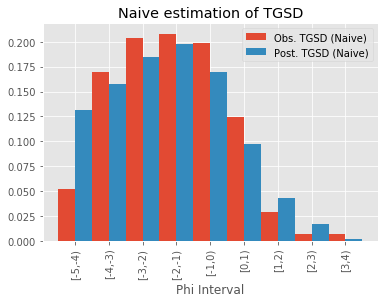

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


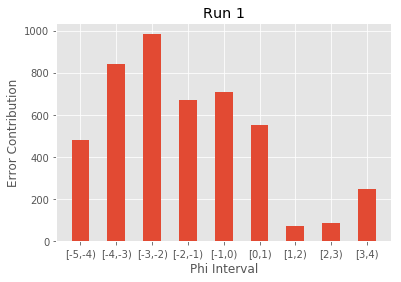

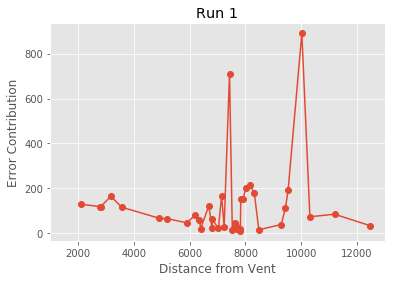

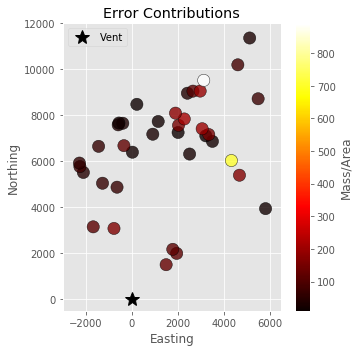

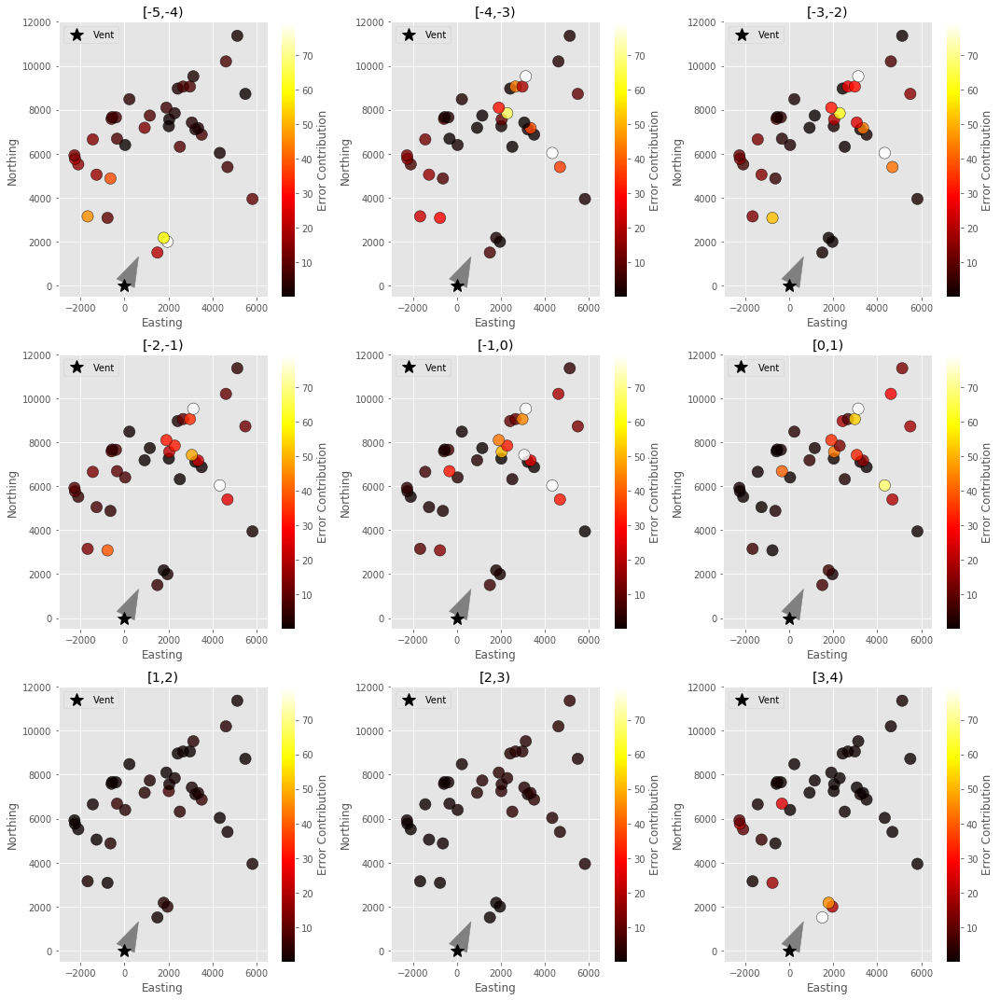

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


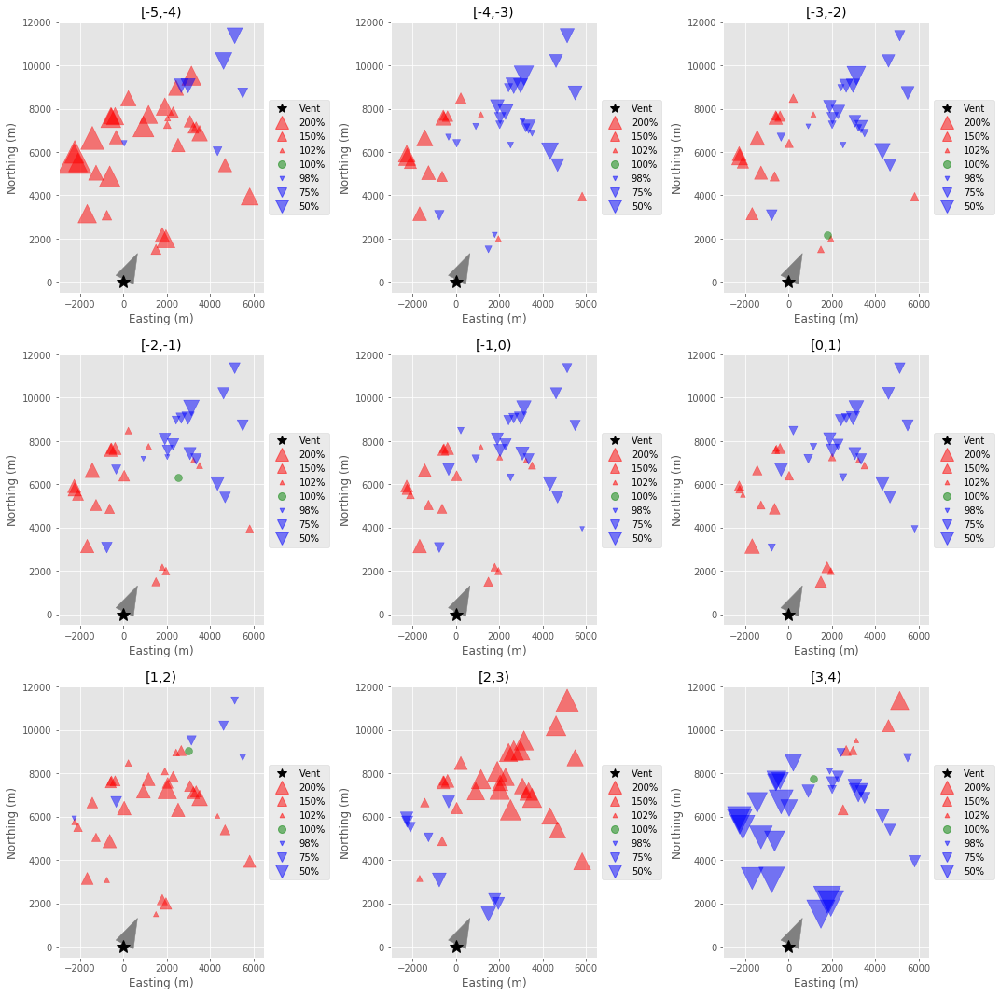

,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


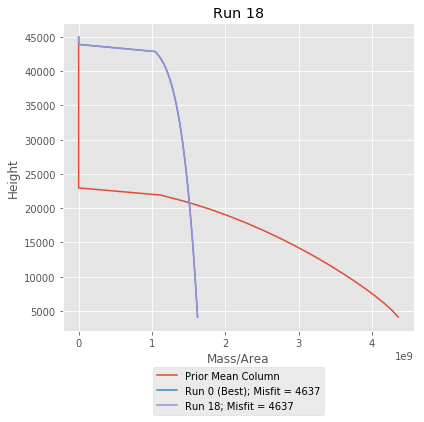

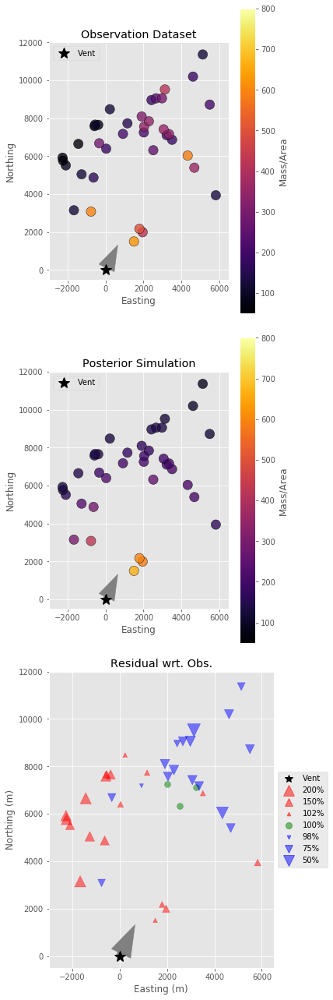

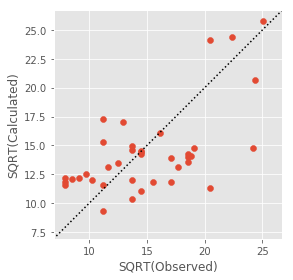

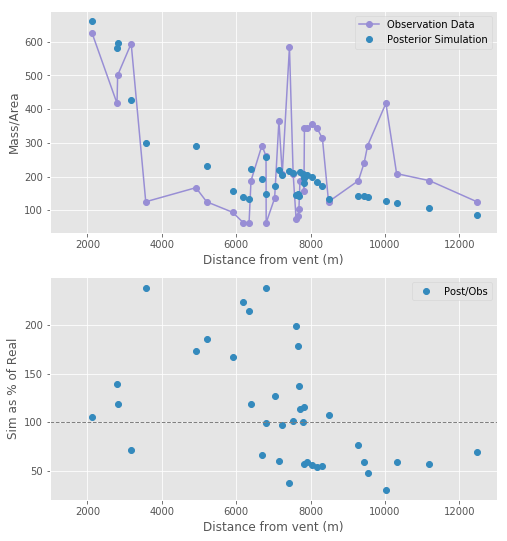

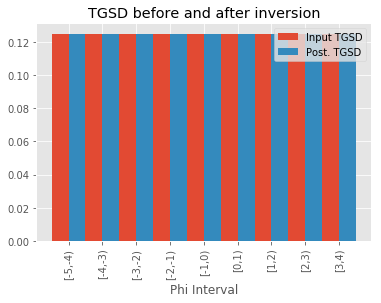

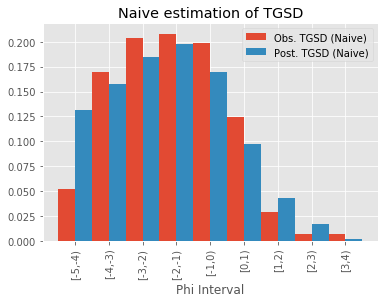

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


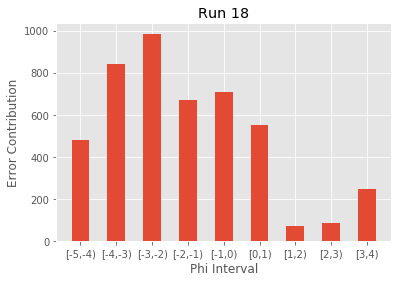

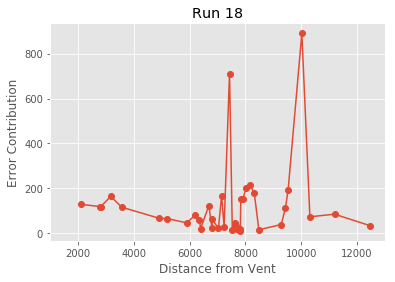

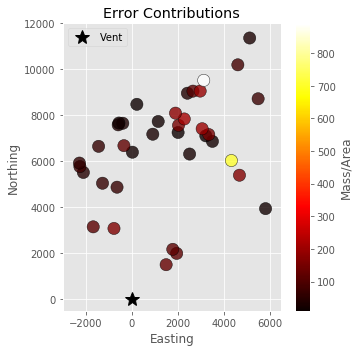

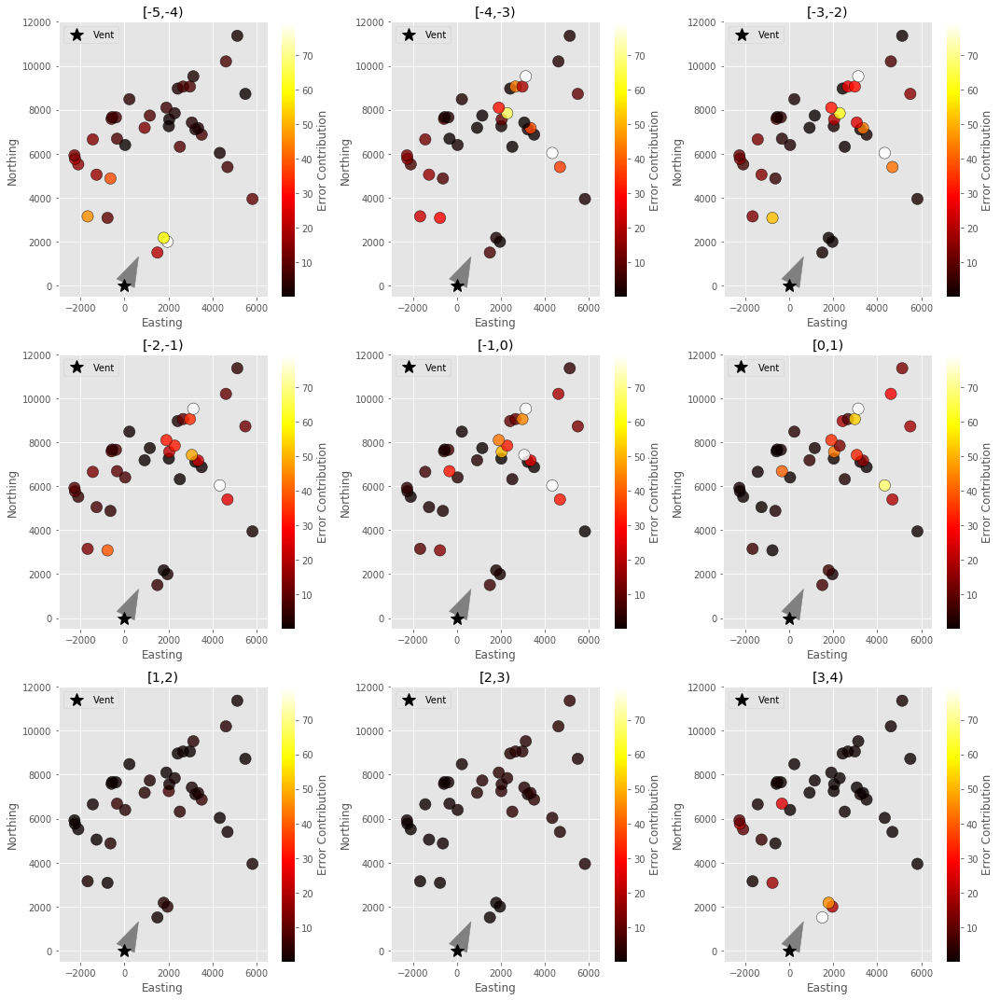

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


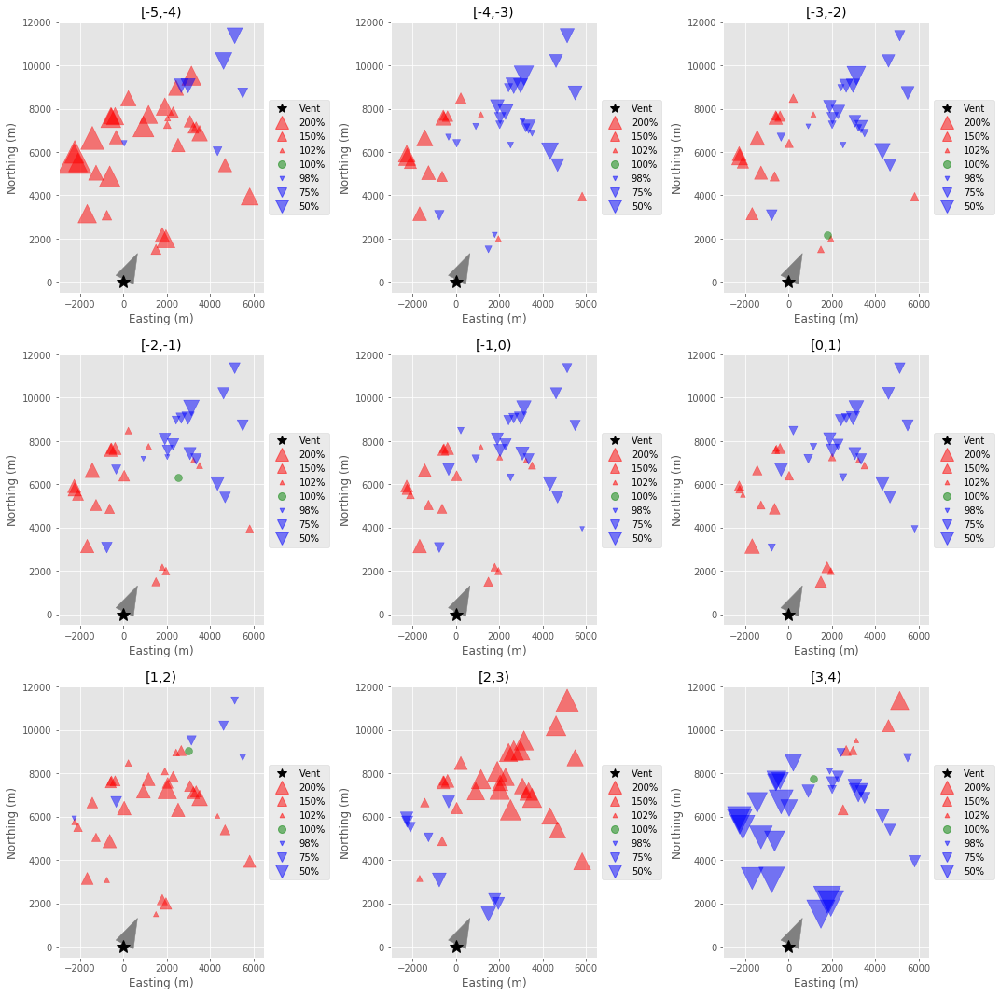

,D,a,b,eta,ftt,h1,u,v,zeta
0,"4,016",1.02,1.56,0,"6,458","24,000",5.73576,8.19152,0
1,"5,999.9",1.00002,1.13405,2.34894,"6,458","44,908",2.60482,5.33615,0


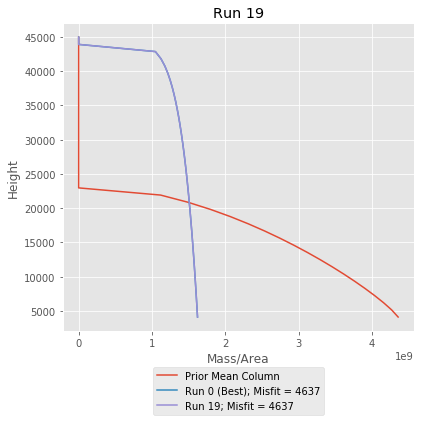

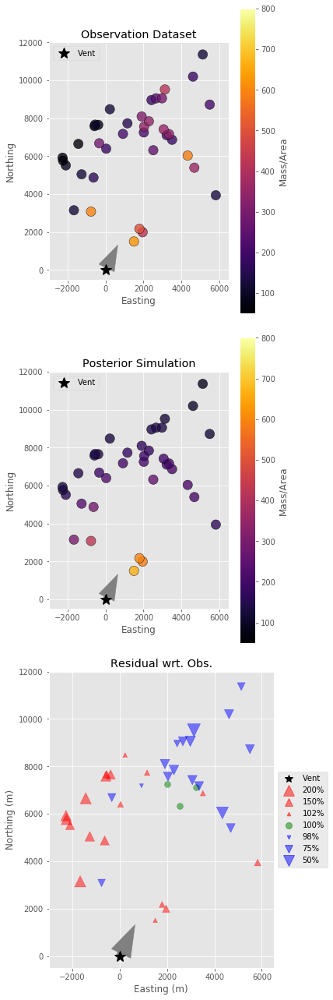

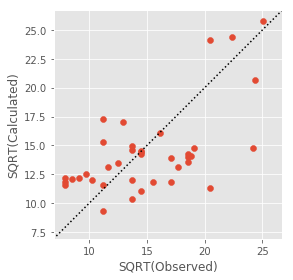

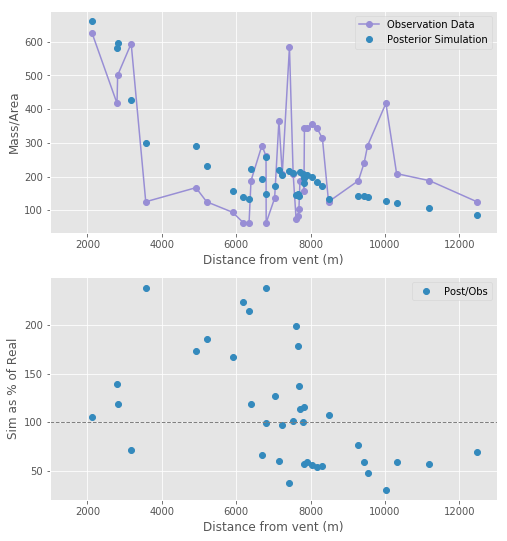

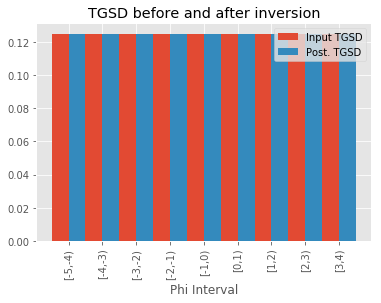

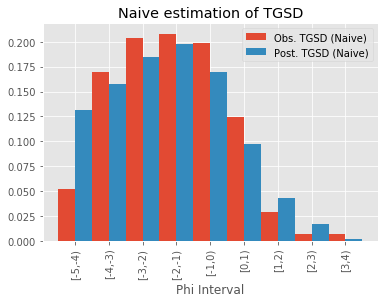

Full misfit 4636.9992563055075
Point Contributions [128.4815584  118.71908904 118.40565181 164.30298877 116.05119781
  66.49228121  65.06077701  46.23353488  80.69244965  61.13338248
  21.02525957 123.18722574  24.21947681  63.77109996  21.31774073
 166.34695984  29.26299067 711.42437269  16.65276497  45.28713843
  34.47576519  19.07943492  20.83260368  10.35579343  17.60945698
 151.85677317 153.50839311 201.97437754 213.04818944 180.88557196
  15.45850611  38.84827546 113.37133942 194.82680789 890.93808912
  73.33588041  84.79530765  33.73075035]
Phi Contributions [480.95466891 843.04353565 985.09276806 668.41346329 705.6416901
 552.28844163  70.2466723   82.9172346  248.40078175]
Sum of Point Conts: 4636.999256305509
Sum of Phi Conts: 4636.999256305508


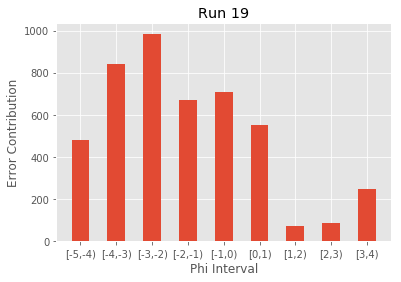

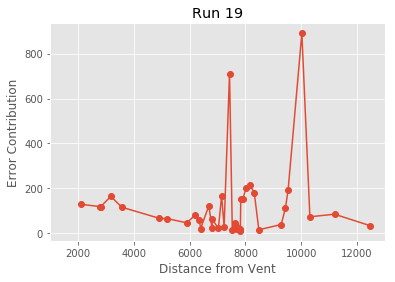

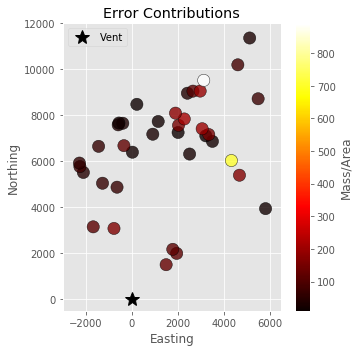

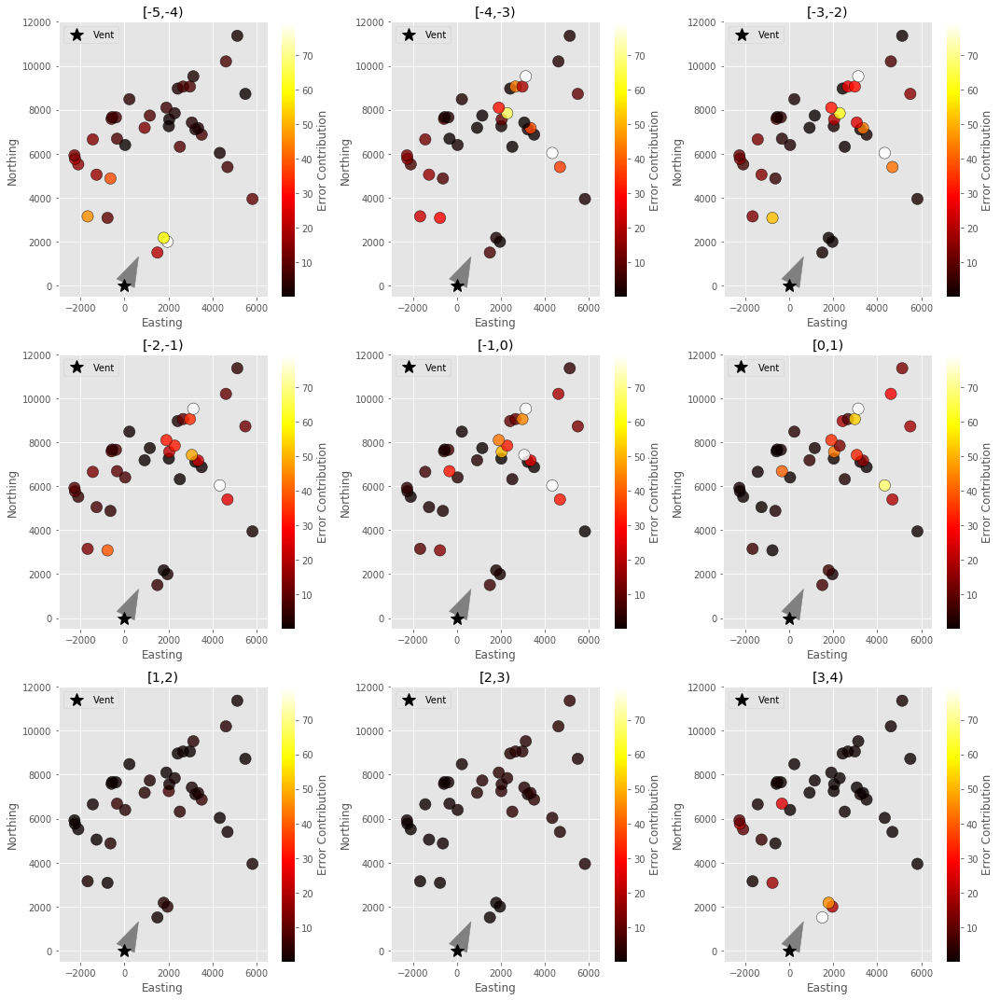

,Northing,Easting,Post. MassArea,"Post. [-5,-4)",Residual,Obs. MassArea,"Obs. [-5,-4)"
0,1506,1499,662.515,28.5722,1.57544,625.8,19.2
1,1997,1957,581.386,24.8845,5.17576,417.2,6.7
2,2173,1787,594.837,24.6988,2.90554,500.64,10.1
3,3082,-770,426.656,23.9509,1.52111,594.51,11.3
4,3152,-1673,298.968,23.3608,5.58015,125.16,10
5,4876,-637,289.169,16.4714,9.20698,166.88,3.1
6,5048,-1268,232.677,15.9666,3.02883,125.16,9.8
7,5517,-2101,156.764,14.2429,5.80142,93.87,4.1
8,5771,-2250,140.042,13.3351,298.413,62.58,0.1
9,5925,-2272,134.177,12.8049,6.53684,62.58,4.2


,Northing,Easting,Post. MassArea,"Post. [-4,-3)",Residual,Obs. MassArea,"Obs. [-4,-3)"
0,1506,1499,662.515,25.097,0.857077,625.8,31
1,1997,1957,581.386,23.8516,1.10794,417.2,30
2,2173,1787,594.837,23.7872,0.942096,500.64,30
3,3082,-770,426.656,23.4206,0.67232,594.51,25
4,3152,-1673,298.968,23.1337,2.51178,125.16,22
5,4876,-637,289.169,19.813,1.63485,166.88,21
6,5048,-1268,232.677,19.4806,2.58679,125.16,14
7,5517,-2101,156.764,18.302,2.03764,93.87,15
8,5771,-2250,140.042,17.6389,4.38583,62.58,9
9,5925,-2272,134.177,17.2368,4.10635,62.58,9


,Northing,Easting,Post. MassArea,"Post. [-3,-2)",Residual,Obs. MassArea,"Obs. [-3,-2)"
0,1506,1499,662.515,19.7674,1.16262,625.8,18
1,1997,1957,581.386,20.4217,1.13834,417.2,25
2,2173,1787,594.837,20.452,1.0125,500.64,24
3,3082,-770,426.656,20.4951,0.588339,594.51,25
4,3152,-1673,298.968,20.5238,2.0427,125.16,24
5,4876,-637,289.169,21.0246,1.45726,166.88,25
6,5048,-1268,232.677,21.0201,2.29865,125.16,17
7,5517,-2101,156.764,20.9049,1.83745,93.87,19
8,5771,-2250,140.042,20.7772,3.57656,62.58,13
9,5925,-2272,134.177,20.6799,2.6082,62.58,17


,Northing,Easting,Post. MassArea,"Post. [-2,-1)",Residual,Obs. MassArea,"Obs. [-2,-1)"
0,1506,1499,662.515,13.8036,1.3285,625.8,11
1,1997,1957,581.386,15.3518,1.25843,417.2,17
2,2173,1787,594.837,15.4289,1.14575,500.64,16
3,3082,-770,426.656,15.7467,0.594776,594.51,19
4,3152,-1673,298.968,15.9834,2.3862,125.16,16
5,4876,-637,289.169,18.9408,1.49184,166.88,22
6,5048,-1268,232.677,19.2052,1.78515,125.16,20
7,5517,-2101,156.764,20.0826,1.76517,93.87,19
8,5771,-2250,140.042,20.5232,2.4172,62.58,19
9,5925,-2272,134.177,20.7709,2.34393,62.58,19


,Northing,Easting,Post. MassArea,"Post. [-1,0)",Residual,Obs. MassArea,"Obs. [-1,0)"
0,1506,1499,662.515,8.13467,1.43532,625.8,6
1,1997,1957,581.386,9.56947,1.21231,417.2,11
2,2173,1787,594.837,9.64569,1.2734,500.64,9
3,3082,-770,426.656,9.96343,0.650032,594.51,11
4,3152,-1673,298.968,10.1813,2.432,125.16,10
5,4876,-637,289.169,13.3128,1.44178,166.88,16
6,5048,-1268,232.677,13.5475,1.48148,125.16,17
7,5517,-2101,156.764,14.5188,1.27614,93.87,19
8,5771,-2250,140.042,15.1068,1.60981,62.58,21
9,5925,-2272,134.177,15.4712,1.95127,62.58,17


,Northing,Easting,Post. MassArea,"Post. [0,1)",Residual,Obs. MassArea,"Obs. [0,1)"
0,1506,1499,662.515,3.4149,1.80763,625.8,2
1,1997,1957,581.386,4.27905,1.19261,417.2,5
2,2173,1787,594.837,4.32428,1.71264,500.64,3
3,3082,-770,426.656,4.57559,0.82093,594.51,4
4,3152,-1673,298.968,4.77718,2.85279,125.16,4
5,4876,-637,289.169,6.87228,1.70118,166.88,7
6,5048,-1268,232.677,7.00578,1.3024,125.16,10
7,5517,-2101,156.764,7.54067,1.04942,93.87,12
8,5771,-2250,140.042,7.87815,1.25927,62.58,14
9,5925,-2272,134.177,8.09633,1.57811,62.58,11


,Northing,Easting,Post. MassArea,"Post. [1,2)",Residual,Obs. MassArea,"Obs. [1,2)"
0,1506,1499,662.515,0.996486,1.05495,625.8,1
1,1997,1957,581.386,1.33992,1.86723,417.2,1
2,2173,1787,594.837,1.35701,1.61234,500.64,1
3,3082,-770,426.656,1.49561,1.07334,594.51,1
4,3152,-1673,298.968,1.63421,1.9518,125.16,2
5,4876,-637,289.169,2.76359,2.39437,166.88,2
6,5048,-1268,232.677,2.89503,1.34549,125.16,4
7,5517,-2101,156.764,3.29019,1.37367,93.87,4
8,5771,-2250,140.042,3.49708,1.11797,62.58,7
9,5925,-2272,134.177,3.62203,0.970744,62.58,8


,Northing,Easting,Post. MassArea,"Post. [2,3)",Residual,Obs. MassArea,"Obs. [2,3)"
0,1506,1499,662.515,0.200464,0.353709,625.8,0.6
1,1997,1957,581.386,0.283157,0.493238,417.2,0.8
2,2173,1787,594.837,0.286977,0.487104,500.64,0.7
3,3082,-770,426.656,0.329274,0.393844,594.51,0.6
4,3152,-1673,298.968,0.377719,1.12781,125.16,0.8
5,4876,-637,289.169,0.743866,1.43219,166.88,0.9
6,5048,-1268,232.677,0.813522,0.720174,125.16,2.1
7,5517,-2101,156.764,1.02656,0.659374,93.87,2.6
8,5771,-2250,140.042,1.13841,0.55381,62.58,4.6
9,5925,-2272,134.177,1.20469,0.469628,62.58,5.5


,Northing,Easting,Post. MassArea,"Post. [3,4)",Residual,Obs. MassArea,"Obs. [3,4)"
0,1506,1499,662.515,0.0132764,0.015617,625.8,0.9
1,1997,1957,581.386,0.0188819,0.0328909,417.2,0.8
2,2173,1787,594.837,0.0190746,0.0226636,500.64,1
3,3082,-770,426.656,0.0229477,0.0329372,594.51,0.5
4,3152,-1673,298.968,0.0279001,0.0833058,125.16,0.8
5,4876,-637,289.169,0.0575844,0.124728,166.88,0.8
6,5048,-1268,232.677,0.0657048,0.0678597,125.16,1.8
7,5517,-2101,156.764,0.0913256,0.0544697,93.87,2.8
8,5771,-2250,140.042,0.105117,0.0420056,62.58,5.6
9,5925,-2272,134.177,0.113292,0.0578351,62.58,4.2


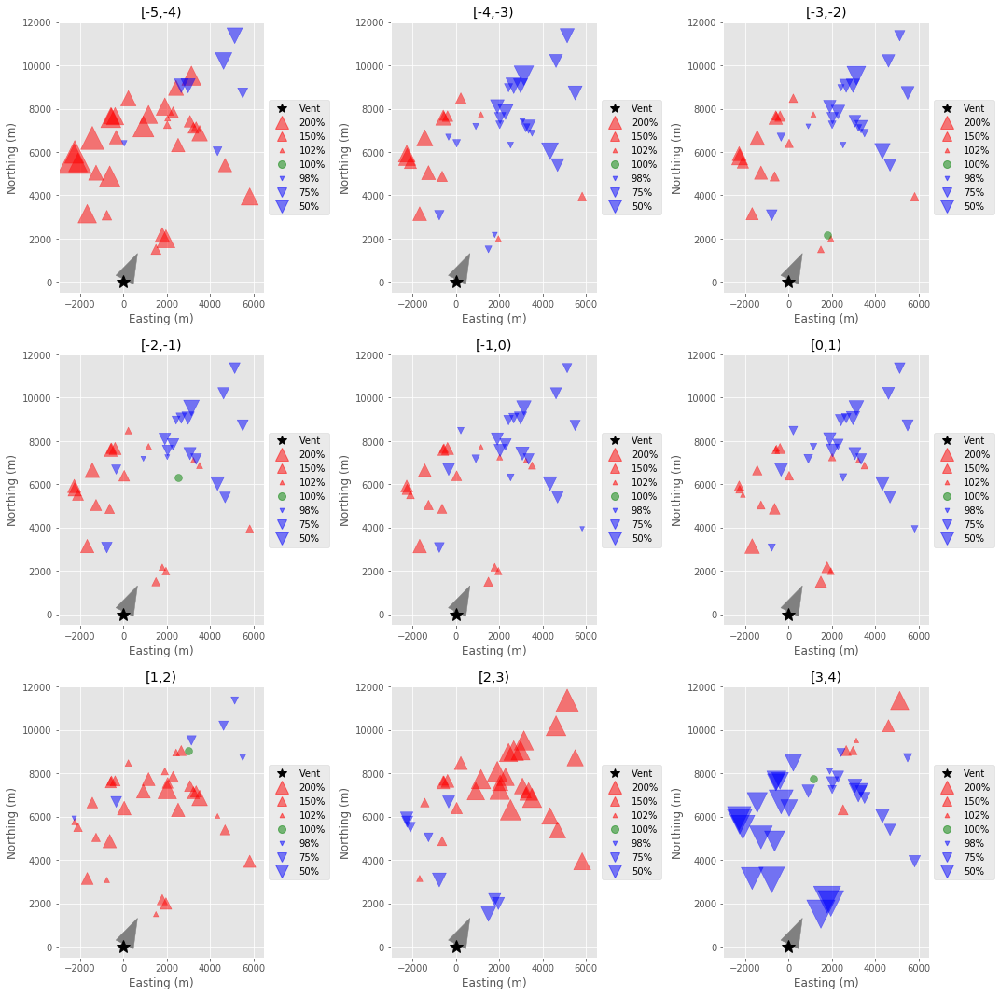

In [30]:
best = np.argsort(misfit_list)
# q_mass = mass_dist_in_plume(config["ALPHA"],config["BETA"], config["VENT_ELEVATION"], 
#         config["PLUME_HEIGHT"],
#         heights,
#         config["ERUPTION_MASS"])

q_mass = beta_plume(config["ALPHA"],config["BETA"],config["PLUME_HEIGHT"],
                    config["ERUPTION_MASS"],
                    heights,
                    config["VENT_ELEVATION"], 
                    config["THEO_MAX_COL"])


fig, ax1 = plt.subplots(1,1, figsize=(6, 15), facecolor='w', edgecolor='k')

ax1.plot(inverted_masses_list[best[0]],
             heights, 
             '-', label="Run %d (Best); Misfit = %g"%(best[0], misfit_list[best[0]]))




for i in best[1:]:
    label = "Run %d; Misfit = %g"%(i, misfit_list[i])
    ax1.plot(inverted_masses_list[i],
             heights, 
             '-', label=label)
ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1))
ax1.set_title("All fits")
ax1.set_ylabel("Height")
ax1.set_xlabel("Mass/Area")
plt.tight_layout()
plt.show()

fig, ax1 = plt.subplots(1,1, figsize=(6, 6), facecolor='w', edgecolor='k')
ax1.plot(inverted_masses_list[best[0]],
             heights, 
             '-', label="Run %d (Best); Misfit = %g"%(best[0], misfit_list[best[0]]))
ax1.plot(q_mass, heights, label="Prior Mean Column")
ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1))
ax1.set_title("Best fit")
ax1.set_ylabel("Height")
ax1.set_xlabel("Mass/Area")
plt.tight_layout()
plt.show()

params_df = pd.DataFrame(params_list)
params_df["M"] = mass_list
params_df["Misfit"] = misfit_list
params_df = params_df.sort_values("Misfit")
params_df = params_df[["a", "b", "h1", "u", "v", "D", "ftt", "eta", "zeta", "M", "Misfit"]]
display(params_df)

priors_vals = {
    "a": config["ALPHA"],
    "b": config["BETA"],
    "h1": config["PLUME_HEIGHT"],
    "u": u,
    "v": v,
    "D": config["DIFFUSION_COEFFICIENT"],
    "ftt": config["FALL_TIME_THRESHOLD"],
    "eta": 0,
    "zeta": 0
}

for i in best:
    data = data_set.copy()
    
    data = data[data["MassArea"]>0]
    display(pd.DataFrame([priors_vals, params_list[i]]))
    
    
    fig, ax1 = plt.subplots(1,1, figsize=(6, 6), facecolor='w', edgecolor='k')
    ax1.plot(q_mass, heights, label="Prior Mean Column")
    ax1.plot(inverted_masses_list[best[0]],
             heights, 
             '-', label="Run %d (Best); Misfit = %g"%(best[0], misfit_list[best[0]]))
    label = "Run %d; Misfit = %g"%(i, misfit_list[i])
    ax1.plot(inverted_masses_list[i],
             heights, 
             '-', label=label)
    ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1))
    ax1.set_title("Run %d"%i)
    ax1.set_ylabel("Height")
    ax1.set_xlabel("Mass/Area")
    plt.tight_layout()
    plt.show()
    
    phi_new = copy.deepcopy(prior_phi_steps)
    for j, phi in enumerate(phi_new):
        phi["probability"] = tgsd_list[i][j]

    
    q_dist = beta(params_list[i]["a"],params_list[i]["b"])

    grid = data[["Easting", "Northing"]]

    post_df = gaussian_stack_forward(
        grid, int(config["COL_STEPS"]), config["VENT_ELEVATION"], 
        params_list[i]["h1"], 2500, phi_new, (params_list[i]["a"],params_list[i]["b"]), 
        mass_list[i], 
        (params_list[i]["u"],params_list[i]["v"]), params_list[i]["D"], config["EDDY_CONST"],
        params_list[i]["ftt"]
    )

    
    
    post_df["radius"] = np.sqrt(post_df["Easting"]**2 + post_df["Northing"]**2)
    post_df = post_df.sort_values(by=['radius'])
    post_df["Residual"] = post_df["MassArea"].values/data["MassArea"].values
    
    ##################SPATIAL PLOTS
    
    fig, axs = plt.subplots(3,1, figsize=(
            6, 18), facecolor='w', edgecolor='k')
    axs = axs.ravel()
    bounds=(50, 800)
    vis.plot_sample(data, vent=(0,0), log=False,bounds=bounds, 
                title="Observation Dataset", cbar_label="Mass/Area", ax=axs[0],
                   wind=(params_list[i]["u"]*20,params_list[i]["v"]*20))
    axs[0].set_xlim([-3000, 6500])
    axs[0].set_ylim([-500, 12000])
    vis.plot_sample(post_df, vent=(0,0), log=False, bounds=bounds,
                title="Posterior Simulation", cbar_label="Mass/Area", ax=axs[1],
                   wind=(params_list[i]["u"]*20,params_list[i]["v"]*20))
    axs[1].set_xlim([-3000, 6500])
    axs[1].set_ylim([-500, 12000])
    vis.plot_residuals(post_df, vent=(0,0), values="Residual", plot_type="size",
                title="Residual wrt. Obs.", ax=axs[2],
                       wind=(params_list[i]["u"]*20,params_list[i]["v"]*20))
    axs[2].set_xlim([-3000, 6500])
    axs[2].set_ylim([-500, 12000])

    plt.tight_layout()
    plt.show()
    
    
    ####################EQUILINE PLOT
    
    min_mass = min((min(data["MassArea"].values), min(post_df["MassArea"].values)))
    max_mass = max((max(data["MassArea"].values), max(post_df["MassArea"].values)))

    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.scatter(np.sqrt(data["MassArea"].values), np.sqrt(post_df["MassArea"].values))
    ax.plot([0,100],[0,100], "k:")
    ax.set_xlabel("SQRT(Observed)")
    ax.set_ylabel("SQRT(Calculated)")
    ax.set_aspect('equal', 'box')
    ax.set_xlim([np.sqrt(min_mass)-1, np.sqrt(max_mass)+1])
    ax.set_ylim([np.sqrt(min_mass)-1, np.sqrt(max_mass)+1])
    fig.tight_layout()
    plt.show()
    
    ################# DISTANCE PLOTS
    fig, axs = plt.subplots(2,1, figsize=(
            8, 9), facecolor='w', edgecolor='k')
    axs = axs.ravel()

    axs[0].plot(data["radius"].values, data["MassArea"].values, 'C2o-', label="Observation Data")
    axs[0].plot(post_df["radius"].values, post_df["MassArea"].values, 'C1o', label="Posterior Simulation")
    axs[0].legend()
    axs[0].set_xlabel("Distance from vent (m)")
    axs[0].set_ylabel("Mass/Area")
    axs[0].set_xlim(1000, 13000)

    axs[1].plot(post_df["radius"].values, post_df["Residual"].values*100, 'C1o', label="Post/Obs")
    axs[1].axhline(100, linestyle="--", lw=1, c="gray")  
    axs[1].legend()
    axs[1].set_xlabel("Distance from vent (m)")
    axs[1].set_ylabel("Sim as % of Real")
    axs[1].set_xlim(1000, 13000)
    plt.show()
    
    
    ################# TGSD PLOTS
    
    old_tgsd = [phi["probability"] for phi in prior_phi_steps]
    x = [phi["centroid"] for phi in phi_new]
    labels = [phi["interval"] for phi in phi_new]
    
    obs_tgsd = get_tgsd(data, phi_new)
    post_tgsd = get_tgsd(post_df, phi_new)
    
    
    
    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.bar([xx-0.25 for xx in x], old_tgsd, width=0.5, align="center", label="Input TGSD")
    ax.bar([xx+0.25 for xx in x], tgsd_list[i], width=0.5, align="center", label="Post. TGSD")
    ax.set_xticks(x)
    ax.set_xticklabels(labels, rotation=90)
    ax.set_xlabel("Phi Interval")
    plt.title("TGSD before and after inversion")
    plt.legend()
    
    plt.show()
    
    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.bar([xx-0.25 for xx in x], obs_tgsd, width=0.5, align="center", label="Obs. TGSD (Naive)")
    ax.bar([xx+0.25 for xx in x], post_tgsd, width=0.5, align="center", label="Post. TGSD (Naive)")
    ax.set_xticks(x)
    ax.set_xticklabels(labels, rotation=90)
    ax.set_xlabel("Phi Interval")
    plt.title("Naive estimation of TGSD")
    plt.legend()
    
    plt.show()
    
    ################# ERROR CONTRIBUTION PLOTS
    
    new_steps = copy.deepcopy(prior_phi_steps)
    for j, phi in enumerate(new_steps):
        phi["probability"] = tgsd_list[i][j]

    misfit, contributions, setup = get_error_contributions(
        data, len(data), int(config["INV_STEPS"]), 
        config["VENT_ELEVATION"], config["THEO_MAX_COL"], 2500, new_steps, 
        params_list[i], mass_list[i], column_cap = config["THEO_MAX_COL"], )
    
    point_contributions = np.sum(contributions, 0)
    phi_contributions = np.sum(contributions, 1)
    
    print("Full misfit", misfit)

    print("Point Contributions", point_contributions)
    print("Phi Contributions", phi_contributions)

    print("Sum of Point Conts:", sum(point_contributions))
    print("Sum of Phi Conts:", sum(phi_contributions))
    
    #### Phi Error Contributions
    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.bar(x, phi_contributions, width=0.5, align="center")
    ax.set_xticks(x)
    ax.set_xticklabels(labels)
    plt.xlabel("Phi Interval")
    plt.ylabel("Error Contribution")
    plt.title("Run %d"%i)
    plt.show()
    
    #### Distance Error Contributions
    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.plot(data["radius"], point_contributions, "C0o-")
    plt.xlabel("Distance from Vent")
    plt.ylabel("Error Contribution")
    plt.title("Run %d"%i)
    ax.set_xlim(1000, 13000)
    plt.show()
    
    #### Spatial Error Contributions
    data["Contributions"] = point_contributions
    fig, ax = plt.subplots(1, 1, figsize=(5,5), facecolor='w', edgecolor='k')

    vis.plot_sample(data, vent=(0,0), log=False, values="Contributions",
                title="Error Contributions", cbar_label="Mass/Area", ax = ax, cmap="hot")
    ax.set_xlim([-3000, 6500])
    ax.set_ylim([-500, 12000])
    plt.tight_layout()
    plt.show()
#      bounds=(min(min(contributions)),max(max(contributions))),
    #### Phi and Spatial Error Contributions
    fig, axs = plt.subplots(3, 3, figsize=(15,15), facecolor='w', edgecolor='k')
    axs = axs.ravel()
    for j, phi_cont in enumerate(phi_contributions):
        data["Contributions"] = contributions[j]
#         display(data[["Contributions", "MassArea"]])
        vis.plot_sample(data, vent=(0,0), log=False, values="Contributions", 
                        bounds=(min(min(contributions)),max(max(contributions))),
                        title=phi_new[j]["interval"], cbar_label="Error Contribution", 
                        ax = axs[j], cmap="hot", 
                        wind=(params_list[i]["u"]*20,params_list[i]["v"]*20))
        axs[j].set_xlim([-3000, 6500])
        axs[j].set_ylim([-500, 12000])
    plt.tight_layout()
    plt.show()

    #################### PHI AND SPATIAL RESIDUALS
    fig, axs = plt.subplots(3, 3, figsize=(15,15), facecolor='w', edgecolor='k')
    axs = axs.ravel()
    for j, phi_step in enumerate(phi_new):
        post_df["mass_res"] = (post_df["MassArea"].values*(post_df[phi_step["interval"]].values/100))/\
                             (data["MassArea"].values*(data[phi_step["interval"]].values/100))
        
        disp_df = post_df[["Northing", "Easting", "MassArea", phi_step["interval"], "mass_res"]]
        disp_df["Obs. MassArea"] = data["MassArea"].values
        disp_df[("Obs. " + phi_step["interval"])] = data[phi_step["interval"]].values
        disp_df.rename(columns = {'MassArea':'Post. MassArea', 
                                  phi_step["interval"]:("Post. " + phi_step["interval"]),
                                 "mass_res":"Residual"},
                       inplace = True)
        display(disp_df)
        vis.plot_residuals(post_df, vent=(0,0), values="mass_res", plot_type="size",
                        title=prior_phi_steps[j]["interval"],  
                        ax = axs[j]
                          , wind=(params_list[i]["u"]*20,params_list[i]["v"]*20))
        axs[j].set_xlim([-3000, 6500])
        axs[j].set_ylim([-500, 12000])
    plt.tight_layout()
    plt.show()
    


In [ ]:
for tgsd in tgsd_list:
    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.bar(x, tgsd, width=1, align="center")
    ax.set_xticks(x)
    ax.set_xticklabels(labels)
    plt.xlabel("Phi Interval")
    plt.show()

In [ ]:

for i in best[0:1]:
    display(pd.DataFrame([priors_list[i], params_list[i]], index=["Priors", "Posteriors"]).T)
    wind_speed = np.sqrt(params_list[i]["u"]**2 + params_list[i]["v"]**2)
    
    wind_angle = np.arctan(params_list[i]["v"]/params_list[i]["u"])
    print(wind_speed, np.degrees(wind_angle))
    
    sweep = np.linspace(-45, 45, 13)
    wind_sses = []
    for deg in sweep:
        new_angle = np.degrees(wind_angle) + deg
        print(new_angle)
        
        new_u = wind_speed * np.cos(np.radians(new_angle))
        new_v = wind_speed * np.sin(np.radians(new_angle))
        
        print(new_u, new_v)
        post_df = gaussian_stack_forward(
            grid, int(config["COL_STEPS"]), config["VENT_ELEVATION"], 
            params_list[i]["h1"], 2500, phi_steps, (params_list[i]["a"],params_list[i]["b"]), 
            config["ERUPTION_MASS"], 
            (new_u,new_v), config["DIFFUSION_COEFFICIENT"], config["EDDY_CONST"],
            3600
        )
        post_df["radius"] = np.sqrt(post_df["Easting"]**2 + post_df["Northing"]**2)
        post_df = post_df.sort_values(by=['radius'])
        post_df["Residual"] = post_df["MassArea"].values/obs_df["MassArea"].values
        
        fig, axs = plt.subplots(3,1, figsize=(
        6, 18), facecolor='w', edgecolor='k')
        axs = axs.ravel()
        bounds=(50, 800)
        vis.plot_sample(obs_df, vent=(0,0), log=False,bounds=bounds, 
                    title="Observation Dataset", cbar_label="Mass/Area", ax=axs[0],
                       wind=(new_u*20,new_v*20))
        vis.plot_sample(post_df, vent=(0,0), log=False, bounds=bounds,
                    title="Posterior Simulation", cbar_label="Mass/Area", ax=axs[1],
                       wind=(new_u*20,new_v*20))
        vis.plot_residuals(post_df, vent=(0,0), values="Residual", plot_type="size",
                    title="Residual wrt. Obs.", ax=axs[2],
                           wind=(new_u*20,new_v*20))

        plt.tight_layout()
        plt.show()
        
        new_params = params_list[i].copy()
        
        new_params["u"] = new_u
        new_params["v"] = new_v
        
        sse, contributions, setup = get_error_contributions(
            data, len(data), 20, 
            config["VENT_ELEVATION"], H, 2500, phi_steps, 
            new_params, column_cap = H, )
    
        wind_sses += [sse]
    
        point_contributions = np.sum(contributions, 0)
        phi_contributions = np.sum(contributions, 1)

        x = [phi["centroid"] for phi in phi_steps]
        labels = [phi["interval"] for phi in phi_steps]
        fig, ax = plt.subplots(facecolor='w', edgecolor='k')
        ax.bar(x, phi_contributions, width=0.5, align="center")
        ax.set_xticks(x)
        ax.set_xticklabels(labels)
        plt.xlabel("Phi Interval")
        plt.ylabel("Error Contribution")
        plt.title("Run %d"%i)
        plt.show()

        fig, ax = plt.subplots(facecolor='w', edgecolor='k')
        ax.plot(data["radius"], point_contributions, "C0o-")
        plt.xlabel("Distance from Vent")
        plt.ylabel("Error Contribution")
        plt.title("Run %d"%i)
        plt.show()

        data["Contributions"] = point_contributions
        fig, ax = plt.subplots(1, 1, figsize=(5,5), facecolor='w', edgecolor='k')

        vis.plot_sample(data, vent=(0,0), log=False, values="Contributions",
                    title="Error Contributions", cbar_label="Mass/Area", ax = ax, cmap="hot")
        plt.tight_layout()
        plt.show()
    #      bounds=(min(min(contributions)),max(max(contributions))),

        fig, axs = plt.subplots(3, 3, figsize=(15,15), facecolor='w', edgecolor='k')
        axs = axs.ravel()
        for j, phi_cont in enumerate(phi_contributions):
            data["Contributions"] = contributions[j]
            display(data[["Contributions", "MassArea"]])
            vis.plot_sample(data, vent=(0,0), log=False, values="Contributions", 
                            bounds=(min(min(contributions)),max(max(contributions))),
                            title=phi_steps[j]["interval"], cbar_label="Error Contribution", 
                            ax = axs[j], cmap="hot", 
                            wind=(new_u*20,new_v*20))
        plt.tight_layout()
        plt.show()







        fig, axs = plt.subplots(3, 3, figsize=(15,15), facecolor='w', edgecolor='k')
        axs = axs.ravel()
        for j, phi_step in enumerate(phi_steps):
            post_df["mass_res"] = (post_df["MassArea"].values*(post_df[phi_step["interval"]].values/100))/\
                                 (data["MassArea"].values*(data[phi_step["interval"]].values/100))
            vis.plot_residuals(post_df, vent=(0,0), values="mass_res", plot_type="size",
                            title=phi_steps[j]["interval"],  
                            ax = axs[j]
                              , wind=(new_u*20,new_v*20))
        plt.tight_layout()
        plt.show()
    plt.plot(sweep, wind_sses)
        

params_df = pd.DataFrame(params_list)
params_df["SSE"] = sse_list
params_df = params_df.sort_values("SSE")
params_df = params_df[["a", "b", "h1", "u", "v", "D", "ftt", "M", "SSE"]]
display(params_df)

In [ ]:
param_config = {
    "a": {
        "value":[1.01, 5],
        "invert":True,
        "sample_function": uninformed
    },
    "b": {
        "value":[1.01, 5],
        "invert":True,
        "sample_function": uninformed
    },
    "h1": {
        "value":[5000, 29999],
        "invert":True,
        "sample_function": uninformed
    },
    "u": {
        "value":[-10, 10],
        "invert":True,
        "sample_function": uninformed
    },
    "v": {
        "value":[-10, 10],
        "invert":True,
        "sample_function": uninformed
    },
    "D": {
        "value":[4000, 100000],
        "invert":True,
        "sample_function": uninformed
    },
    "ftt": {
        "value":[6000, 10000],
        "invert":False,
        "sample_function": uninformed
    },
    "M": {
        "value":[config["ERUPTION_MASS"]],
        "invert":False,
        "sample_function": lognorm
    }
}
param_config_df = pd.DataFrame(param_config)
display(param_config_df.T)

for key, val in param_config.items():
    x = [val["sample_function"](*val["value"]) for i in range(1000)]
    plt.hist(x)
    plt.title(key)
    plt.show()



In [ ]:
log="verb"
data = obs_df
iterations = 20

out = gaussian_stack_multi_run(
    obs_df, len(data), 20, 
    config["VENT_ELEVATION"], 
    H, 2500, phi_steps, param_config, runs=iterations, column_cap = H, pre_samples=20
)

inverted_masses_list, sse_list, params_list, priors_list, heights = out

In [ ]:
best = np.argsort(sse_list)
q_mass = mass_dist_in_plume(config["ALPHA"],config["BETA"], config["VENT_ELEVATION"], 
        config["PLUME_HEIGHT"],
        heights,
        config["ERUPTION_MASS"])
fig, ax1 = plt.subplots(1,1, figsize=(6, 6), facecolor='w', edgecolor='k')
ax1.plot(inverted_masses_list[best[0]],
             heights, 
             '-', label="Run %d (Best); SSE = %g"%(best[0], sse_list[best[0]]))

ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1))
ax1.plot(q_mass, heights, label="Prior Mean Column")
ax1.set_title("Best fit")
ax1.set_ylabel("Height")
ax1.set_xlabel("Mass/Area")
plt.tight_layout()
plt.show()

fig, ax1 = plt.subplots(1,1, figsize=(6, 10), facecolor='w', edgecolor='k')

ax1.plot(inverted_masses_list[best[0]],
             heights, 
             '-', label="Run %d (Best); SSE = %g"%(best[0], sse_list[best[0]]))
for i in best[1:]:
    label = "Run %d; SSE = %g"%(i, sse_list[i])
    ax1.plot(inverted_masses_list[i],
             heights, 
             '-', label=label)
ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1))
ax1.set_title("All fits")
ax1.set_ylabel("Height")
ax1.set_xlabel("Mass/Area")
plt.tight_layout()
plt.show()


for i in best:
    fig, ax1 = plt.subplots(1,1, figsize=(6, 6), facecolor='w', edgecolor='k')
    ax1.plot(q_mass, heights, label="Prior Mean Column")
    ax1.plot(inverted_masses_list[best[0]],
             heights, 
             '-', label="Run %d (Best); SSE = %g"%(best[0], sse_list[best[0]]))
    label = "Run %d; SSE = %g"%(i, sse_list[i])
    ax1.plot(inverted_masses_list[i],
             heights, 
             '-', label=label)
    ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1))
    ax1.set_title("Run %d"%i)
    ax1.set_ylabel("Height")
    ax1.set_xlabel("Mass/Area")
    plt.tight_layout()
    plt.show()
    display(pd.DataFrame([params_list[i]]))
    sse, contributions = get_error_contributions(
        data, len(data), 20, 
        config["VENT_ELEVATION"], H, 2500, phi_steps, 
        params_list[i], column_cap = H, )
    
    
    point_contributions = np.sum(contributions, 0)
    phi_contributions = np.sum(contributions, 1)
    
    x = [phi["centroid"] for phi in phi_steps]
    labels = [phi["interval"] for phi in phi_steps]
    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.bar(x, phi_contributions, width=0.5, align="center")
    ax.set_xticks(x)
    ax.set_xticklabels(labels)
    plt.xlabel("Phi Interval")
    plt.ylabel("Error Contribution")
    plt.title("Run %d"%i)
    plt.show()

    fig, ax = plt.subplots(facecolor='w', edgecolor='k')
    ax.plot(data["radius"], point_contributions, "C0o-")
    plt.xlabel("Distance from Vent")
    plt.ylabel("Error Contribution")
    plt.title("Run %d"%i)
    plt.show()
    
    data["Contributions"] = point_contributions
    fig, ax = plt.subplots(1, 1, figsize=(5,5), facecolor='w', edgecolor='k')

    vis.plot_sample(data, vent=(0,0), log=False, values="Contributions",
                title="Error Contributions", cbar_label="Mass/Area", ax = ax, cmap="hot")
    plt.tight_layout()
    plt.show()
#      bounds=(min(min(contributions)),max(max(contributions))),
    fig, axs = plt.subplots(3, 3, figsize=(15,15), facecolor='w', edgecolor='k')
    axs = axs.ravel()
    for j, phi_cont in enumerate(phi_contributions):
        data["Contributions"] = contributions[j]
        vis.plot_sample(data, vent=(0,0), log=False, values="Contributions", bounds=(min(min(contributions)),max(max(contributions))),
                title=phi_steps[j]["interval"], cbar_label="Error Contribution", ax = axs[j], cmap="hot")
    plt.tight_layout()
    plt.show()

    q_dist = beta(params_list[i]["a"],params_list[i]["b"])

    grid = obs_df[["Easting", "Northing"]]

    post_df = gaussian_stack_forward(
        grid, int(config["COL_STEPS"]), config["VENT_ELEVATION"], 
        params_list[i]["h1"], 2500, phi_steps, (params_list[i]["a"],params_list[i]["b"]), config["ERUPTION_MASS"], 
        (u,v), config["DIFFUSION_COEFFICIENT"], config["EDDY_CONST"],
        config["FALL_TIME_THRESHOLD"]
    )
    
    post_df["radius"] = np.sqrt(post_df["Easting"]**2 + post_df["Northing"]**2)
    post_df = post_df.sort_values(by=['radius'])
    post_df["Residual"] = post_df["MassArea"].values/obs_df["MassArea"].values
    
    fig, axs = plt.subplots(3,1, figsize=(
            6, 18), facecolor='w', edgecolor='k')
    axs = axs.ravel()
    bounds=(50, 800)
    vis.plot_sample(obs_df, vent=(0,0), log=False,bounds=bounds, 
                title="Observation Dataset", cbar_label="Mass/Area", ax=axs[0])
    vis.plot_sample(post_df, vent=(0,0), log=False, bounds=bounds,
                title="Posterior Simulation", cbar_label="Mass/Area", ax=axs[1])
    vis.plot_residuals(post_df, vent=(0,0), values="Residual", plot_type="size",
                title="Residual wrt. Obs.", ax=axs[2])

    plt.tight_layout()
    plt.show()

    
    fig, axs = plt.subplots(2,1, figsize=(
            8, 9), facecolor='w', edgecolor='k')
    axs = axs.ravel()

    axs[0].plot(obs_df["radius"].values, obs_df["MassArea"].values, 'C2o-', label="Observation Data")
    axs[0].plot(post_df["radius"].values, post_df["MassArea"].values, 'C1o', label="Posterior Simulation")
    axs[0].legend()
    axs[0].set_xlabel("Distance from vent (m)")
    axs[0].set_ylabel("Mass/Area")


    axs[1].plot(post_df["radius"].values, post_df["Residual"].values*100, 'C1o', label="Post/Obs")
    axs[1].axhline(100, linestyle="--", lw=1, c="gray")
    axs[1].legend()
    axs[1].set_xlabel("Distance from vent (m)")
    axs[1].set_ylabel("Sim as % of Real")
    plt.show()

In [ ]:
for i in best:
    print("RUN %d"%i)
    display(pd.DataFrame([priors_list[i], params_list[i]], index=["Priors", "Posteriors"]).T)
    
params_df = pd.DataFrame(params_list)
params_df["SSE"] = sse_list
params_df = params_df.sort_values("SSE")
params_df = params_df[["a", "b", "h1", "u", "v", "D", "ftt", "M", "SSE"]]
display(params_df)

In [ ]:
data = obs_df
runs = 100
t_tot = process_time()
single_run_time = 0


params_list = []
sse_list = []
contributions_list = []
for i in range(runs):
    t = process_time()

    print("Run %d%s"%(i, '='*(80-5)))

    prior_samples = {}
    invert = {}

    for key, val in param_config.items():
        invert[key] = val["invert"]
        if val["invert"]:
            prior_samples[key] = val["sample_function"](*val["value"])
        else:
            prior_samples[key] = val["value"][0]
    

    sse, contributions = get_error_contributions(
        data, len(data), 20, 
        config["VENT_ELEVATION"], H, 2500, phi_steps, 
        prior_samples, column_cap = H)

    params_list += [prior_samples]

    display(pd.DataFrame([prior_samples]))

    contributions_list += [contributions]
    
    sse_list += [sse]

    run_time = process_time() - t
    print("Run %d Time: %.3f minutes\n\n"%(i, run_time/60))
    iter_left = runs - (i+1)
    avg_time_per_run = (process_time() - t_tot)/(i+1)
    print("Estimated remaining run time: %.3f minutes\n\n"%(avg_time_per_run*iter_left/60))
total_run_time = process_time() - t_tot
print("Total Run Time: %.5f minutes"%(total_run_time/60))


In [ ]:
best = np.argsort(sse_list)
print(best)

for i in best[:1]:
    print(sse_list[i])
    
    point_contributions = np.sum(contributions_list[i], 0)
    phi_contributions = np.sum(contributions_list[i], 1)
    
    plt.plot(point_contributions)
    plt.show()
    plt.plot(phi_contributions)
    plt.show()
    
    data["Contributions"] = point_contributions
    fig, ax = plt.subplots(1, 1, figsize=(5,5))

    vis.plot_sample(data, vent=(0,0), log=False, values="Contributions",
                title="Error Contributions", cbar_label="Mass/Area", ax = ax, cmap="hot")
    plt.tight_layout()
    plt.show()
    
    fig, axs = plt.subplots(3, 3, figsize=(15,15))
    axs = axs.ravel()
    for j, phi_cont in enumerate(phi_contributions):
        data["Contributions"] = contributions_list[i][j]
        vis.plot_sample(data, vent=(0,0), log=True, bounds=(min(min(contributions_list[i])),max(max(contributions_list[i]))), values="Contributions",
                title=prior_phi_steps[j]["interval"], cbar_label="Mass/Area", ax = axs[j], cmap="hot")
    plt.tight_layout()
    plt.show()
    
    

SSE contributions
* phi class
* distance? Dunno. Does a single point carry a contribution? Whelp.  

In [ ]:
import numpy as np
from scipy.stats import beta
from scipy.special import betainc
import matplotlib.pyplot as plt

def beta_transformer(a, b, h1, tot_mass, z, z_min, H):
    heights = z[(z>=z_min) & (z<h1)]
    dist = beta.pdf(x=heights, a=a, b=b, loc=z_min, scale=(h1-z_min))
    print(sum(dist))
    plume = np.zeros(len(z))
    plume[(z>=z_min) & (z<h1)] = dist
    ret = (plume/sum(plume))*tot_mass
    return ret, a, b, h1

def betainc_transformer(a, b, h1, tot_mass, z, z_min, H):
    heights = z[(z>=z_min) & (z<h1)]
    x_k = [(z_k-z_min)/(h1-z_min) for z_k in heights]
    dist = [betainc(a, b, x_k[i+1]) - betainc(a, b, x_k[i]) 
       for i in range(len(x_k)-1)] + [0]
    plume = np.zeros(len(z))
    plume[(z>=z_min) & (z<h1)] = dist
    ret = (plume/sum(plume))*tot_mass
    return ret, a, b, h1

In [ ]:
a_in = 1.00554
b_in = 1.56436
h1_in = 24000
tot_mass_in = 55000000000
H_in = 30000
z_in = np.linspace(3500, H_in, 20)
z_min_in = 3500




In [ ]:
ret, a, b, h1 = beta_transformer(a_in, b_in, h1_in, tot_mass_in, z_in, z_min_in, H_in)
plt.plot(ret, z_in)
print(sum(ret))

In [ ]:
ret, a, b, h1 = betainc_transformer(a_in, b_in, h1_in, tot_mass_in, z_in, z_min_in, H_in)
plt.plot(ret, z_in)
print(sum(ret))

In [ ]:
z_new = z_in[(z_in>=z_min_in) & (z_in<h1_in)]

print(z_new)

x_k = [(z_k-z_min_in)/(h1_in-z_min_in) for z_k in z_new]
print(x_k)

q_k = np.zeros(len(x_k)-1)
for i in range(len(x_k)-1):
    print(x_k[i], x_k[i+1])
    q_k[i] = betainc(a_in, b_in, x_k[i+1]) - betainc(a_in, b_in, x_k[i])

q_k2 = [betainc(a_in, b_in, x_k[i+1]) - betainc(a_in, b_in, x_k[i]) 
       for i in range(len(x_k)-1)]
    
print(q_k + [0])
print(q_k2 + [0])

In [ ]:
import pyproj
from pyproj import Proj
myProj = Proj("+proj=utm +zone=45U, +north +ellps=WGS84 +datum=WGS84 +units=m +no_defs")
lon_,lat_ = myProj(lon, lat) 
plt.scatter(lon_,lat_)

In [ ]:
import copy

a = {
    "one":[4,4,4,4],
    "two":2,
    "three":3
}
print(a)

b = copy.deepcopy(a)

print(b)

b['one'][2] = 1

print(a)
print(b)

In [42]:
a = [1., 2., 0., 3., 4., 0., 5., 6.]
b = np.array(a)
b[b > 0] = np.nan

print(b)

[nan nan  0. nan nan  0. nan nan]
